In [1]:
pip install ta

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for ta: filename=ta-0.11.0-py3-none-any.whl size=29482 sha256=e67b163d509be83c6f85435f6d3283f3e108d4ef4c2ac1b654488291988fbf40
  Stored in directory: /root/.cache/pip/wheels/a1/d7/29/7781cc5eb9a3659d032d7d15bdd0f49d07d2b24fec29f44bc4
Successfully built ta


In [1]:

import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_absolute_percentage_error
import warnings
from ta.momentum import RSIIndicator
from ta.trend import MACD
from keras.optimizers import Adam
from keras.layers import Dropout
from keras.callbacks import EarlyStopping
from dateutil.relativedelta import relativedelta

warnings.filterwarnings("ignore")

def load_main_stock(path):
    df = pd.read_csv(path, skiprows=3, header=None)
    df.columns = ['Date', 'Close', 'High', 'Low', 'Open', 'Volume']
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.sort_values('Date')
    df = df[['Date', 'Open', 'High', 'Low', 'Close', 'Volume']].set_index('Date')
    df = df.loc['2008-01-01':'2024-12-31']

    df['Close_lag1'] = df['Close'].shift(1)
    df['Volume_lag1'] = df['Volume'].shift(1)
    df['ma_5'] = df['Close_lag1'].rolling(window=5).mean()
    df['volatility_63'] = df['Close_lag1'].rolling(window=63).std()
    df['intraday_range'] = df['High'].shift(1) - df['Low'].shift(1)
    df['upper_shadow'] = df['High'].shift(1) - df[['Open', 'Close']].shift(1).max(axis=1)
    df['lower_shadow'] = df[['Open', 'Close']].shift(1).min(axis=1) - df['Low'].shift(1)
    df['momentum_126'] = df['Close_lag1'] - df['Close_lag1'].shift(126)
    df['RSI'] = RSIIndicator(close=df['Close_lag1'], window=14).rsi()
    macd = MACD(close=df['Close_lag1'])
    df['MACD'] = macd.macd()
    df['MACD_signal'] = macd.macd_signal()


    df = df.drop(columns=['Open', 'High', 'Low', 'Volume'])
    return df.dropna()

def create_sequences(X, y, window):
    Xs, ys = [], []
    for i in range(len(X) - window):
        Xs.append(X[i:i+window])
        ys.append(y[i+window])
    return np.array(Xs), np.array(ys)

# Base models

# Model 1

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for AAPL
RMSE: 5.2614
MAE : 4.5235
R^2 : 0.9082
MAPE: 0.0264


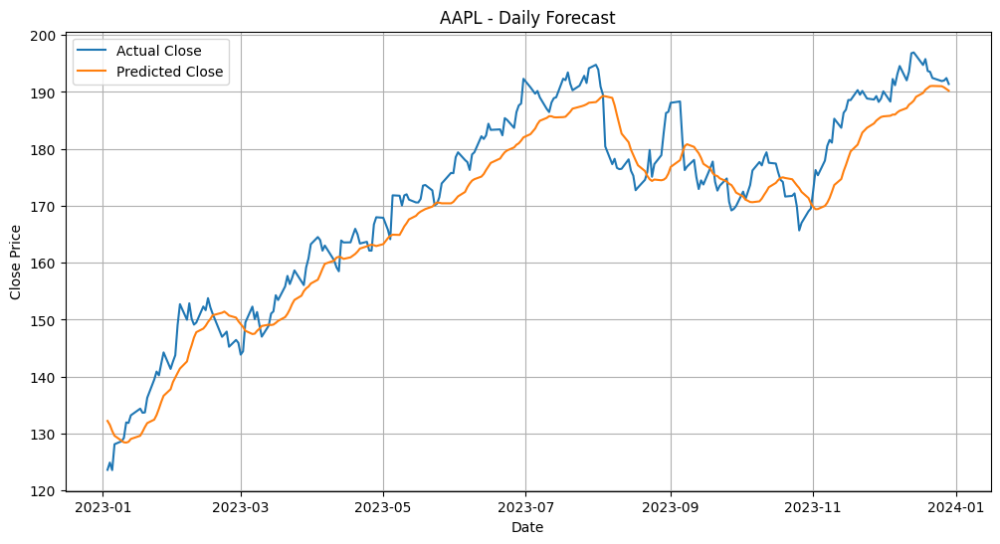

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for JPM
RMSE: 4.0667
MAE : 3.3142
R^2 : 0.8243
MAPE: 0.0238


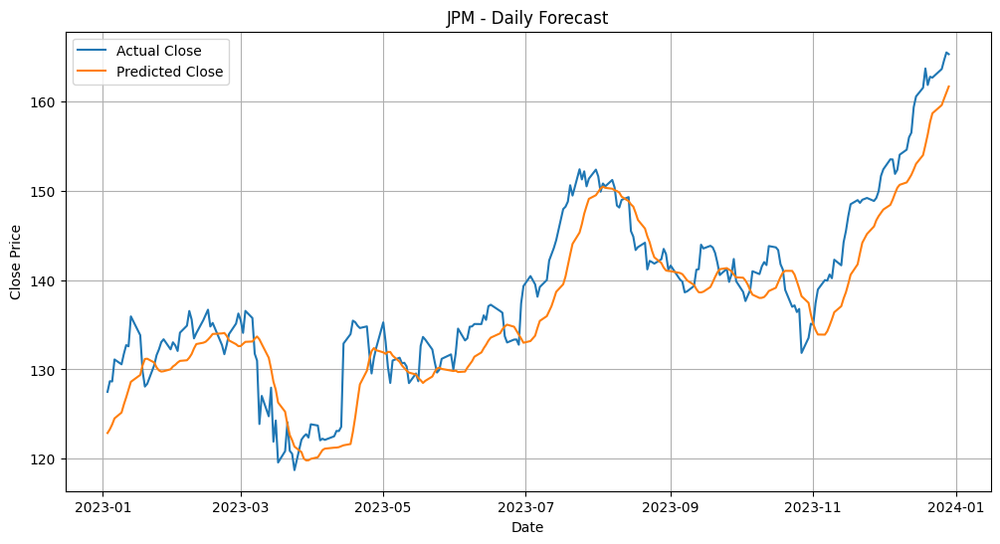

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step

📊 Results for NVDA
RMSE: 3.0583
MAE : 2.3086
R^2 : 0.9188
MAPE: 0.0589


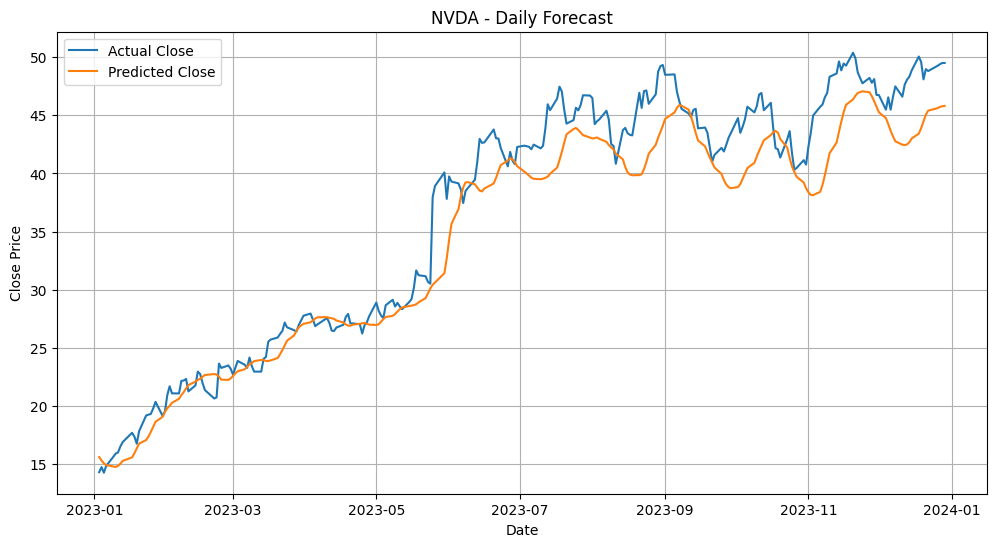

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step

📊 Results for SPY
RMSE: 7.8431
MAE : 6.3958
R^2 : 0.8924
MAPE: 0.0154


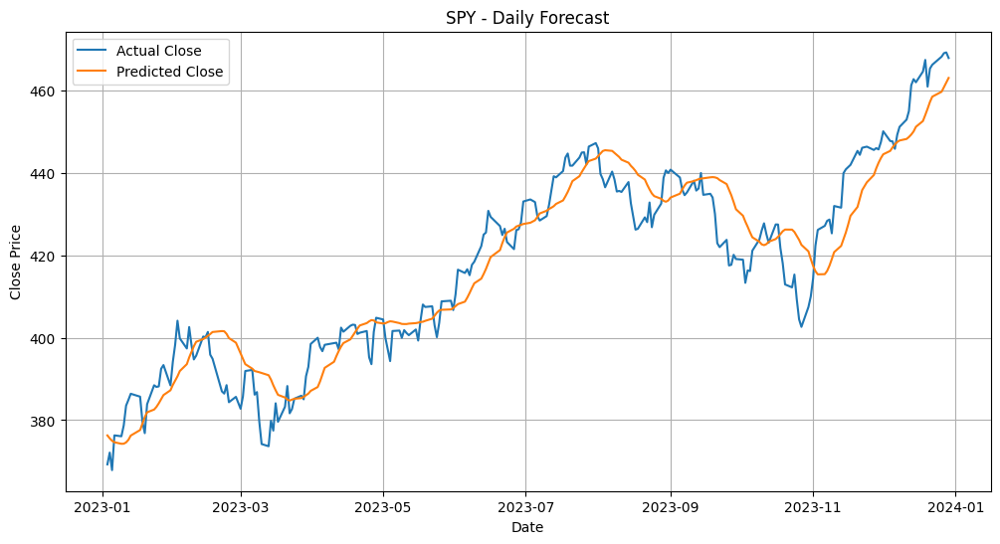

📉 Mean Scaled RMSE over 4 stocks: 0.0801841961217398


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for AAPL
RMSE: 2.0103
MAE : 1.6337
R^2 : 0.9441
MAPE: 0.0314


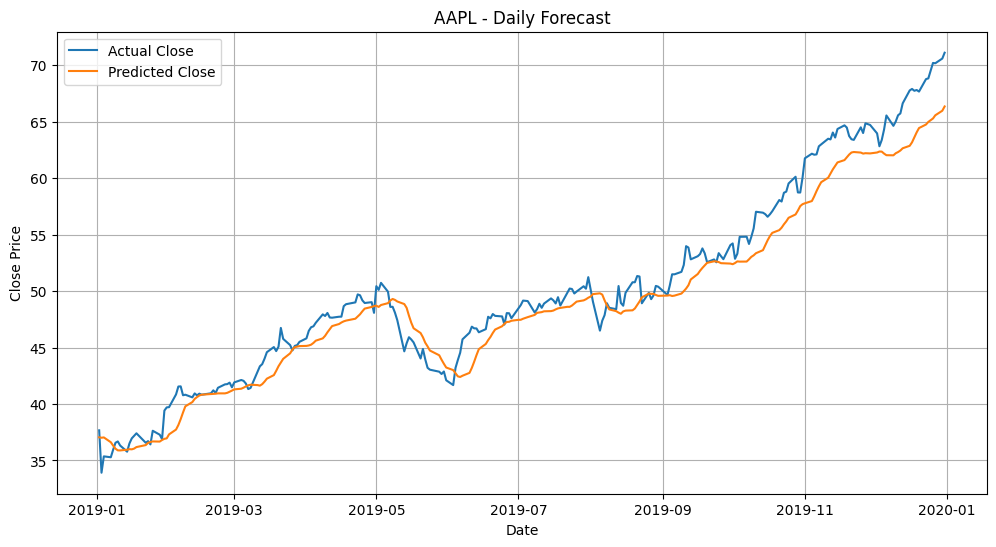

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step

📊 Results for JPM
RMSE: 3.6614
MAE : 2.9988
R^2 : 0.8541
MAPE: 0.0300


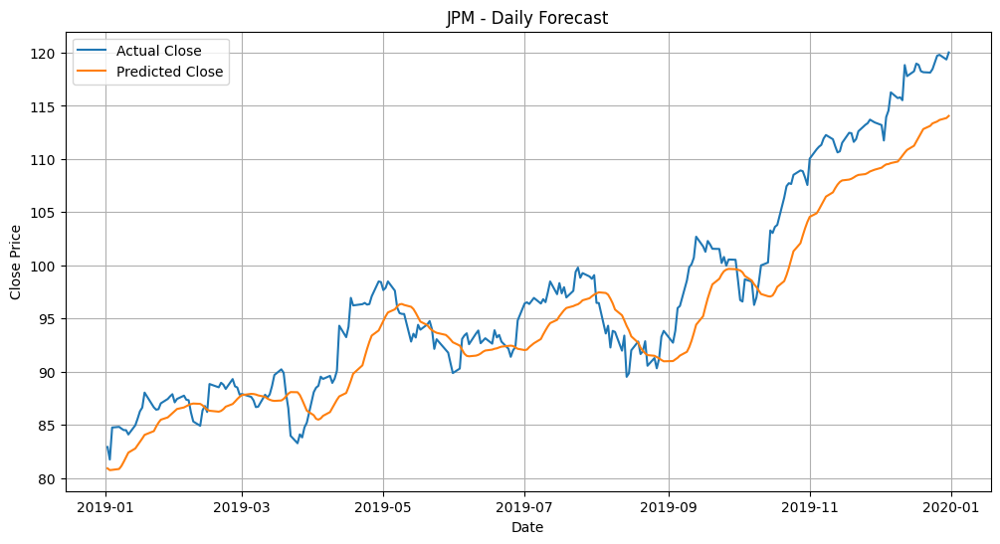

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for NVDA
RMSE: 0.2212
MAE : 0.1782
R^2 : 0.8742
MAPE: 0.0423


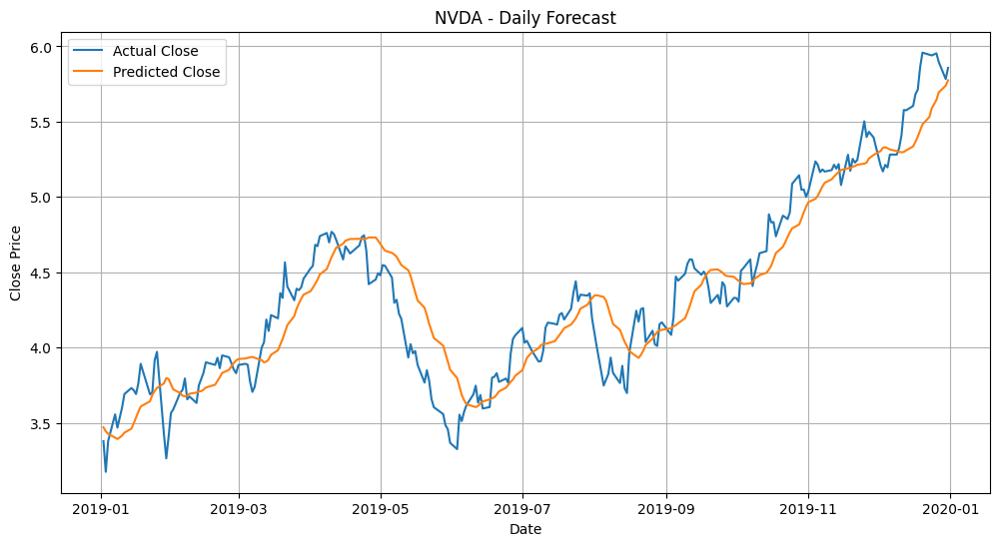

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for SPY
RMSE: 5.0944
MAE : 4.4734
R^2 : 0.8850
MAPE: 0.0168


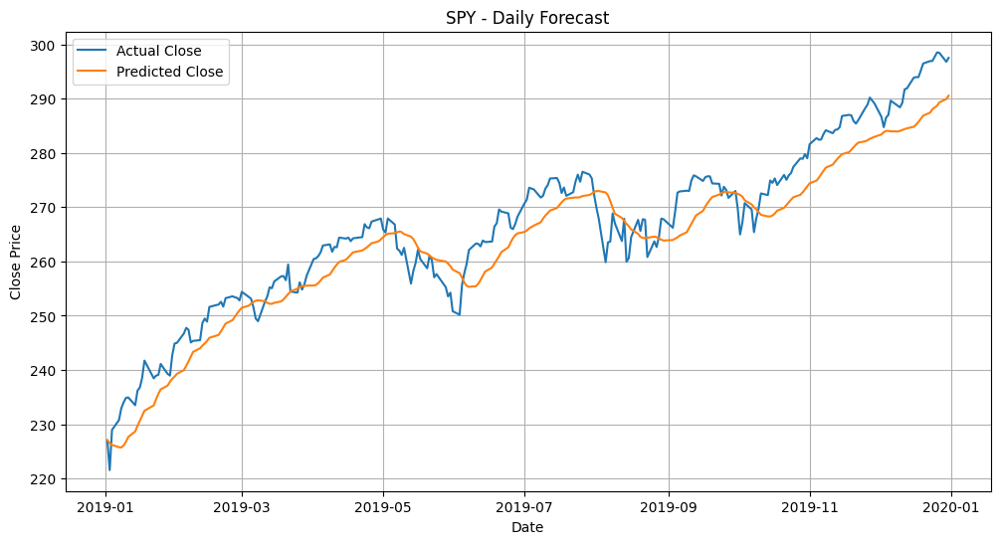

📉 Mean Scaled RMSE over 4 stocks: 0.07382716093830294


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for AAPL
RMSE: 1.2244
MAE : 0.9700
R^2 : 0.8816
MAPE: 0.0268


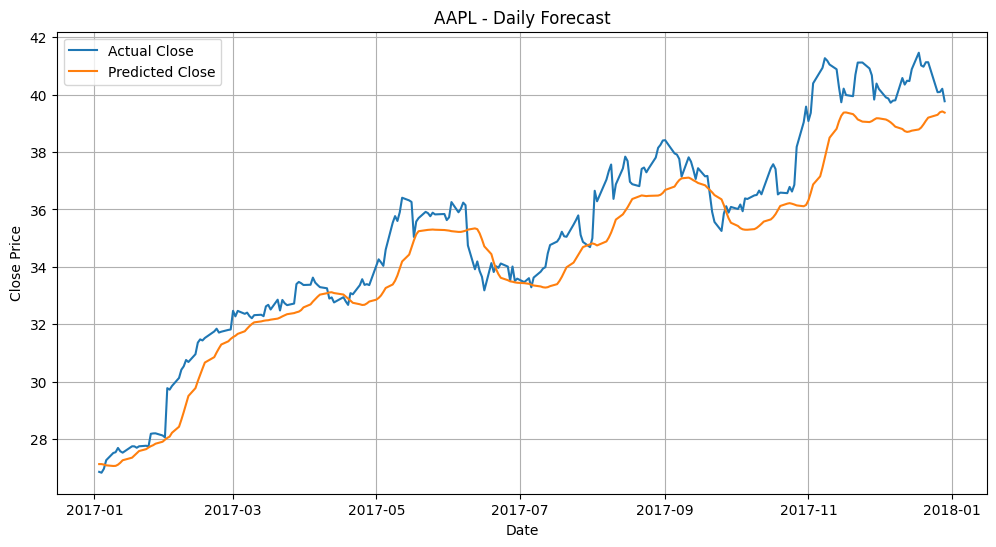

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step

📊 Results for JPM
RMSE: 2.0282
MAE : 1.6529
R^2 : 0.8654
MAPE: 0.0226


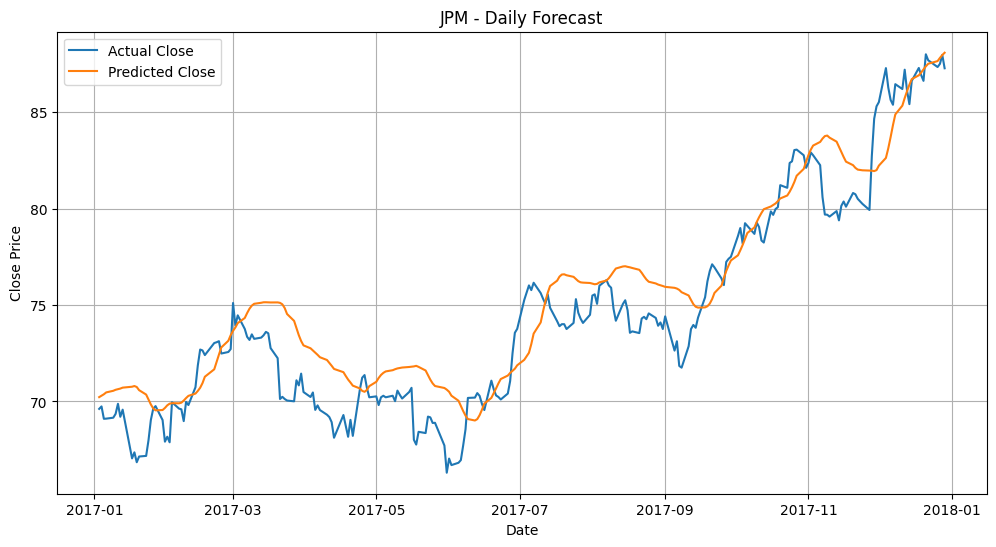

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step

📊 Results for NVDA
RMSE: 0.2087
MAE : 0.1656
R^2 : 0.9508
MAPE: 0.0453


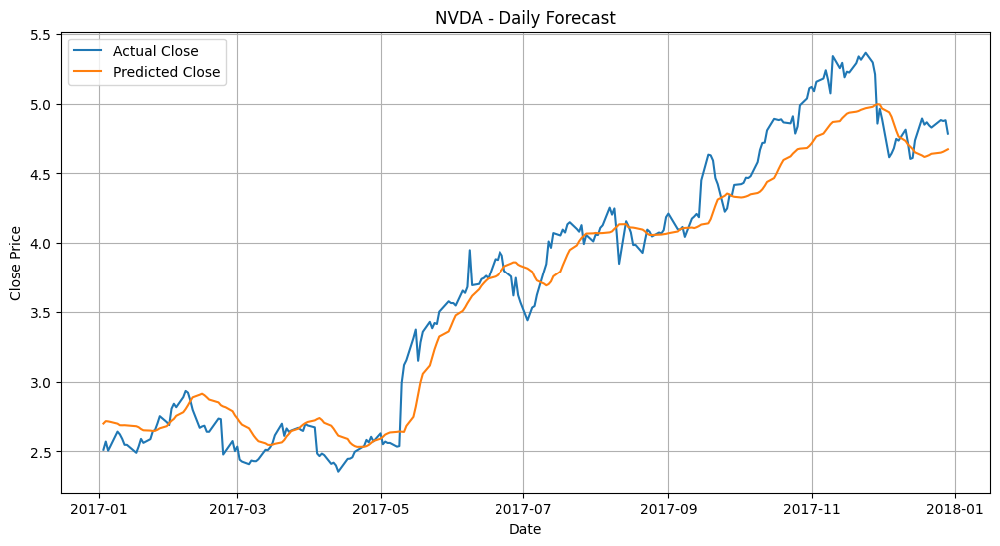

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step

📊 Results for SPY
RMSE: 2.4643
MAE : 1.9942
R^2 : 0.9475
MAPE: 0.0091


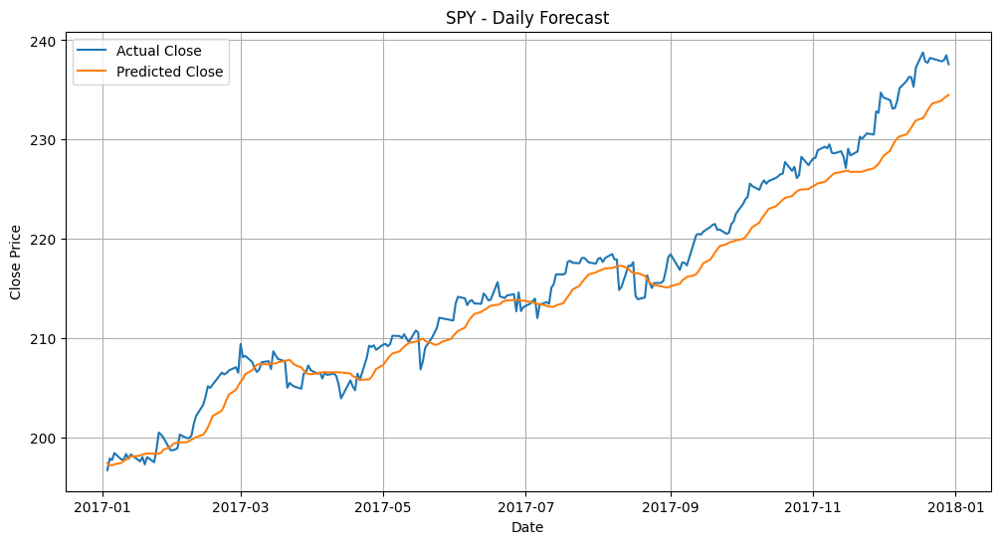

📉 Mean Scaled RMSE over 4 stocks: 0.0762630670269339


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# model 2

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step

📊 Results for AAPL
RMSE: 6.6148
MAE : 5.7438
R^2 : 0.8549
MAPE: 0.0332


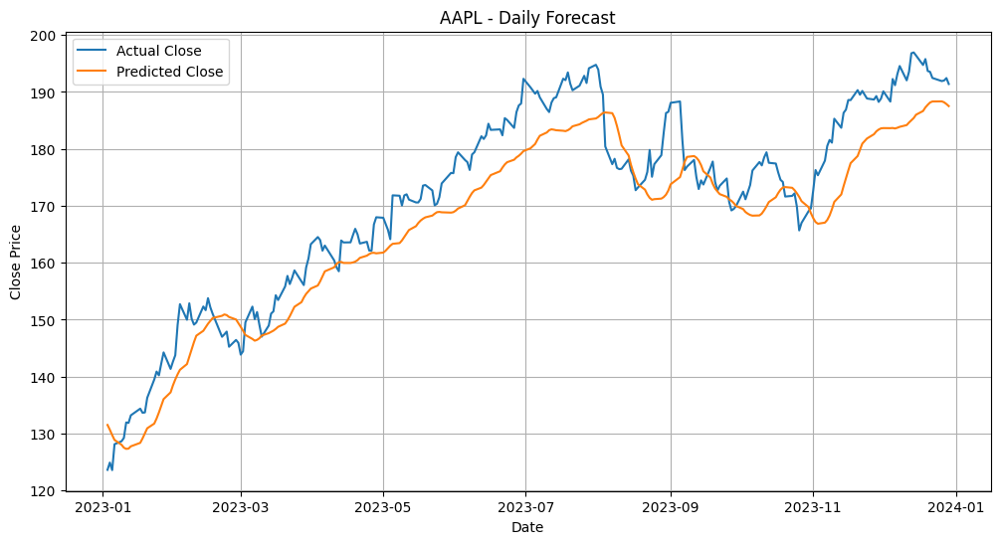

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 63ms/step

📊 Results for JPM
RMSE: 3.3271
MAE : 2.6351
R^2 : 0.8824
MAPE: 0.0192


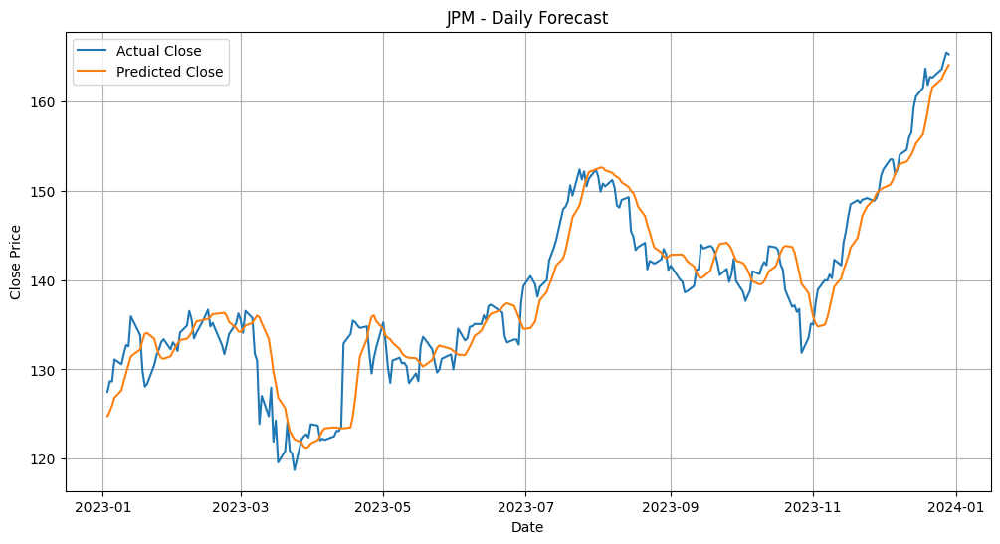

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step

📊 Results for NVDA
RMSE: 3.9609
MAE : 3.3856
R^2 : 0.8638
MAPE: 0.0904


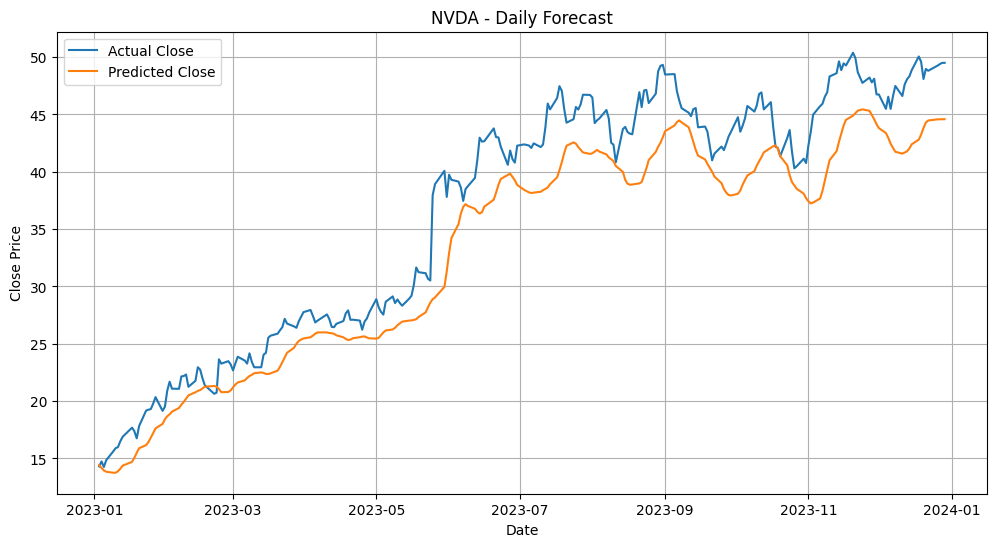

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 94ms/step

📊 Results for SPY
RMSE: 7.6092
MAE : 6.1558
R^2 : 0.8987
MAPE: 0.0148


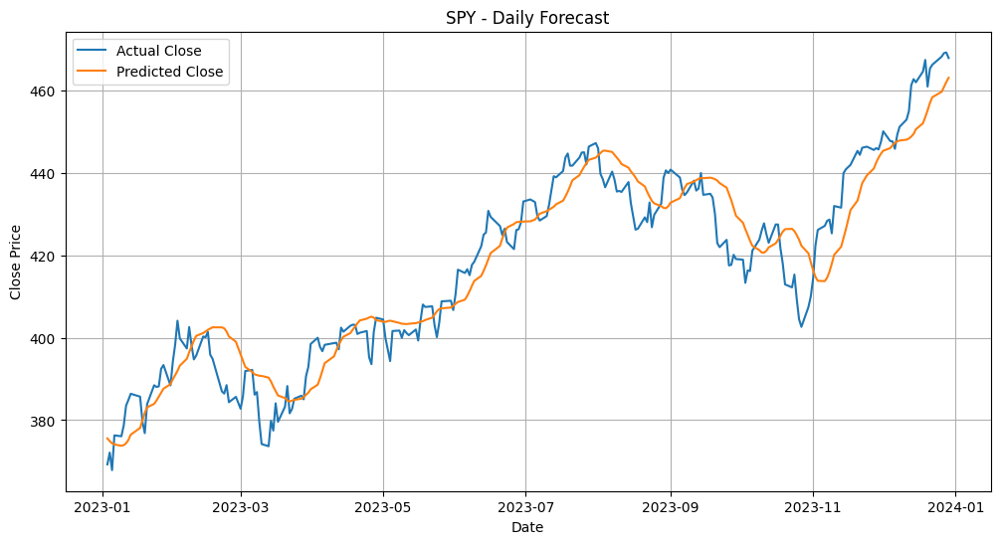

📉 Mean Scaled RMSE over 4 stocks: 0.0865105012095421


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step

📊 Results for AAPL
RMSE: 2.2053
MAE : 1.7818
R^2 : 0.9327
MAPE: 0.0341


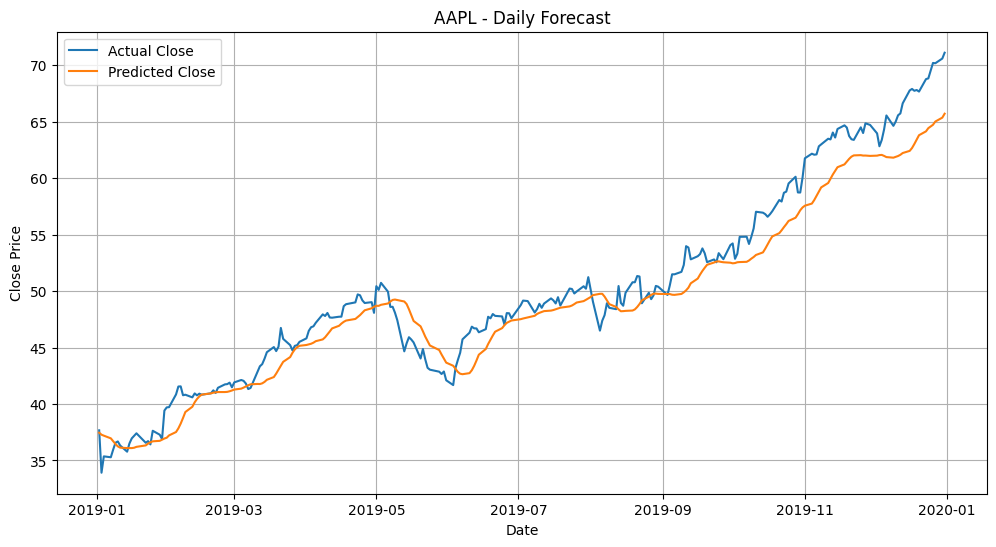

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 65ms/step

📊 Results for JPM
RMSE: 3.9761
MAE : 3.1783
R^2 : 0.8279
MAPE: 0.0314


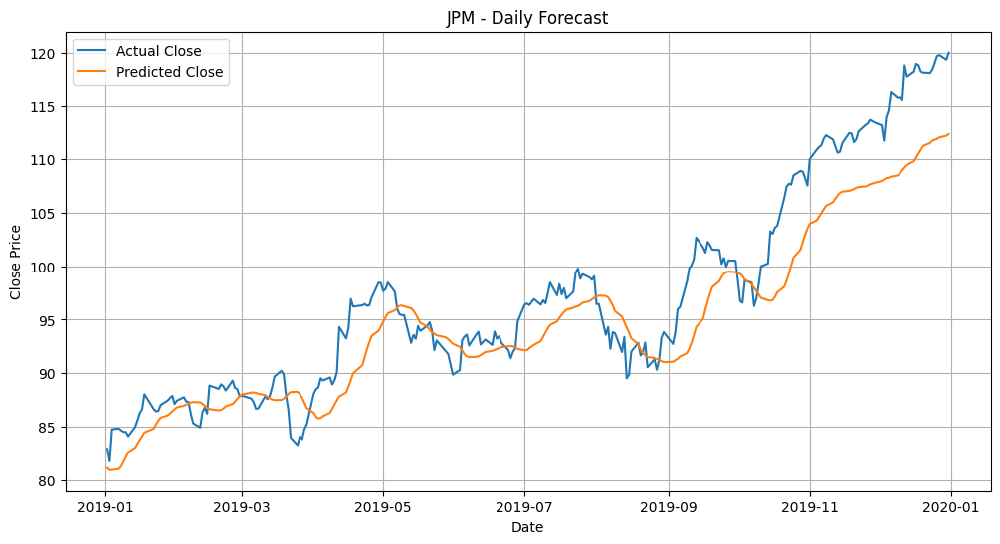

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step

📊 Results for NVDA
RMSE: 0.2823
MAE : 0.2126
R^2 : 0.7951
MAPE: 0.0518


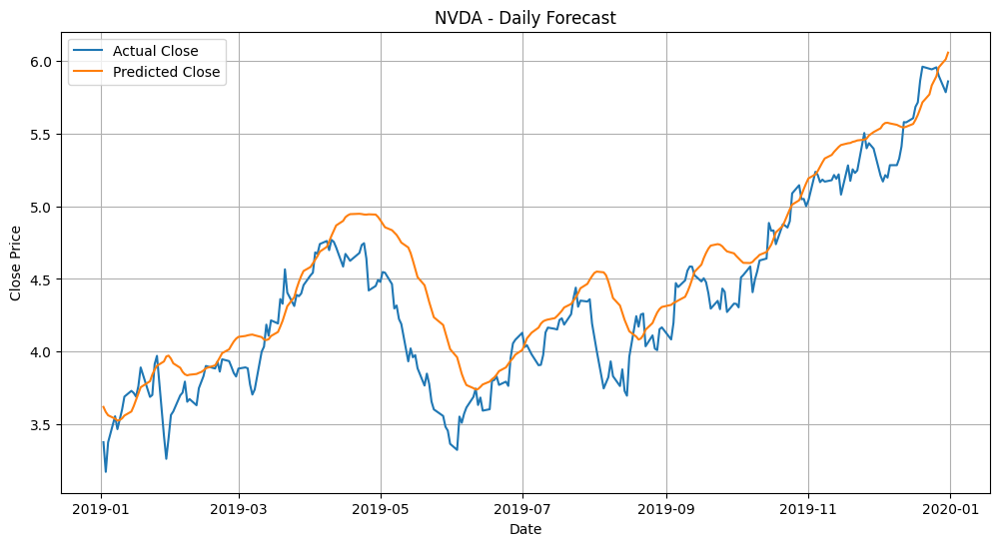

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 63ms/step

📊 Results for SPY
RMSE: 6.7934
MAE : 6.1257
R^2 : 0.7956
MAPE: 0.0229


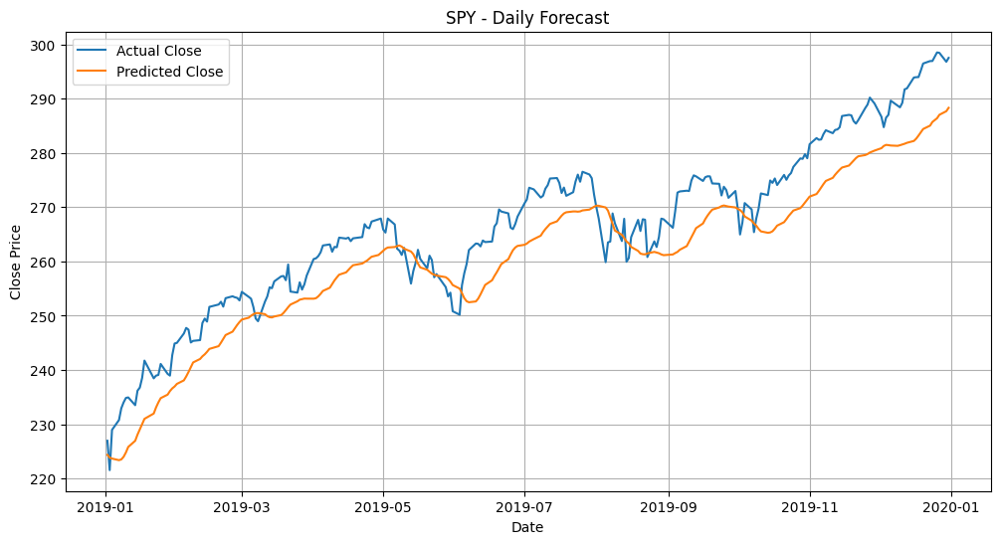

📉 Mean Scaled RMSE over 4 stocks: 0.08819810849923021


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step

📊 Results for AAPL
RMSE: 2.4119
MAE : 2.1698
R^2 : 0.5406
MAPE: 0.0599


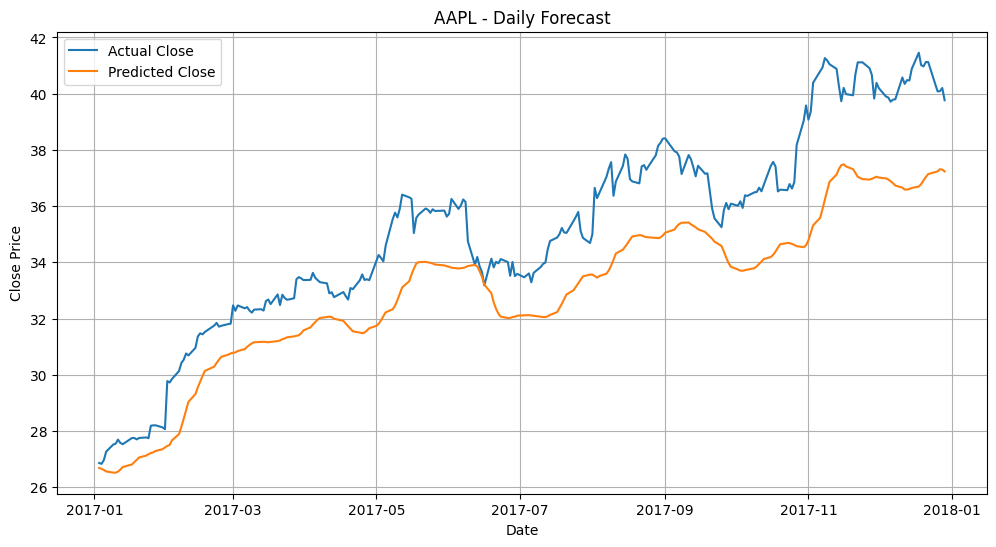

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step

📊 Results for JPM
RMSE: 1.7932
MAE : 1.4620
R^2 : 0.8948
MAPE: 0.0198


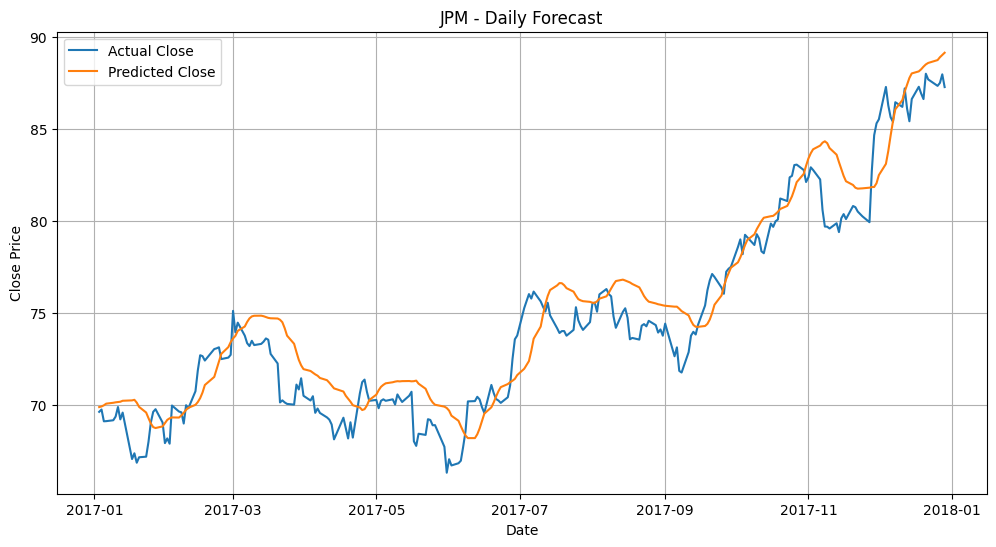

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step

📊 Results for NVDA
RMSE: 0.2078
MAE : 0.1670
R^2 : 0.9513
MAPE: 0.0466


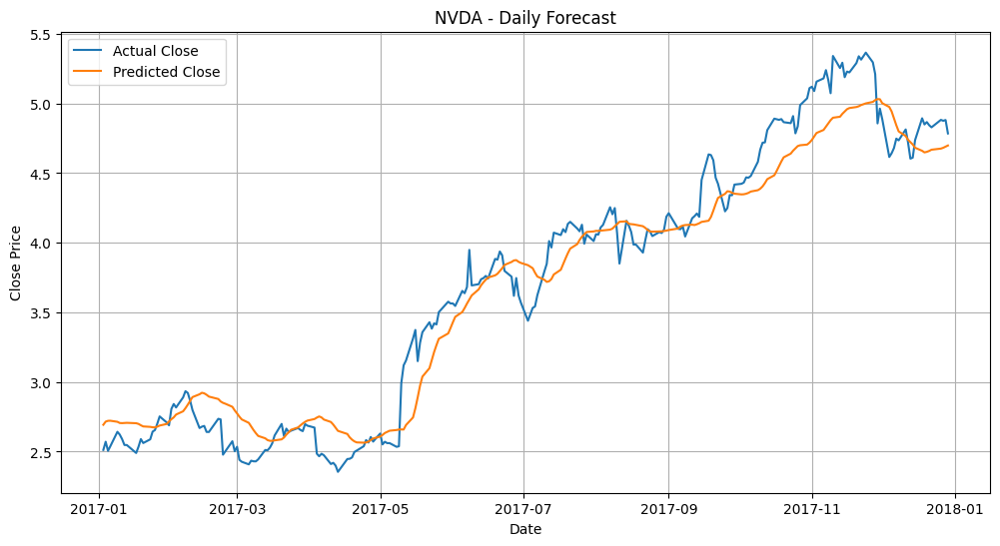

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 76ms/step

📊 Results for SPY
RMSE: 4.5880
MAE : 3.7252
R^2 : 0.8180
MAPE: 0.0168


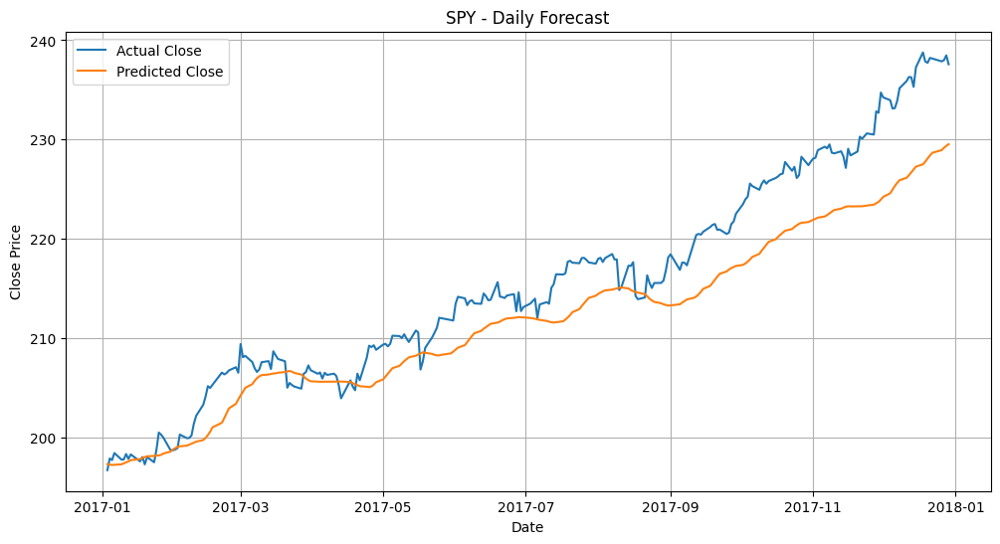

📉 Mean Scaled RMSE over 4 stocks: 0.10639484307869386


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Model 3

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 168ms/step

📊 Results for AAPL
RMSE: 10.9813
MAE : 9.6036
R^2 : 0.6001
MAPE: 0.0551


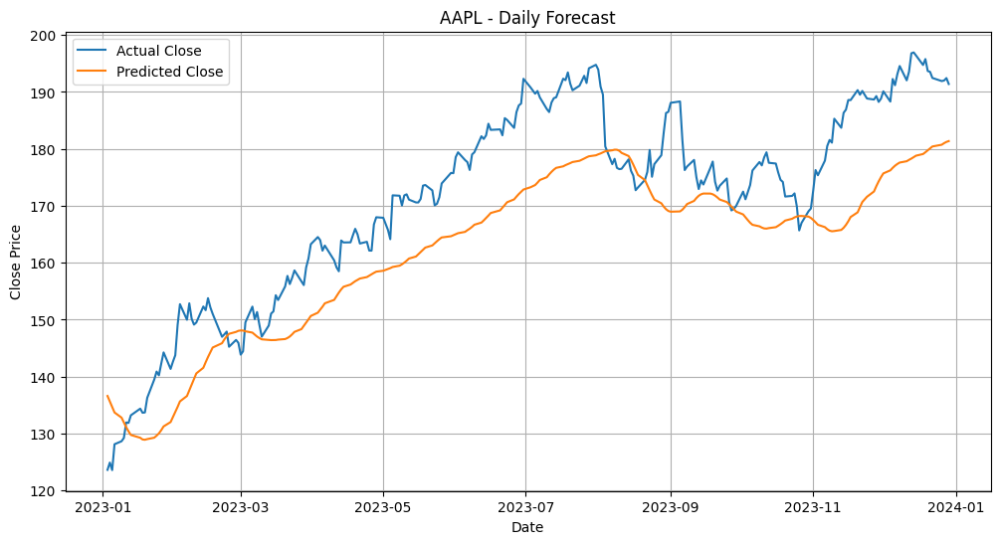

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step

📊 Results for JPM
RMSE: 4.1200
MAE : 3.2295
R^2 : 0.8196
MAPE: 0.0237


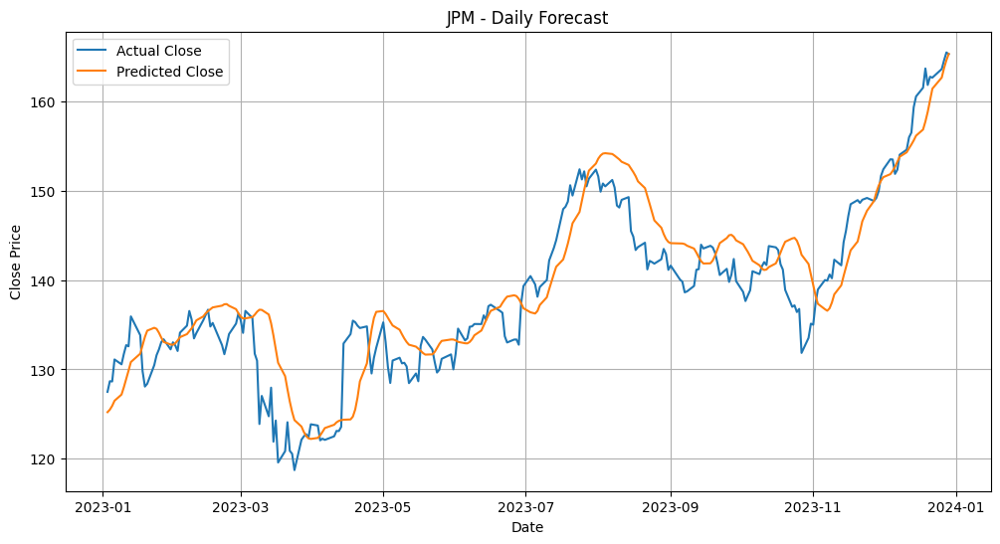

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step

📊 Results for NVDA
RMSE: 2.4584
MAE : 1.8269
R^2 : 0.9475
MAPE: 0.0491


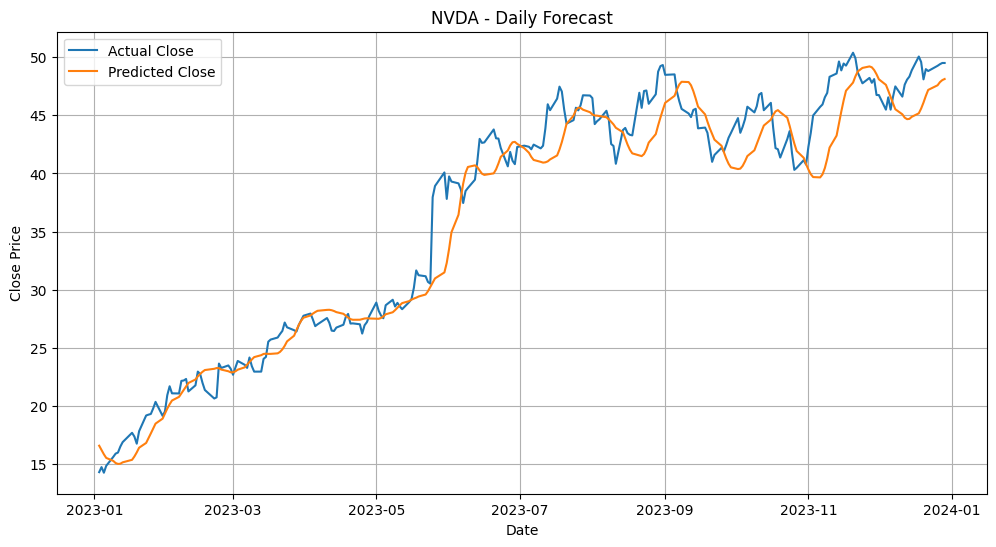

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step

📊 Results for SPY
RMSE: 12.8994
MAE : 10.9814
R^2 : 0.7090
MAPE: 0.0260


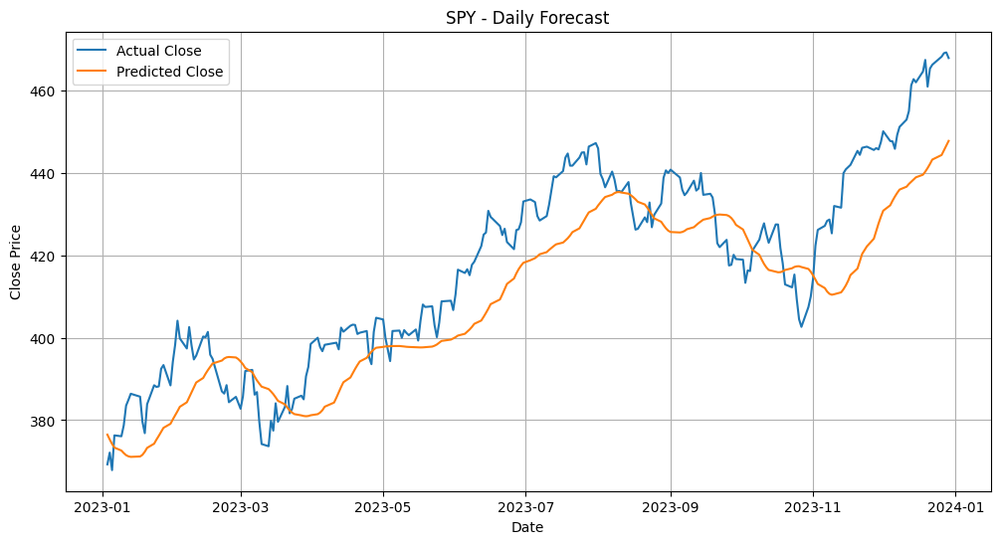

📉 Mean Scaled RMSE over 4 stocks: 0.10828381609848045


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step

📊 Results for AAPL
RMSE: 2.4559
MAE : 1.9773
R^2 : 0.9166
MAPE: 0.0386


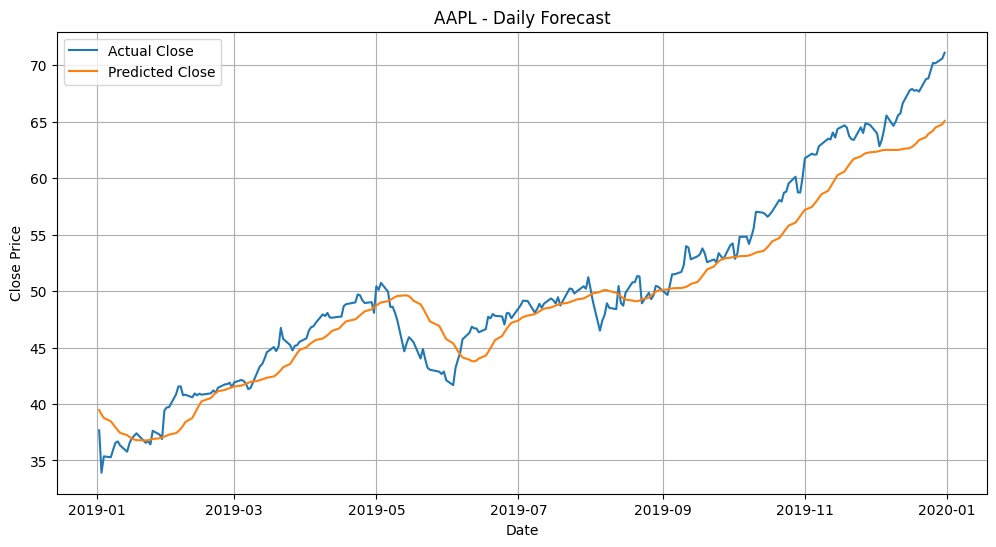

8/8 ━━━━━━━━━━━━━━━━━━━━ 4s 521ms/step

📊 Results for JPM
RMSE: 5.5377
MAE : 4.4613
R^2 : 0.6662
MAPE: 0.0440


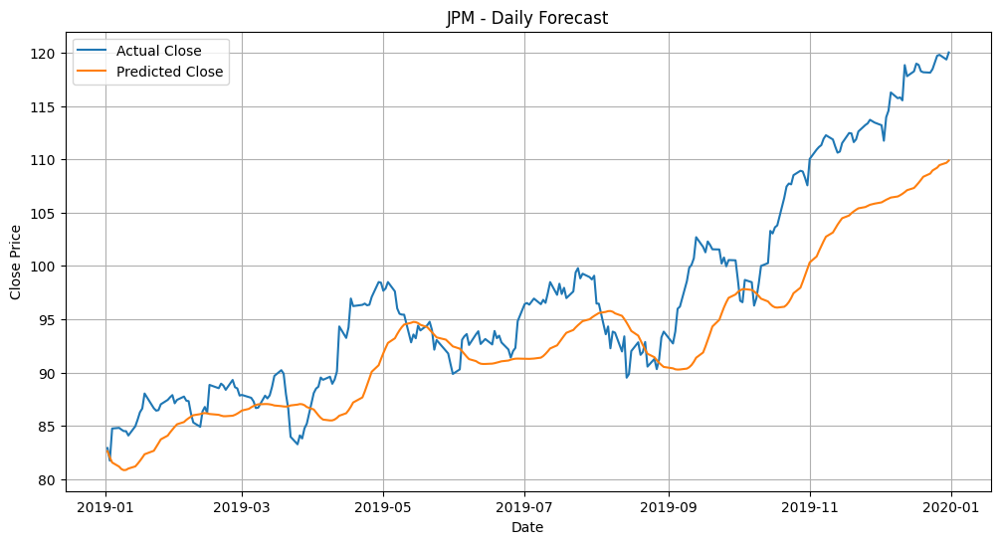

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step

📊 Results for NVDA
RMSE: 0.2927
MAE : 0.2445
R^2 : 0.7798
MAPE: 0.0572


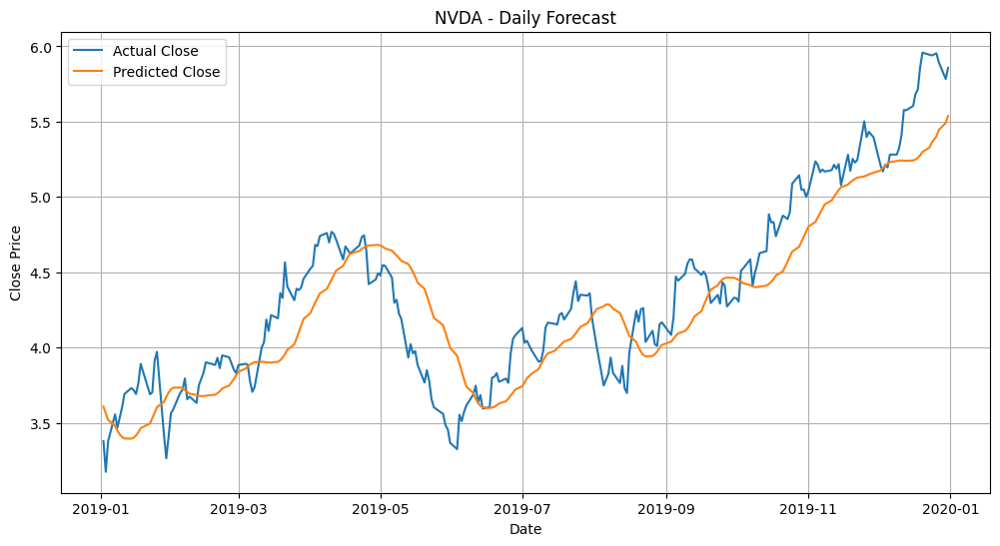

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step

📊 Results for SPY
RMSE: 8.6130
MAE : 7.6167
R^2 : 0.6714
MAPE: 0.0283


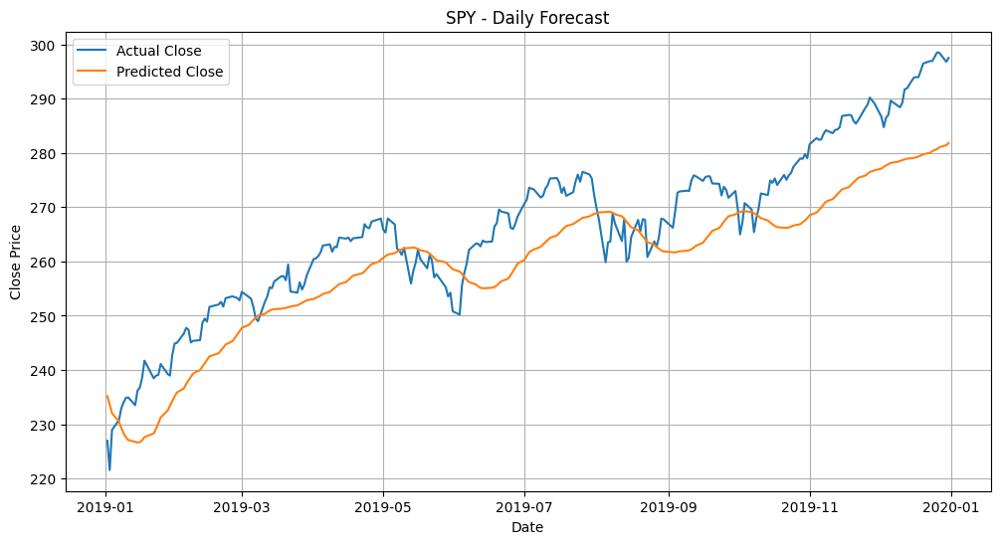

📉 Mean Scaled RMSE over 4 stocks: 0.1069235801800842


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step

📊 Results for AAPL
RMSE: 2.2239
MAE : 1.9599
R^2 : 0.6094
MAPE: 0.0543


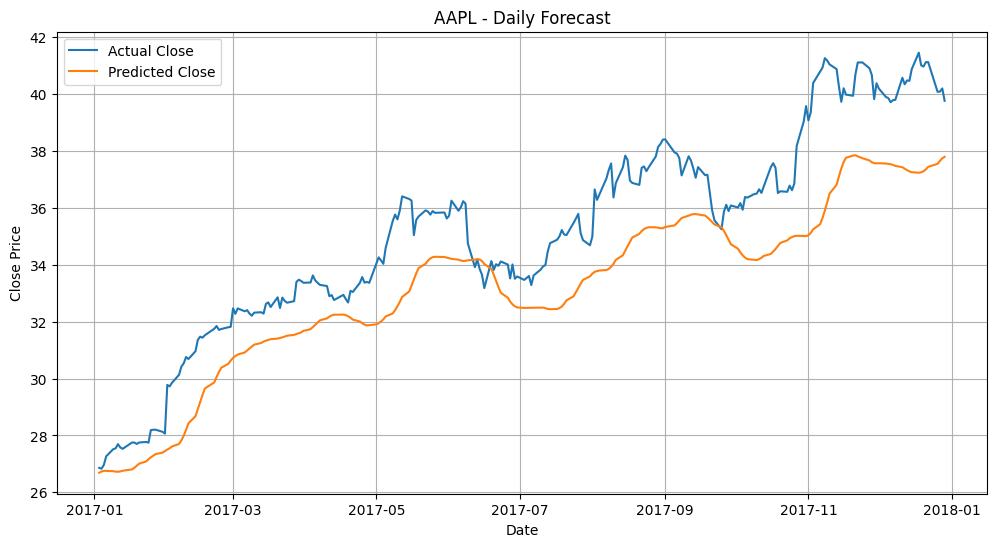

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step

📊 Results for JPM
RMSE: 2.9093
MAE : 2.3631
R^2 : 0.7231
MAPE: 0.0312


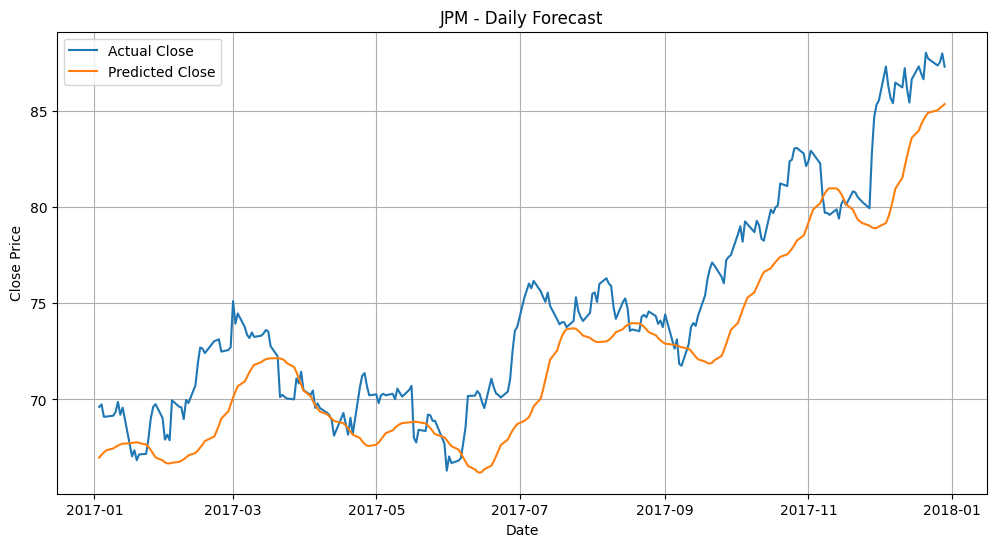

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 115ms/step

📊 Results for NVDA
RMSE: 0.3370
MAE : 0.2694
R^2 : 0.8718
MAPE: 0.0712


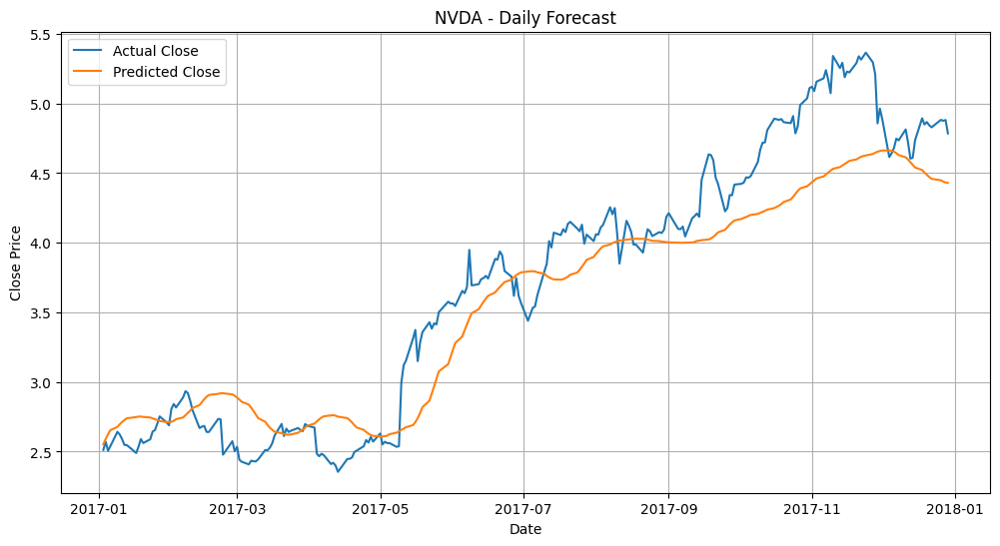

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 106ms/step

📊 Results for SPY
RMSE: 7.6137
MAE : 6.8720
R^2 : 0.4989
MAPE: 0.0313


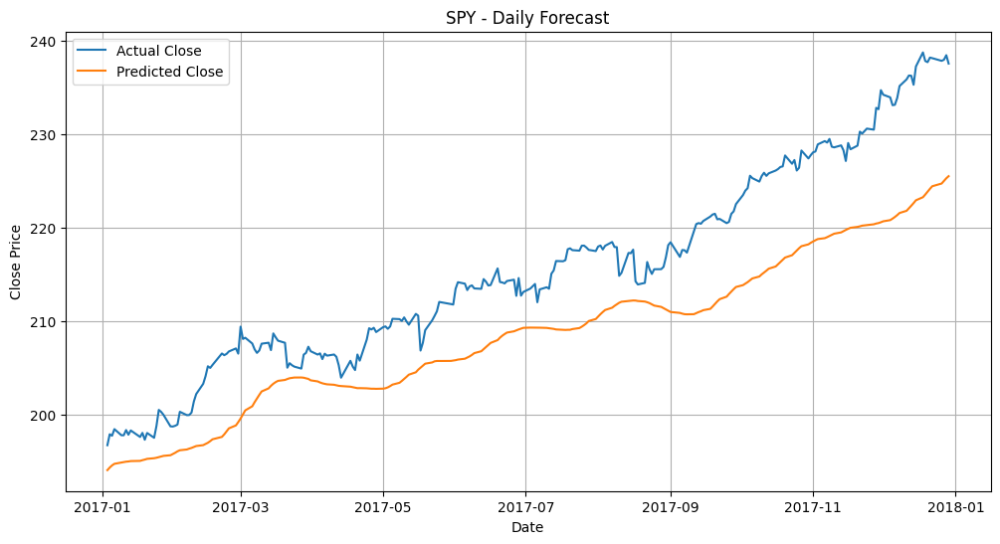

📉 Mean Scaled RMSE over 4 stocks: 0.14474571005453013


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Robust Scale Model 1

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for AAPL
RMSE: 6.9766
MAE : 6.0827
R^2 : 0.8386
MAPE: 0.0351


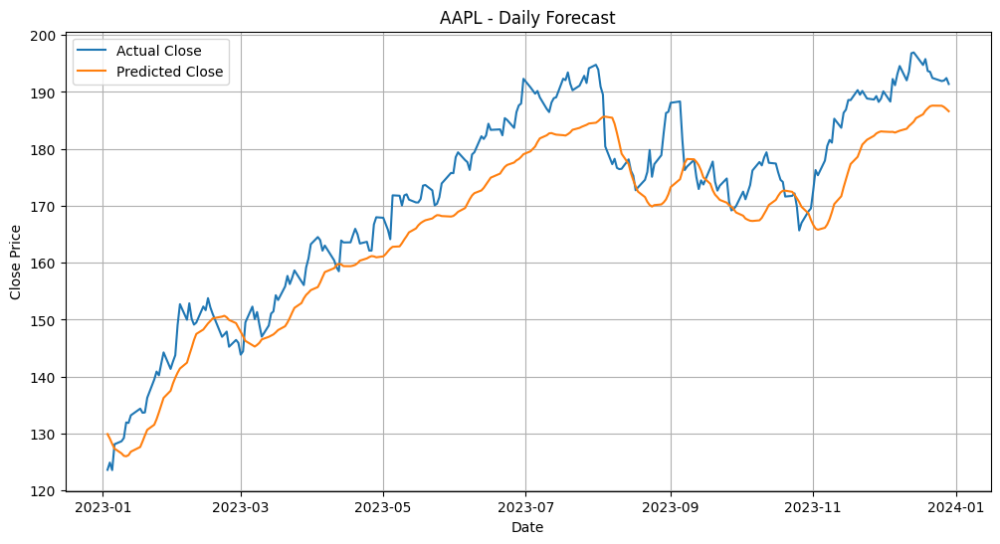

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for JPM
RMSE: 3.1510
MAE : 2.4711
R^2 : 0.8945
MAPE: 0.0179


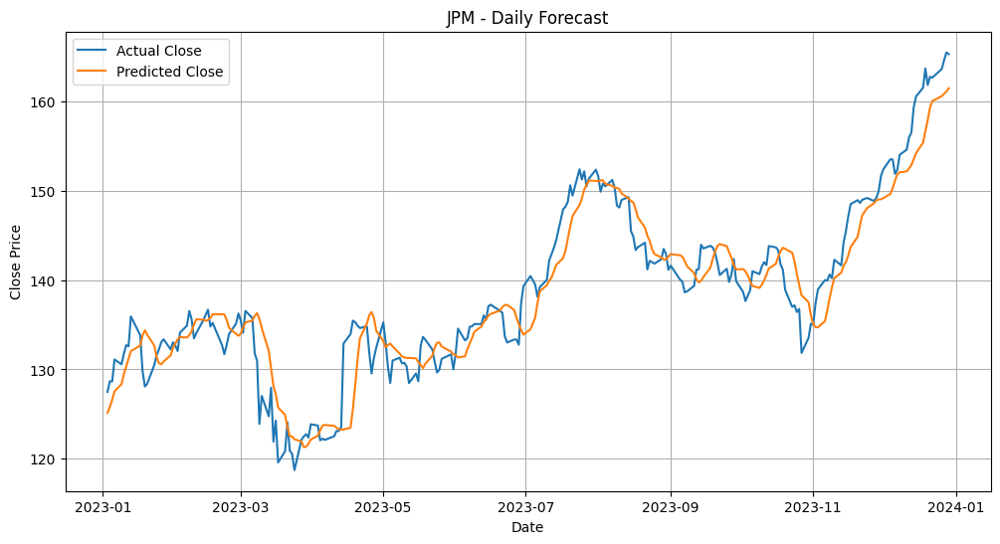

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step

📊 Results for NVDA
RMSE: 2.6562
MAE : 2.0757
R^2 : 0.9387
MAPE: 0.0540


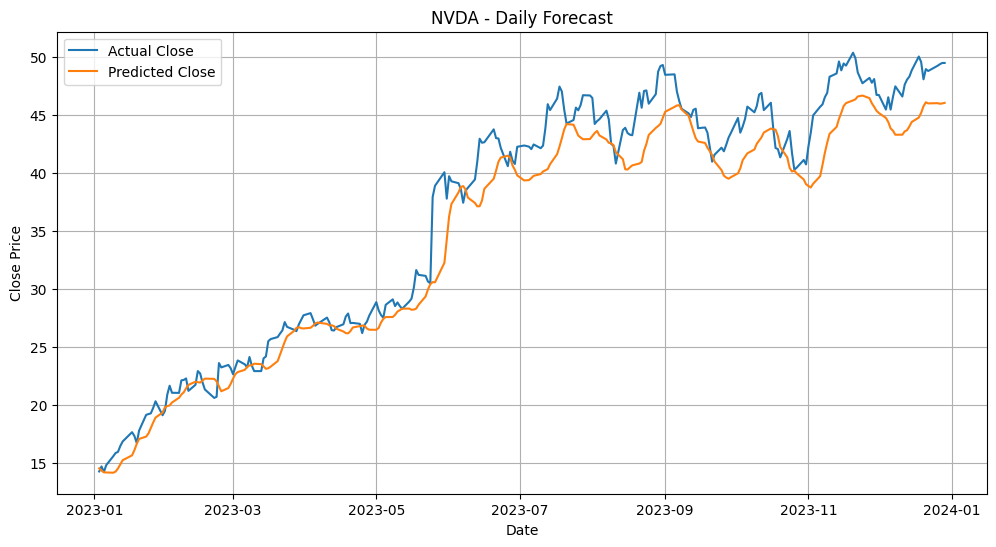

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step

📊 Results for SPY
RMSE: 7.2666
MAE : 5.9197
R^2 : 0.9077
MAPE: 0.0141


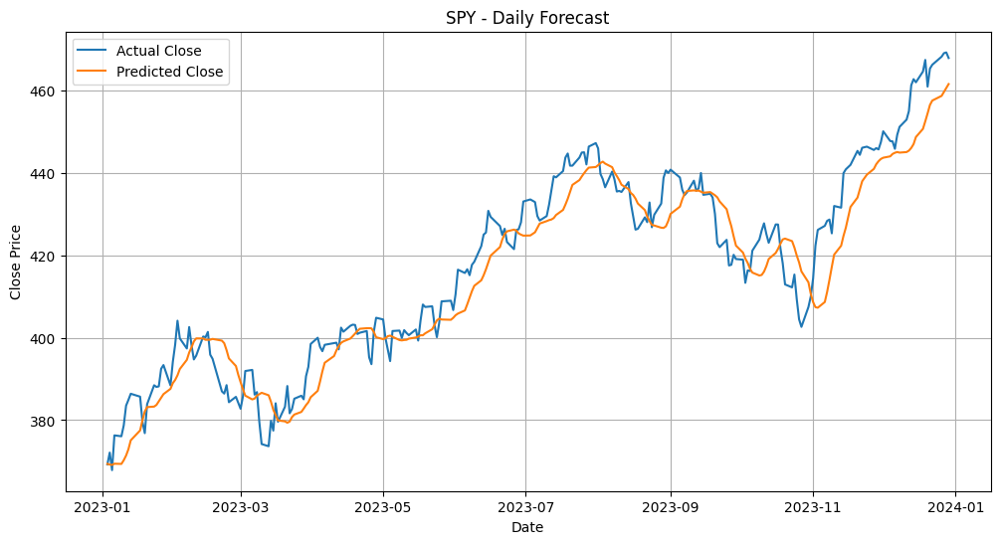

📉 Mean Scaled RMSE over 4 stocks: 0.07692943504985933


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for AAPL
RMSE: 1.7682
MAE : 1.3904
R^2 : 0.9568
MAPE: 0.0266


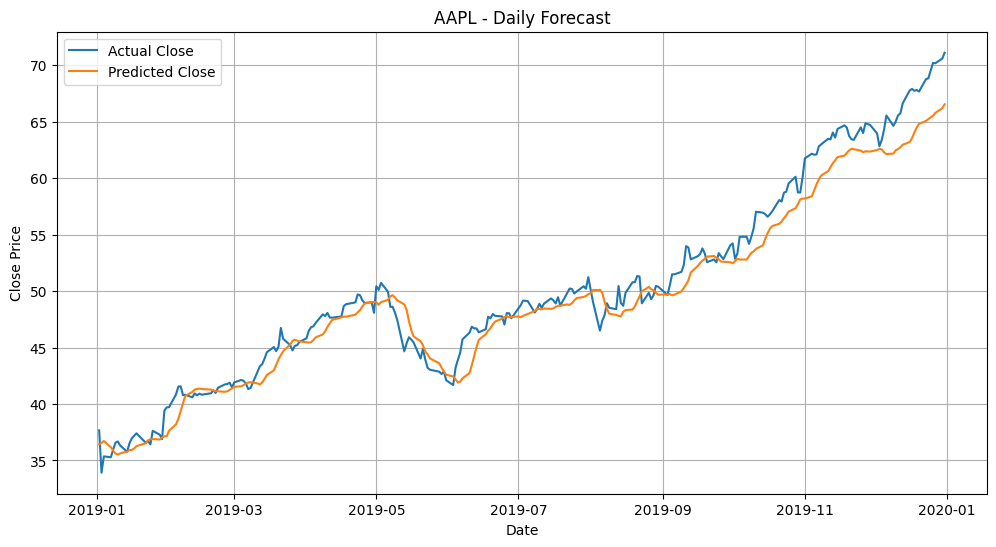

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step

📊 Results for JPM
RMSE: 3.2251
MAE : 2.5519
R^2 : 0.8868
MAPE: 0.0253


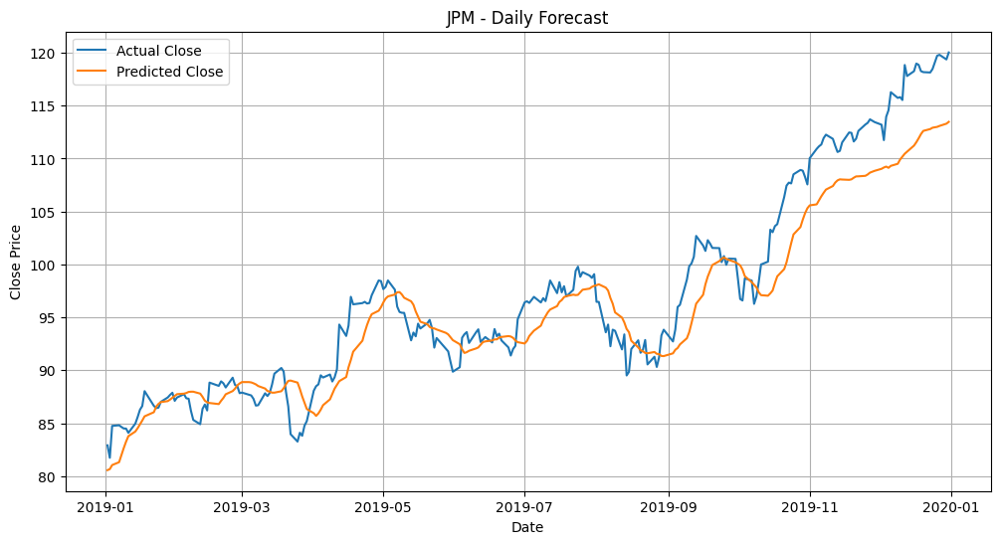

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step

📊 Results for NVDA
RMSE: 0.1989
MAE : 0.1542
R^2 : 0.8983
MAPE: 0.0370


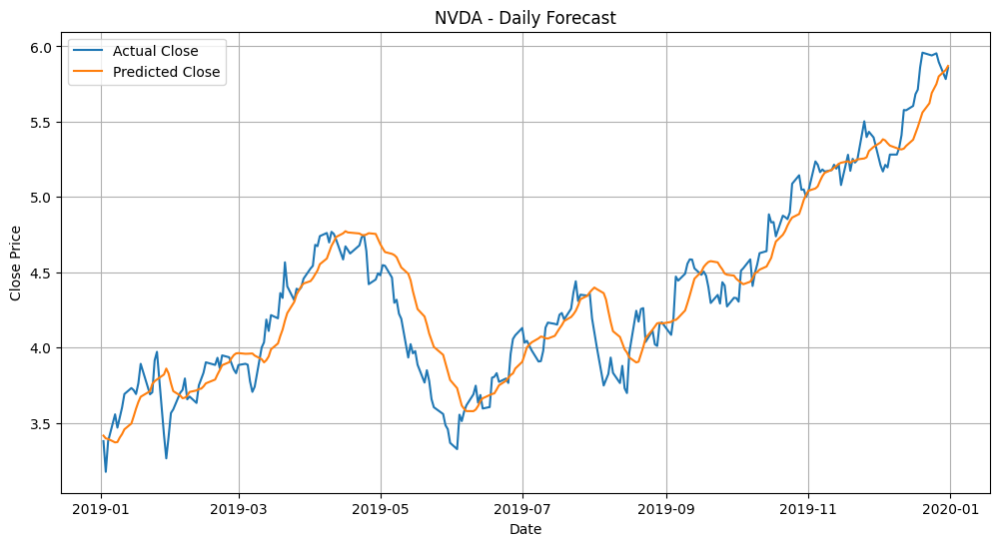

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for SPY
RMSE: 5.5946
MAE : 4.7968
R^2 : 0.8614
MAPE: 0.0178


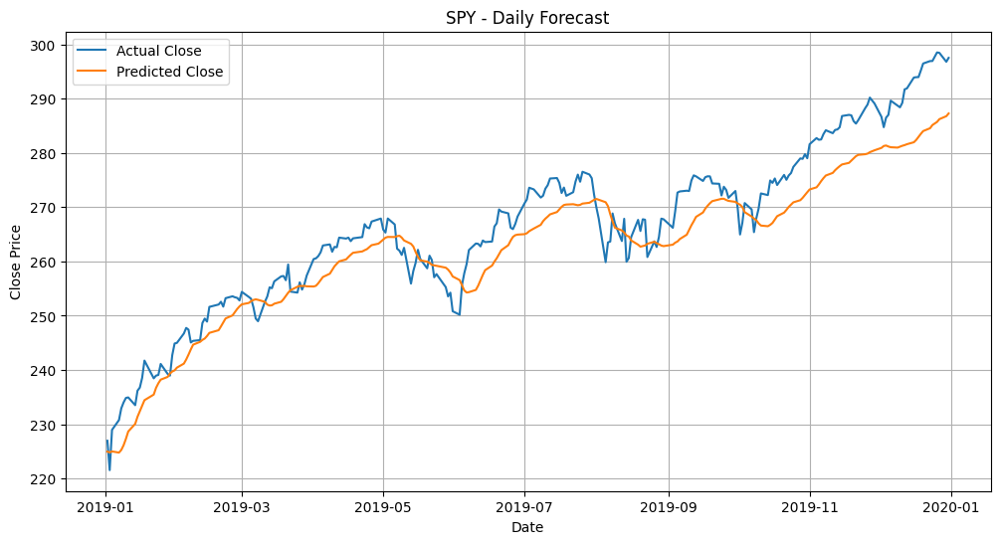

📉 Mean Scaled RMSE over 4 stocks: 0.06897586165748983


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 129ms/step

📊 Results for AAPL
RMSE: 1.6973
MAE : 1.4783
R^2 : 0.7725
MAPE: 0.0407


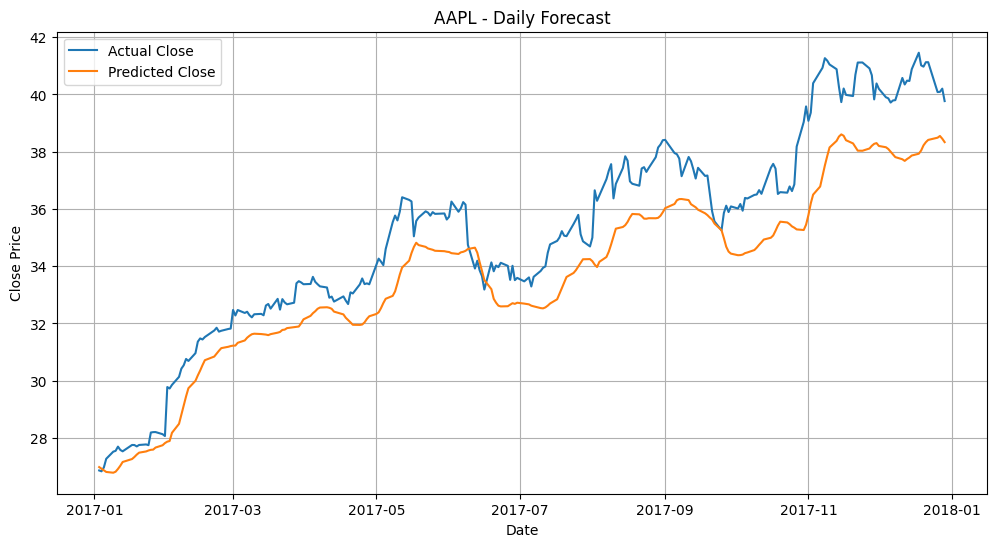

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for JPM
RMSE: 2.3477
MAE : 1.8176
R^2 : 0.8197
MAPE: 0.0239


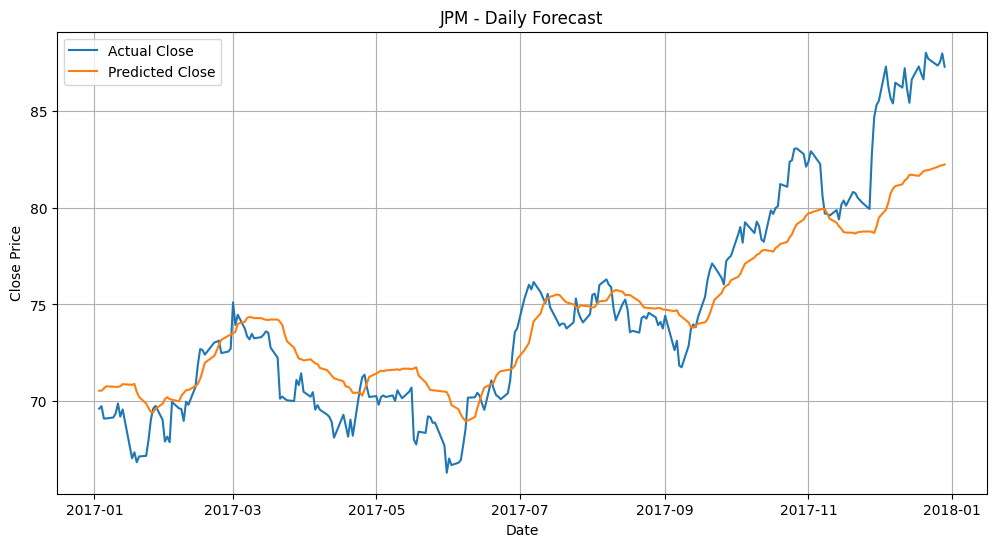

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for NVDA
RMSE: 1.3401
MAE : 1.0434
R^2 : -1.0267
MAPE: 0.2406


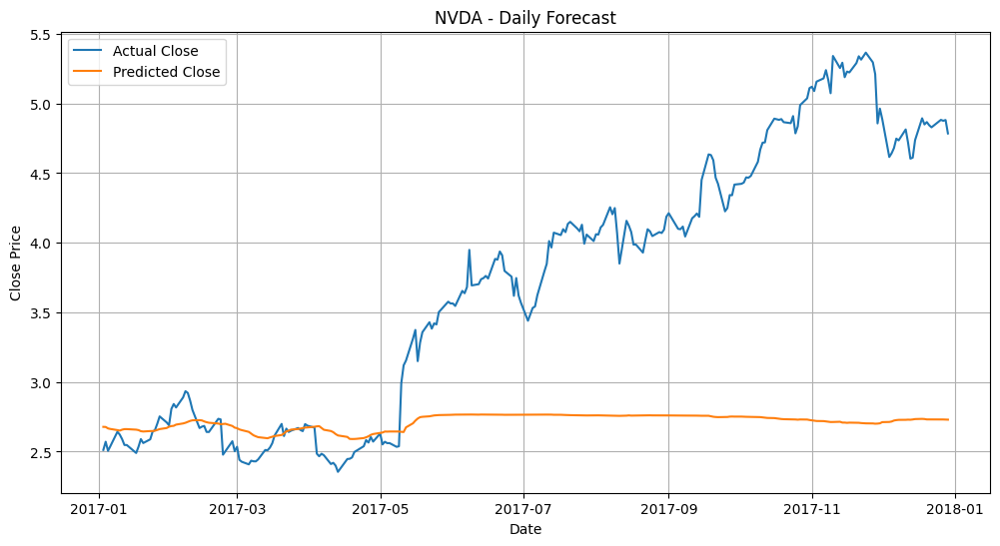

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step

📊 Results for SPY
RMSE: 3.0864
MAE : 2.5614
R^2 : 0.9177
MAPE: 0.0116


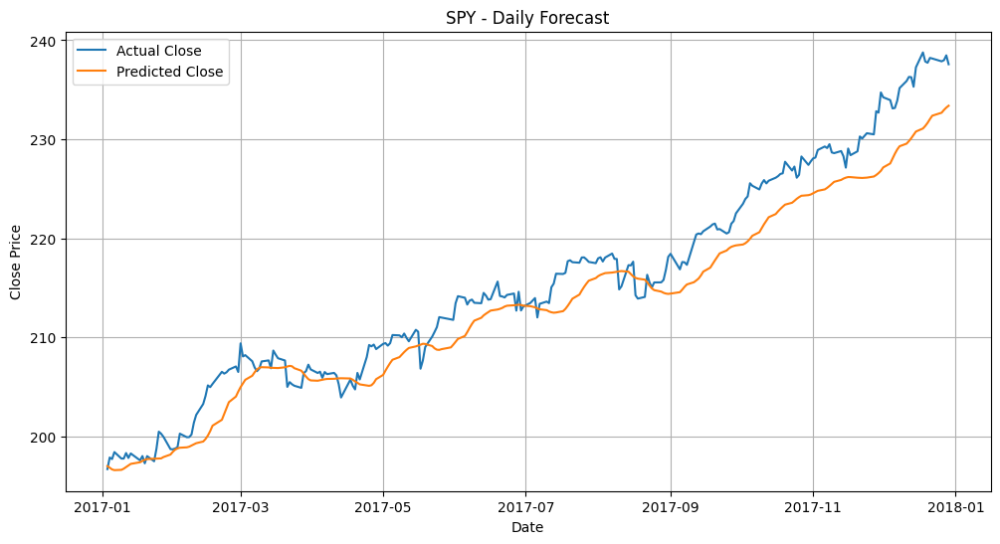

📉 Mean Scaled RMSE over 4 stocks: 0.185697272767853


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Robust scale model 2

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step

📊 Results for AAPL
RMSE: 5.4180
MAE : 4.6350
R^2 : 0.9027
MAPE: 0.0269


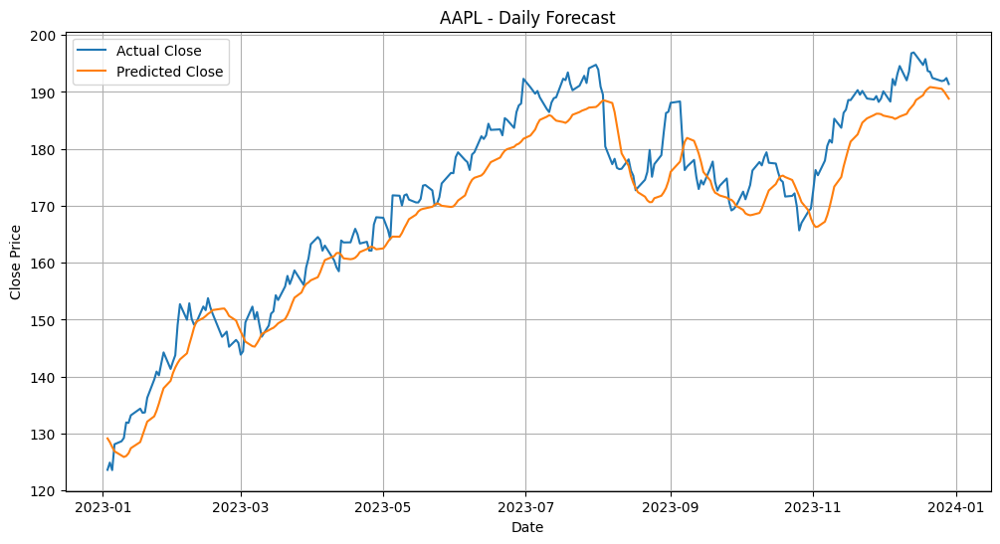

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step

📊 Results for JPM
RMSE: 3.0536
MAE : 2.3691
R^2 : 0.9009
MAPE: 0.0171


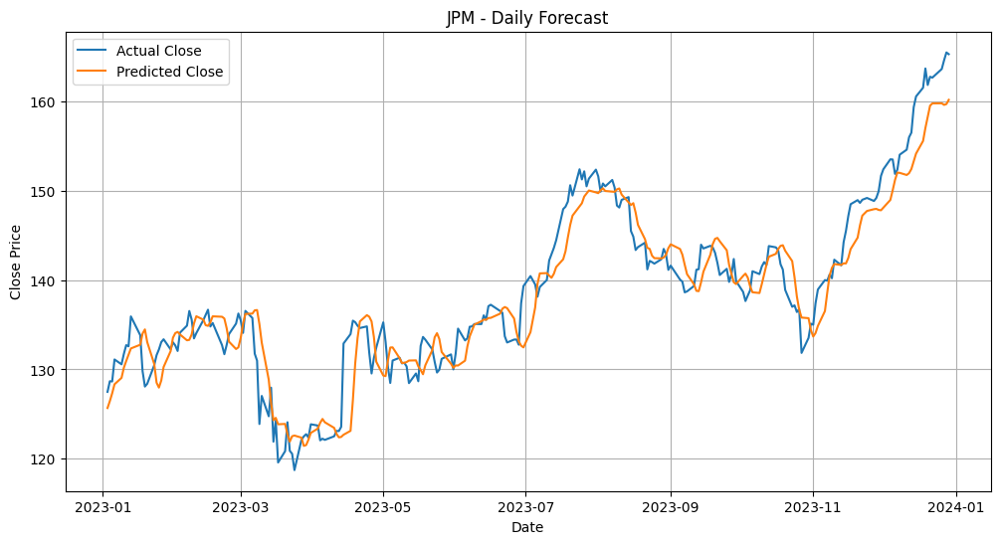

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step

📊 Results for NVDA
RMSE: 4.2871
MAE : 3.5029
R^2 : 0.8404
MAPE: 0.0862


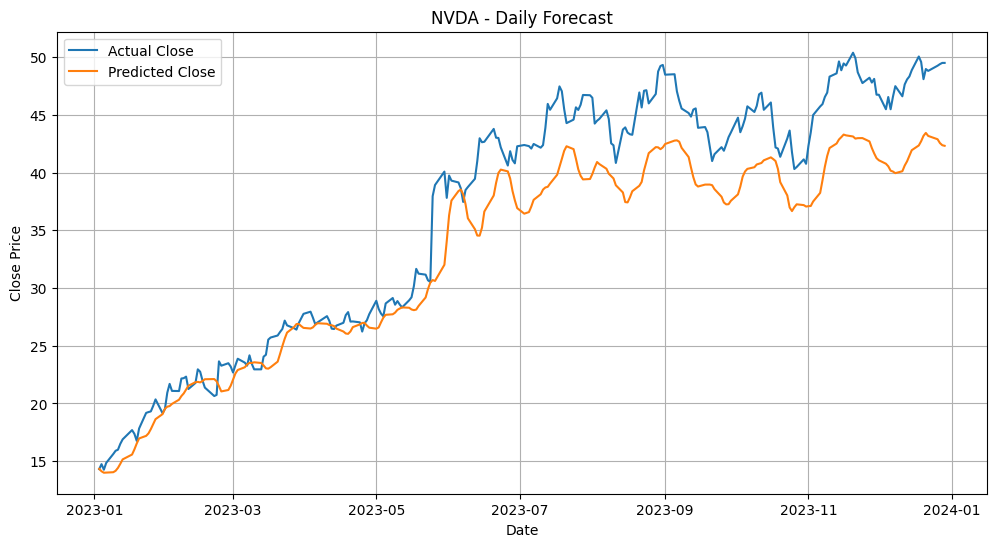

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step

📊 Results for SPY
RMSE: 7.1870
MAE : 5.8482
R^2 : 0.9097
MAPE: 0.0140


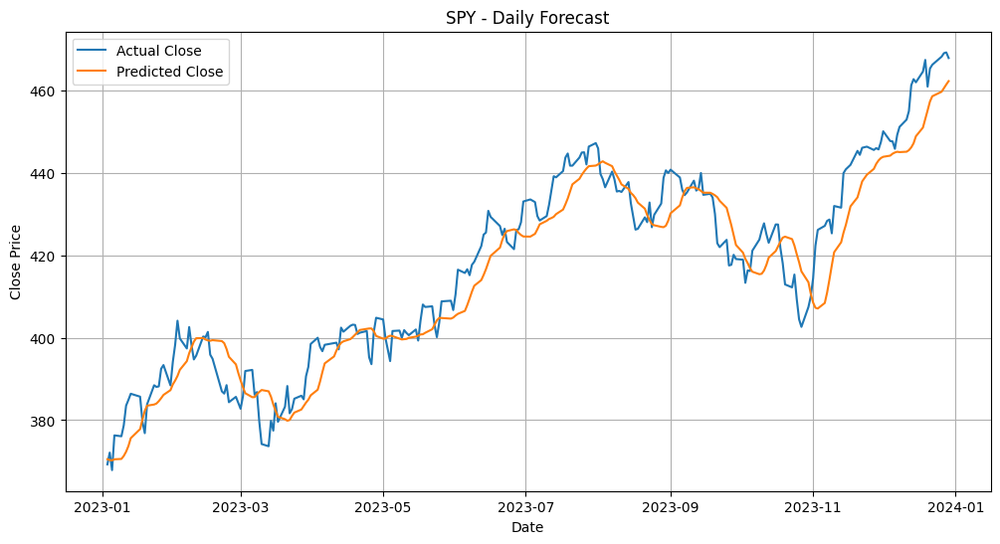

📉 Mean Scaled RMSE over 4 stocks: 0.08218359714645872


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 77ms/step

📊 Results for AAPL
RMSE: 1.4414
MAE : 1.1336
R^2 : 0.9713
MAPE: 0.0225


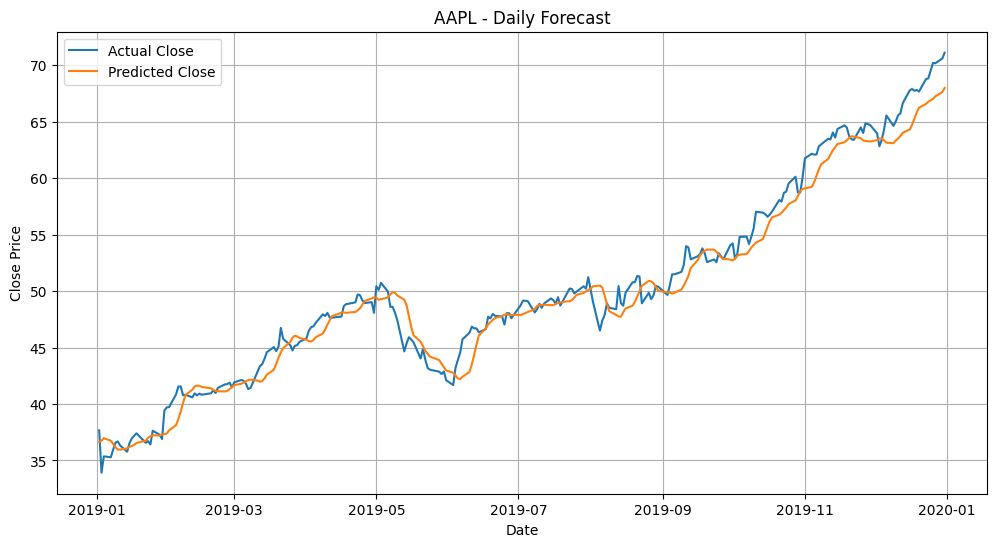

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 101ms/step

📊 Results for JPM
RMSE: 4.4423
MAE : 3.4177
R^2 : 0.7852
MAPE: 0.0334


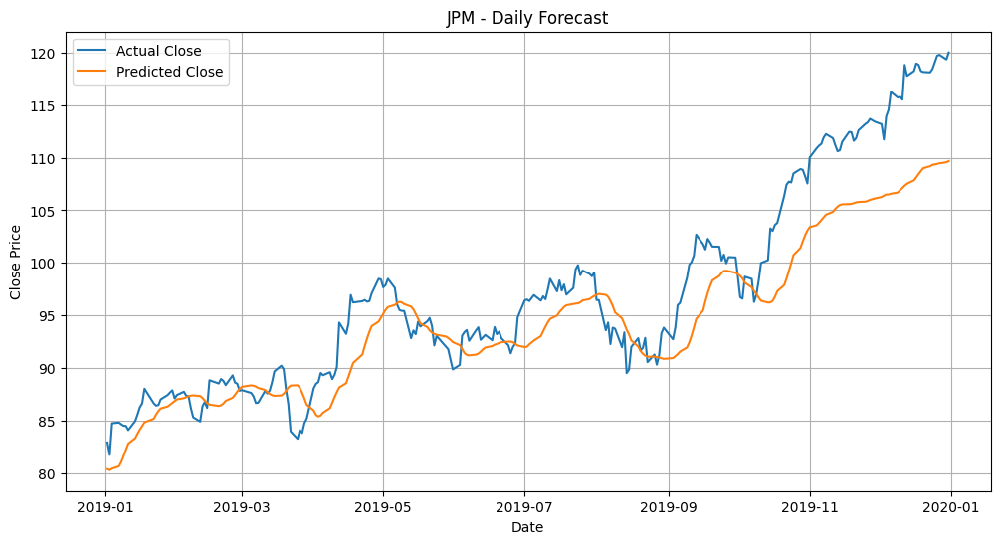

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step

📊 Results for NVDA
RMSE: 0.2151
MAE : 0.1787
R^2 : 0.8810
MAPE: 0.0417


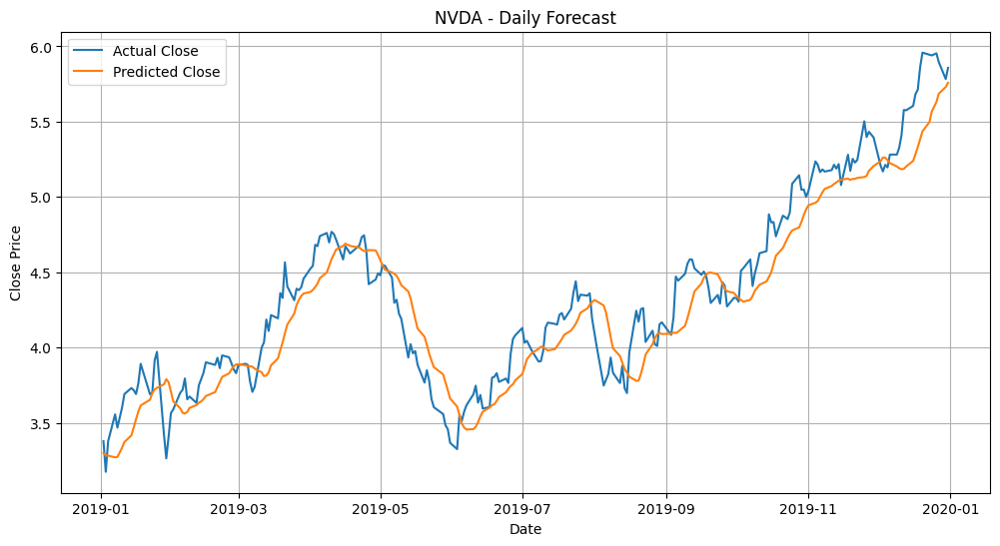

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 74ms/step

📊 Results for SPY
RMSE: 5.8016
MAE : 4.8777
R^2 : 0.8509
MAPE: 0.0180


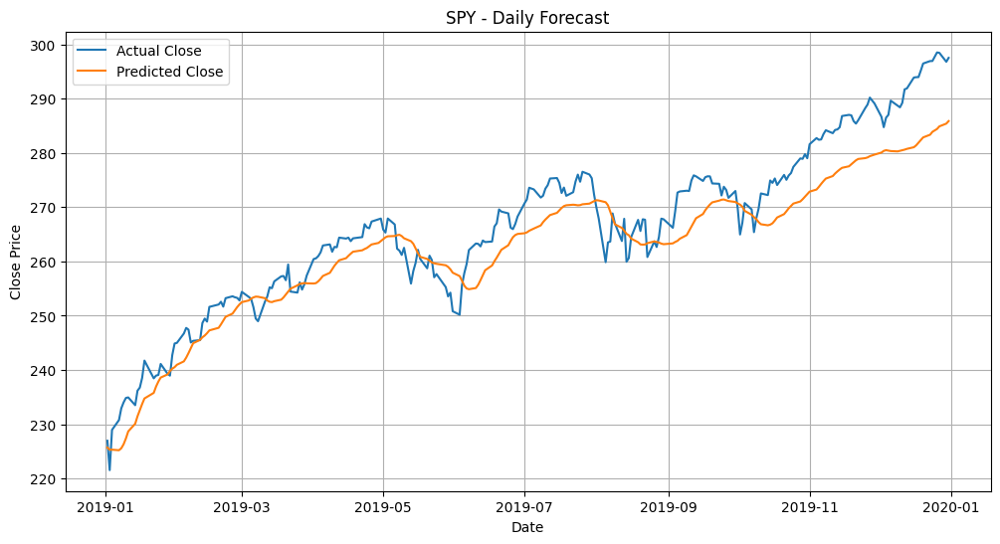

📉 Mean Scaled RMSE over 4 stocks: 0.07685434836453976


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 129ms/step

📊 Results for AAPL
RMSE: 1.6254
MAE : 1.4678
R^2 : 0.7914
MAPE: 0.0411


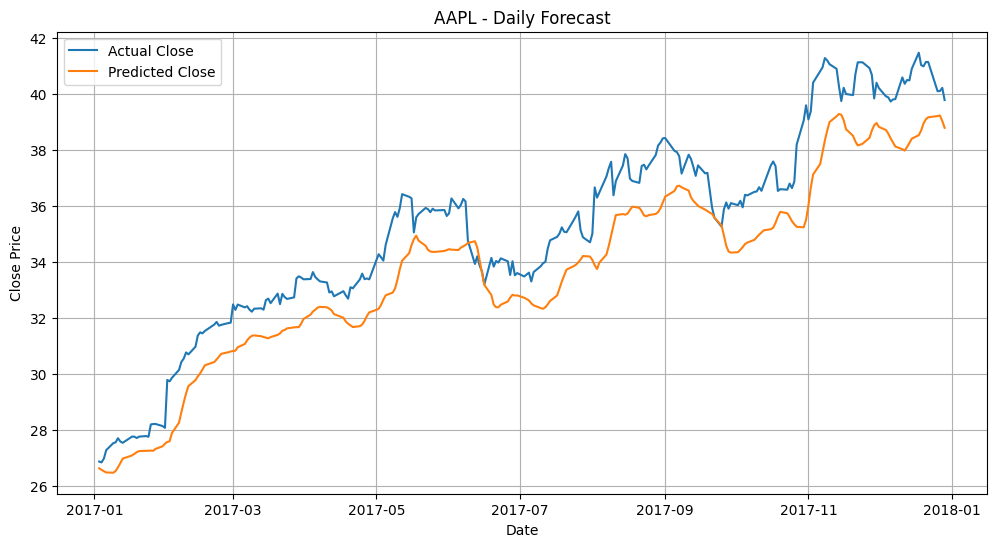

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 84ms/step

📊 Results for JPM
RMSE: 3.7923
MAE : 2.8297
R^2 : 0.5294
MAPE: 0.0360


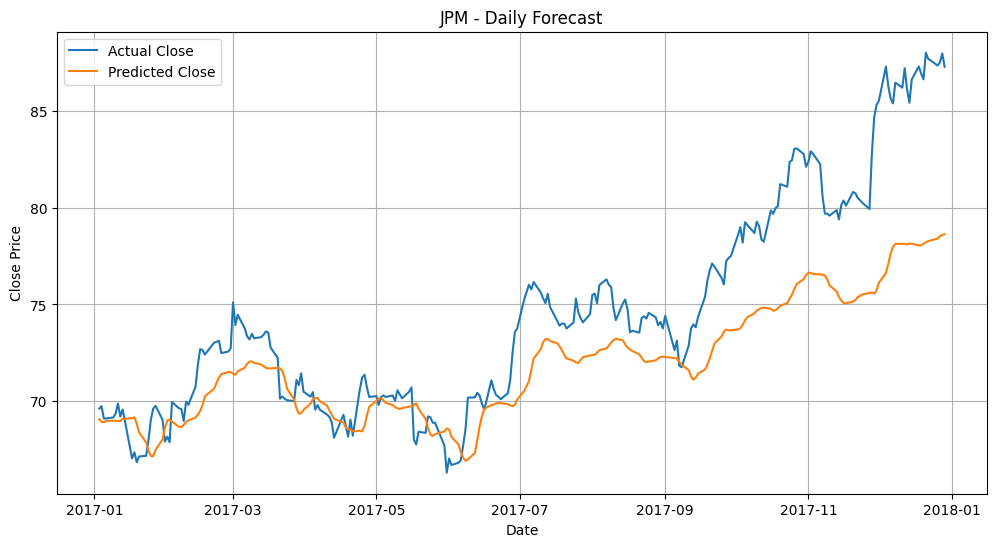

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step

📊 Results for NVDA
RMSE: 1.2592
MAE : 0.9783
R^2 : -0.7891
MAPE: 0.2250


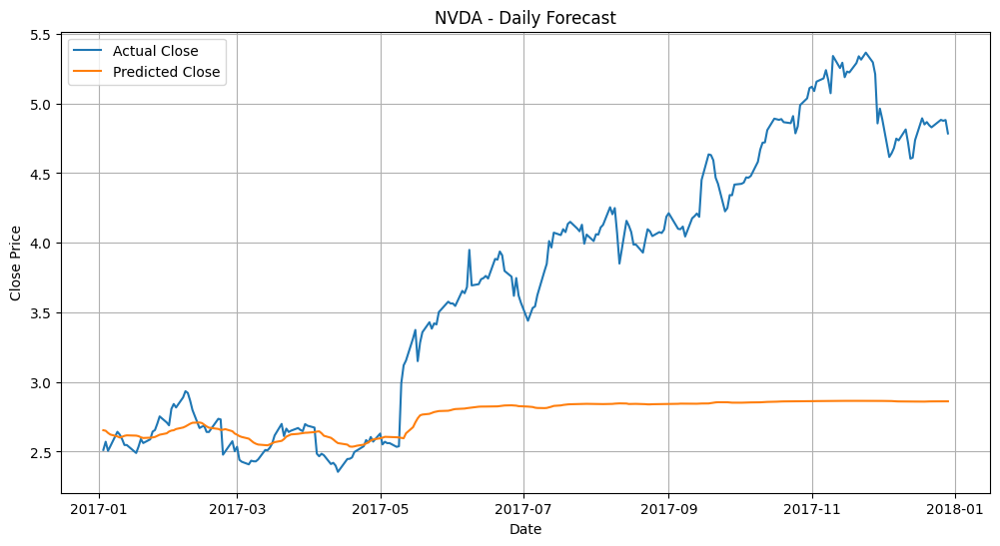

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 70ms/step

📊 Results for SPY
RMSE: 2.1256
MAE : 1.7537
R^2 : 0.9609
MAPE: 0.0081


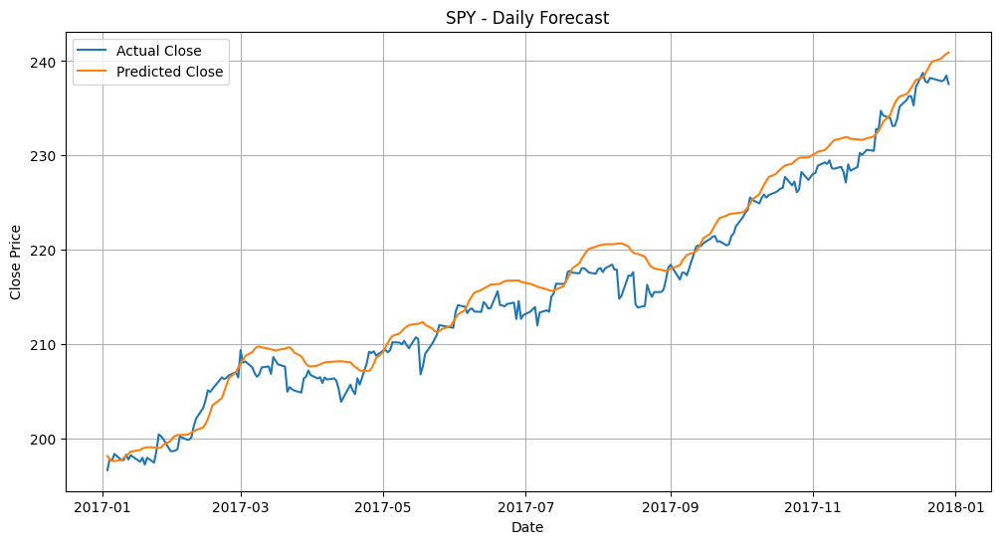

📉 Mean Scaled RMSE over 4 stocks: 0.18866228738464938


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Robust Scale Model 3

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 106ms/step

📊 Results for AAPL
RMSE: 12.9828
MAE : 11.7887
R^2 : 0.4410
MAPE: 0.0674


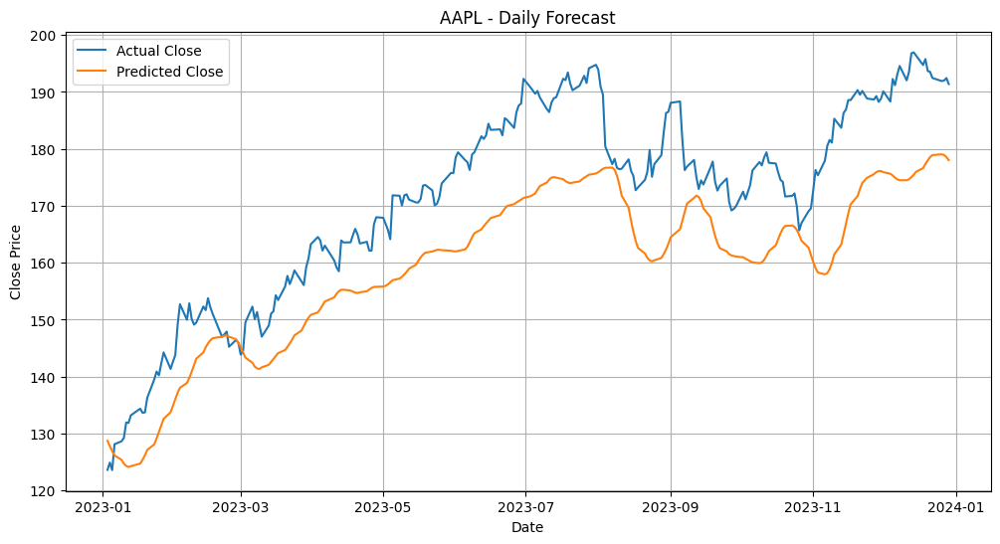

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 110ms/step

📊 Results for JPM
RMSE: 3.3632
MAE : 2.6476
R^2 : 0.8798
MAPE: 0.0194


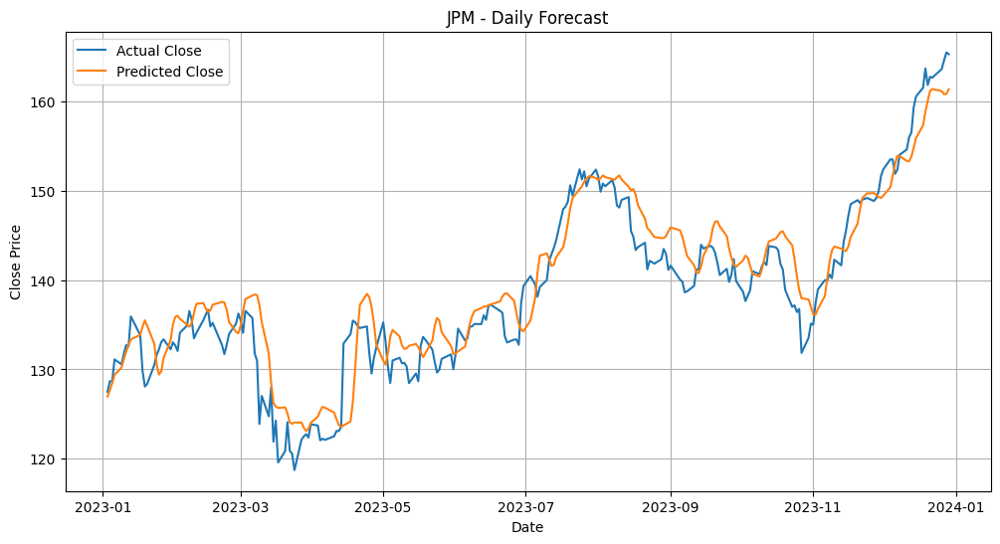

8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 283ms/step

📊 Results for NVDA
RMSE: 3.8108
MAE : 3.0881
R^2 : 0.8739
MAPE: 0.0766


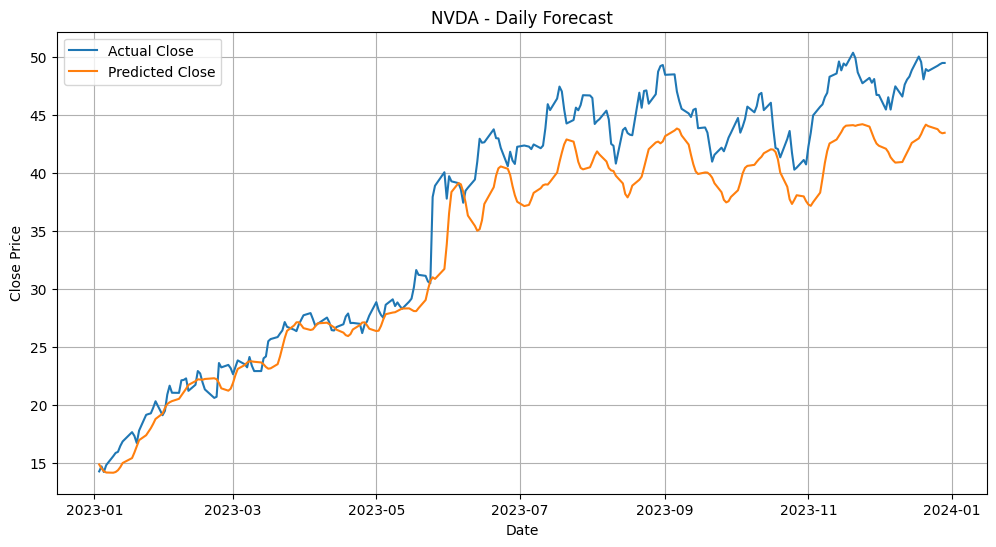

8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 288ms/step

📊 Results for SPY
RMSE: 9.0630
MAE : 7.4098
R^2 : 0.8563
MAPE: 0.0176


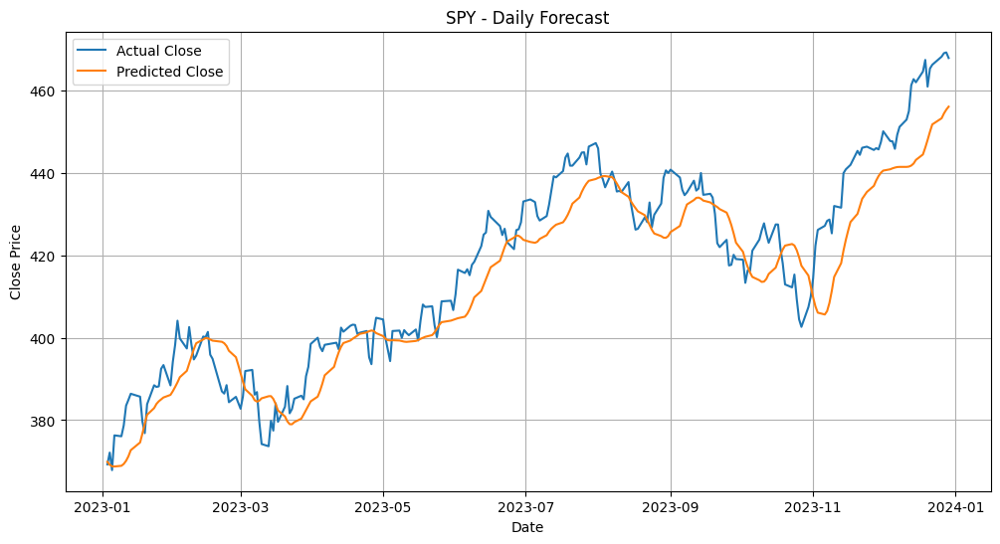

📉 Mean Scaled RMSE over 4 stocks: 0.11095523028084311


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 134ms/step

📊 Results for AAPL
RMSE: 1.7163
MAE : 1.3488
R^2 : 0.9593
MAPE: 0.0264


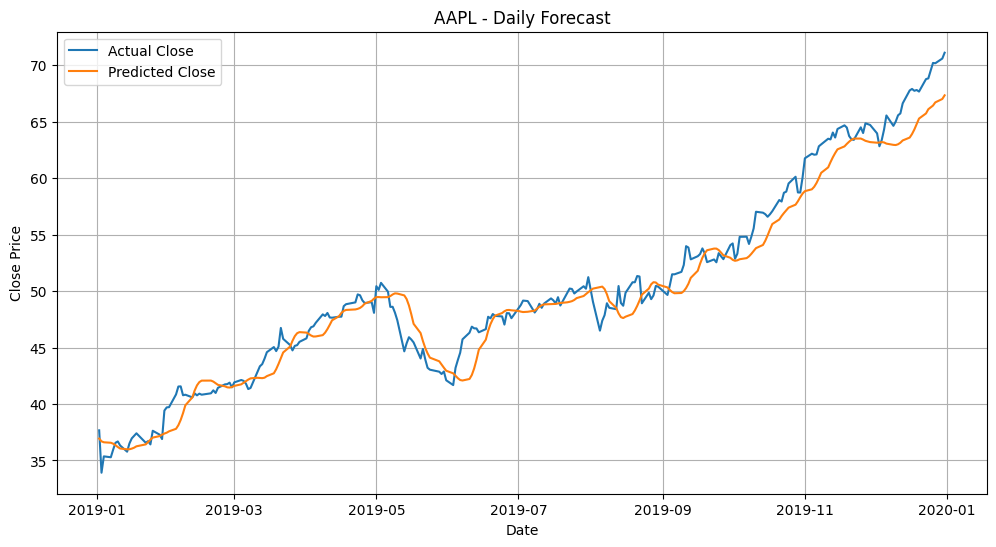

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step

📊 Results for JPM
RMSE: 4.6578
MAE : 3.6251
R^2 : 0.7639
MAPE: 0.0356


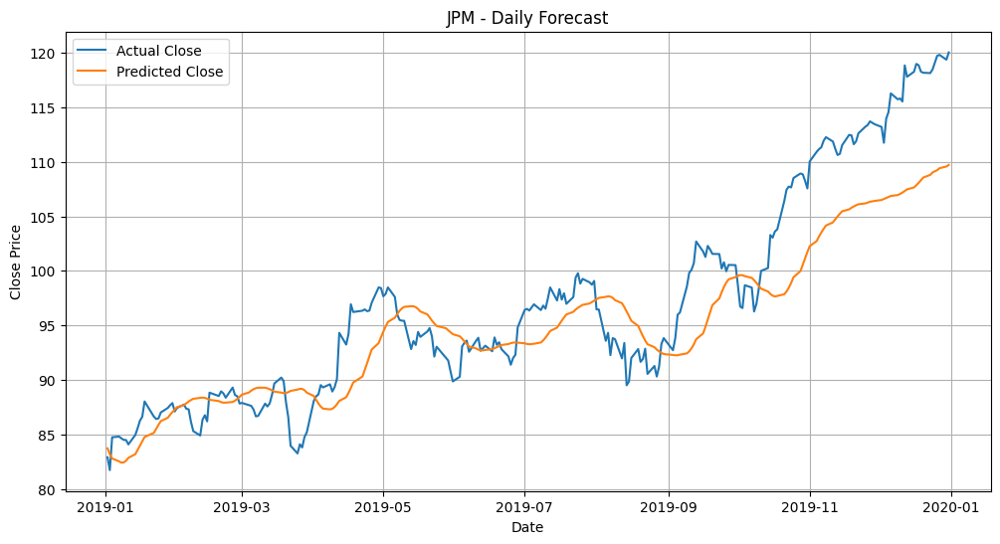

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step

📊 Results for NVDA
RMSE: 0.2660
MAE : 0.2216
R^2 : 0.8181
MAPE: 0.0519


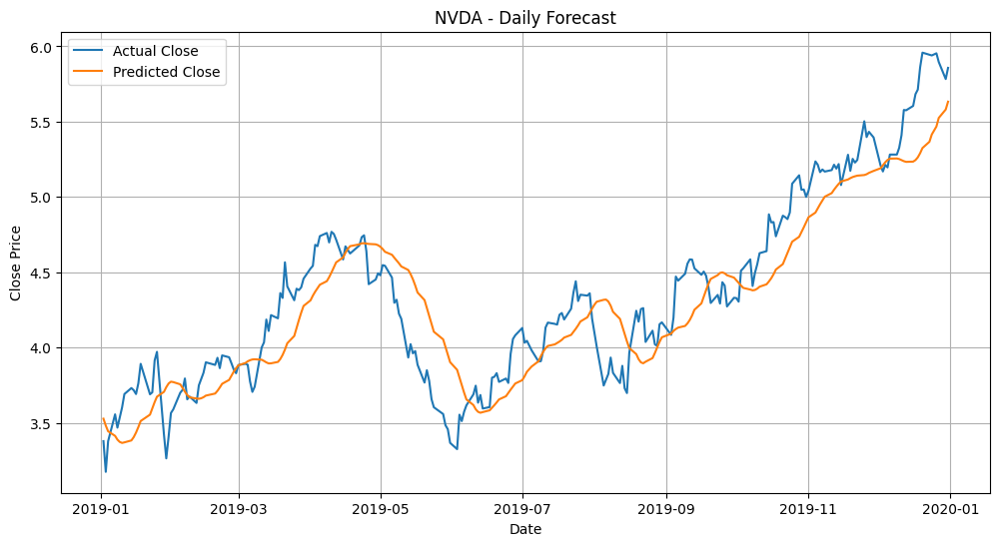

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 106ms/step

📊 Results for SPY
RMSE: 13.1222
MAE : 11.8051
R^2 : 0.2373
MAPE: 0.0436


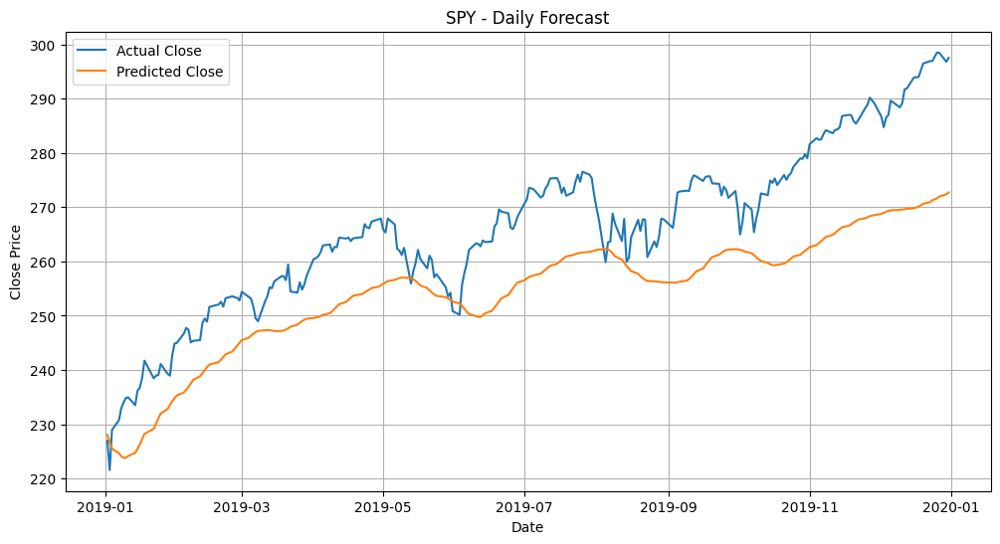

📉 Mean Scaled RMSE over 4 stocks: 0.10845672553593375


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 162ms/step

📊 Results for AAPL
RMSE: 2.2786
MAE : 1.9605
R^2 : 0.5900
MAPE: 0.0535


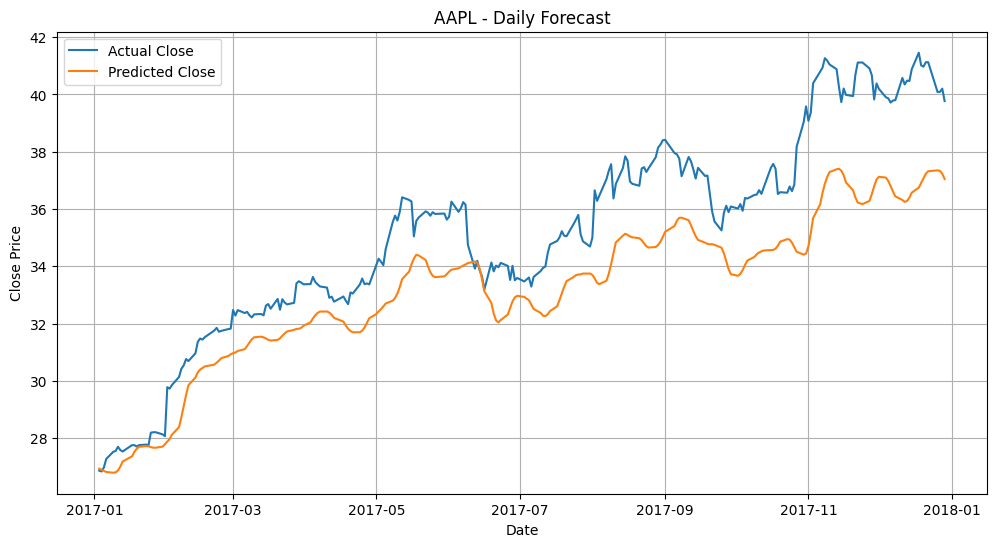

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 151ms/step

📊 Results for JPM
RMSE: 3.1726
MAE : 2.5978
R^2 : 0.6706
MAPE: 0.0346


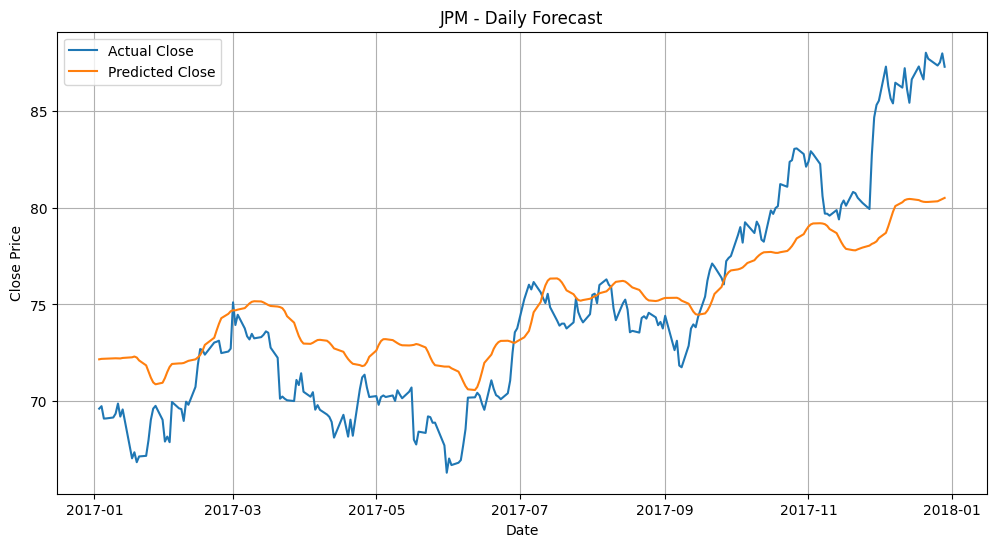

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 105ms/step

📊 Results for NVDA
RMSE: 1.3137
MAE : 1.0296
R^2 : -0.9474
MAPE: 0.2381


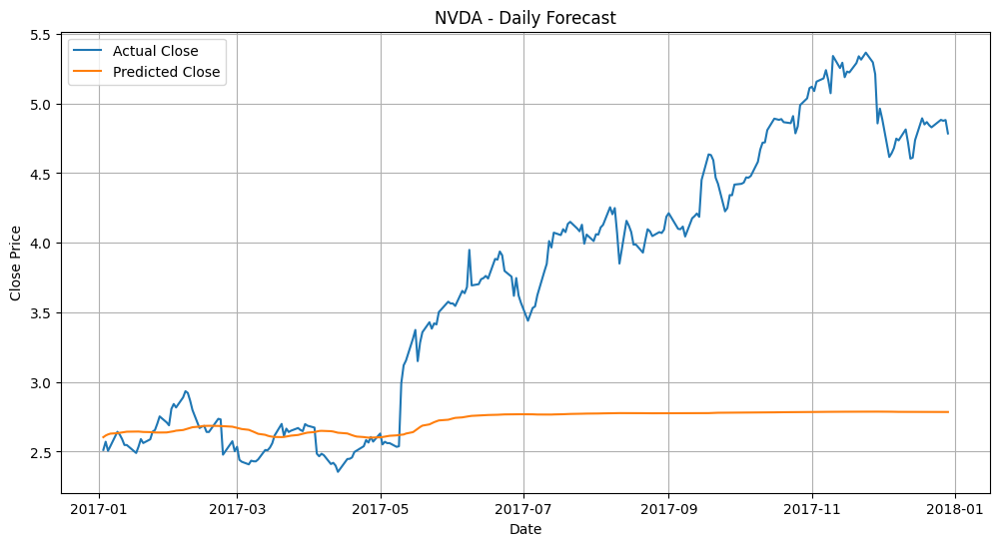

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step

📊 Results for SPY
RMSE: 3.8756
MAE : 3.2478
R^2 : 0.8702
MAPE: 0.0148


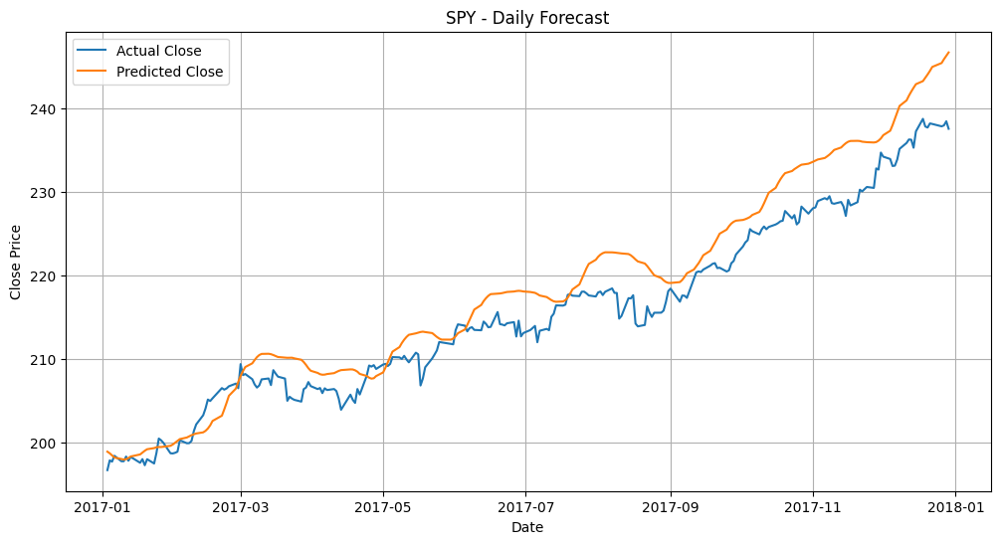

📉 Mean Scaled RMSE over 4 stocks: 0.20762238704838465


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = RobustScaler()
    scaler_y = RobustScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Quantile something Scale

In [ ]:
from sklearn.preprocessing import QuantileTransformer

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step

📊 Results for AAPL
RMSE: 2.7508
MAE : 2.0172
R^2 : 0.9622
MAPE: 0.0125


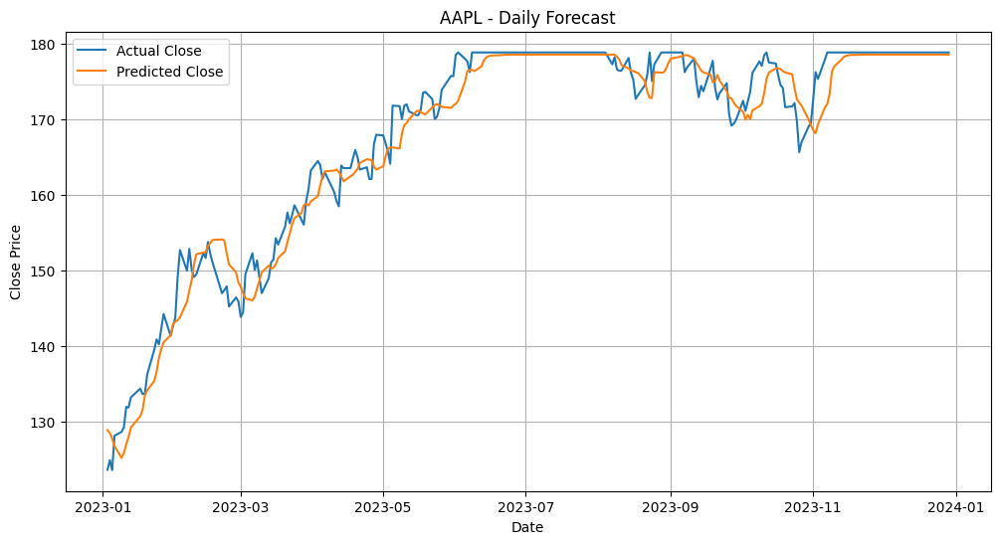

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for JPM
RMSE: 2.8257
MAE : 2.1442
R^2 : 0.9039
MAPE: 0.0157


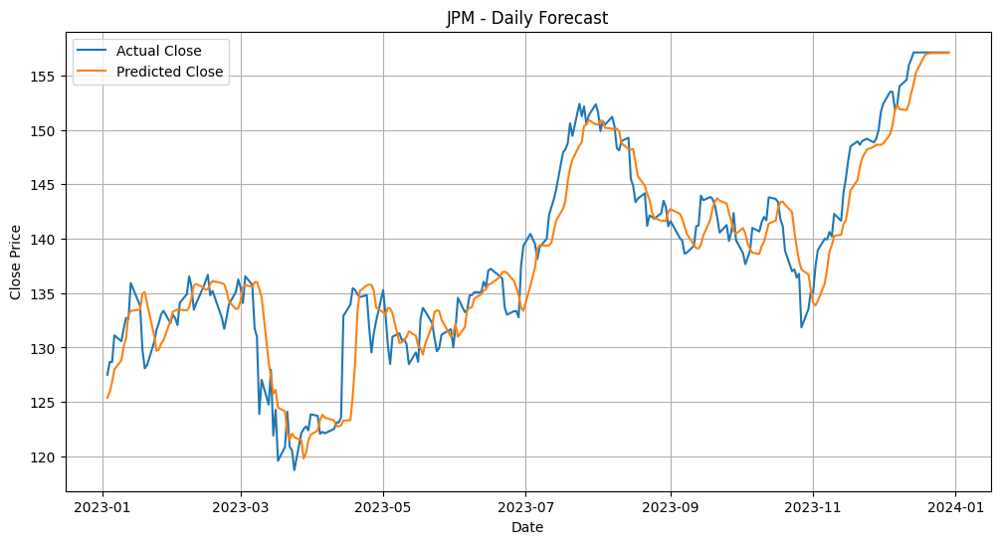

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step

📊 Results for NVDA
RMSE: 0.6723
MAE : 0.3576
R^2 : 0.9838
MAPE: 0.0151


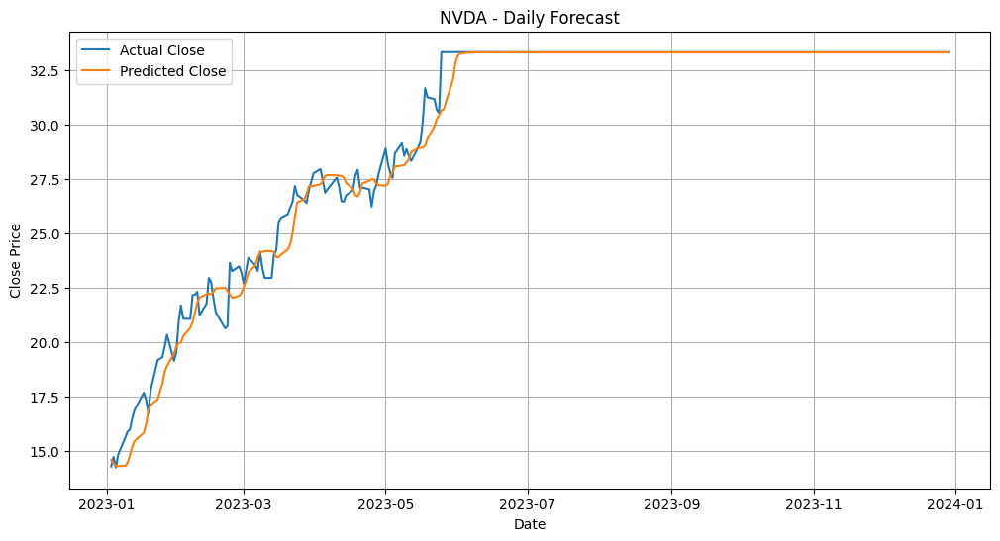

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for SPY
RMSE: 5.7290
MAE : 4.4302
R^2 : 0.9382
MAPE: 0.0107


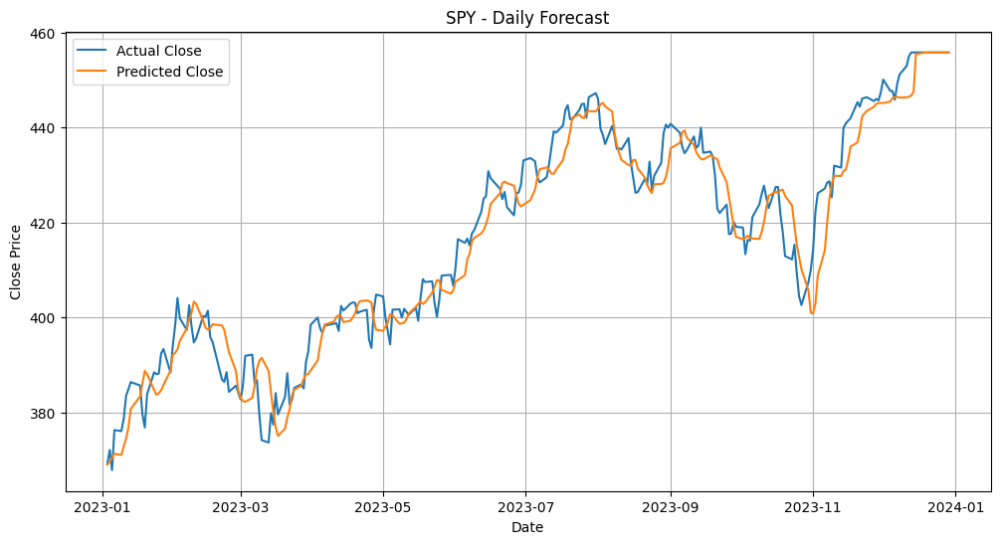

📉 Mean Scaled RMSE over 4 stocks: 0.055938913492265326


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    # --- Feature scaling ---
    scaler_X = QuantileTransformer(output_distribution='normal', random_state=0)
    X_train = scaler_X.fit_transform(train_df[feature_cols])
    X_test = scaler_X.transform(test_df[feature_cols])

    # --- Target scaling ---
    scaler_y = QuantileTransformer(output_distribution='normal', random_state=0)
    y_train = scaler_y.fit_transform(train_df[['Close']])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


works really well apart from it just cannot extrapolate at all :(

# Standard Scaler:

# Model 1

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for AAPL
RMSE: 5.2041
MAE : 4.4540
R^2 : 0.9102
MAPE: 0.0258


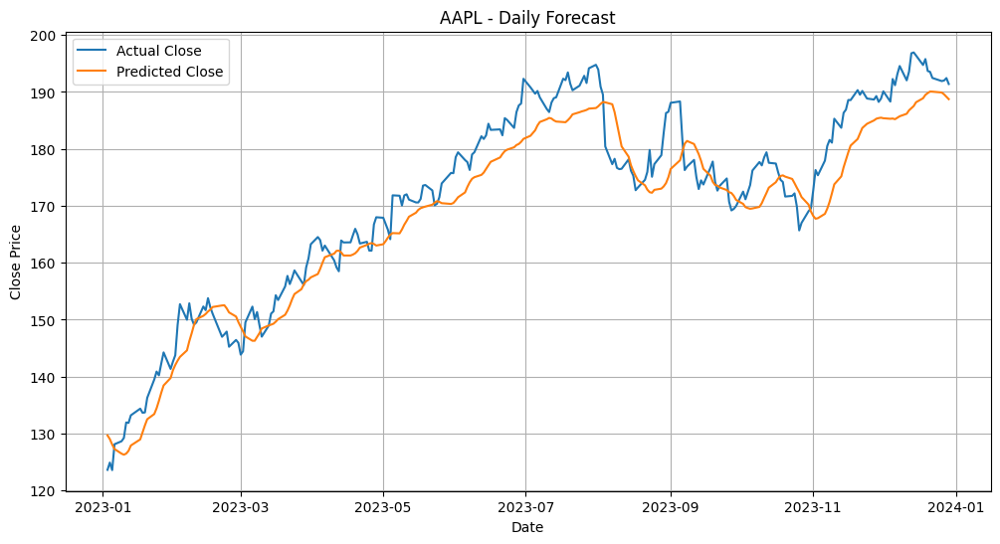

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step

📊 Results for JPM
RMSE: 3.4124
MAE : 2.7232
R^2 : 0.8763
MAPE: 0.0195


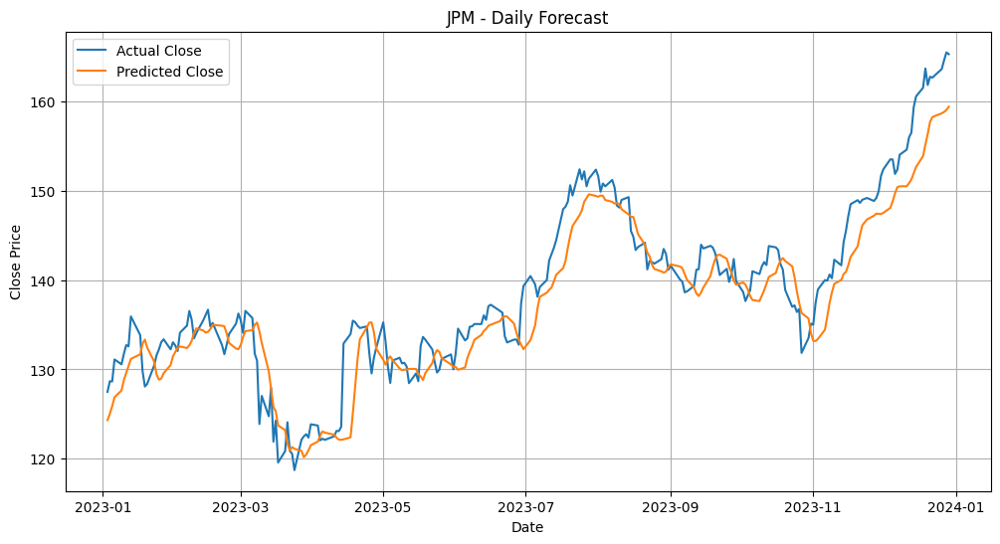

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for NVDA
RMSE: 4.5276
MAE : 3.7709
R^2 : 0.8220
MAPE: 0.0937


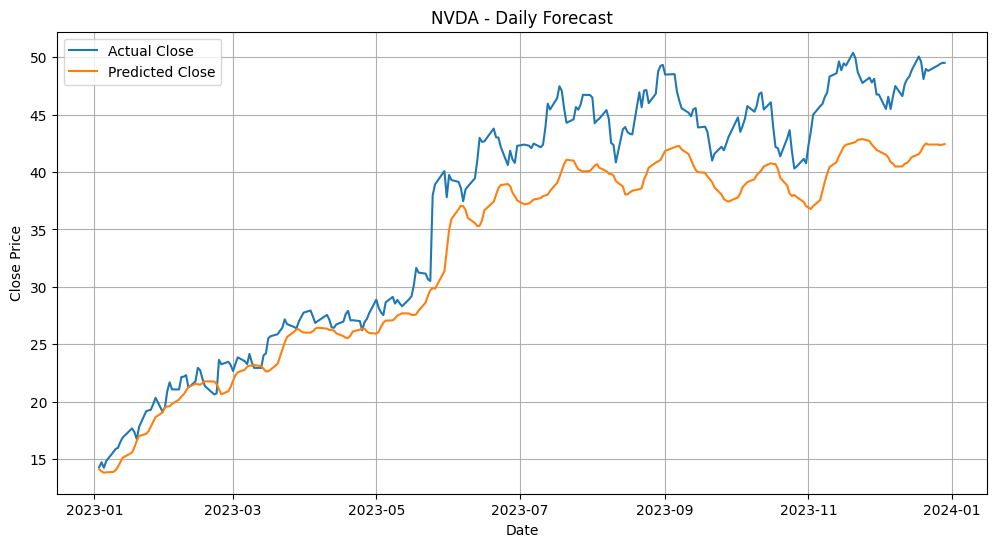

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step

📊 Results for SPY
RMSE: 7.5647
MAE : 6.1267
R^2 : 0.8999
MAPE: 0.0146


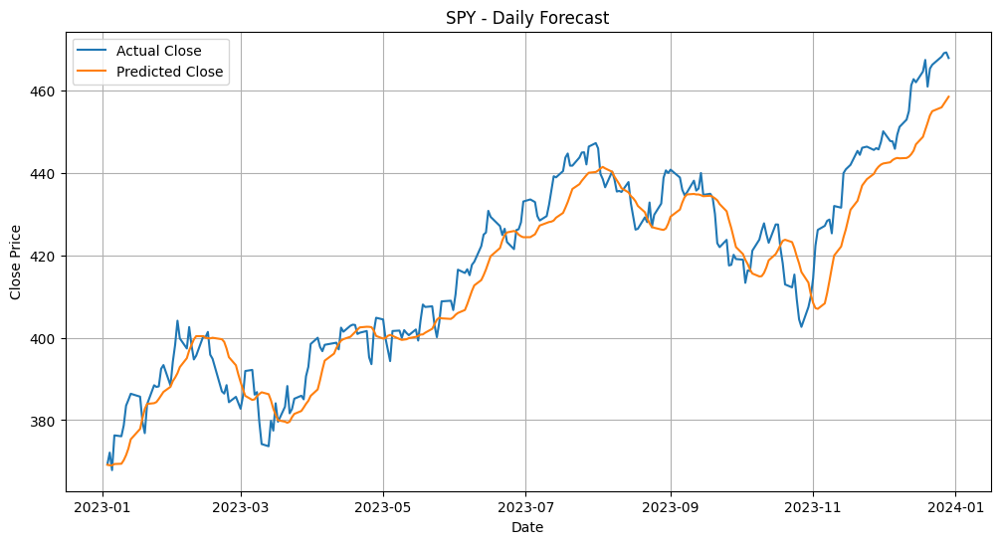

📉 Mean Scaled RMSE over 4 stocks: 0.08596861955738012


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = StandardScaler()
    scaler_y = StandardScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Relative predictions:

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step

📊 Results for AAPL
RMSE: 88.0006
MAE : 76.7056
R^2 : -26.7168
MAPE: 0.4458


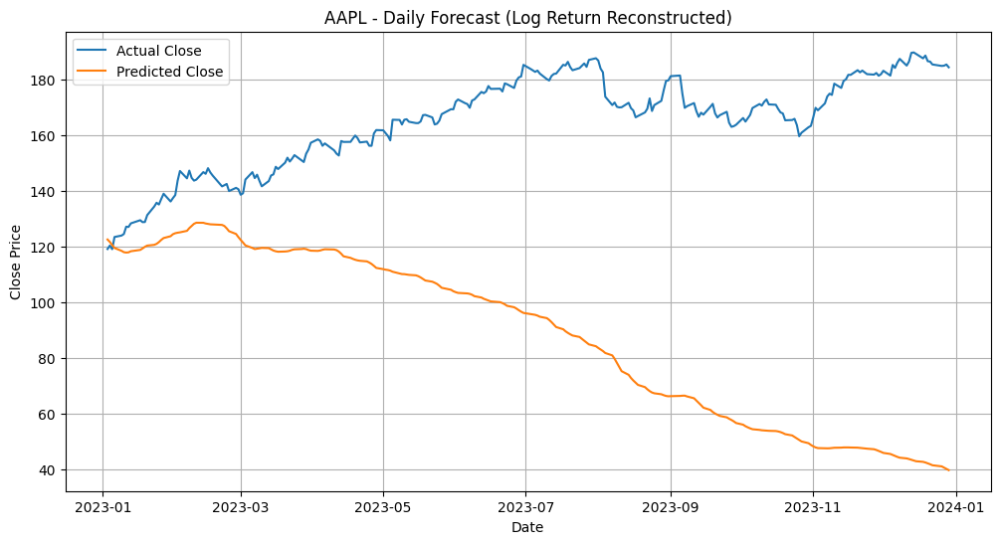

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step

📊 Results for JPM
RMSE: 68.1681
MAE : 58.8011
R^2 : -47.6352
MAPE: 0.4089


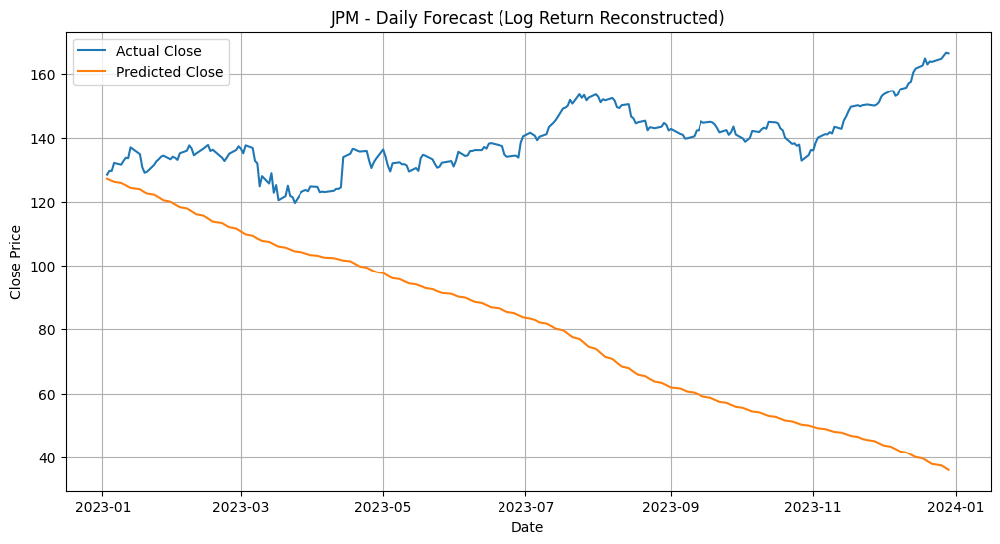

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for NVDA
RMSE: 34.7900
MAE : 31.2640
R^2 : -9.9515
MAPE: 0.8022


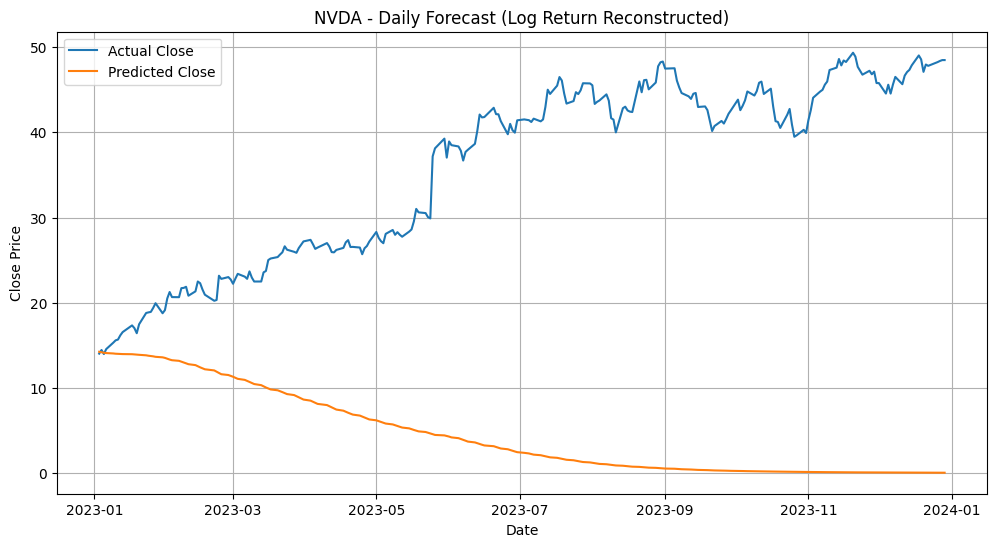

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step

📊 Results for SPY
RMSE: 58.7862
MAE : 48.8466
R^2 : -5.0952
MAPE: 0.1153


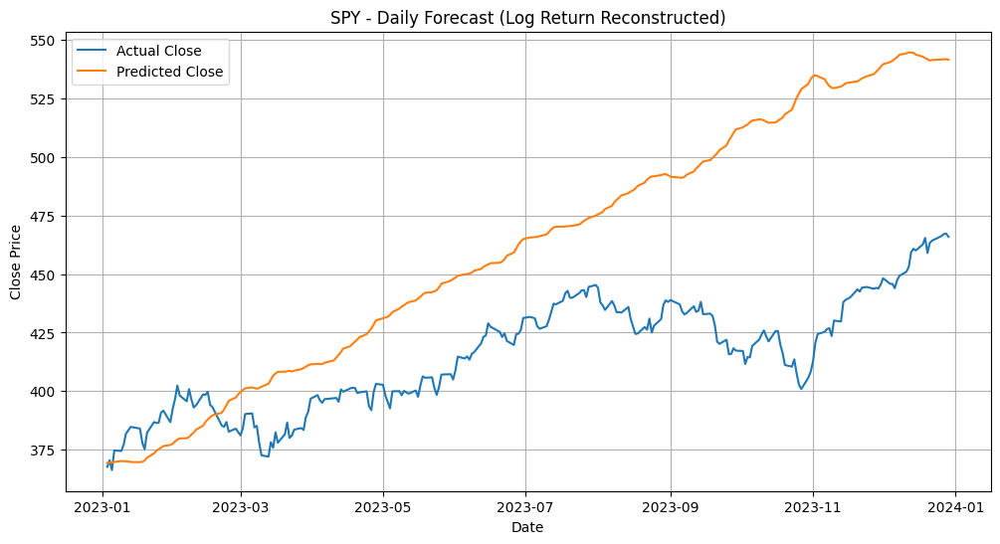

📉 Mean Scaled RMSE over 4 stocks: 1.0647424915306105


In [ ]:
import numpy as np
from sklearn.preprocessing import StandardScaler

def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    # Compute log returns
    df['log_return'] = np.log(df['Close'] / df['Close_lag1'])
    df = df.dropna()

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']

    # Find test start index with buffer
    test_start_date = pd.Timestamp("2023-01-01")
    start_idx = df.index.searchsorted(test_start_date)
    extended_start_idx = max(0, start_idx - window)
    test_df = df.iloc[extended_start_idx:]

    # Feature scaling
    scaler_X = StandardScaler()
    X_train = scaler_X.fit_transform(train_df[feature_cols])
    X_test = scaler_X.transform(test_df[feature_cols])

    # Target is log return
    y_train = train_df[['log_return']].values
    y_test = test_df[['log_return']].values

    # Sequence creation
    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    # Model
    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    # Prediction
    y_pred_log = model.predict(X_test_seq)
    y_true_log = y_test_seq

    # Reconstruct actual prices from log returns
    # Start from the first available close price *after* the sliding window
    start_price = test_df['Close'].iloc[window]

    # Cumulative reconstruction
    pred_prices = [start_price]
    true_prices = [start_price]
    for pred_lr, true_lr in zip(y_pred_log, y_true_log):
        pred_prices.append(pred_prices[-1] * np.exp(pred_lr[0]))
        true_prices.append(true_prices[-1] * np.exp(true_lr[0]))
    pred_prices = pred_prices[1:]
    true_prices = true_prices[1:]

    # Evaluation
    rmse = np.sqrt(mean_squared_error(true_prices, pred_prices))
    mae = mean_absolute_error(true_prices, pred_prices)
    r2 = r2_score(true_prices, pred_prices)
    mape = mean_absolute_percentage_error(true_prices, pred_prices)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates[:len(true_prices)], true_prices, label='Actual Close')
    plt.plot(test_dates[:len(pred_prices)], pred_prices, label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast (Log Return Reconstructed)')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(true_prices) - np.min(true_prices))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Rescaling throughout test year

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━

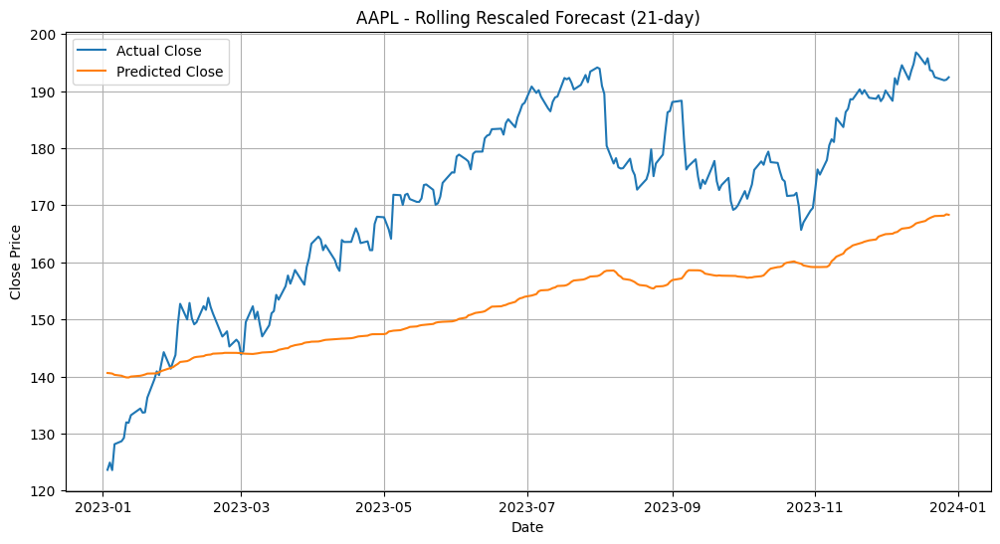

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━

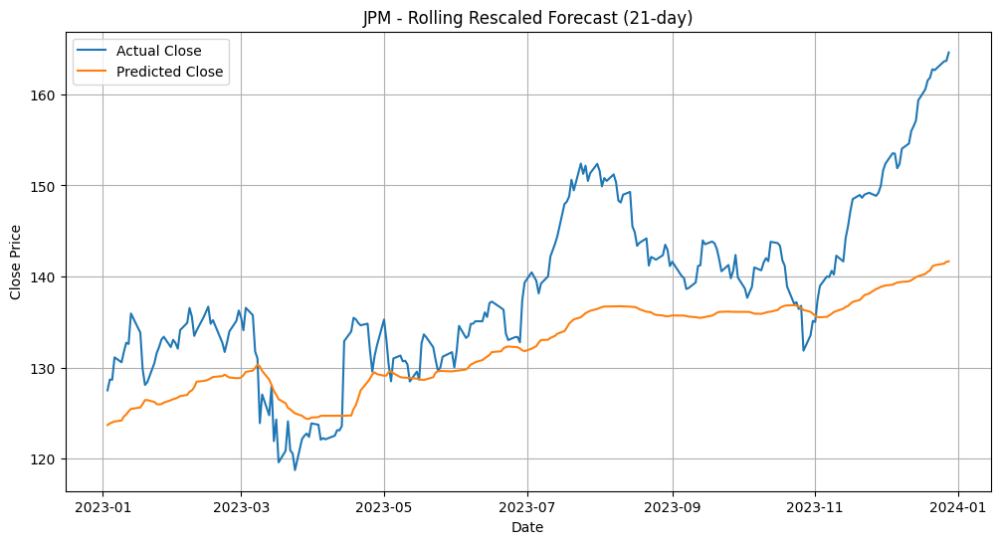

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━

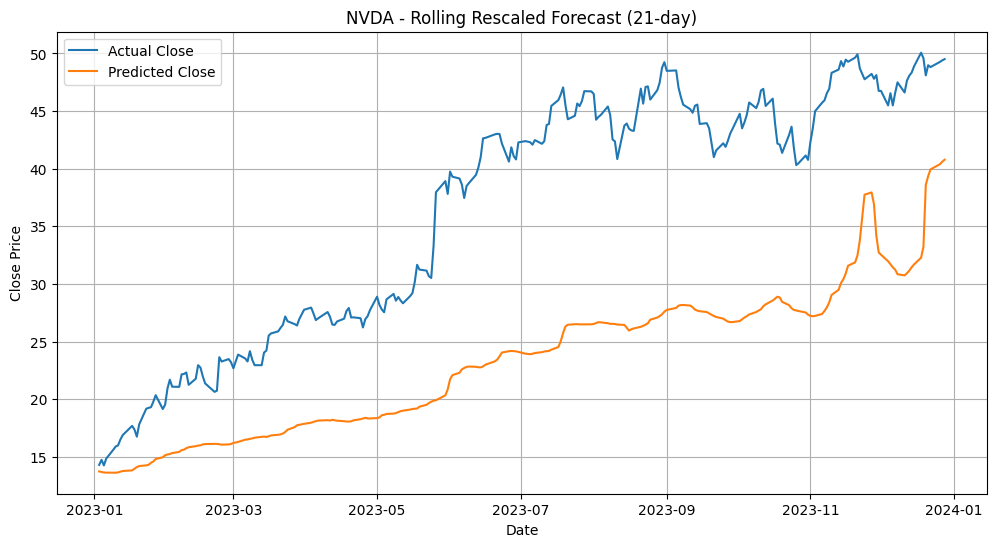

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━

KeyboardInterrupt: 

In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2018-01-01':'2023-12-31']

    train_df = df.loc[:'2022-12-31']
    test_start_date = pd.Timestamp("2023-01-01")
    start_idx = df.index.searchsorted(test_start_date)
    extended_start_idx = max(0, start_idx - window)
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)

    # --- Model ---
    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    # --- Rolling test prediction ---
    y_pred_all = []
    y_true_all = []
    dates_all = []

    test_len = len(test_df)
    step = 1  # rolling update frequency
    for start in range(0, test_len - window - step, step):
        end = start + step + window
        if end > test_len:
            break

        chunk_df = test_df.iloc[start:end]
        combined_close = pd.concat([train_df[['Close']], test_df.iloc[:start + window][['Close']]])
        scaler_y = QuantileTransformer(output_distribution='normal', random_state=0)
        scaler_y.fit(combined_close)

        y_chunk = scaler_y.transform(chunk_df[['Close']])
        X_chunk = X_test[start:end]
        X_seq, y_seq = create_sequences(X_chunk, y_chunk, window)

        y_pred_scaled = model.predict(X_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_seq)

        y_pred_all.extend(y_pred.flatten())
        y_true_all.extend(y_true.flatten())
        dates_all.extend(chunk_df.index[window:])

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true_all, y_pred_all))
    mae = mean_absolute_error(y_true_all, y_pred_all)
    r2 = r2_score(y_true_all, y_pred_all)
    mape = mean_absolute_percentage_error(y_true_all, y_pred_all)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    plt.figure(figsize=(12, 6))
    plt.plot(dates_all, y_true_all, label='Actual Close')
    plt.plot(dates_all, y_pred_all, label='Predicted Close')
    plt.title(f'{stock_name} - Rolling Rescaled Forecast (21-day)')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(y_true_all) - np.min(y_true_all))
    return scaled_rmse

scaled_rmses = []
for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Learning Rate 0.003 Model 1

In [ ]:
from keras.optimizers import Adam

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step

📊 Results for AAPL
RMSE: 4.3902
MAE : 3.5177
R^2 : 0.9361
MAPE: 0.0207


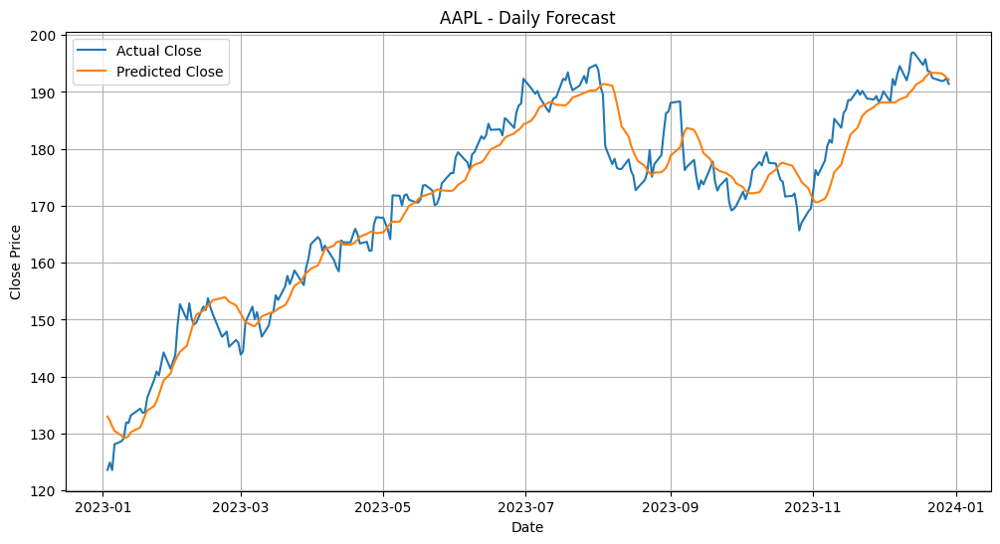

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for JPM
RMSE: 2.9507
MAE : 2.2580
R^2 : 0.9075
MAPE: 0.0165


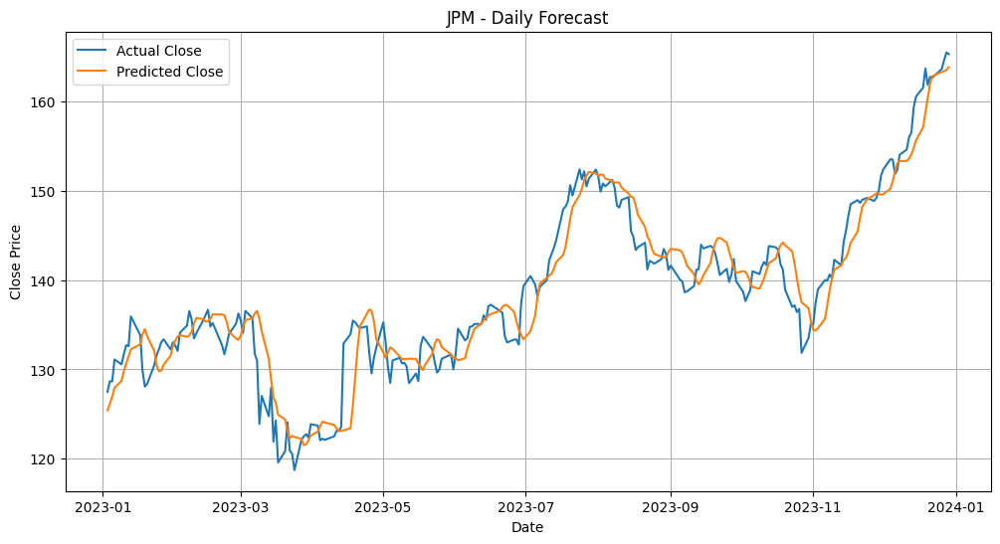

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step

📊 Results for NVDA
RMSE: 2.1651
MAE : 1.6694
R^2 : 0.9593
MAPE: 0.0444


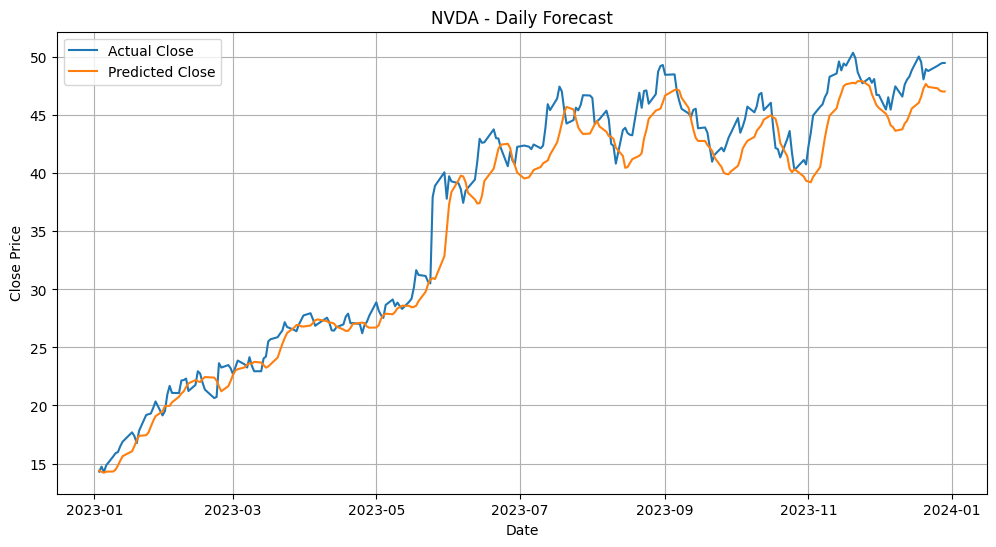

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step

📊 Results for SPY
RMSE: 7.1612
MAE : 5.9015
R^2 : 0.9103
MAPE: 0.0141


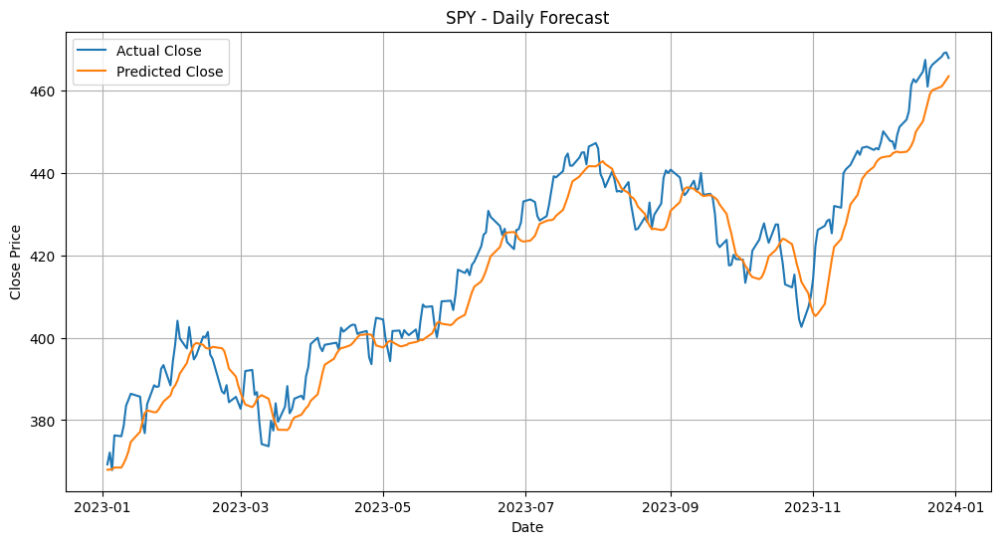

📉 Mean Scaled RMSE over 4 stocks: 0.06338447831326896


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for AAPL
RMSE: 1.5053
MAE : 1.1934
R^2 : 0.9687
MAPE: 0.0235


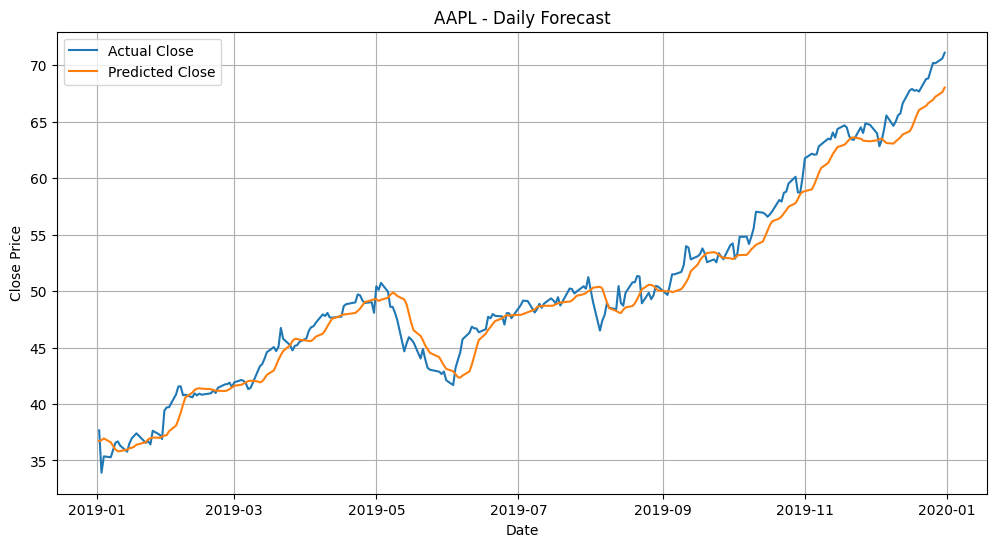

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step

📊 Results for JPM
RMSE: 2.7704
MAE : 2.2440
R^2 : 0.9165
MAPE: 0.0226


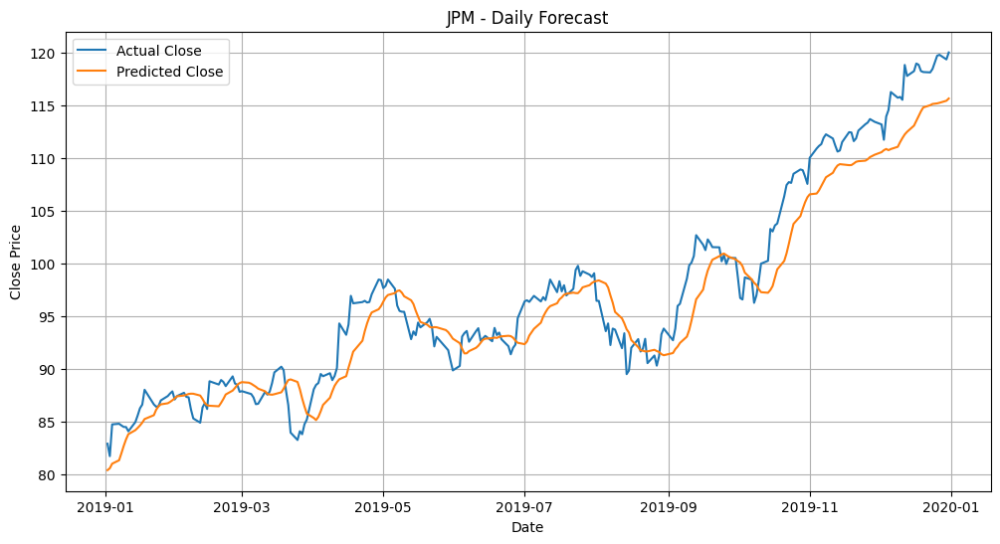

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step

📊 Results for NVDA
RMSE: 0.1825
MAE : 0.1453
R^2 : 0.9144
MAPE: 0.0346


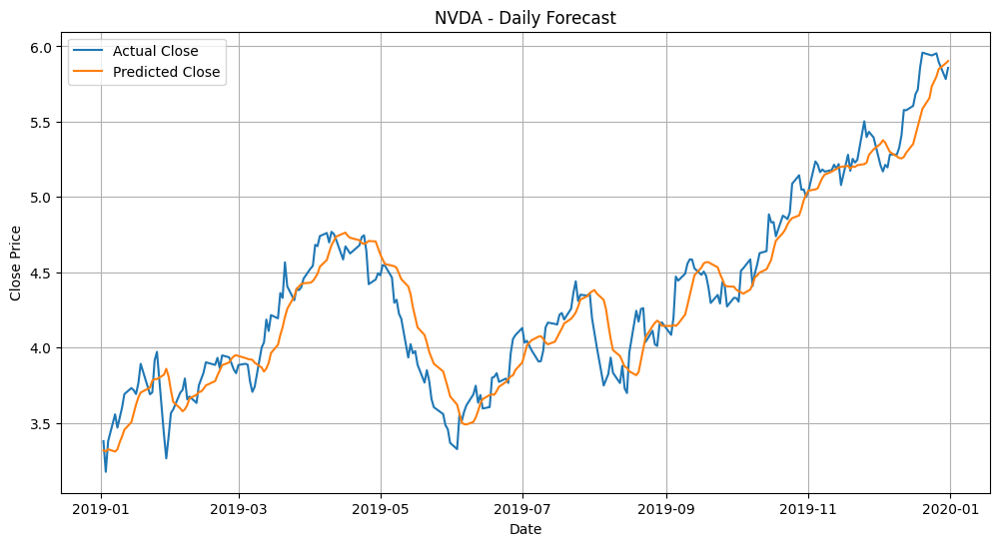

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for SPY
RMSE: 3.6388
MAE : 3.0121
R^2 : 0.9414
MAPE: 0.0113


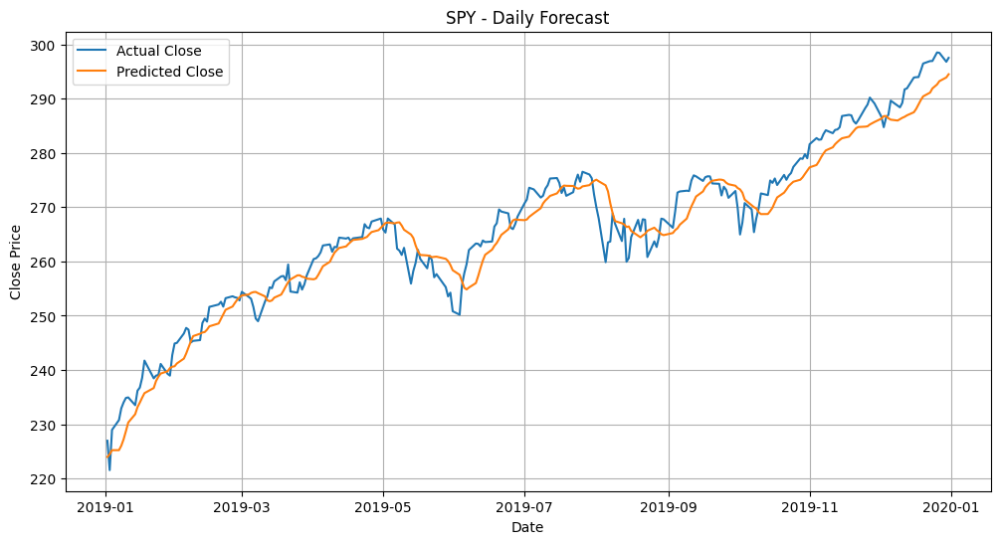

📉 Mean Scaled RMSE over 4 stocks: 0.056412528162804704


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for AAPL
RMSE: 1.2955
MAE : 1.1161
R^2 : 0.8674
MAPE: 0.0313


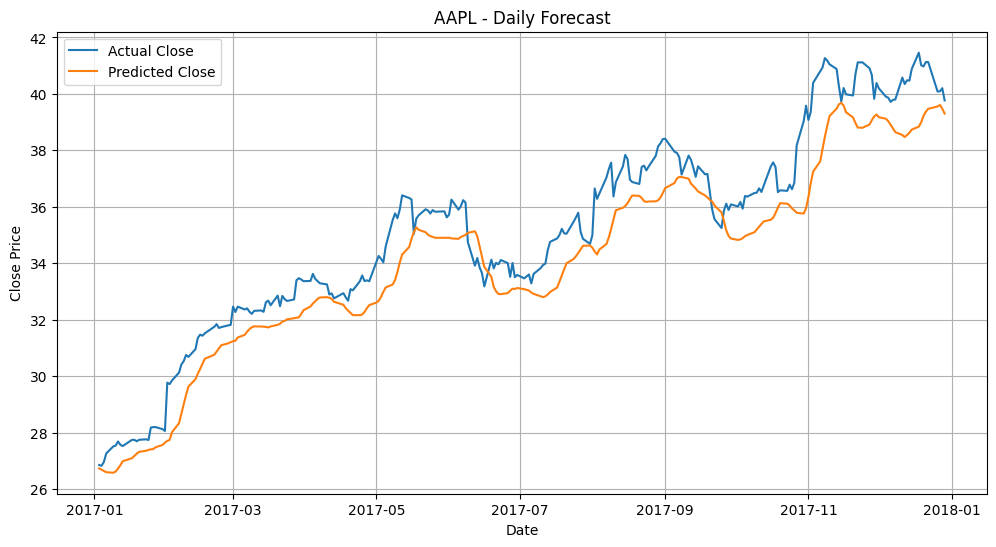

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step

📊 Results for JPM
RMSE: 1.4769
MAE : 1.1605
R^2 : 0.9286
MAPE: 0.0157


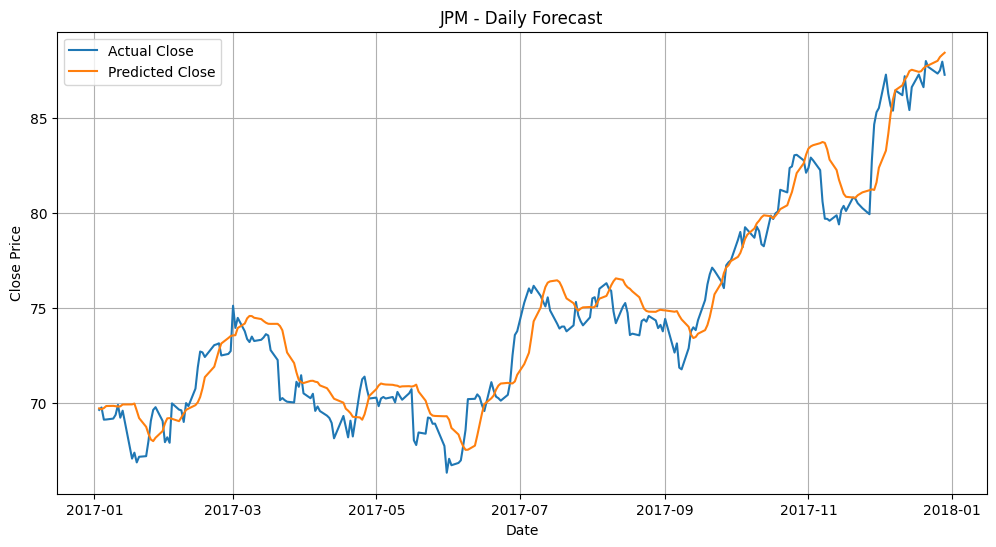

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step

📊 Results for NVDA
RMSE: 0.1473
MAE : 0.1110
R^2 : 0.9755
MAPE: 0.0320


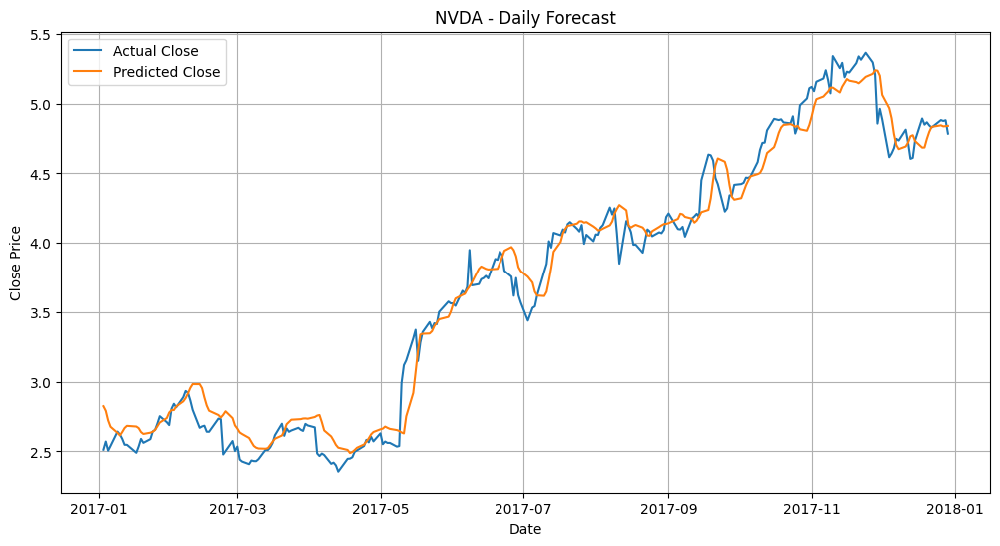

8/8 ━━━━━━━━━━━━━━━━━━━━ 4s 38ms/step

📊 Results for SPY
RMSE: 2.9745
MAE : 2.5090
R^2 : 0.9235
MAPE: 0.0114


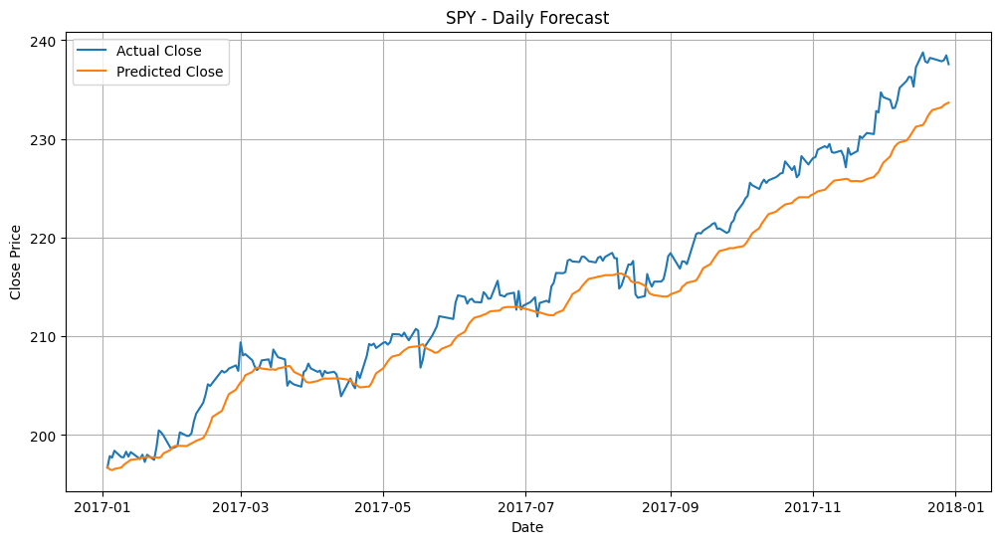

📉 Mean Scaled RMSE over 4 stocks: 0.06906185787840148


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Learning Rate 0.003 Model 2

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step

📊 Results for AAPL
RMSE: 4.3869
MAE : 3.5167
R^2 : 0.9362
MAPE: 0.0206


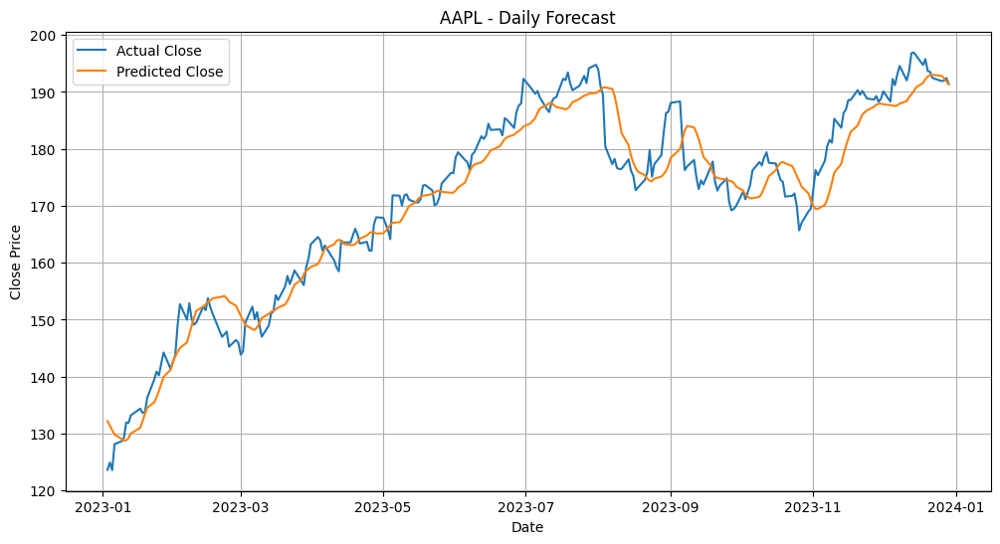

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step

📊 Results for JPM
RMSE: 4.2044
MAE : 3.4638
R^2 : 0.8122
MAPE: 0.0247


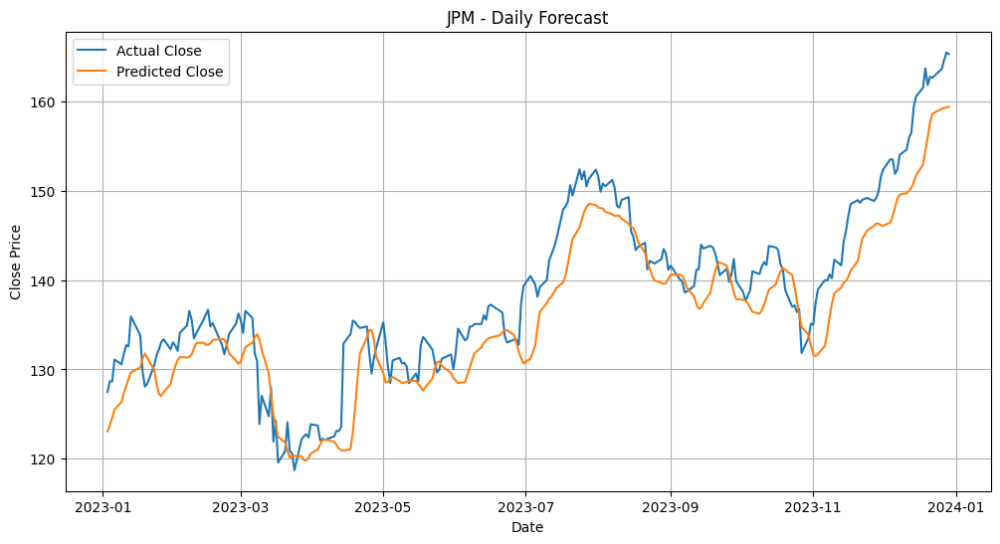

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step

📊 Results for NVDA
RMSE: 3.5960
MAE : 3.0268
R^2 : 0.8877
MAPE: 0.0787


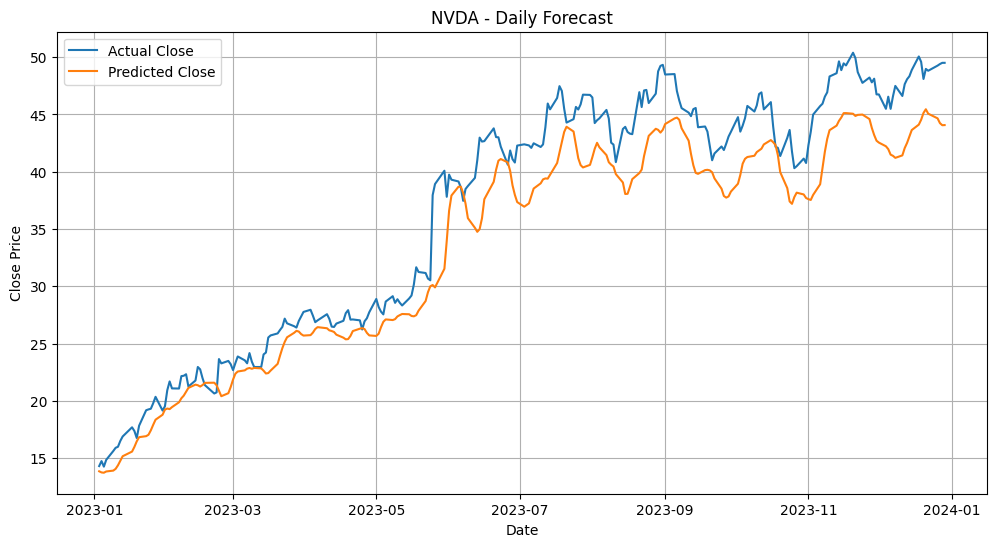

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 100ms/step

📊 Results for SPY
RMSE: 6.7162
MAE : 5.2308
R^2 : 0.9211
MAPE: 0.0126


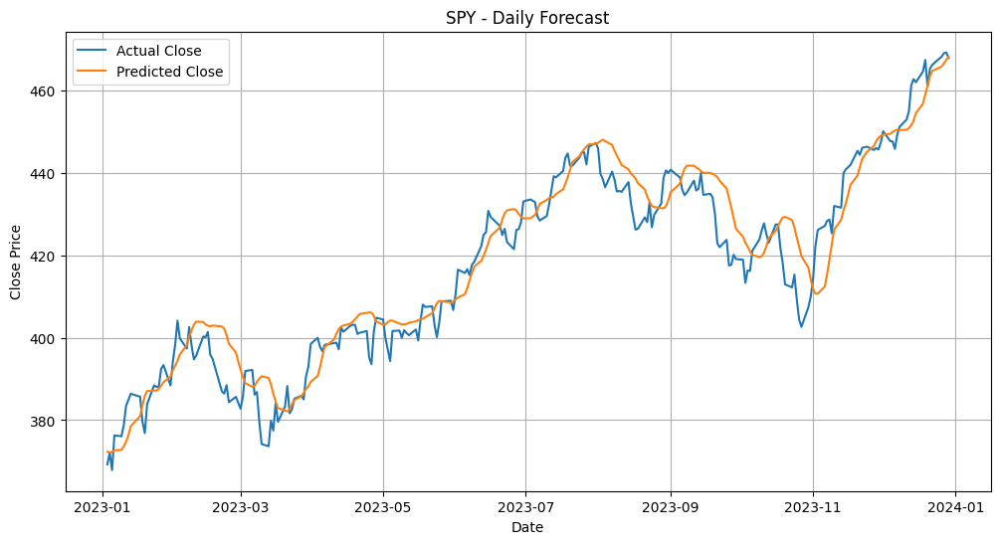

📉 Mean Scaled RMSE over 4 stocks: 0.07888115614231497


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step

📊 Results for AAPL
RMSE: 1.2635
MAE : 0.9812
R^2 : 0.9779
MAPE: 0.0200


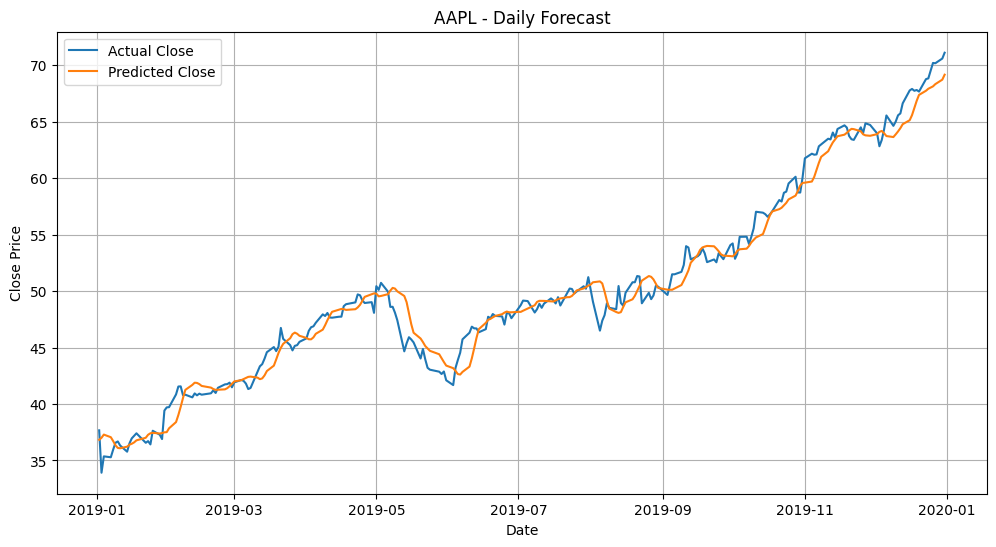

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 55ms/step

📊 Results for JPM
RMSE: 2.3798
MAE : 1.9297
R^2 : 0.9384
MAPE: 0.0200


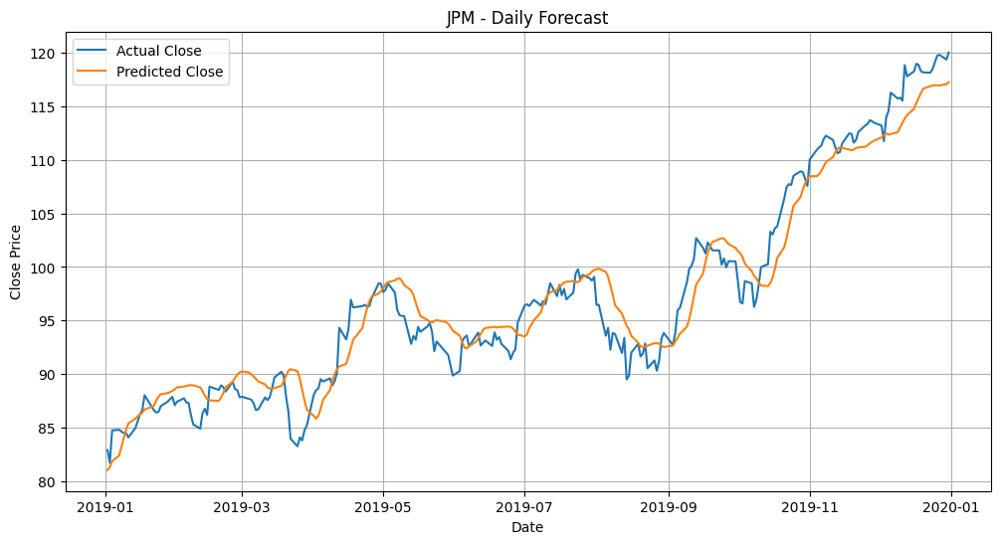

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step

📊 Results for NVDA
RMSE: 0.1860
MAE : 0.1506
R^2 : 0.9111
MAPE: 0.0355


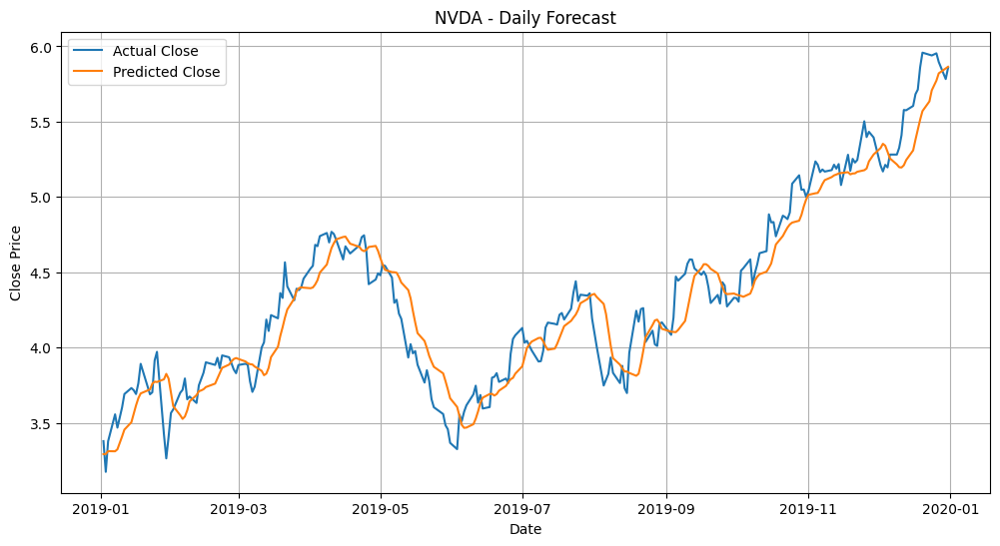

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step

📊 Results for SPY
RMSE: 3.8161
MAE : 3.1815
R^2 : 0.9355
MAPE: 0.0119


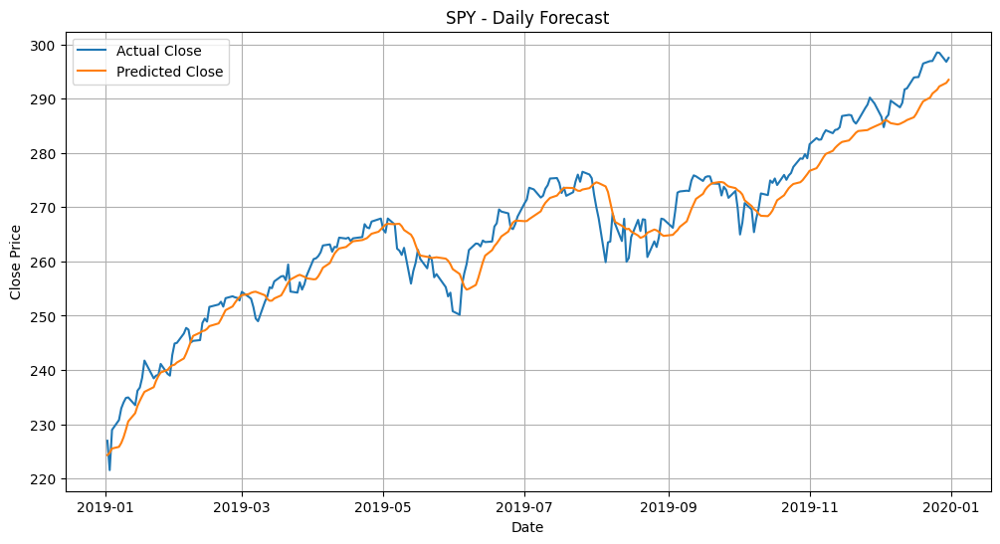

📉 Mean Scaled RMSE over 4 stocks: 0.05312736954121204


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step

📊 Results for AAPL
RMSE: 1.3653
MAE : 1.0445
R^2 : 0.8528
MAPE: 0.0282


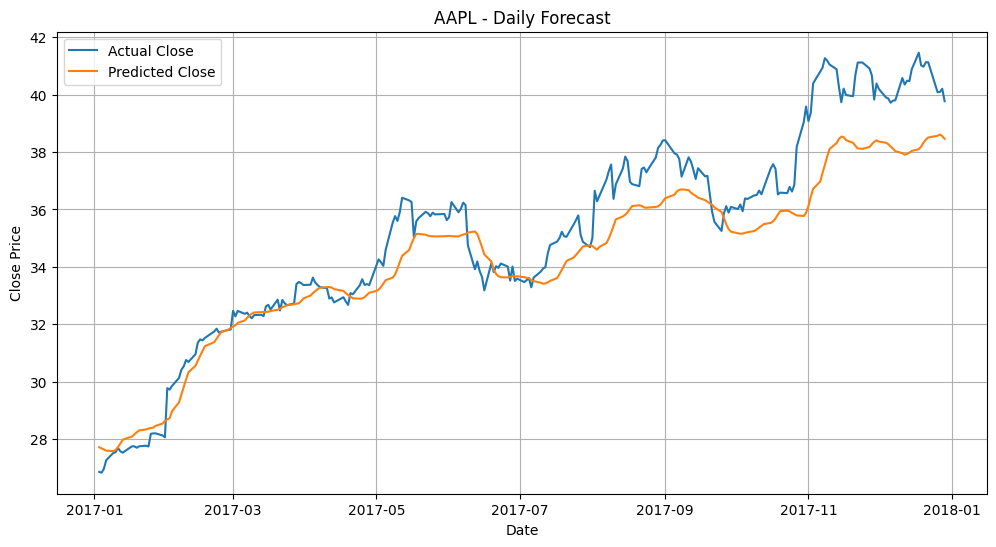

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step

📊 Results for JPM
RMSE: 1.5077
MAE : 1.1427
R^2 : 0.9256
MAPE: 0.0154


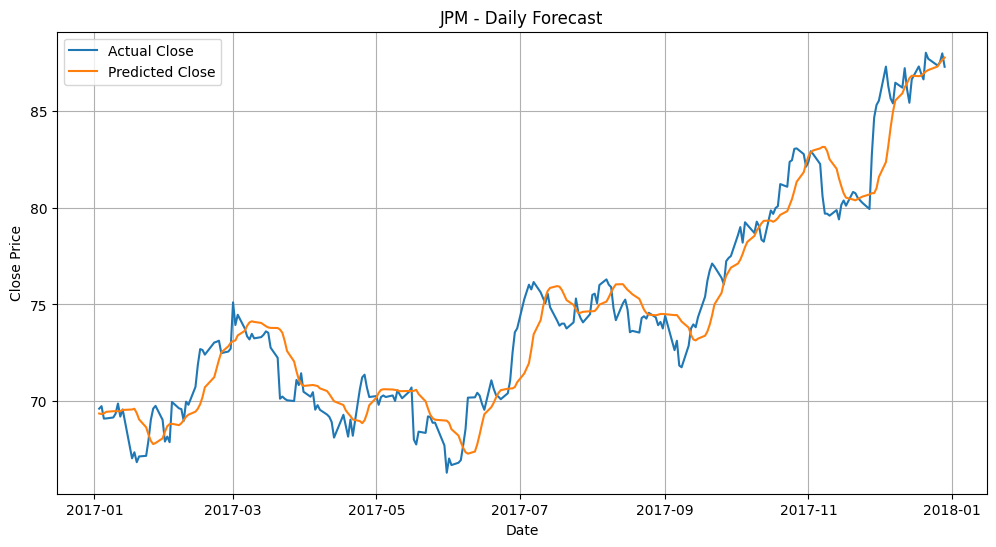

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step

📊 Results for NVDA
RMSE: 0.2542
MAE : 0.2156
R^2 : 0.9271
MAPE: 0.0674


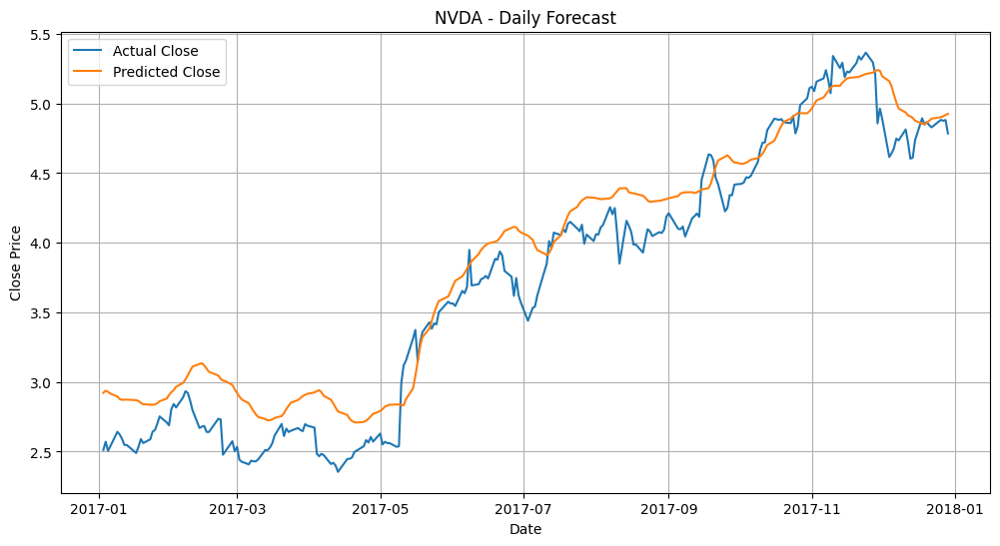

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step

📊 Results for SPY
RMSE: 4.9677
MAE : 4.5009
R^2 : 0.7867
MAPE: 0.0206


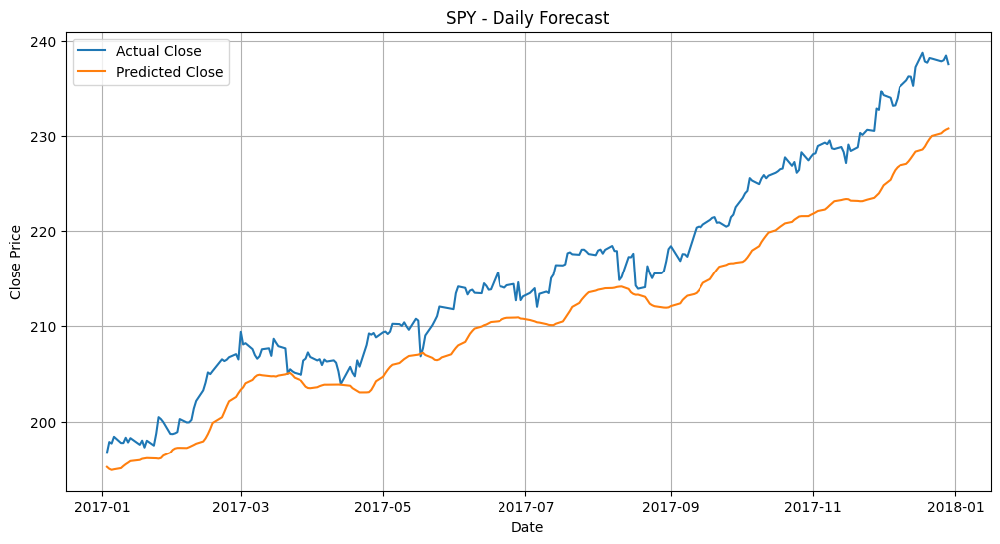

📉 Mean Scaled RMSE over 4 stocks: 0.09133049005563937


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Learning rate 0.003 model 3

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 105ms/step

📊 Results for AAPL
RMSE: 5.6772
MAE : 4.7101
R^2 : 0.8931
MAPE: 0.0276


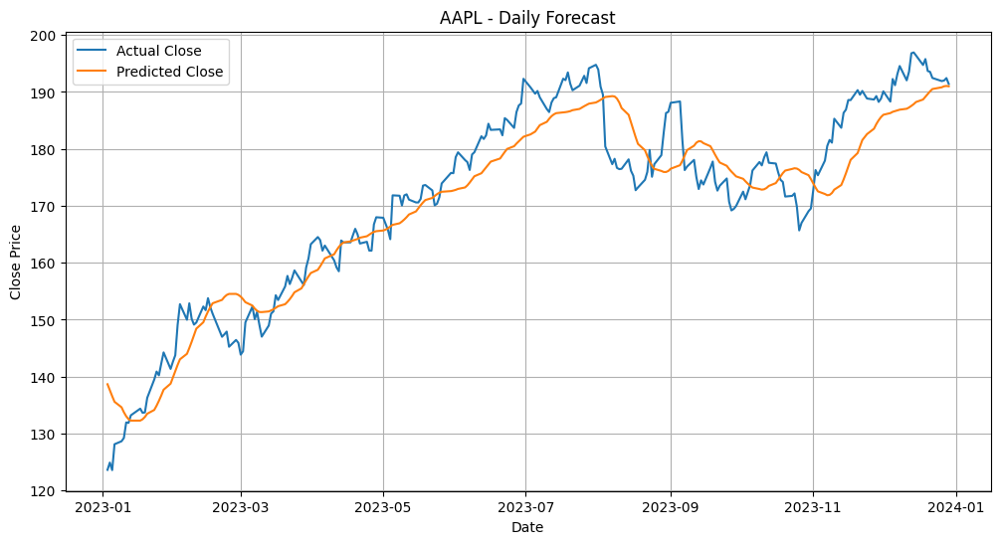

8/8 ━━━━━━━━━━━━━━━━━━━━ 6s 789ms/step

📊 Results for JPM
RMSE: 3.7910
MAE : 3.0558
R^2 : 0.8473
MAPE: 0.0221


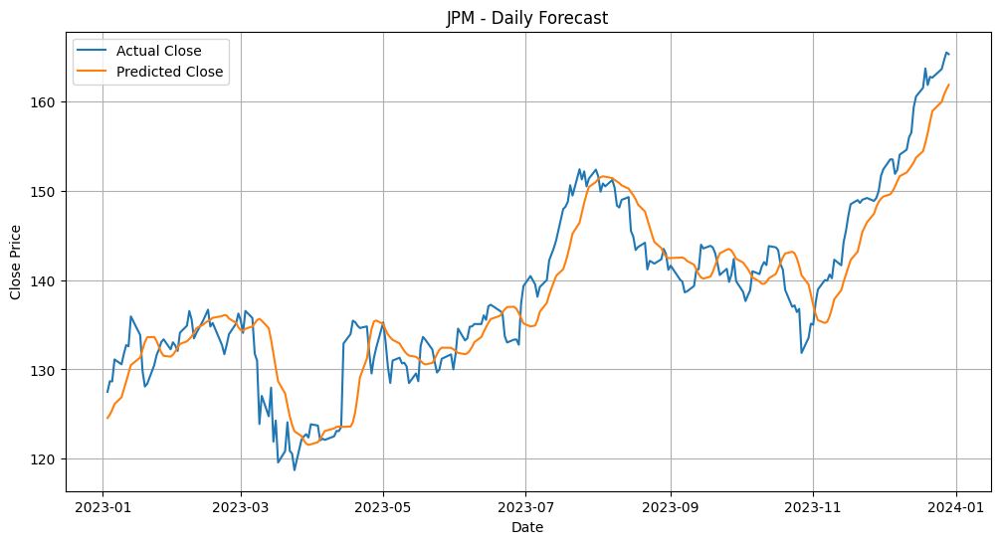

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 115ms/step

📊 Results for NVDA
RMSE: 2.5994
MAE : 1.9419
R^2 : 0.9413
MAPE: 0.0511


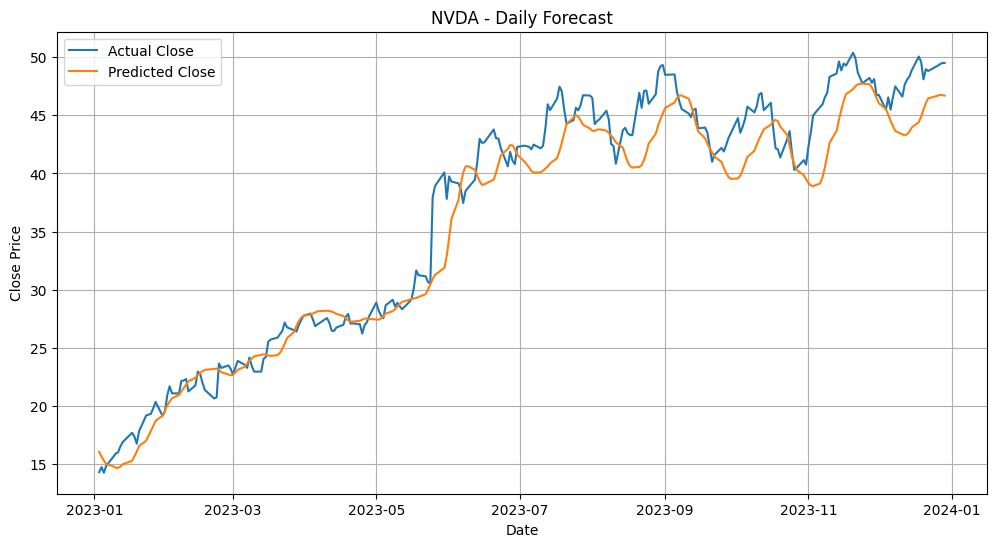

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step

📊 Results for SPY
RMSE: 18.7677
MAE : 16.9460
R^2 : 0.3840
MAPE: 0.0402


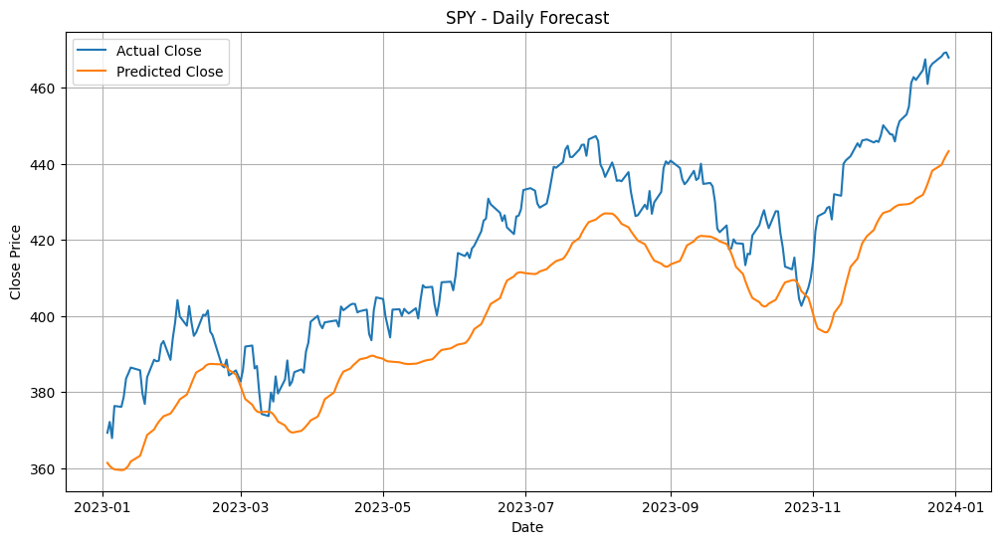

📉 Mean Scaled RMSE over 4 stocks: 0.10389102702768657


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step

📊 Results for AAPL
RMSE: 2.5405
MAE : 2.0942
R^2 : 0.9107
MAPE: 0.0403


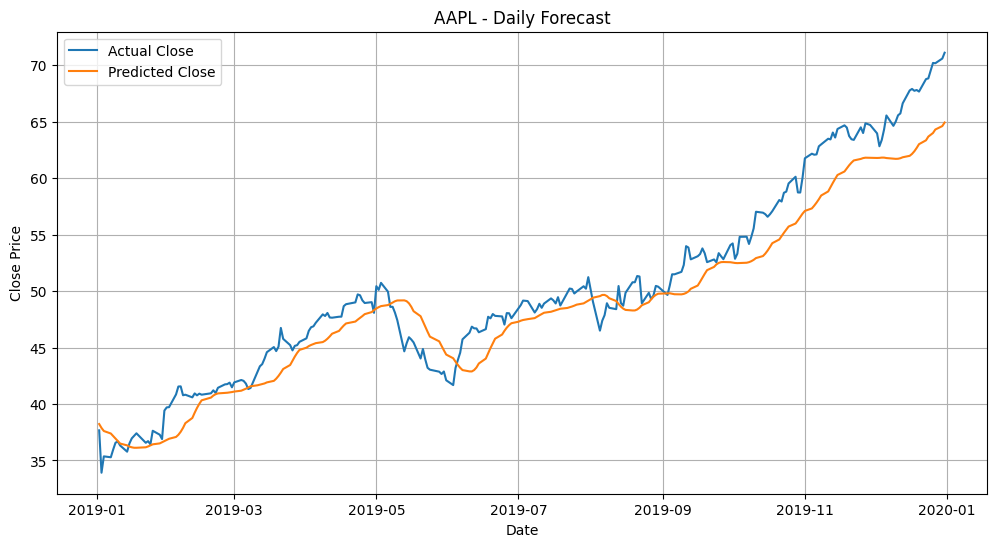

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 118ms/step

📊 Results for JPM
RMSE: 6.4676
MAE : 5.3300
R^2 : 0.5447
MAPE: 0.0526


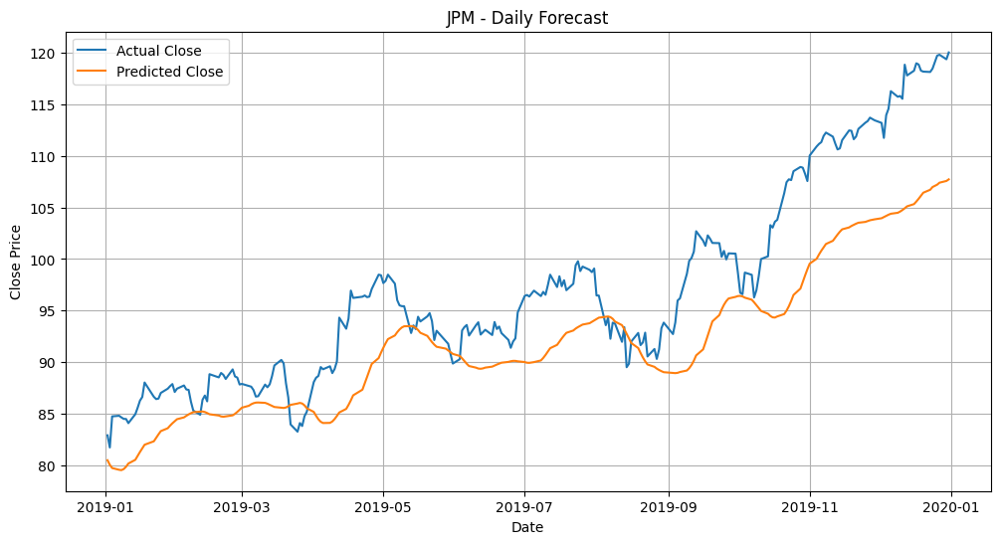

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 156ms/step

📊 Results for NVDA
RMSE: 0.4454
MAE : 0.3615
R^2 : 0.4900
MAPE: 0.0883


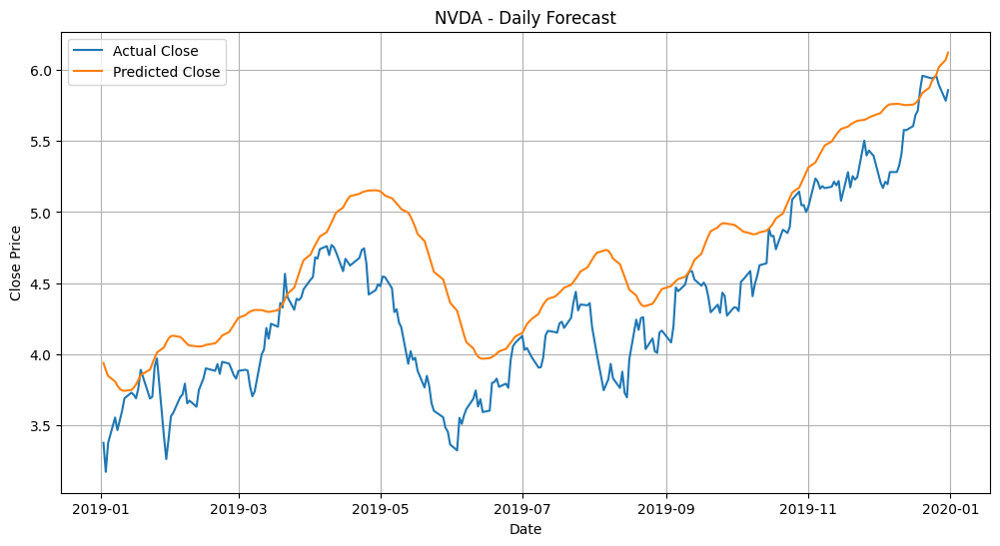

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 141ms/step

📊 Results for SPY
RMSE: 9.2197
MAE : 8.1481
R^2 : 0.6235
MAPE: 0.0302


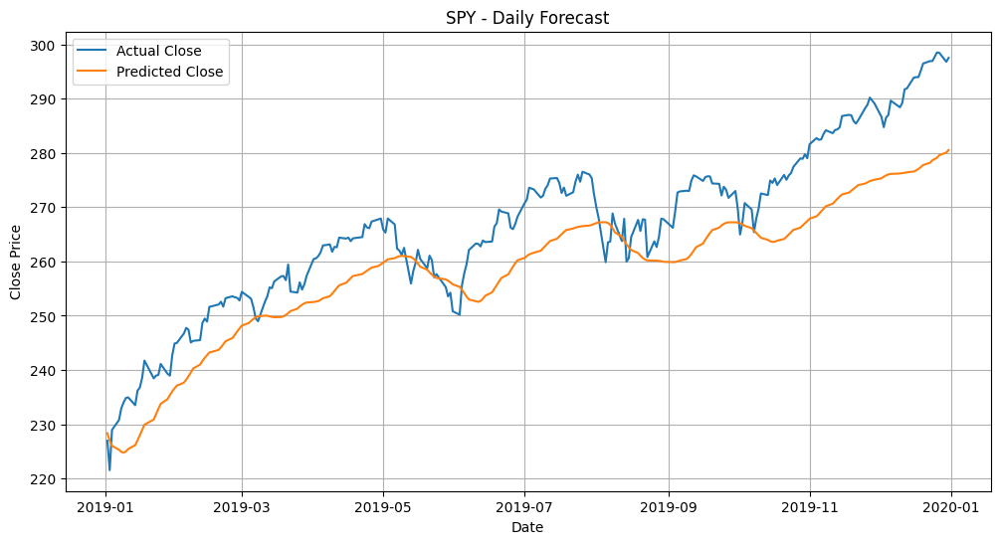

📉 Mean Scaled RMSE over 4 stocks: 0.12924124000074985


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 99ms/step

📊 Results for AAPL
RMSE: 1.5135
MAE : 1.2296
R^2 : 0.8191
MAPE: 0.0337


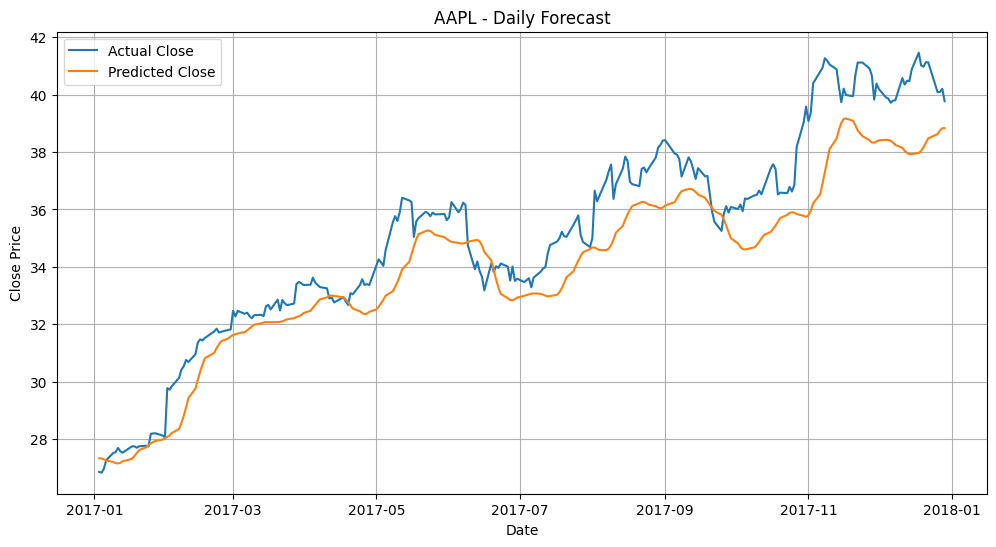

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 157ms/step

📊 Results for JPM
RMSE: 3.8462
MAE : 3.3943
R^2 : 0.5160
MAPE: 0.0462


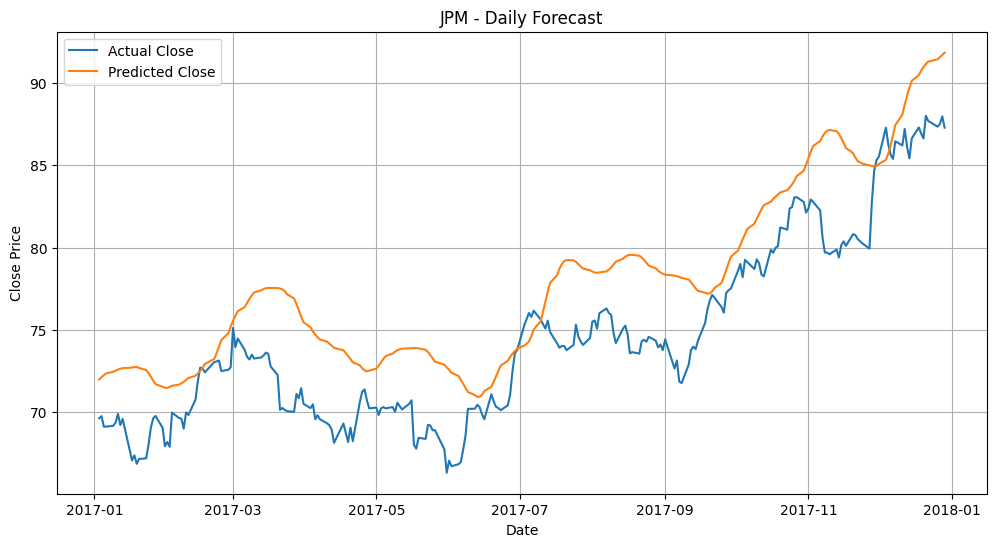

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step

📊 Results for NVDA
RMSE: 0.5075
MAE : 0.4008
R^2 : 0.7094
MAPE: 0.0973


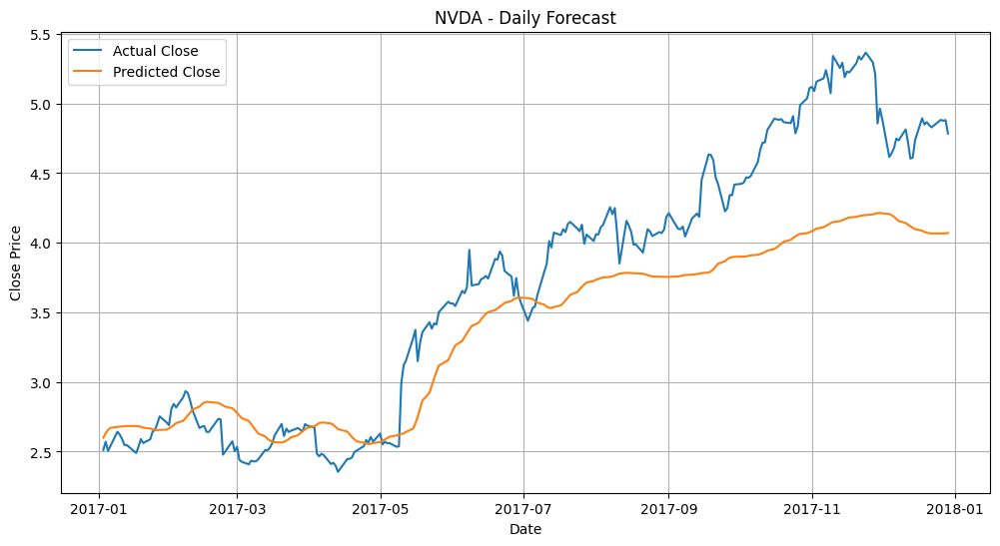

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 116ms/step

📊 Results for SPY
RMSE: 4.6816
MAE : 3.7019
R^2 : 0.8105
MAPE: 0.0167


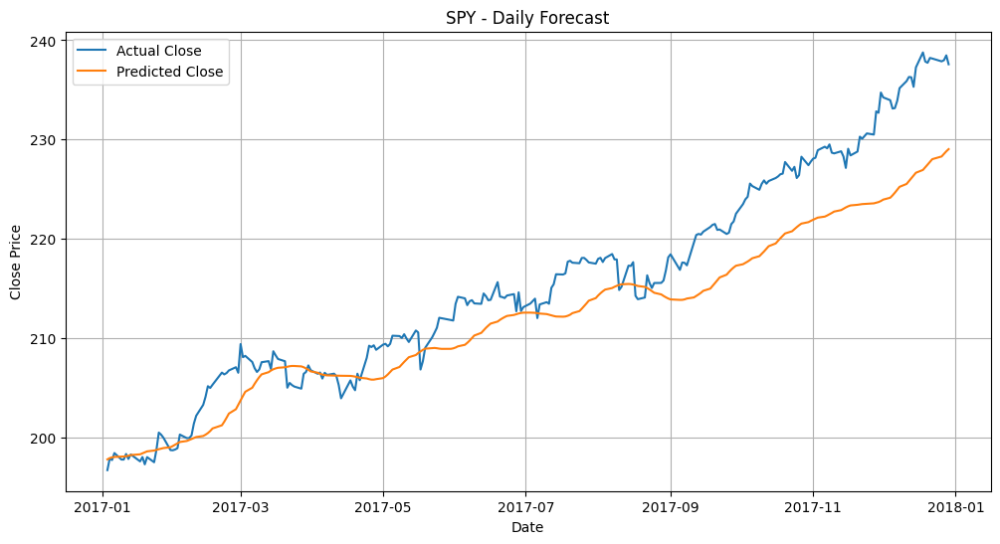

📉 Mean Scaled RMSE over 4 stocks: 0.14012431204035092


In [ ]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# All features

In [ ]:
from keras.optimizers import Adam

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step

📊 Results for AAPL
RMSE: 3.8374
MAE : 3.1328
R^2 : 0.9512
MAPE: 0.0182


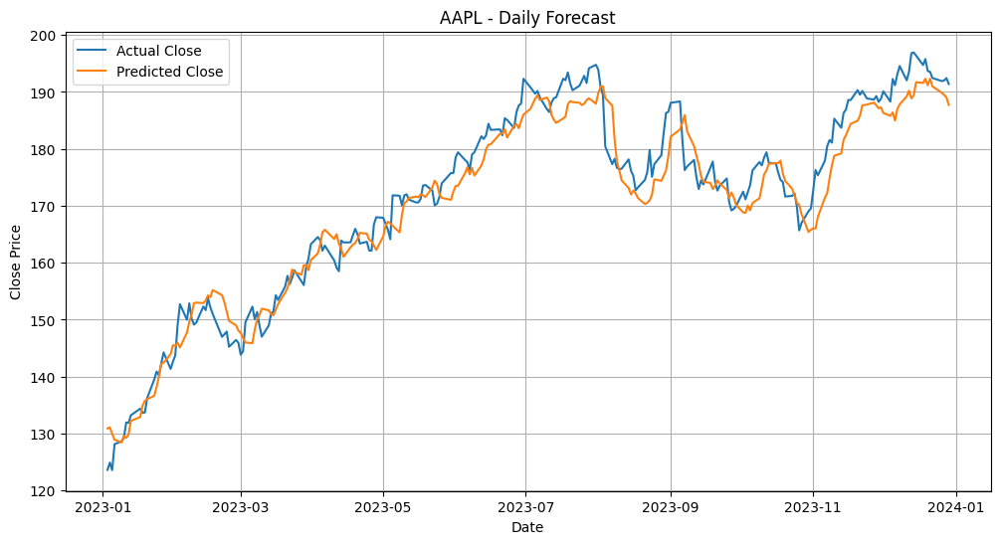

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step

📊 Results for JPM
RMSE: 3.0430
MAE : 2.3302
R^2 : 0.9016
MAPE: 0.0169


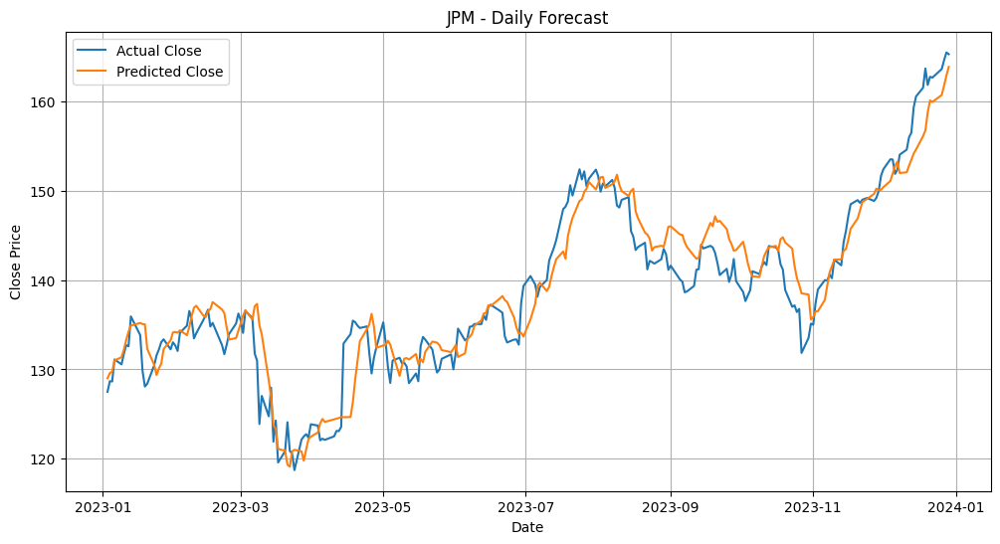

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for NVDA
RMSE: 3.5550
MAE : 2.7967
R^2 : 0.8903
MAPE: 0.0690


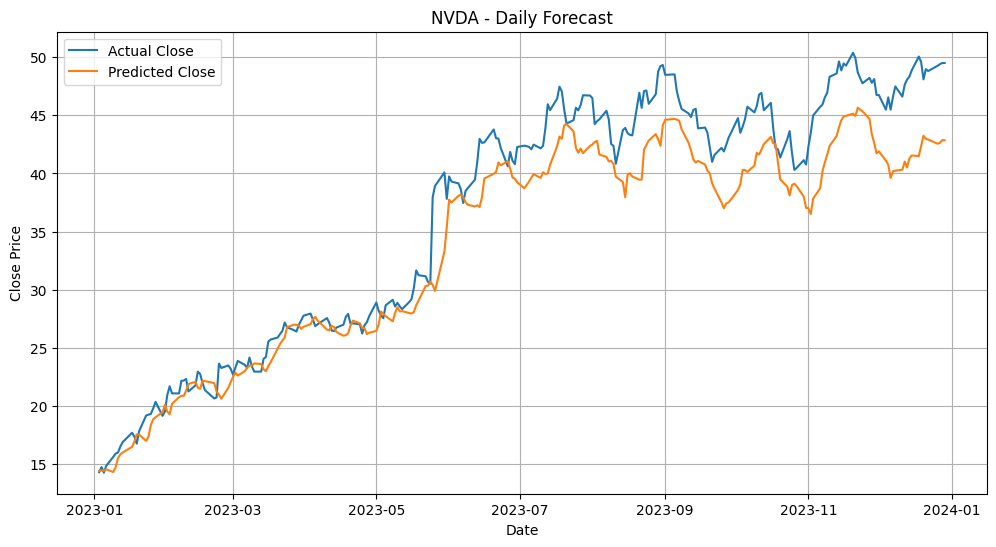

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step

📊 Results for SPY
RMSE: 6.5384
MAE : 5.3485
R^2 : 0.9252
MAPE: 0.0127


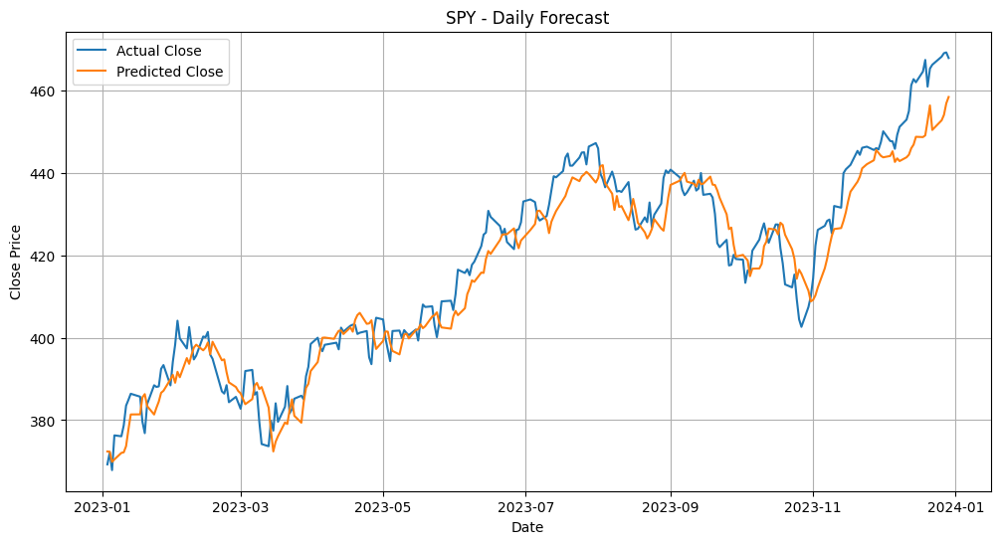

📉 Mean Scaled RMSE over 4 stocks: 0.07007503328224375


In [ ]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step

📊 Results for AAPL
RMSE: 1.6625
MAE : 1.3502
R^2 : 0.9618
MAPE: 0.0280


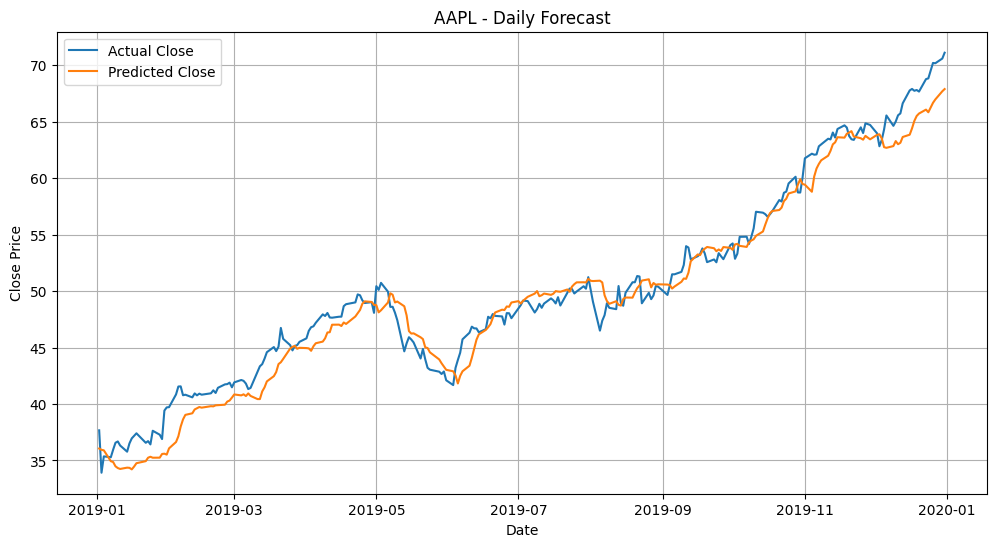

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step

📊 Results for JPM
RMSE: 2.3088
MAE : 1.8191
R^2 : 0.9420
MAPE: 0.0182


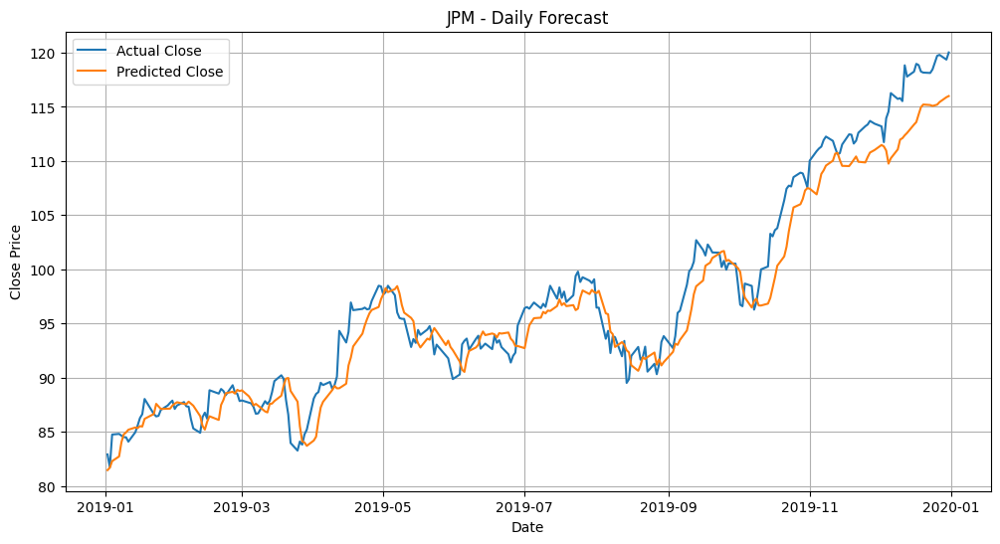

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for NVDA
RMSE: 0.1748
MAE : 0.1395
R^2 : 0.9215
MAPE: 0.0336


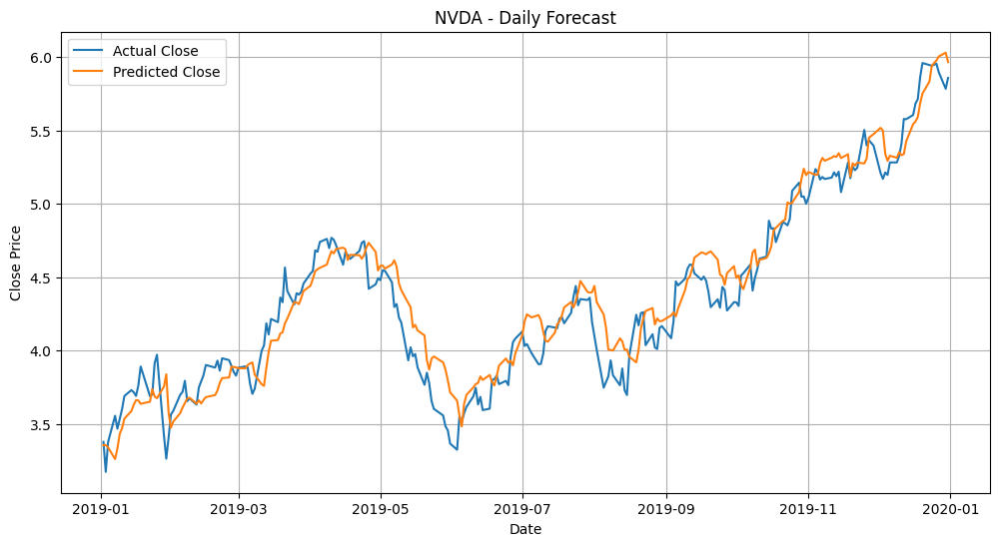

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step

📊 Results for SPY
RMSE: 5.0183
MAE : 4.2807
R^2 : 0.8885
MAPE: 0.0162


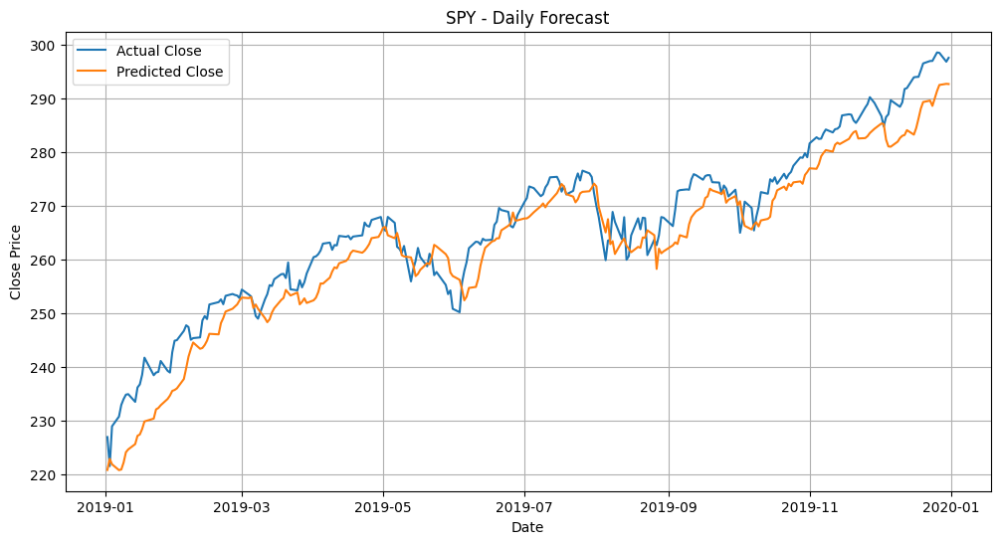

📉 Mean Scaled RMSE over 4 stocks: 0.05824356185548395


In [ ]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step

📊 Results for AAPL
RMSE: 1.1233
MAE : 0.9031
R^2 : 0.9003
MAPE: 0.0247


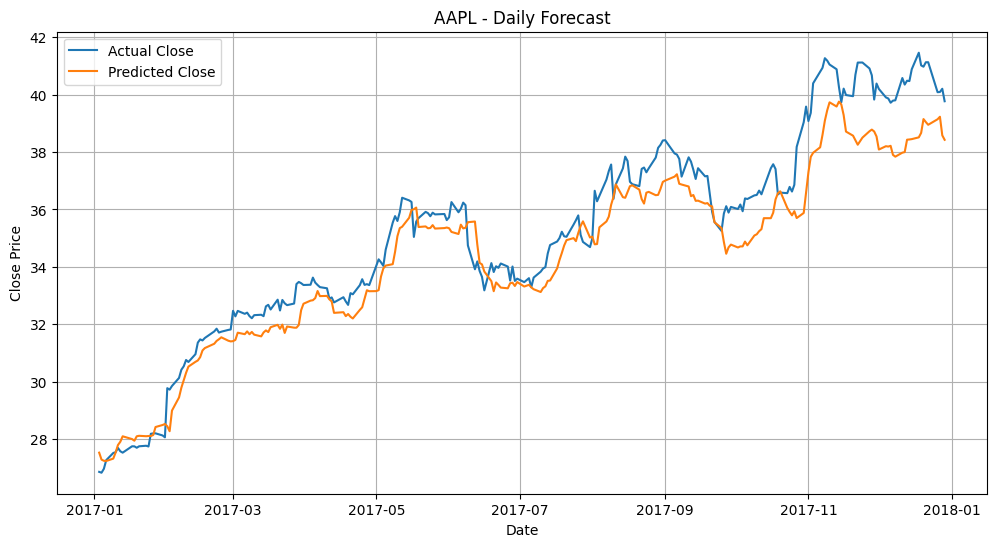

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step

📊 Results for JPM
RMSE: 2.9968
MAE : 2.5718
R^2 : 0.7061
MAPE: 0.0337


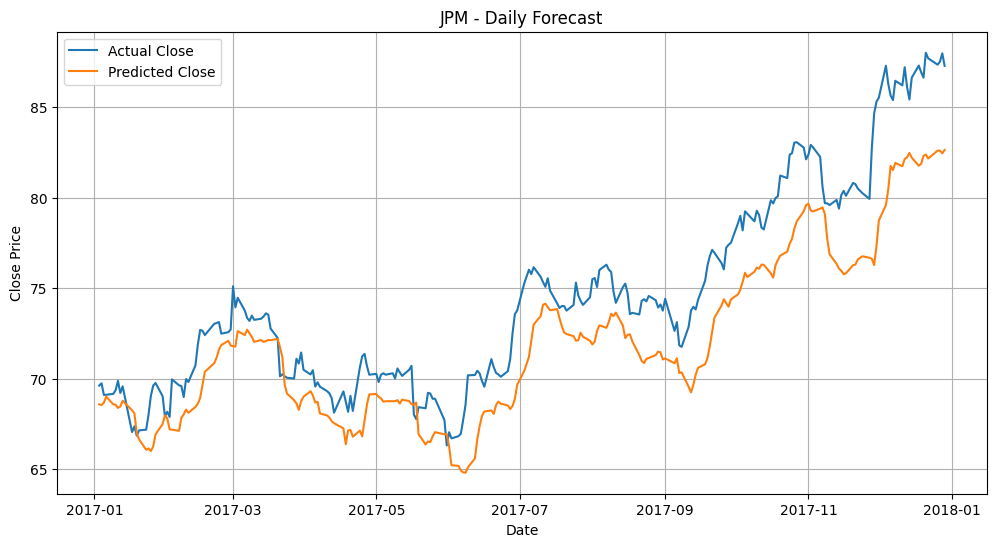

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for NVDA
RMSE: 0.4850
MAE : 0.3627
R^2 : 0.7345
MAPE: 0.0897


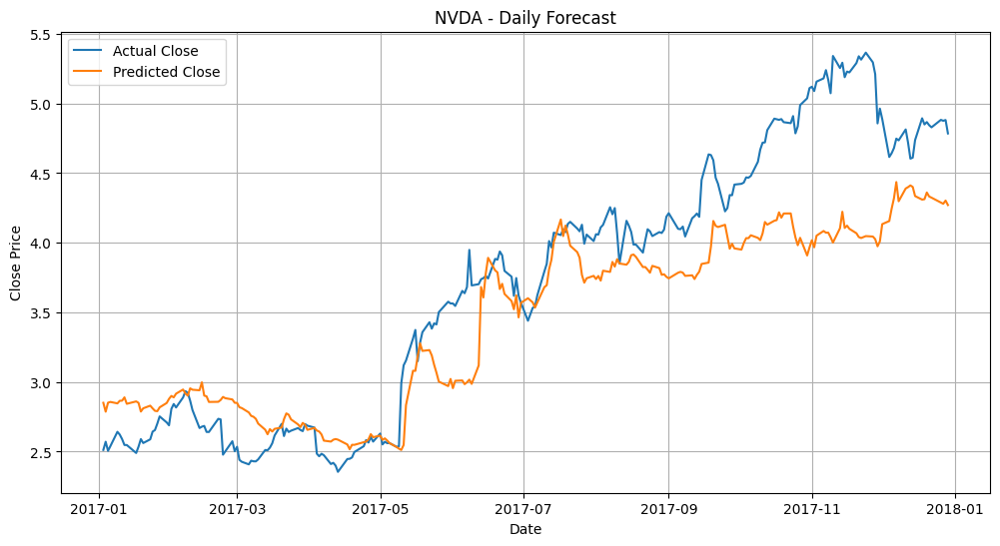

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for SPY
RMSE: 4.9325
MAE : 4.3466
R^2 : 0.7897
MAPE: 0.0198


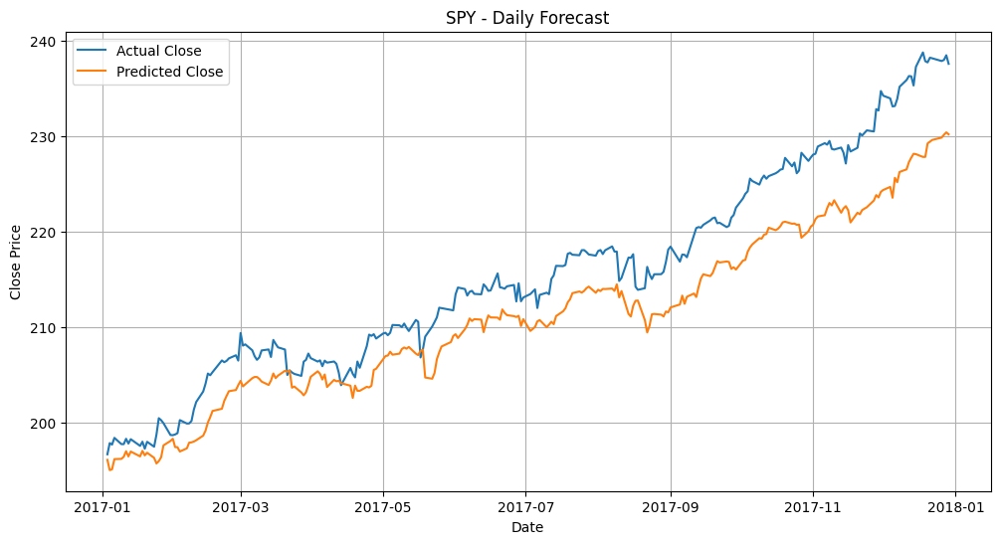

📉 Mean Scaled RMSE over 4 stocks: 0.12330119746090101


In [ ]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step

📊 Results for AAPL
RMSE: 5.7793
MAE : 4.9620
R^2 : 0.8892
MAPE: 0.0284


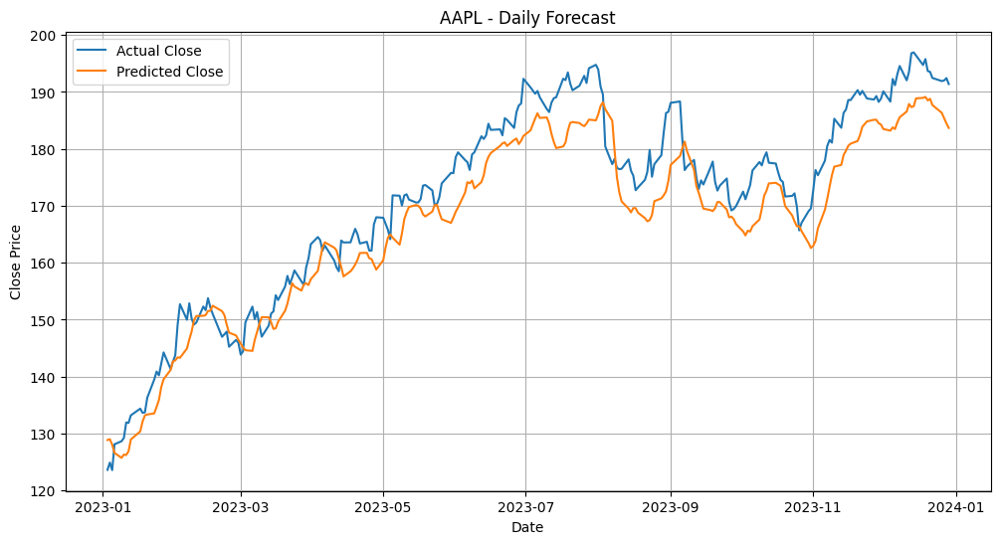

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 94ms/step

📊 Results for JPM
RMSE: 6.1540
MAE : 5.4317
R^2 : 0.5976
MAPE: 0.0387


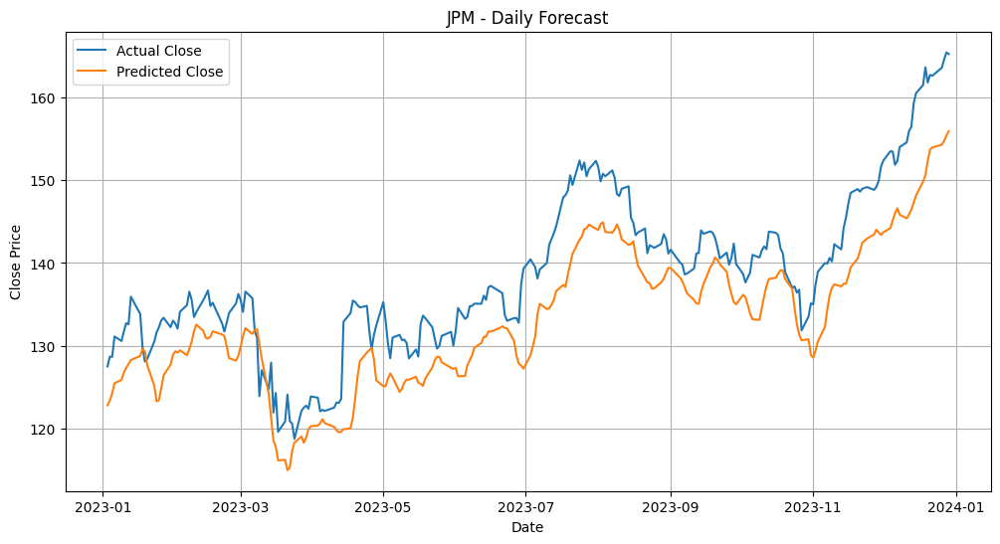

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step

📊 Results for NVDA
RMSE: 4.7360
MAE : 3.6056
R^2 : 0.8053
MAPE: 0.0868


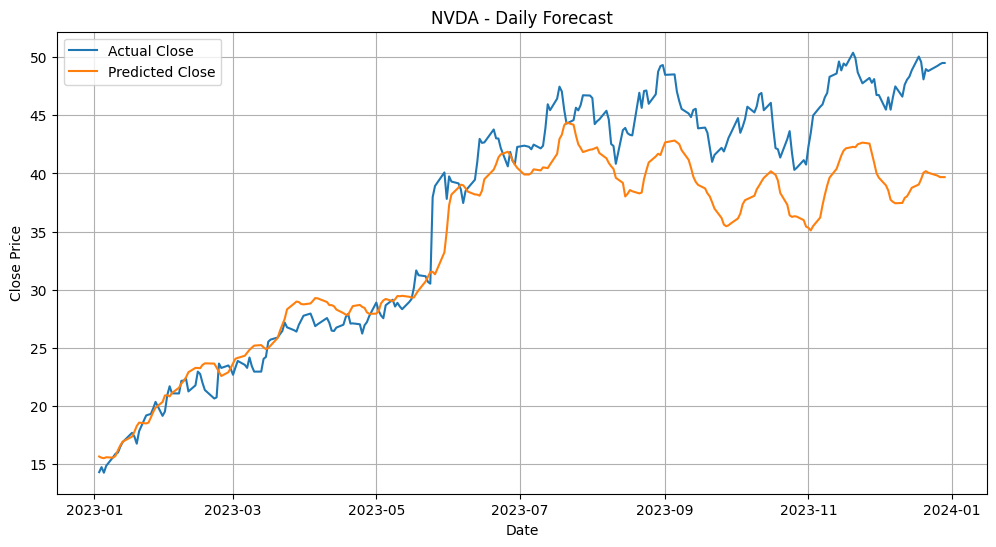

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 84ms/step

📊 Results for SPY
RMSE: 8.5583
MAE : 6.8917
R^2 : 0.8719
MAPE: 0.0162


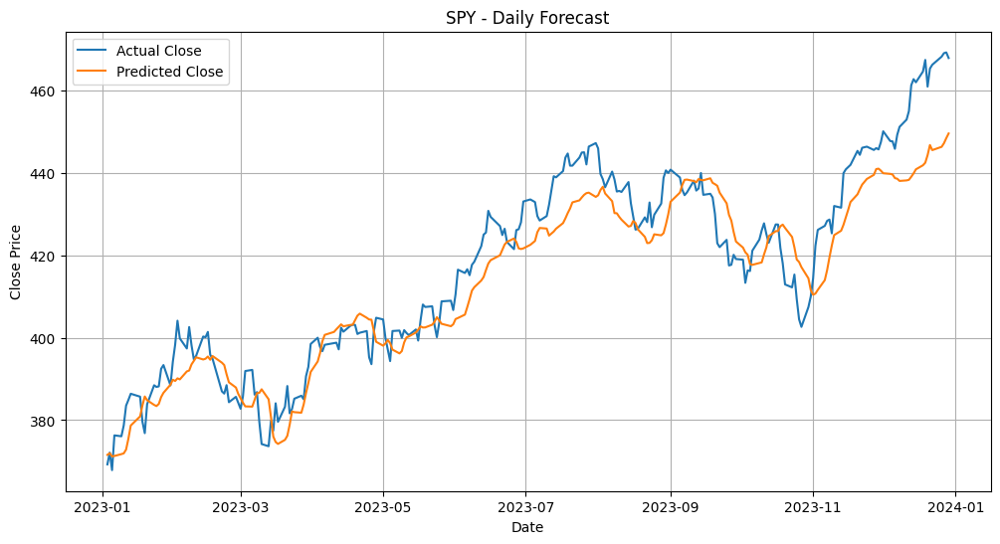

📉 Mean Scaled RMSE over 4 stocks: 0.10648396995884046


In [ ]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step

📊 Results for AAPL
RMSE: 2.2573
MAE : 1.8513
R^2 : 0.9295
MAPE: 0.0363


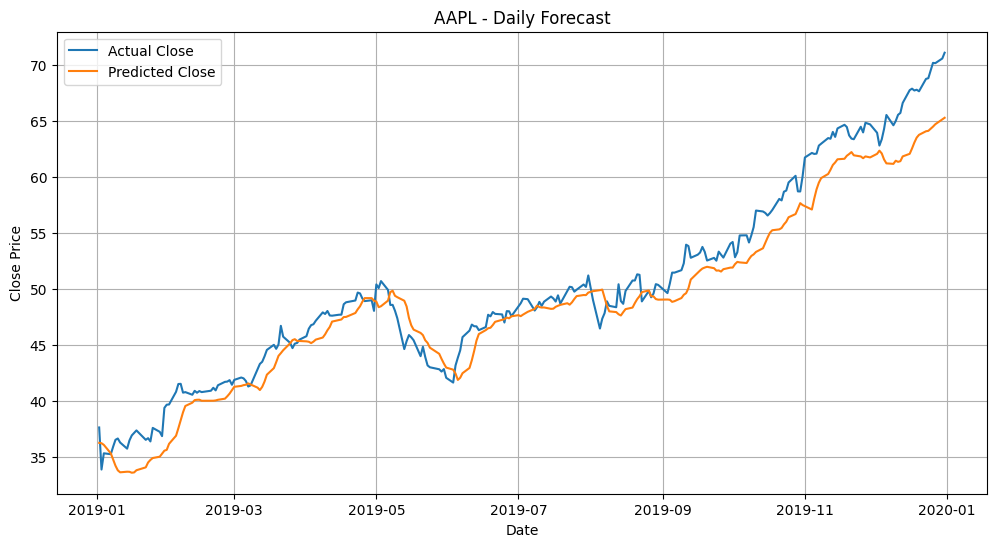

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step

📊 Results for JPM
RMSE: 3.5748
MAE : 2.7641
R^2 : 0.8609
MAPE: 0.0272


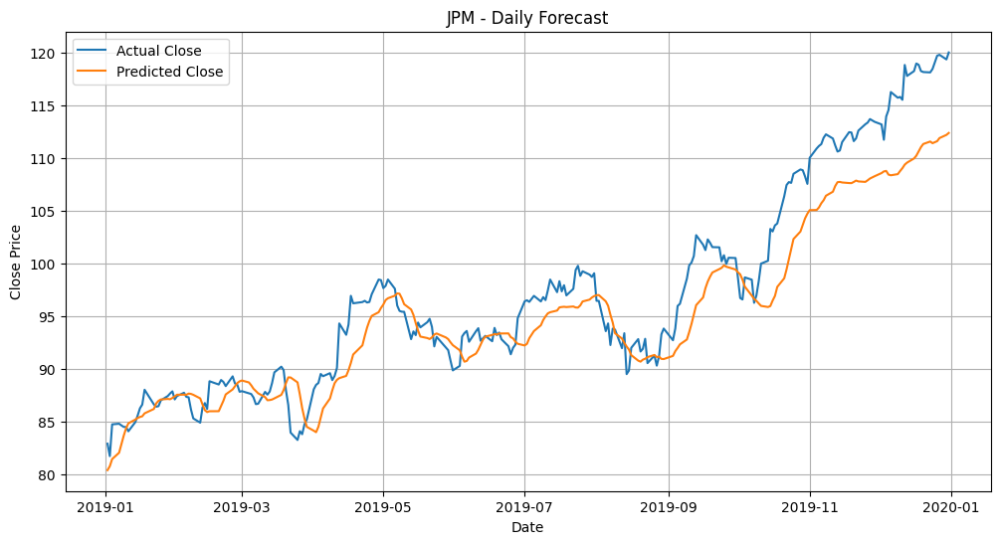

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step

📊 Results for NVDA
RMSE: 0.3021
MAE : 0.2498
R^2 : 0.7654
MAPE: 0.0596


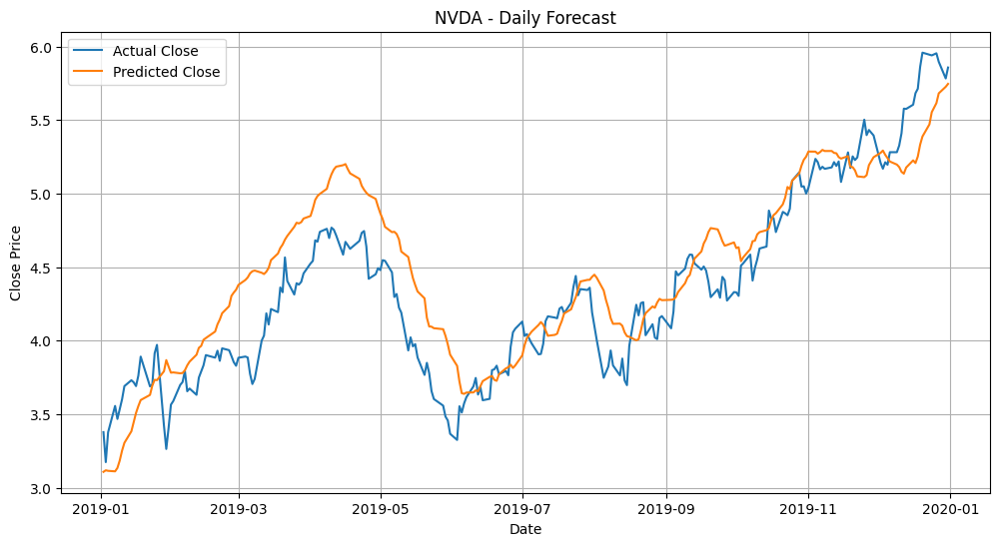

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step

📊 Results for SPY
RMSE: 10.2113
MAE : 9.3778
R^2 : 0.5382
MAPE: 0.0350


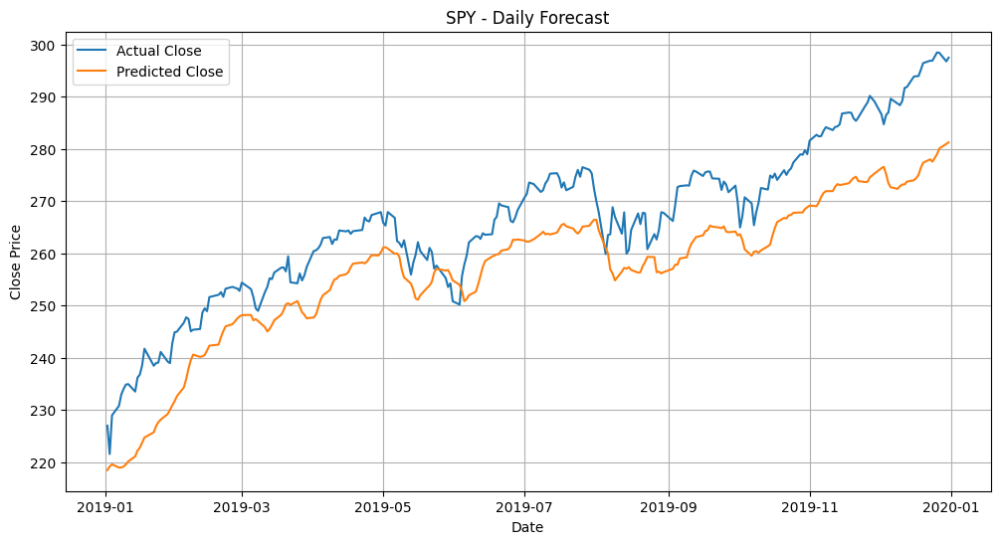

📉 Mean Scaled RMSE over 4 stocks: 0.09880410576843196


In [ ]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 190ms/step

📊 Results for AAPL
RMSE: 1.7226
MAE : 1.4014
R^2 : 0.7657
MAPE: 0.0379


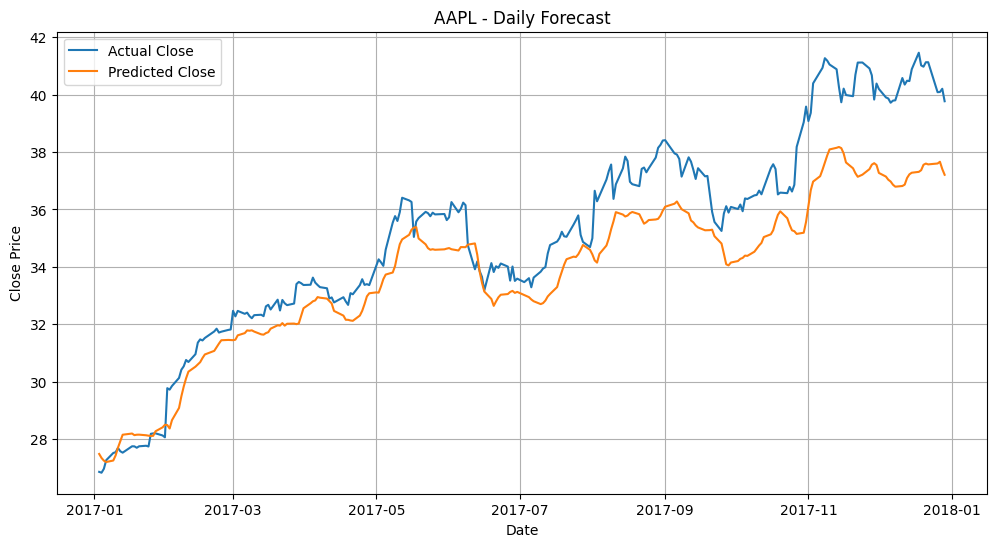

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step

📊 Results for JPM
RMSE: 3.0453
MAE : 2.6799
R^2 : 0.6965
MAPE: 0.0354


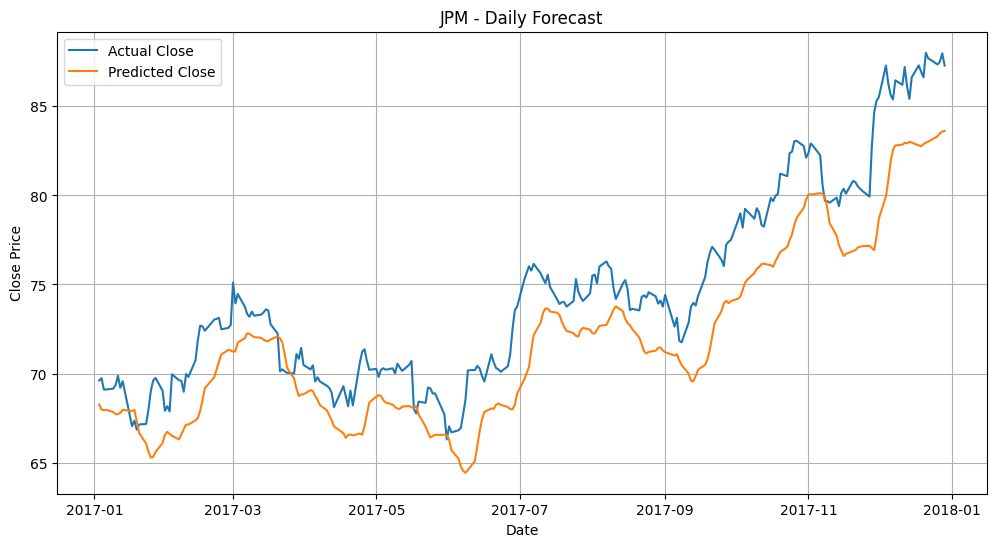

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 58ms/step

📊 Results for NVDA
RMSE: 0.6366
MAE : 0.4946
R^2 : 0.5427
MAPE: 0.1190


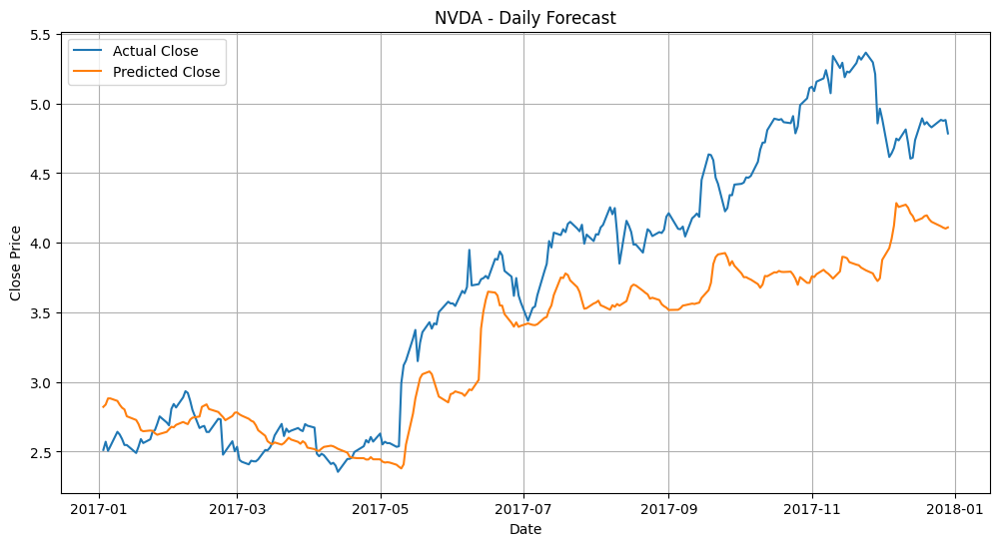

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step

📊 Results for SPY
RMSE: 5.6943
MAE : 4.6145
R^2 : 0.7197
MAPE: 0.0208


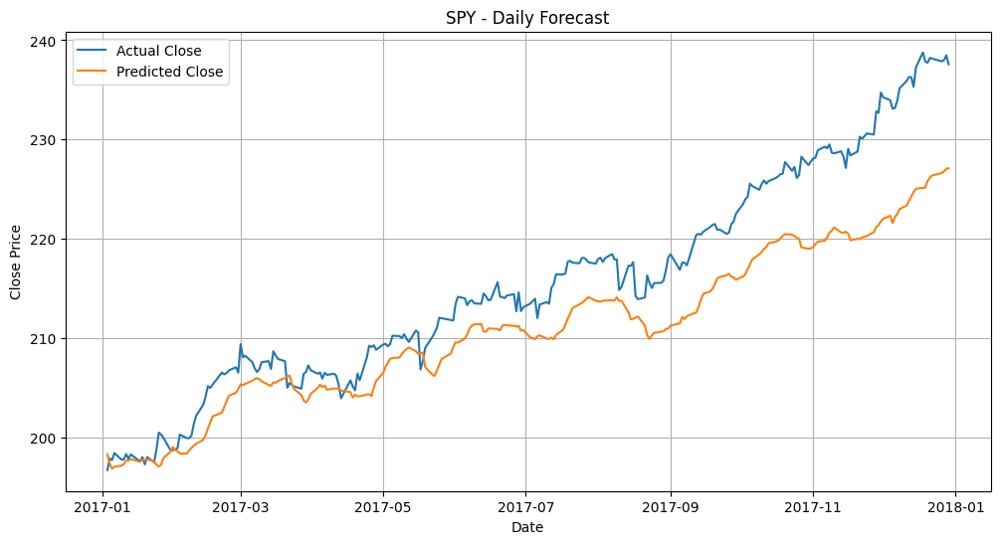

📉 Mean Scaled RMSE over 4 stocks: 0.15122162786623516


In [ ]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step

📊 Results for AAPL
RMSE: 5.7547
MAE : 4.4052
R^2 : 0.8902
MAPE: 0.0258


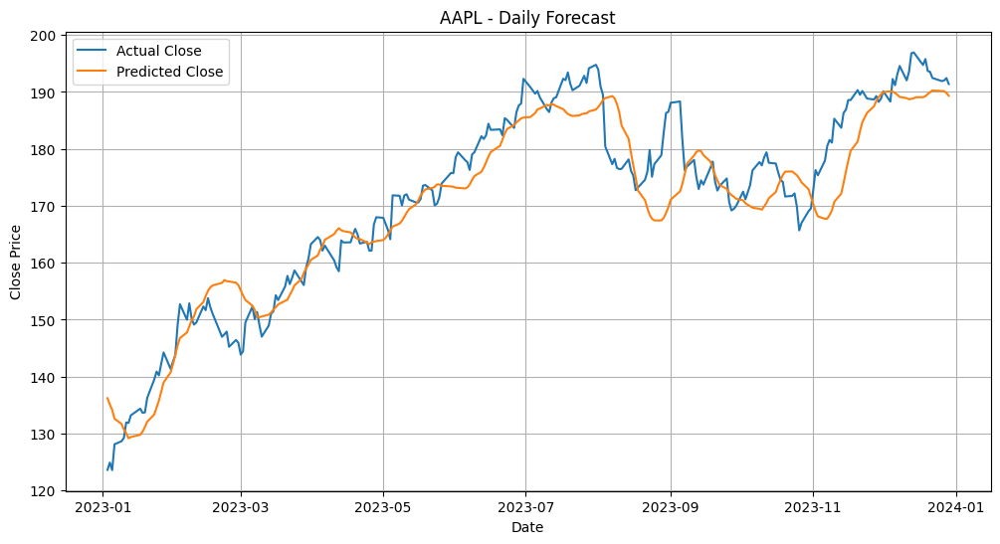

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step

📊 Results for JPM
RMSE: 5.2534
MAE : 4.2055
R^2 : 0.7067
MAPE: 0.0298


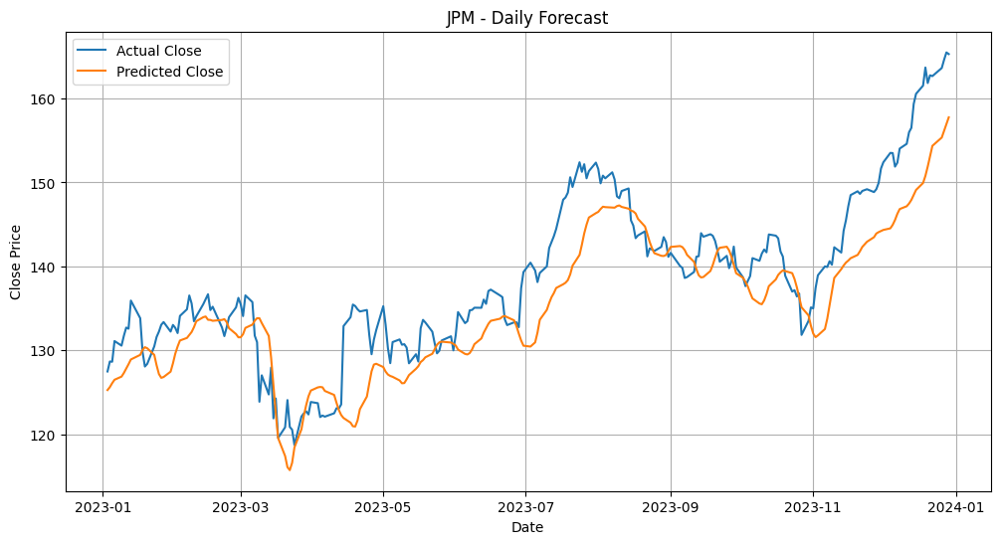

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step

📊 Results for NVDA
RMSE: 7.7419
MAE : 6.1075
R^2 : 0.4796
MAPE: 0.1451


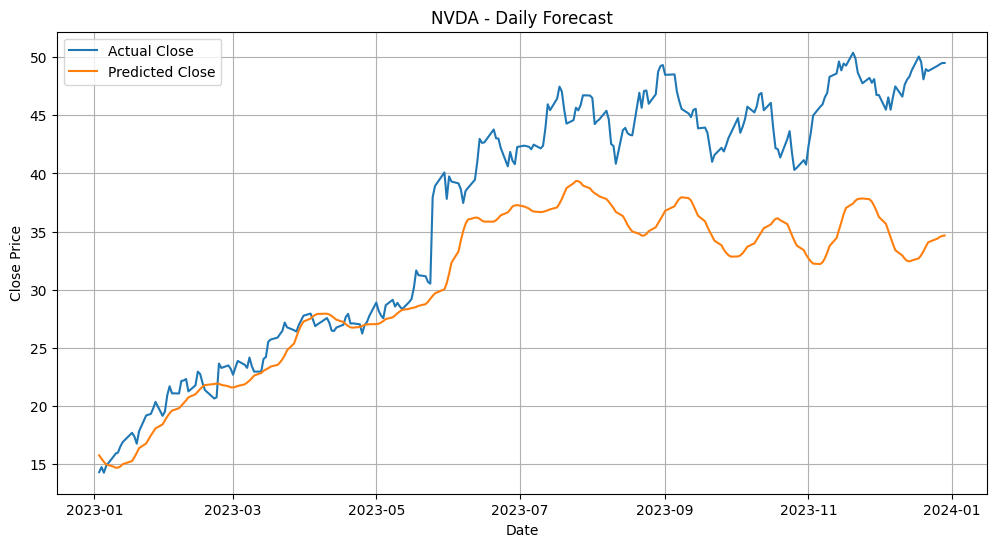

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 152ms/step

📊 Results for SPY
RMSE: 9.3613
MAE : 7.3857
R^2 : 0.8467
MAPE: 0.0175


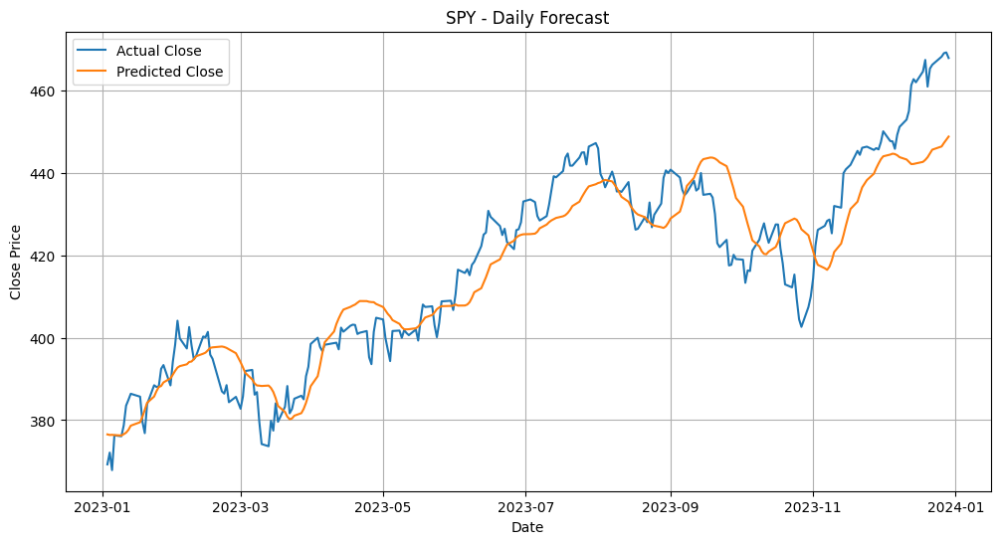

📉 Mean Scaled RMSE over 4 stocks: 0.12436166359479417


In [ ]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step

📊 Results for AAPL
RMSE: 4.3043
MAE : 3.7265
R^2 : 0.7438
MAPE: 0.0720


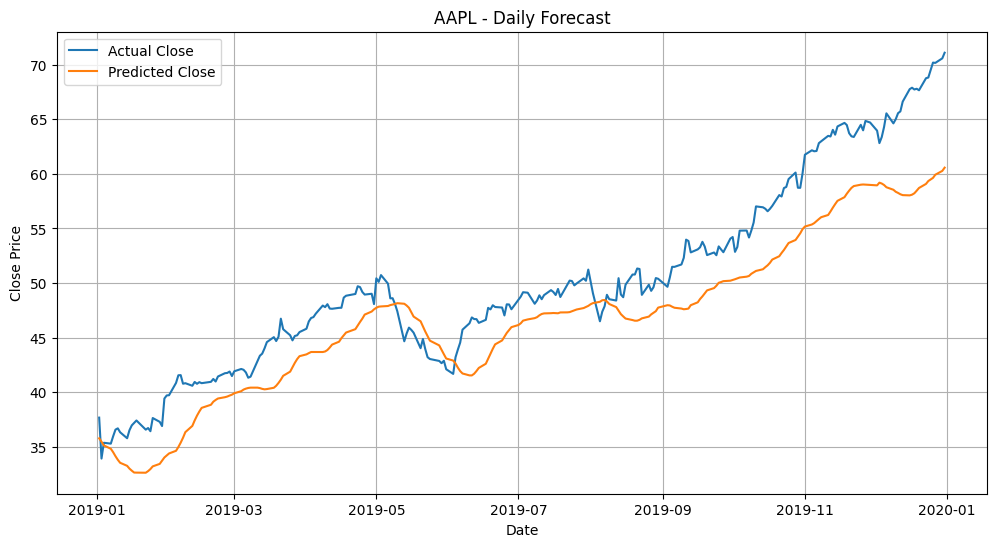

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 97ms/step

📊 Results for JPM
RMSE: 5.2894
MAE : 4.1903
R^2 : 0.6955
MAPE: 0.0412


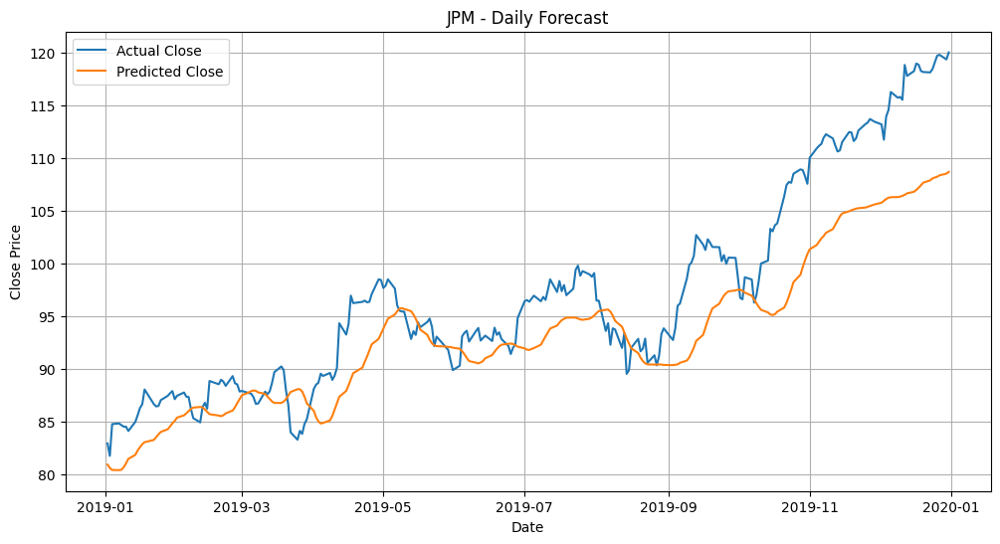

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 105ms/step

📊 Results for NVDA
RMSE: 0.4387
MAE : 0.3535
R^2 : 0.5051
MAPE: 0.0854


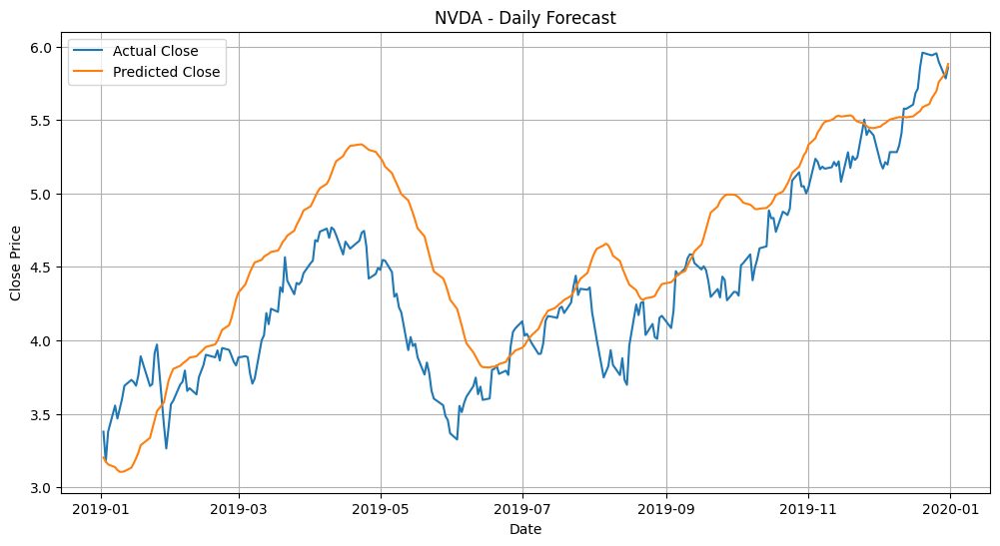

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 102ms/step

📊 Results for SPY
RMSE: 8.5391
MAE : 7.4898
R^2 : 0.6770
MAPE: 0.0281


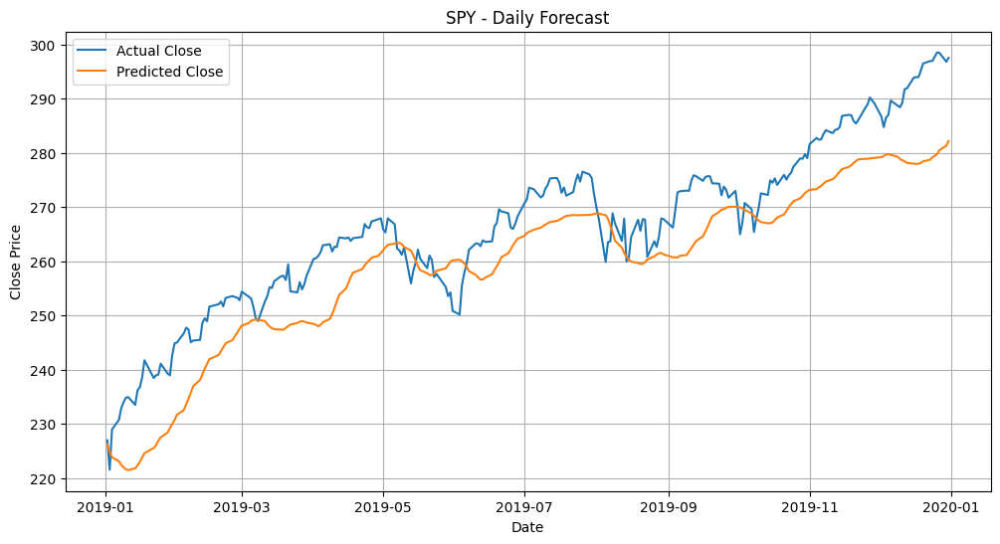

📉 Mean Scaled RMSE over 4 stocks: 0.13060374637284378


In [ ]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 100ms/step

📊 Results for AAPL
RMSE: 2.8087
MAE : 2.5551
R^2 : 0.3770
MAPE: 0.0708


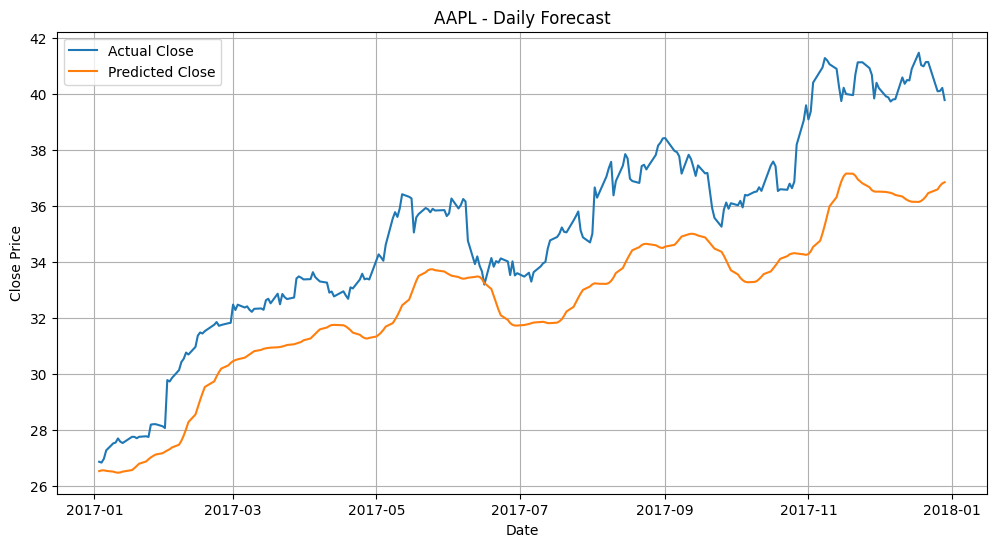

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 101ms/step

📊 Results for JPM
RMSE: 2.8022
MAE : 2.3575
R^2 : 0.7431
MAPE: 0.0322


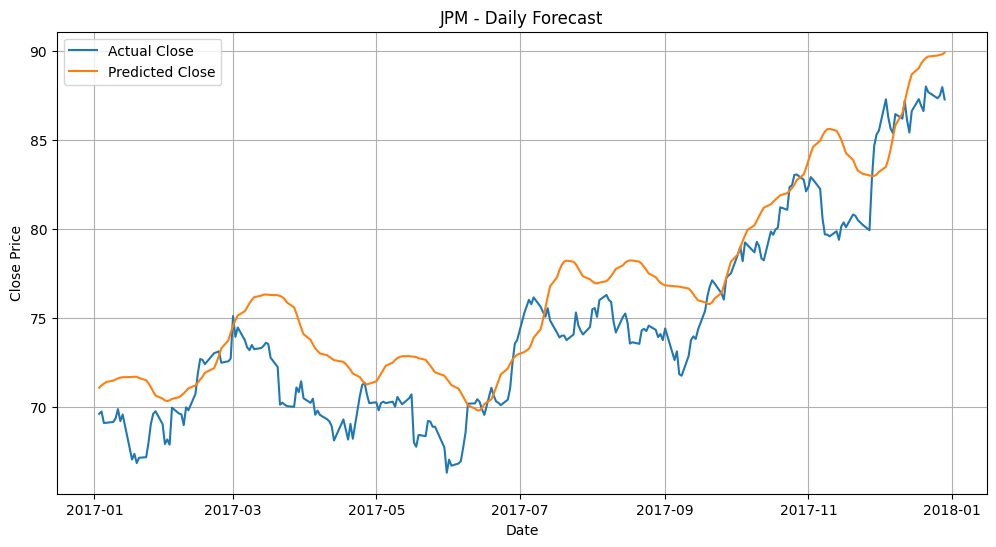

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step

📊 Results for NVDA
RMSE: 0.4206
MAE : 0.3606
R^2 : 0.8004
MAPE: 0.1149


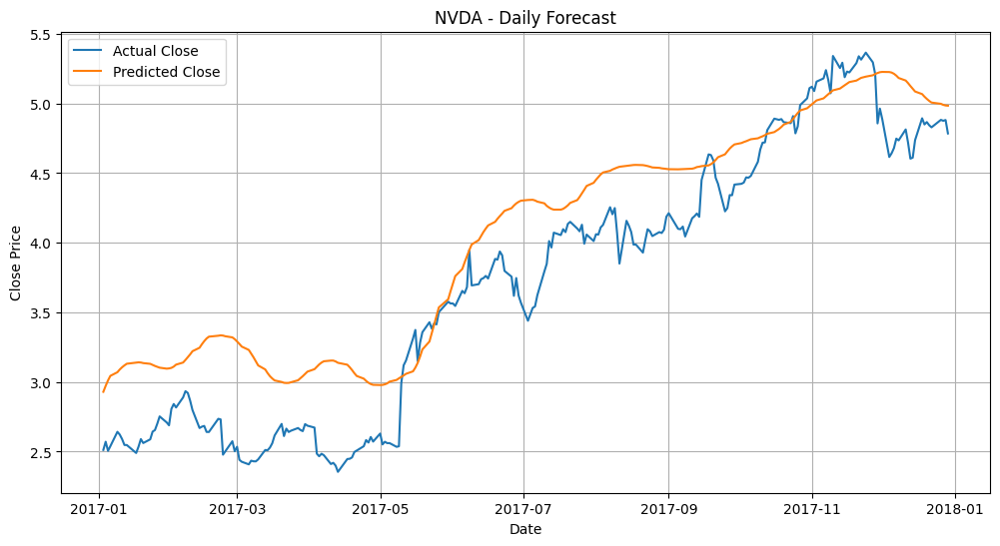

8/8 ━━━━━━━━━━━━━━━━━━━━ 4s 117ms/step

📊 Results for SPY
RMSE: 5.0649
MAE : 3.9885
R^2 : 0.7782
MAPE: 0.0179


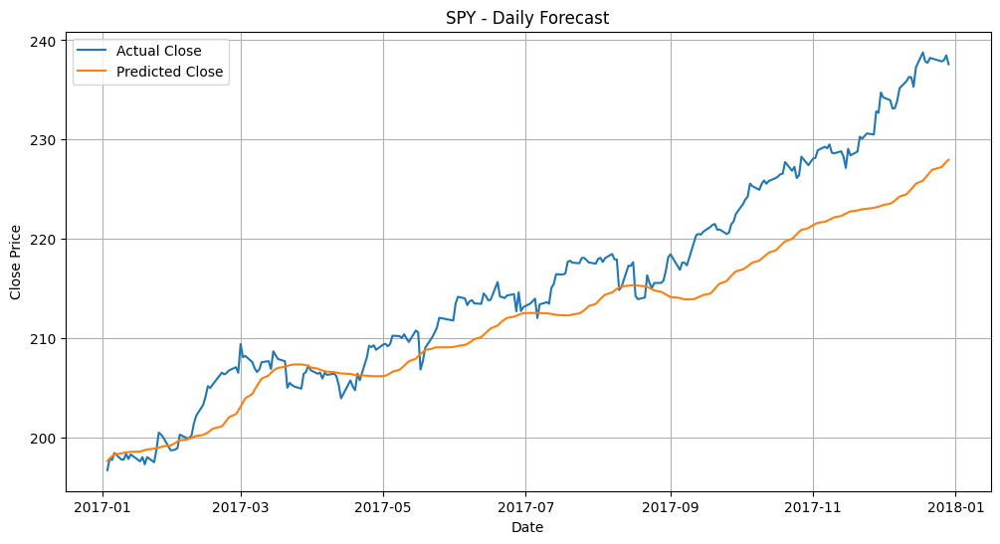

📉 Mean Scaled RMSE over 4 stocks: 0.1453021507008194


In [13]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Early stopping and dropout

In [15]:
from keras.optimizers import Adam
from keras.layers import Dropout
from keras.callbacks import EarlyStopping

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step

📊 Results for AAPL
RMSE: 6.6864
MAE : 5.7976
R^2 : 0.8517
MAPE: 0.0334


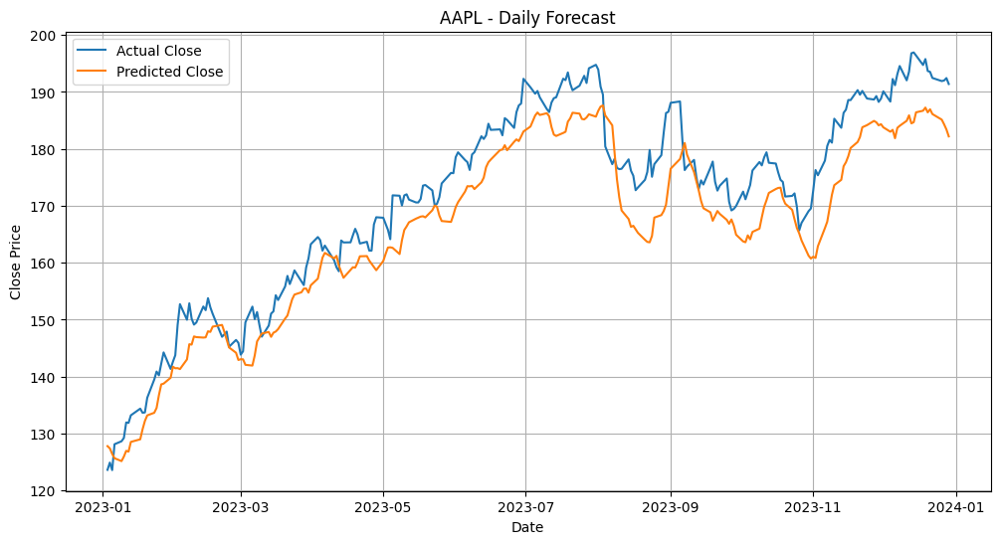

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step

📊 Results for JPM
RMSE: 3.6327
MAE : 2.9640
R^2 : 0.8598
MAPE: 0.0212


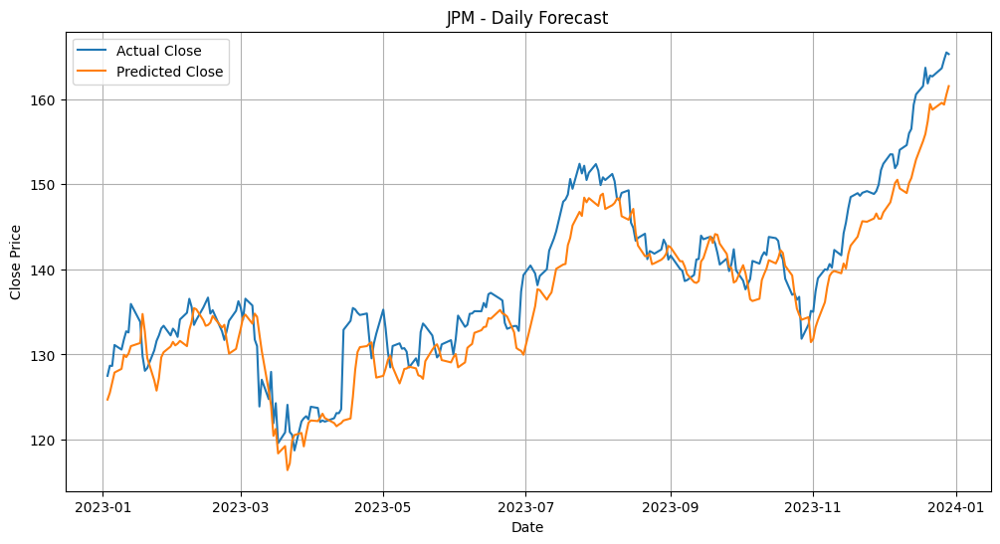

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step

📊 Results for NVDA
RMSE: 3.6297
MAE : 2.8080
R^2 : 0.8856
MAPE: 0.0683


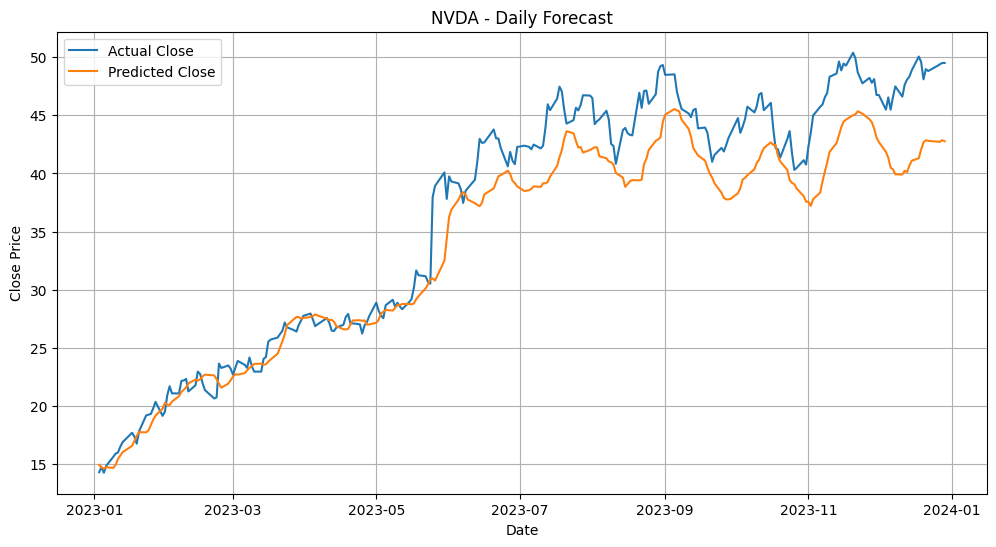

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step

📊 Results for SPY
RMSE: 7.6063
MAE : 6.2473
R^2 : 0.8988
MAPE: 0.0148


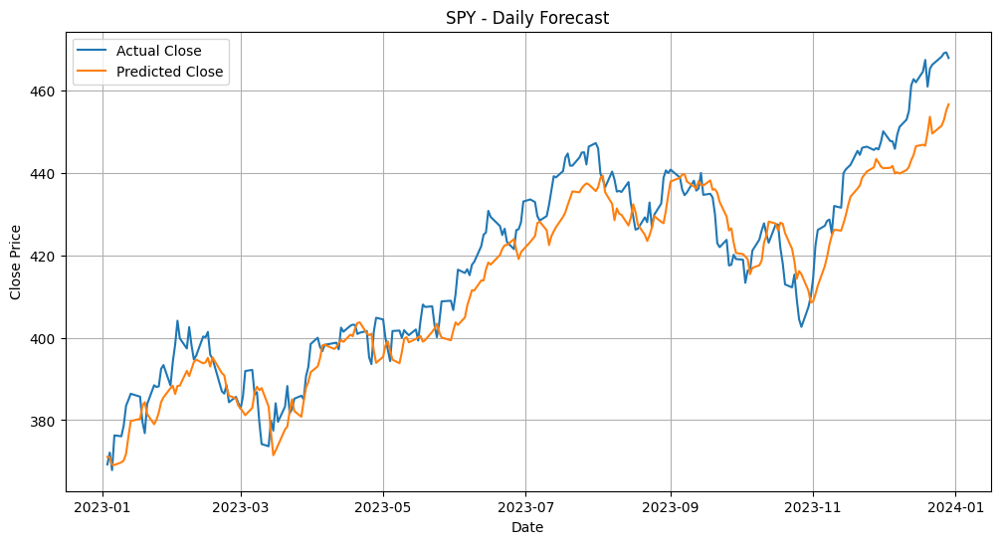

📉 Mean Scaled RMSE over 4 stocks: 0.08608956965400576


In [16]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dropout(0.1),
        Dense(1)
    ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )

    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=64, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 97ms/step

📊 Results for AAPL
RMSE: 1.4203
MAE : 1.0981
R^2 : 0.9721
MAPE: 0.0224


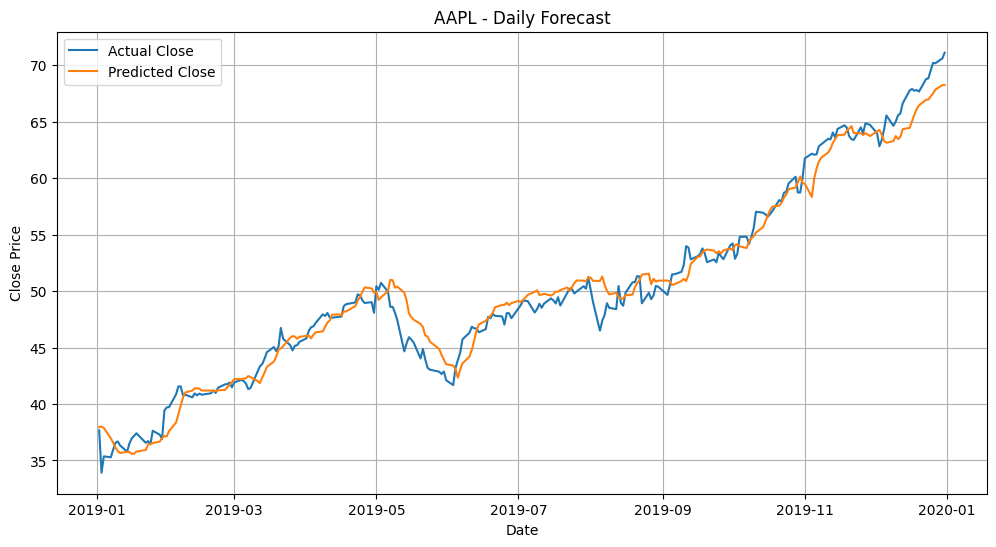

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step

📊 Results for JPM
RMSE: 2.6655
MAE : 2.1133
R^2 : 0.9227
MAPE: 0.0211


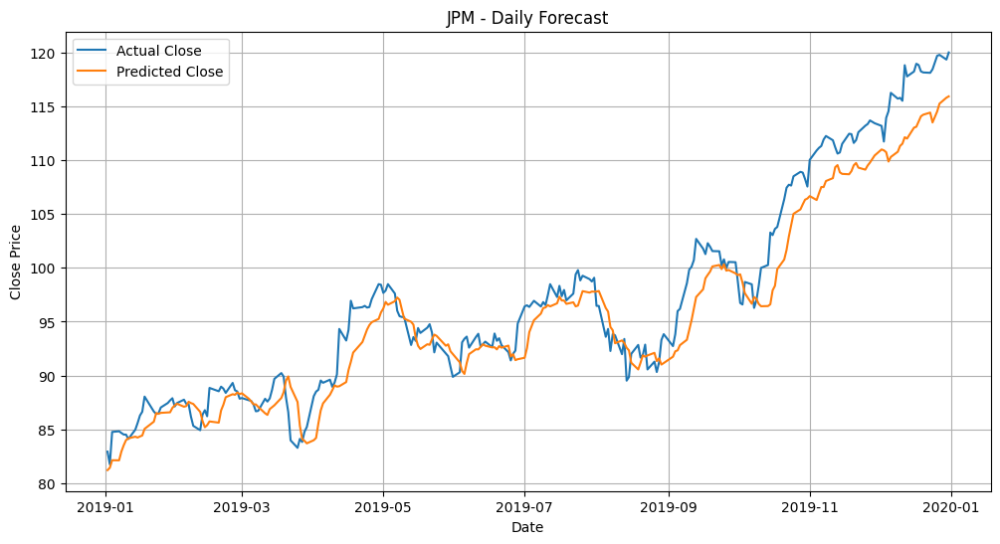

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step

📊 Results for NVDA
RMSE: 0.2333
MAE : 0.1831
R^2 : 0.8600
MAPE: 0.0436


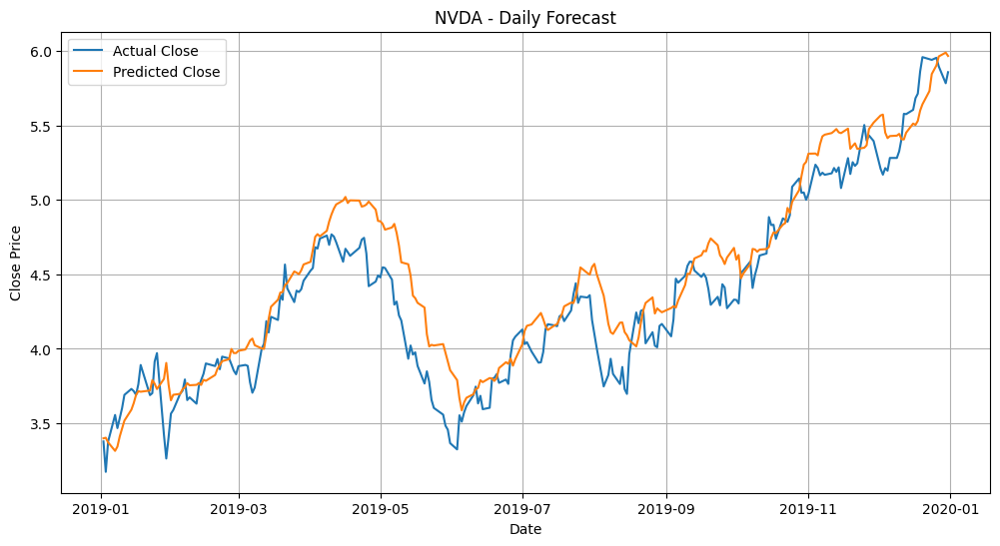

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 52ms/step

📊 Results for SPY
RMSE: 5.3126
MAE : 4.6711
R^2 : 0.8750
MAPE: 0.0177


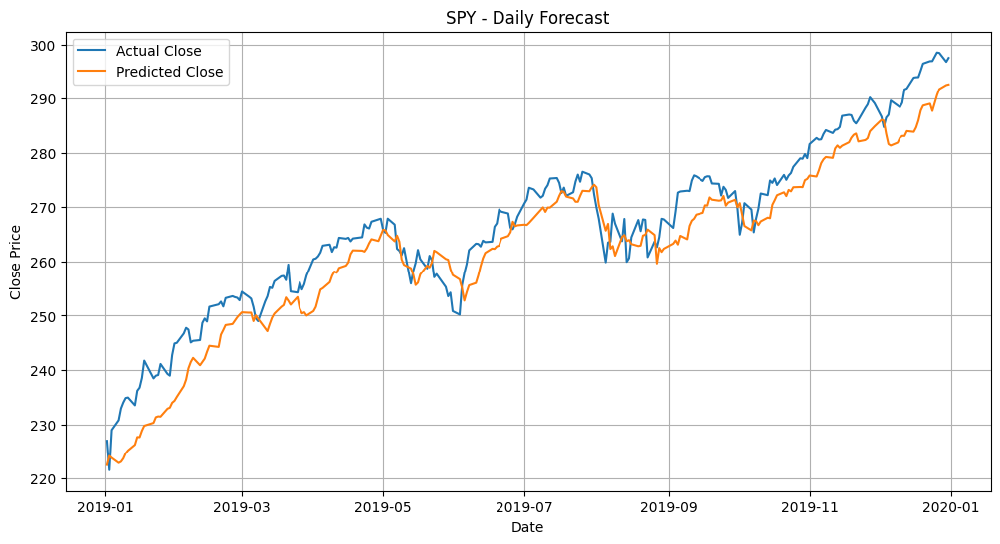

📉 Mean Scaled RMSE over 4 stocks: 0.06515626679577347


In [17]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dropout(0.1),
        Dense(1)
    ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )

    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=64, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step

📊 Results for AAPL
RMSE: 1.4940
MAE : 1.2583
R^2 : 0.8237
MAPE: 0.0344


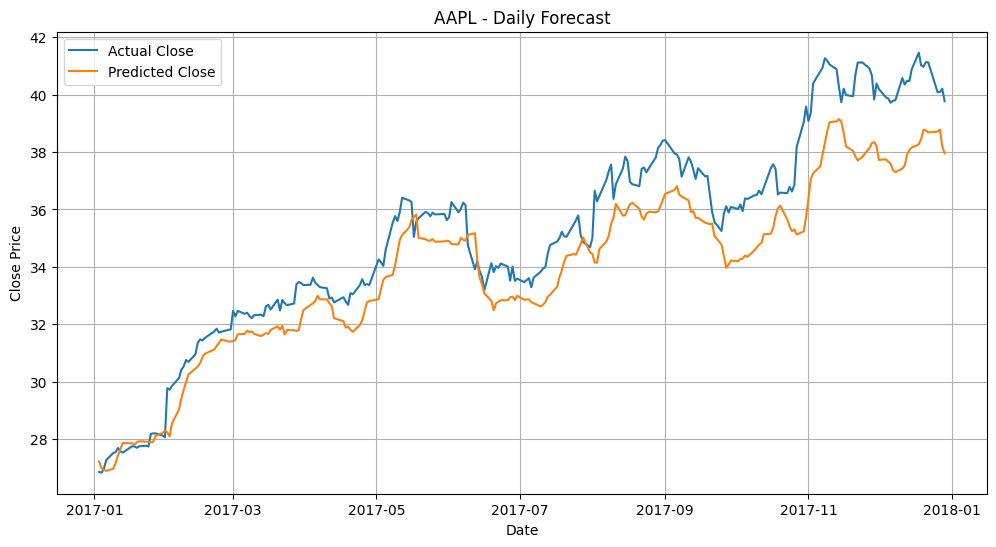

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step

📊 Results for JPM
RMSE: 3.6526
MAE : 3.2936
R^2 : 0.5634
MAPE: 0.0436


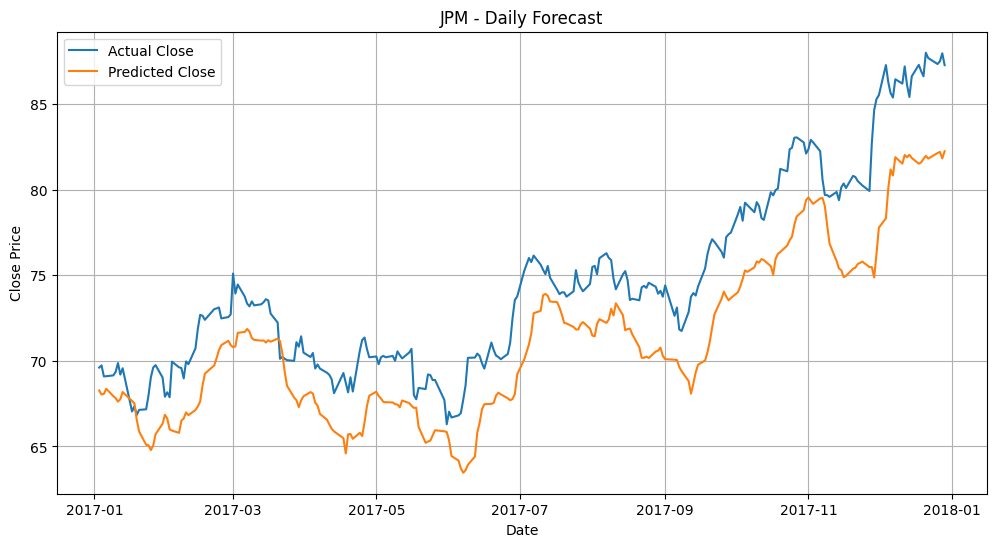

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 89ms/step

📊 Results for NVDA
RMSE: 0.2397
MAE : 0.1887
R^2 : 0.9351
MAPE: 0.0525


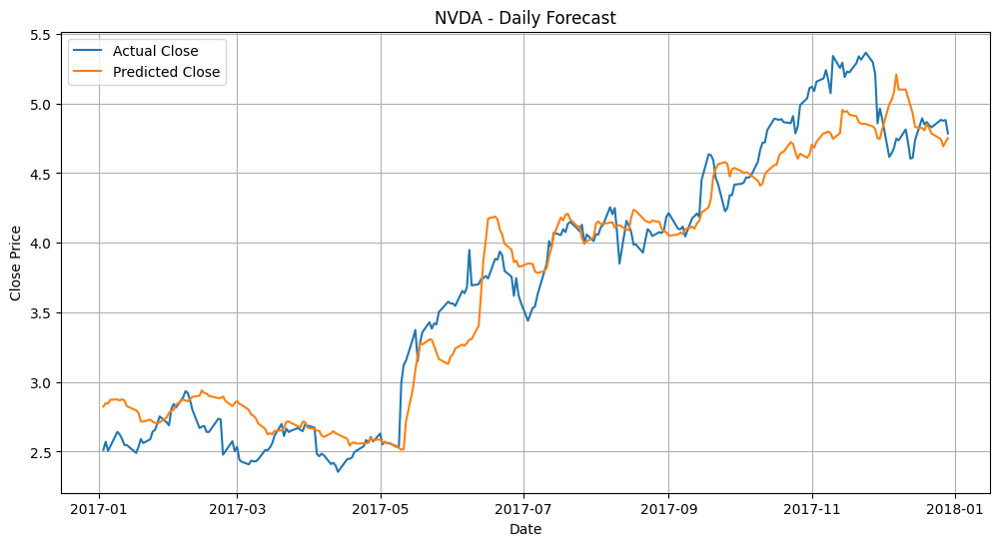

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step

📊 Results for SPY
RMSE: 4.5234
MAE : 4.0937
R^2 : 0.8231
MAPE: 0.0187


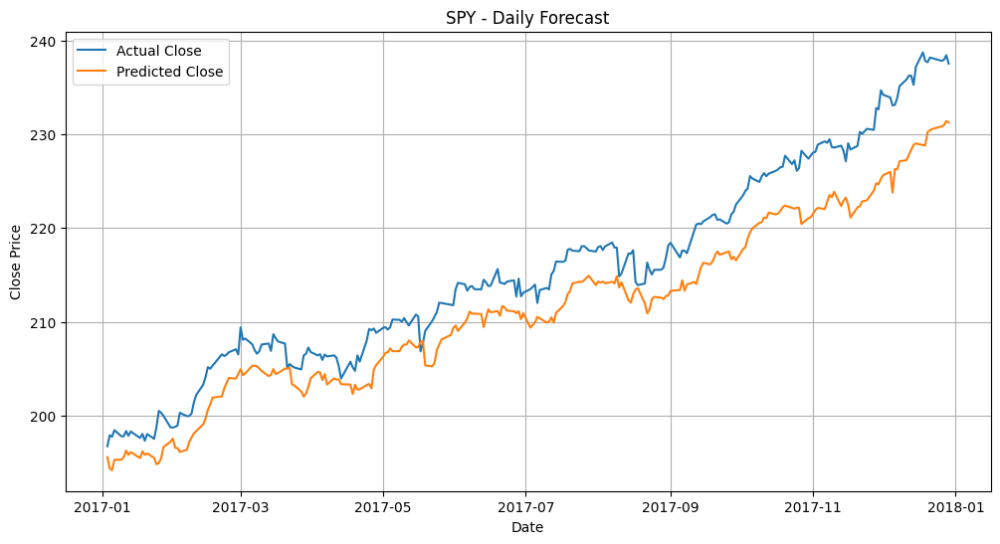

📉 Mean Scaled RMSE over 4 stocks: 0.11438426755841885


In [18]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dropout(0.1),
        Dense(1)
    ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )

    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=64, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step

📊 Results for AAPL
RMSE: 7.5570
MAE : 6.7925
R^2 : 0.8106
MAPE: 0.0391


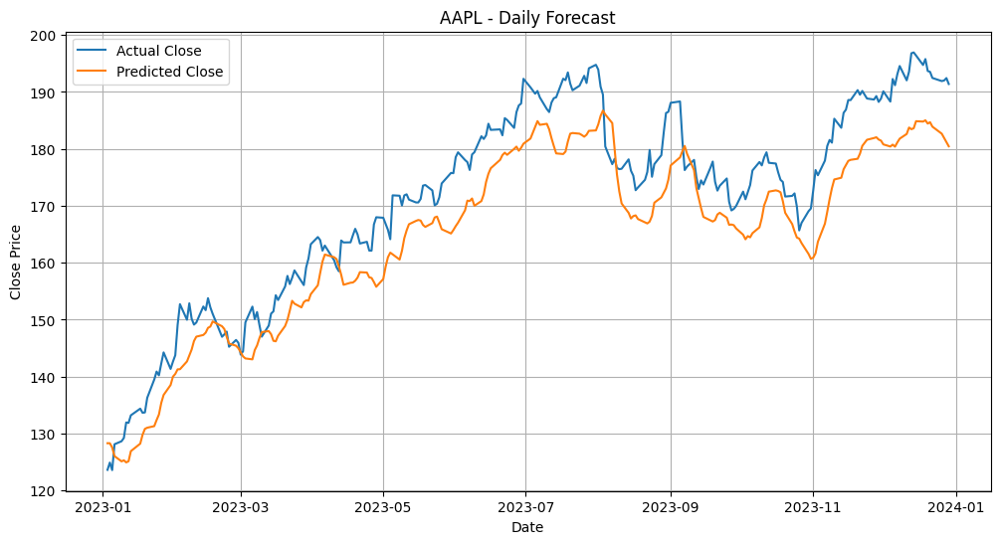

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step

📊 Results for JPM
RMSE: 3.4557
MAE : 2.6852
R^2 : 0.8731
MAPE: 0.0191


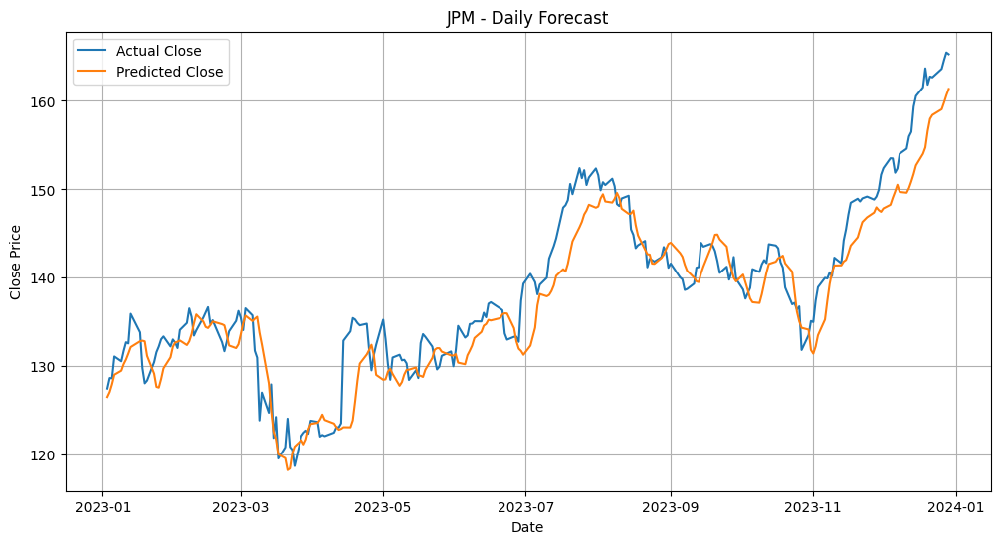

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step

📊 Results for NVDA
RMSE: 4.7275
MAE : 3.7530
R^2 : 0.8060
MAPE: 0.0899


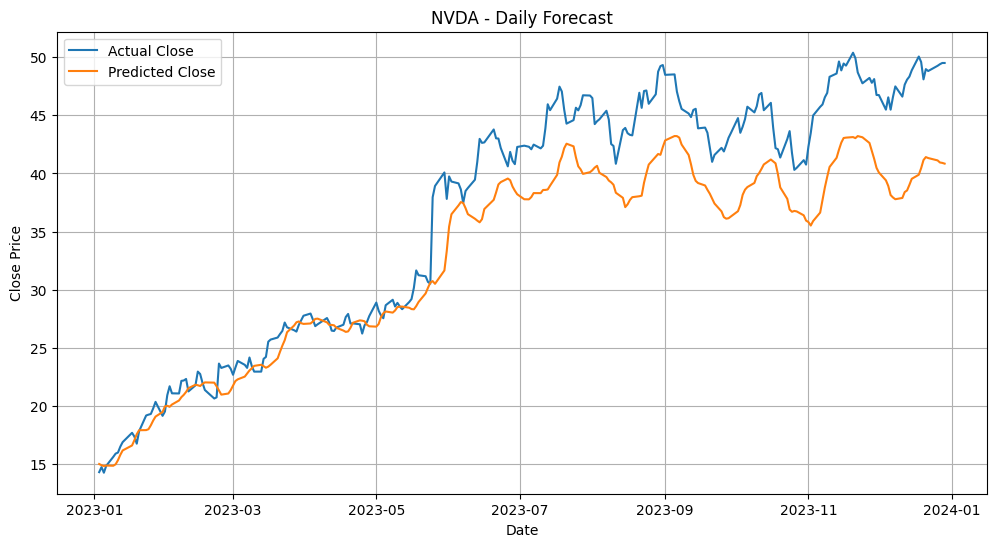

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step

📊 Results for SPY
RMSE: 8.9730
MAE : 7.1953
R^2 : 0.8592
MAPE: 0.0169


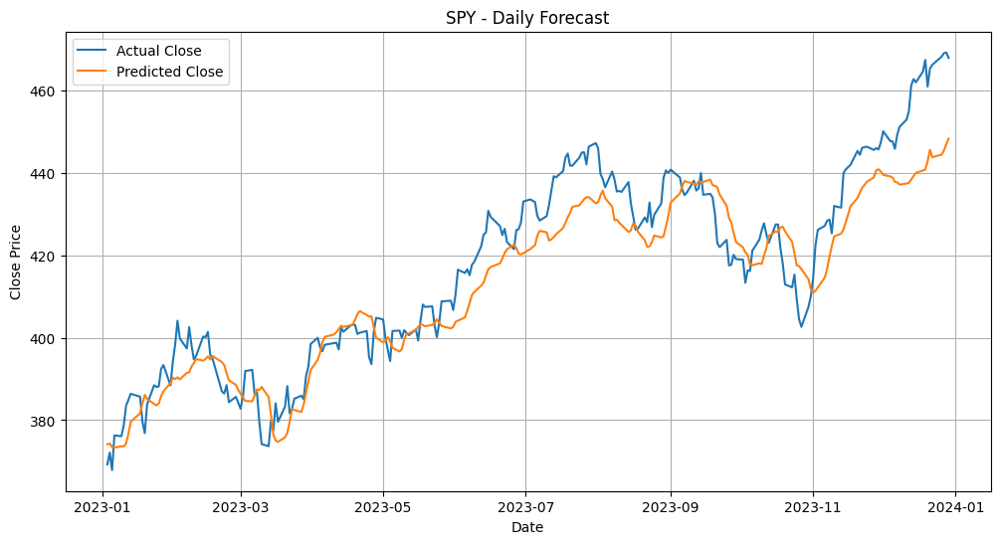

📉 Mean Scaled RMSE over 4 stocks: 0.0990759807842291


In [20]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        Dropout(0.1),
        LSTM(64, return_sequences=False),
        Dropout(0.1),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )

    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=64, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step

📊 Results for AAPL
RMSE: 1.6442
MAE : 1.2995
R^2 : 0.9626
MAPE: 0.0268


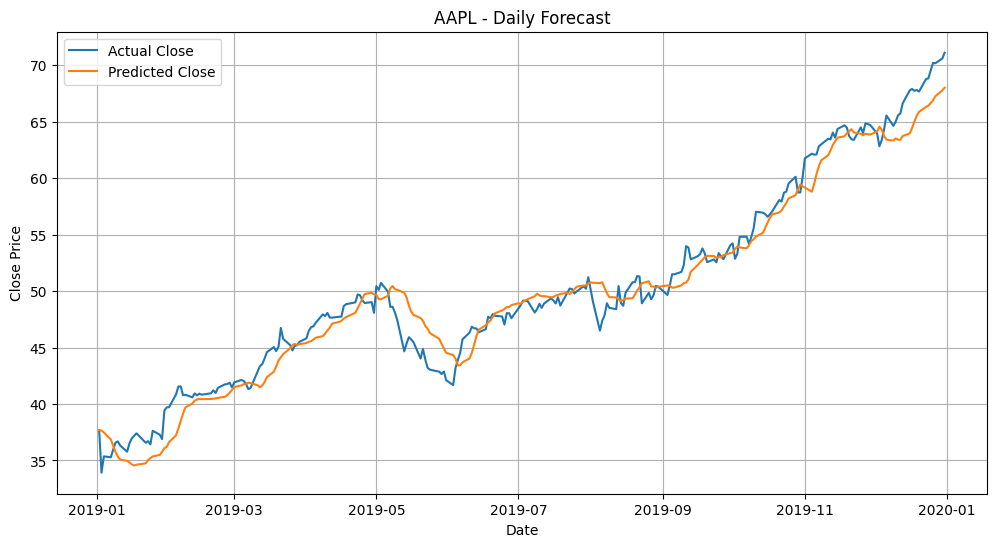

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step

📊 Results for JPM
RMSE: 2.3011
MAE : 1.8738
R^2 : 0.9424
MAPE: 0.0193


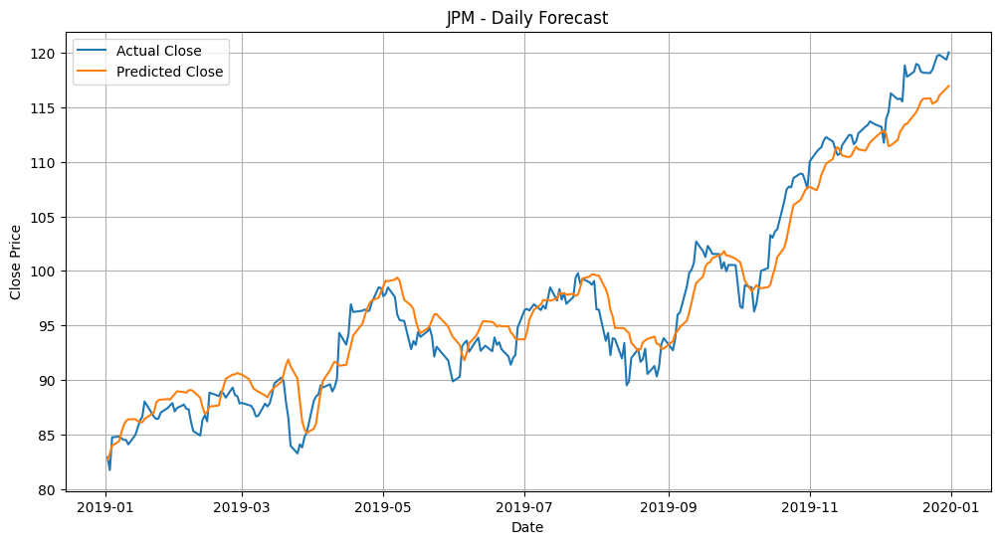

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 61ms/step

📊 Results for NVDA
RMSE: 0.3019
MAE : 0.2510
R^2 : 0.7656
MAPE: 0.0597


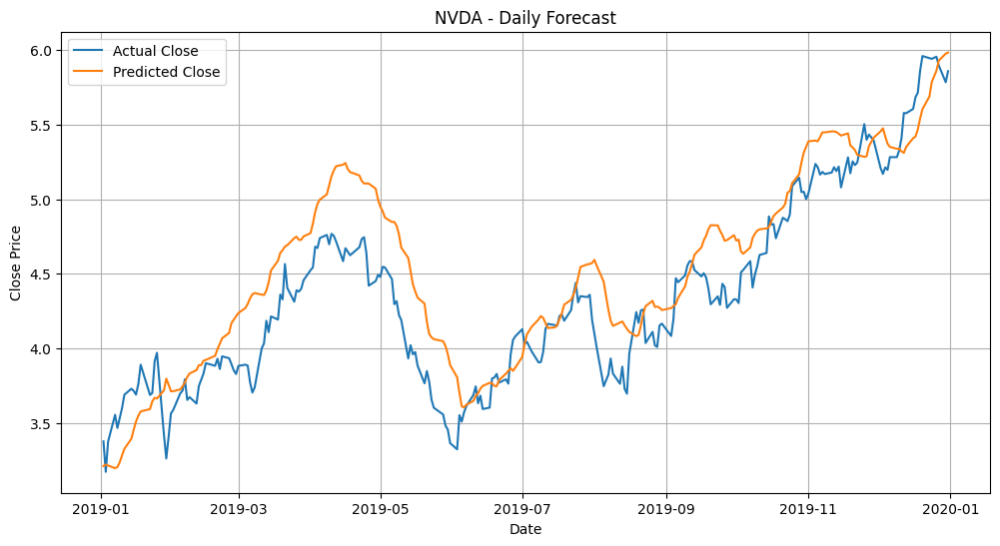

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 67ms/step

📊 Results for SPY
RMSE: 6.4688
MAE : 5.6837
R^2 : 0.8147
MAPE: 0.0212


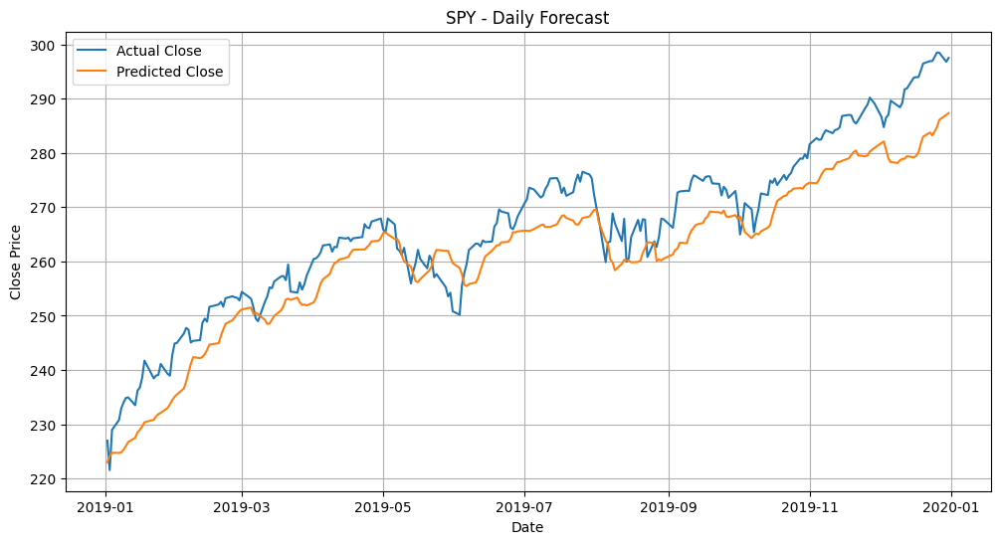

📉 Mean Scaled RMSE over 4 stocks: 0.07419832340015703


In [21]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        Dropout(0.1),
        LSTM(64, return_sequences=False),
        Dropout(0.1),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )

    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=64, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step

📊 Results for AAPL
RMSE: 2.0347
MAE : 1.7598
R^2 : 0.6731
MAPE: 0.0480


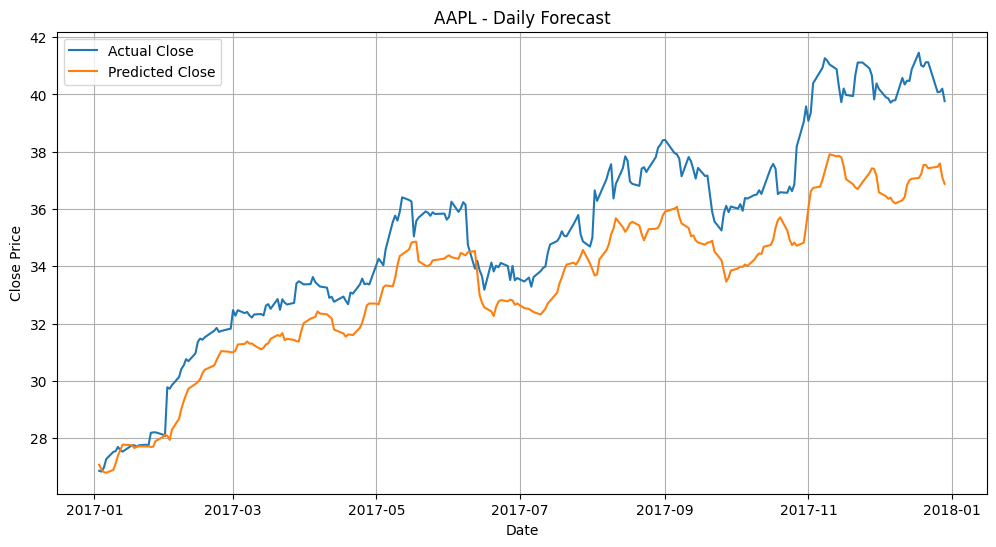

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step

📊 Results for JPM
RMSE: 1.8959
MAE : 1.4715
R^2 : 0.8824
MAPE: 0.0193


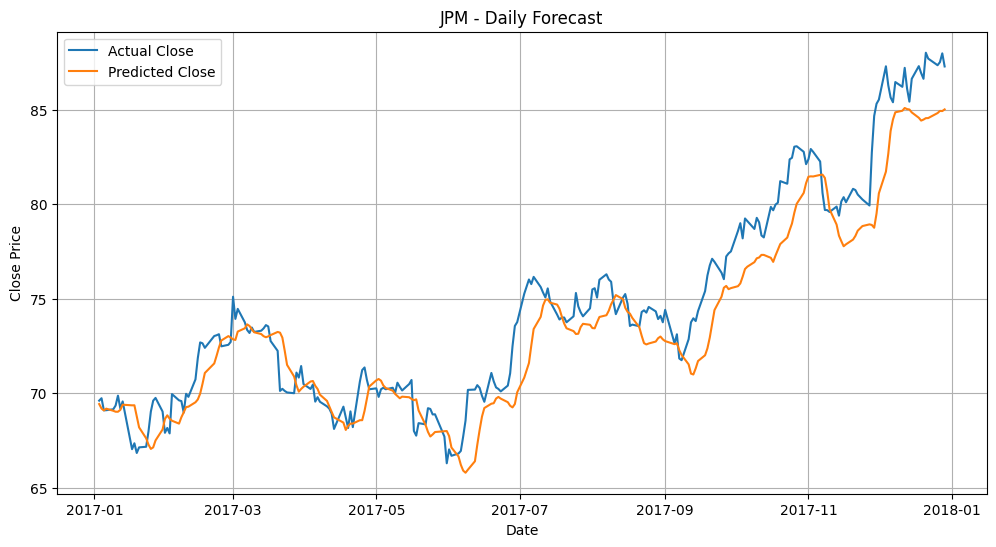

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step

📊 Results for NVDA
RMSE: 0.3705
MAE : 0.2789
R^2 : 0.8451
MAPE: 0.0742


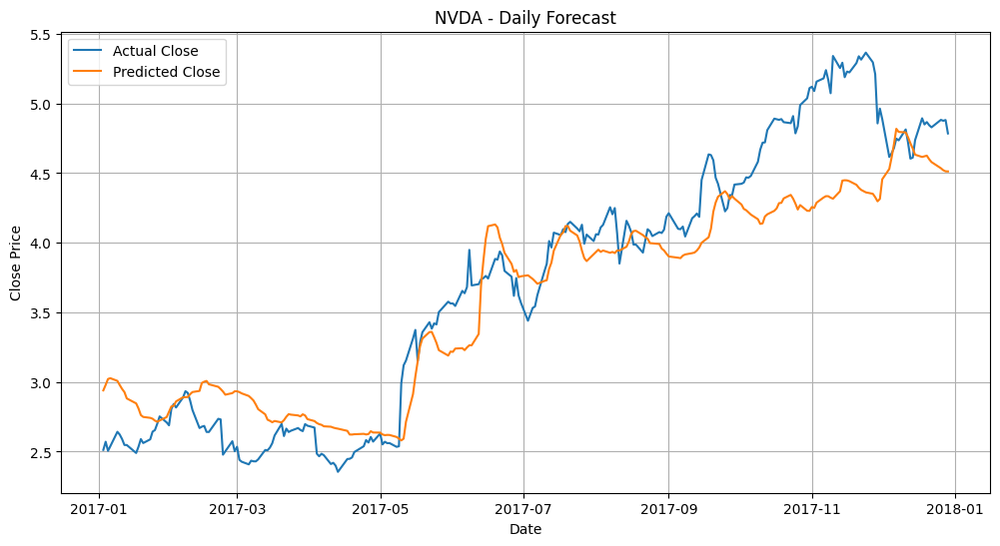

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 91ms/step

📊 Results for SPY
RMSE: 9.9631
MAE : 9.4927
R^2 : 0.1419
MAPE: 0.0436


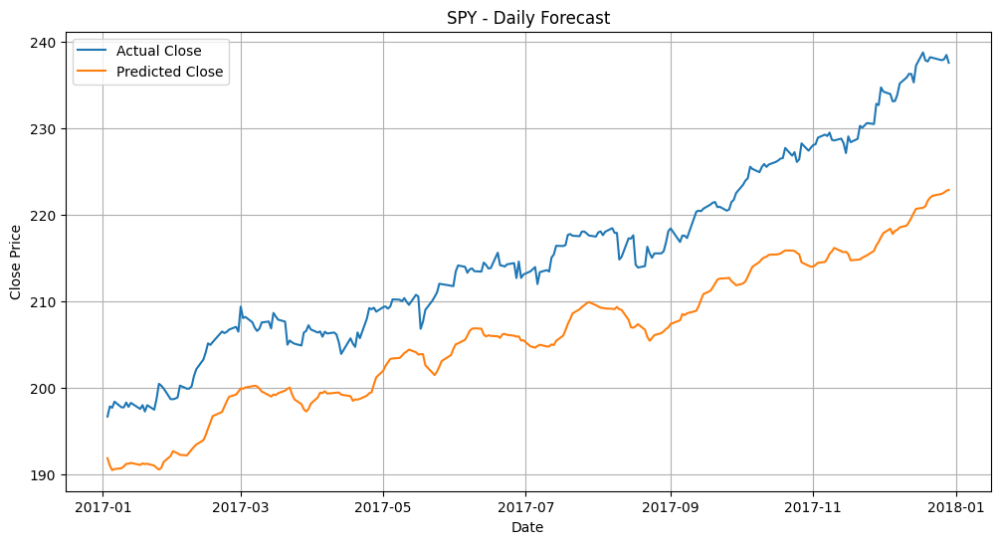

📉 Mean Scaled RMSE over 4 stocks: 0.14659128426522505


In [22]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        Dropout(0.1),
        LSTM(64, return_sequences=False),
        Dropout(0.1),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=64, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 152ms/step

📊 Results for AAPL
RMSE: 5.4992
MAE : 4.3486
R^2 : 0.8997
MAPE: 0.0262


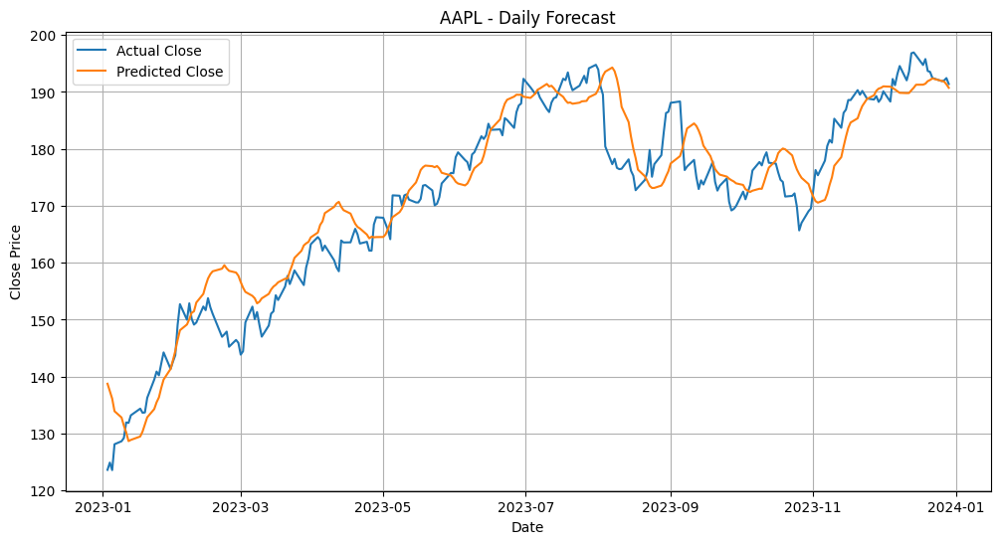

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 112ms/step

📊 Results for JPM
RMSE: 3.9072
MAE : 3.1156
R^2 : 0.8378
MAPE: 0.0227


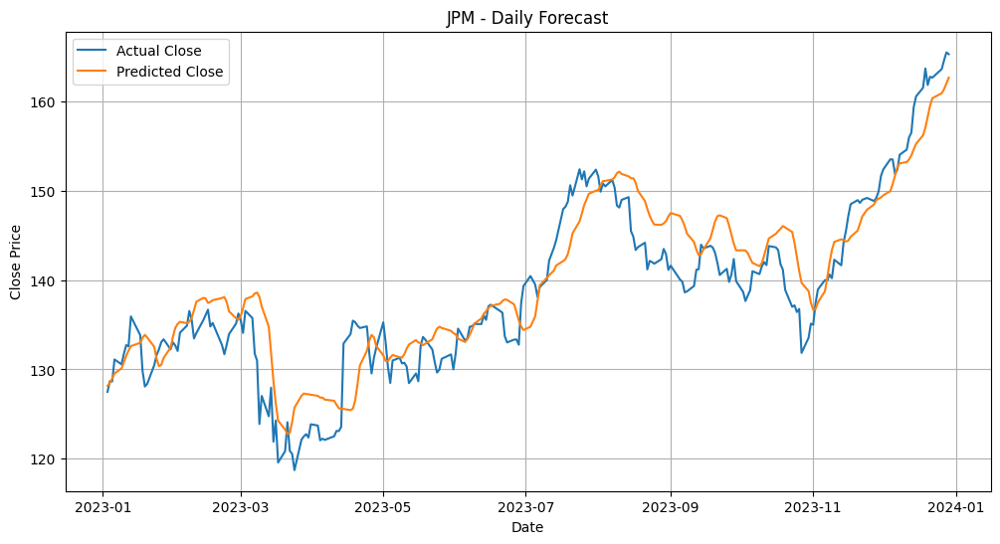

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step

📊 Results for NVDA
RMSE: 6.2696
MAE : 4.9069
R^2 : 0.6587
MAPE: 0.1161


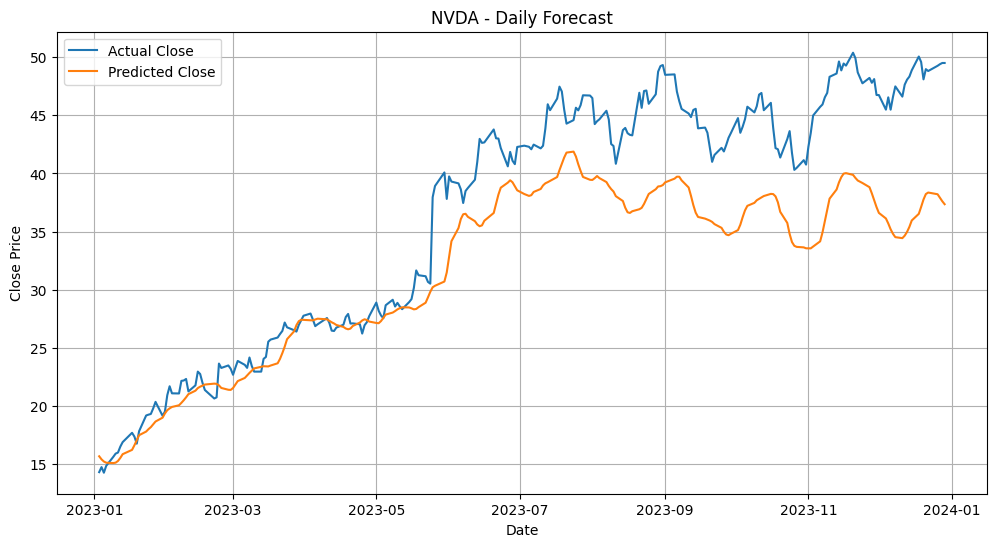

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 114ms/step

📊 Results for SPY
RMSE: 16.9101
MAE : 14.3625
R^2 : 0.4999
MAPE: 0.0337


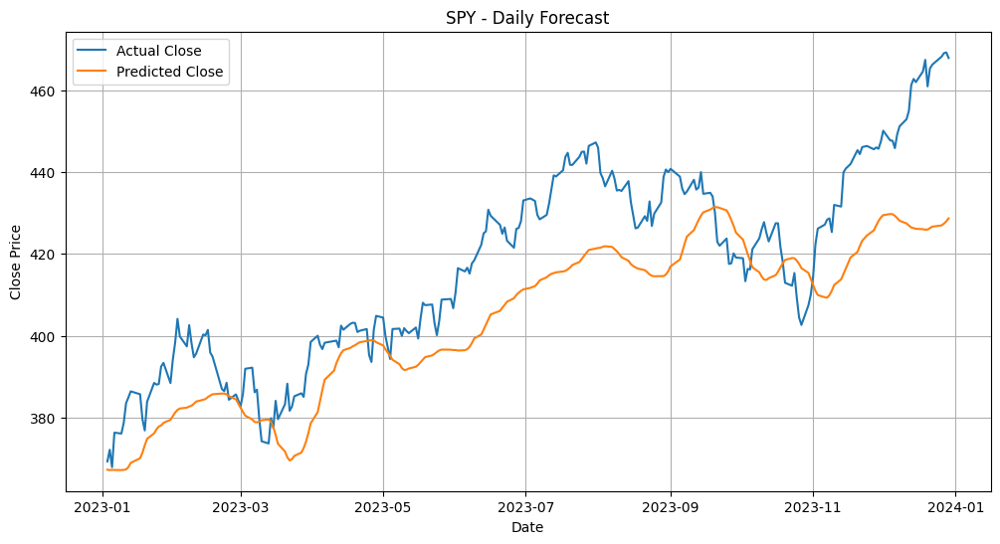

📉 Mean Scaled RMSE over 4 stocks: 0.12471960686190332


In [24]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        Dropout(0.2),

        LSTM(96, return_sequences=True),
        Dropout(0.2),

        LSTM(96, return_sequences=True),
        Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        Dropout(0.2),

        Dense(1)
    ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )

    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=64, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 102ms/step

📊 Results for AAPL
RMSE: 3.9534
MAE : 2.7911
R^2 : 0.7838
MAPE: 0.0519


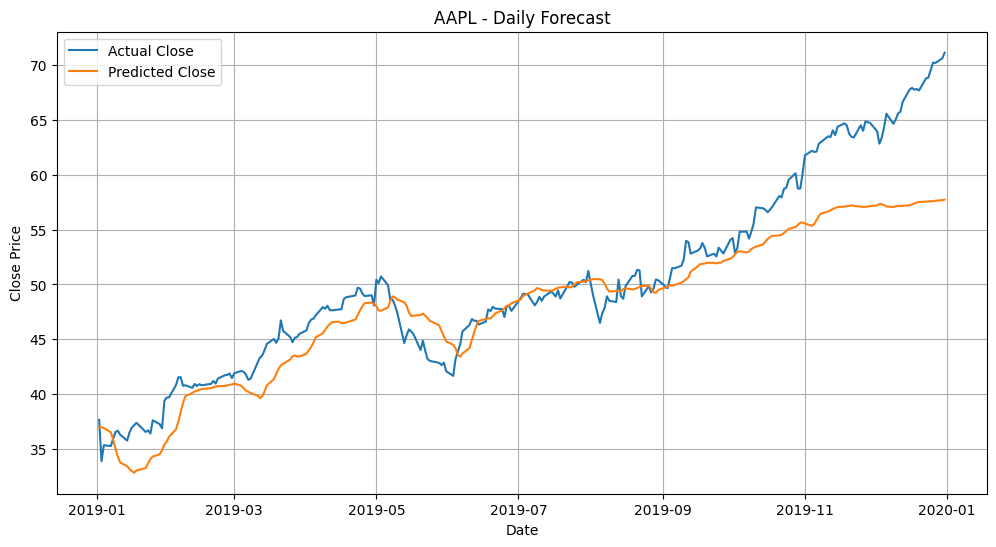

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step

📊 Results for JPM
RMSE: 7.5309
MAE : 5.2180
R^2 : 0.3827
MAPE: 0.0495


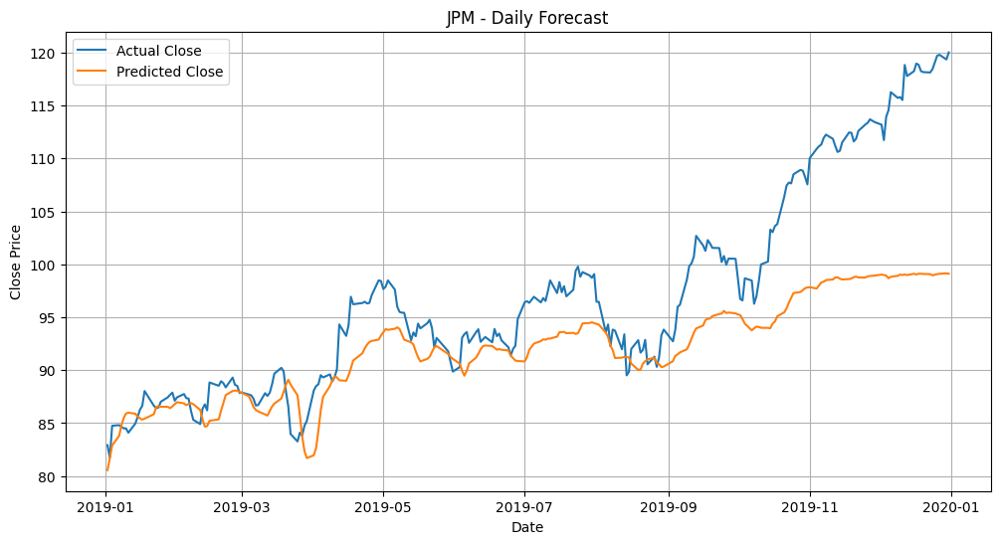

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 173ms/step

📊 Results for NVDA
RMSE: 0.9665
MAE : 0.8510
R^2 : -1.4018
MAPE: 0.1994


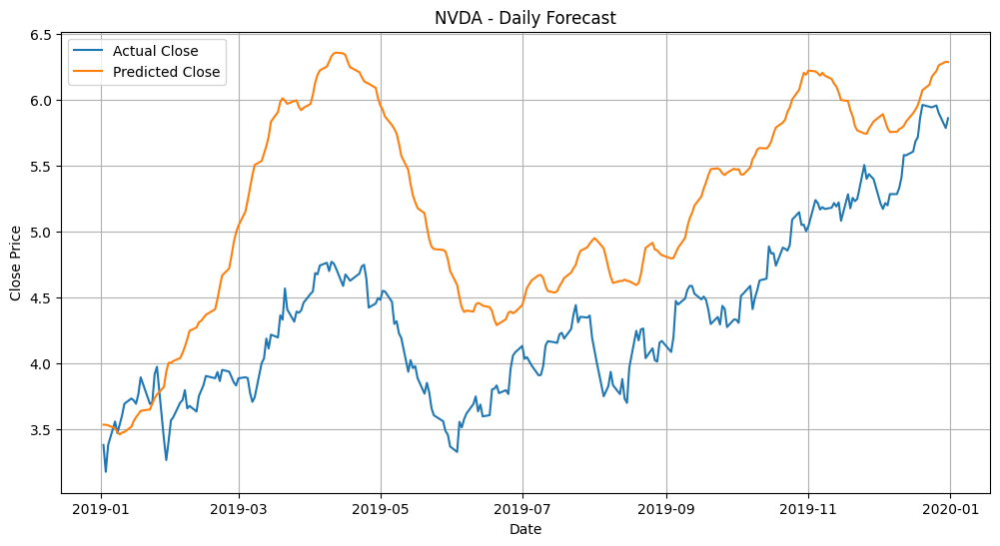

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 122ms/step

📊 Results for SPY
RMSE: 13.6270
MAE : 11.4477
R^2 : 0.1775
MAPE: 0.0421


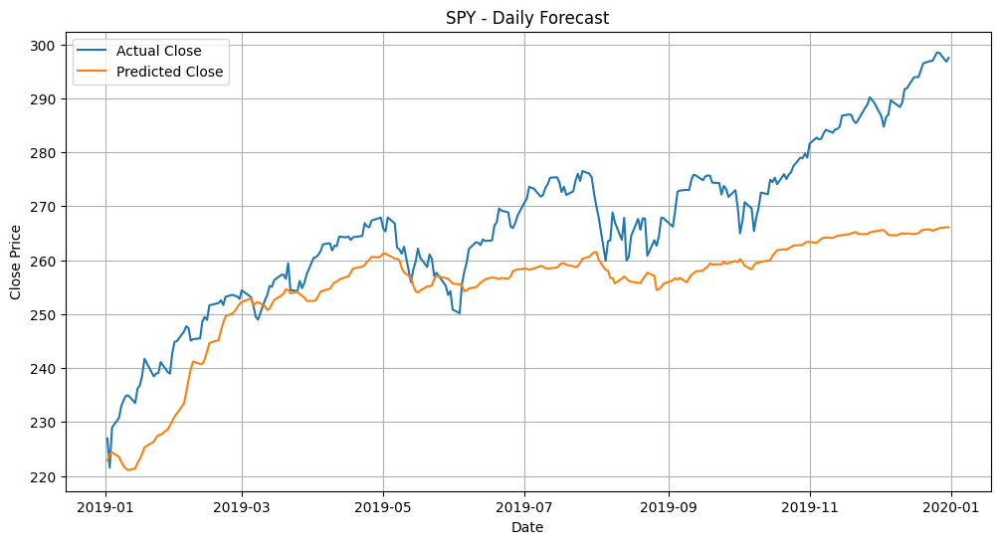

📉 Mean Scaled RMSE over 4 stocks: 0.2067829237419791


In [26]:
def forecast_stock(df, stock_name, window=20):
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        Dropout(0.2),

        LSTM(96, return_sequences=True),
        Dropout(0.2),

        LSTM(96, return_sequences=True),
        Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        Dropout(0.2),

        Dense(1)
    ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )

    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=16, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 109ms/step

📊 Results for AAPL
RMSE: 1.8725
MAE : 1.6356
R^2 : 0.7231
MAPE: 0.0452


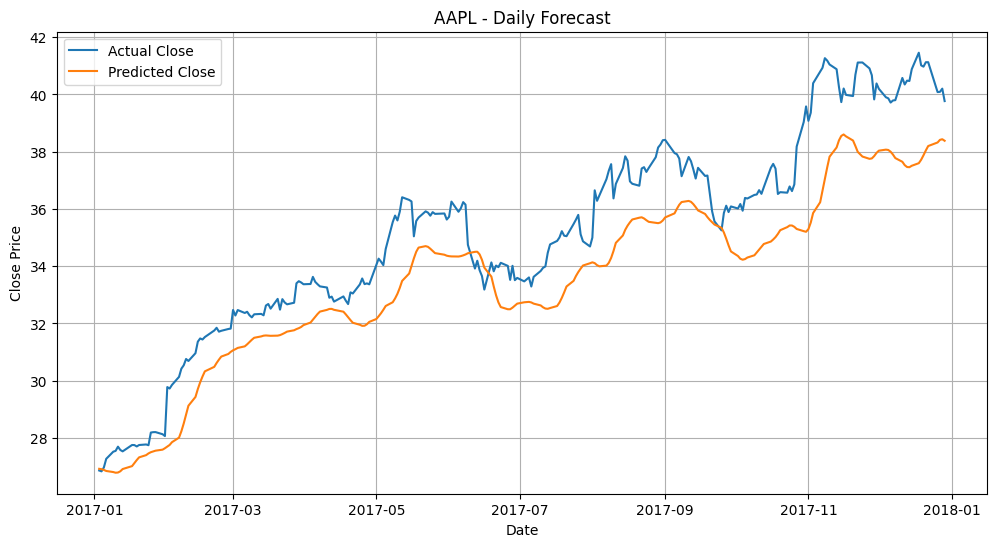

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 113ms/step

📊 Results for JPM
RMSE: 1.9840
MAE : 1.6258
R^2 : 0.8712
MAPE: 0.0220


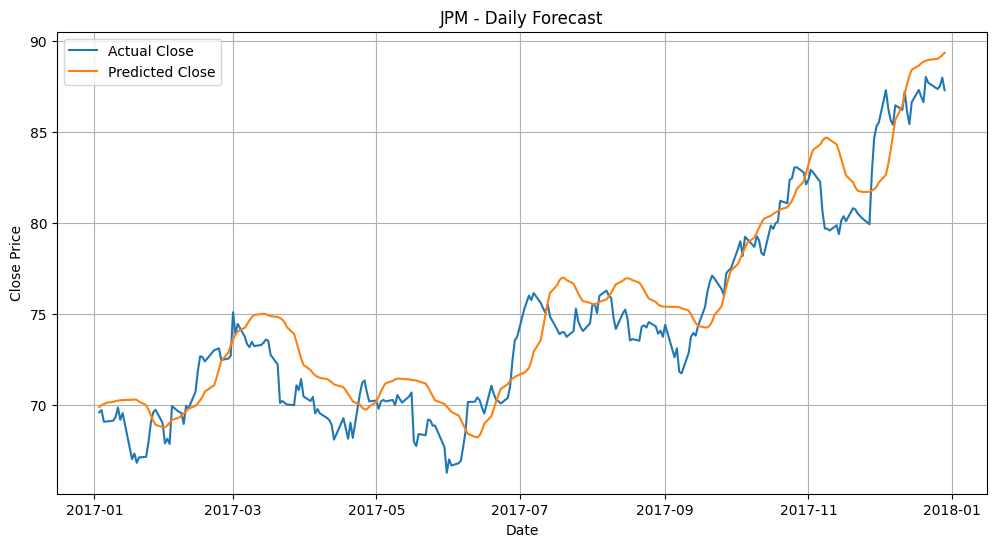

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step

📊 Results for NVDA
RMSE: 0.2459
MAE : 0.2018
R^2 : 0.9318
MAPE: 0.0588


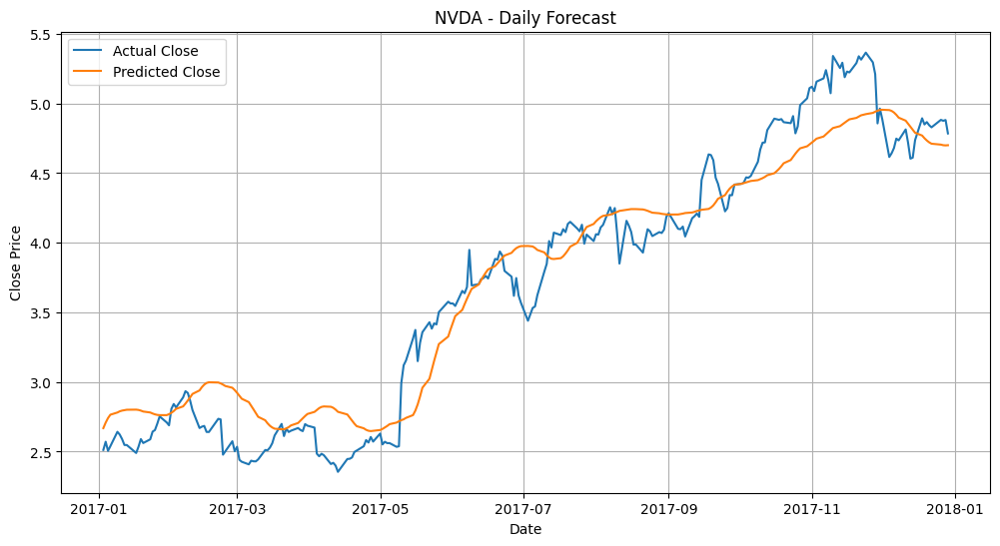

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step

📊 Results for SPY
RMSE: 3.8109
MAE : 3.0392
R^2 : 0.8745
MAPE: 0.0137


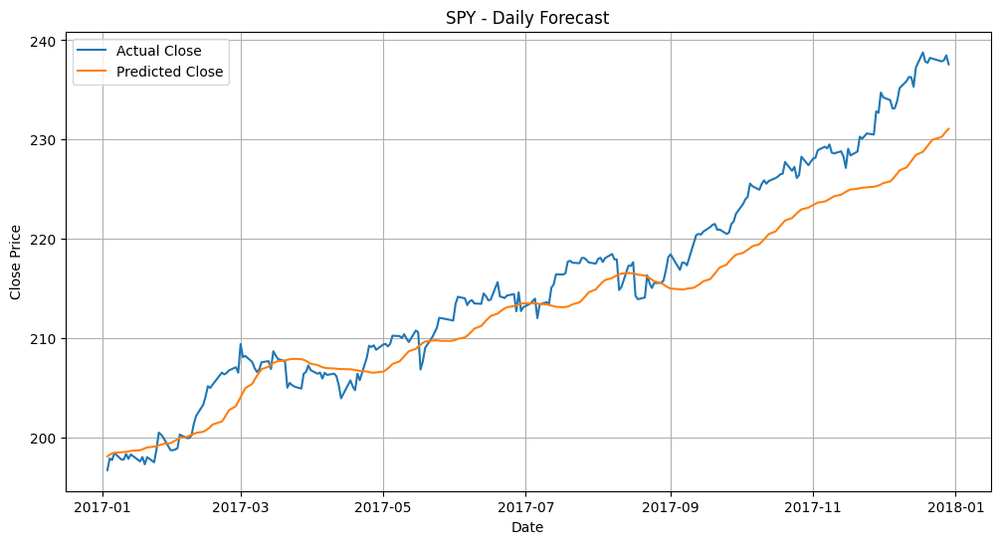

📉 Mean Scaled RMSE over 4 stocks: 0.09791631421737526


In [27]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        Dropout(0.2),

        LSTM(96, return_sequences=True),
        Dropout(0.2),

        LSTM(96, return_sequences=True),
        Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        Dropout(0.2),

        Dense(1)
    ])

    early_stop = EarlyStopping(
        monitor='val_loss',
        patience=5,
        restore_best_weights=True
    )
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=40, batch_size=64, callbacks=[early_stop], verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Just RSI, MACD, ma_5

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for AAPL
RMSE: 3.8145
MAE : 3.0978
R^2 : 0.9517
MAPE: 0.0182


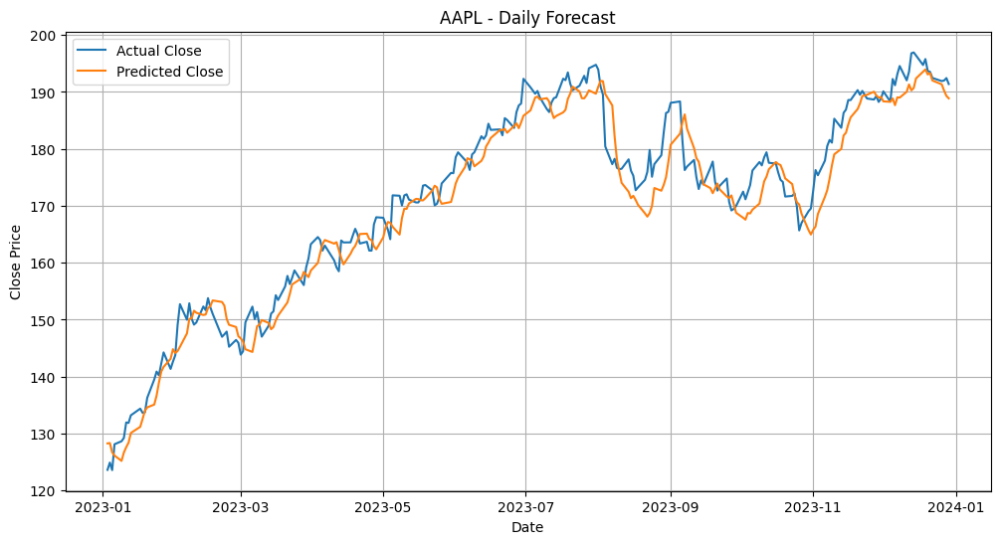

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for JPM
RMSE: 3.3878
MAE : 2.7836
R^2 : 0.8780
MAPE: 0.0201


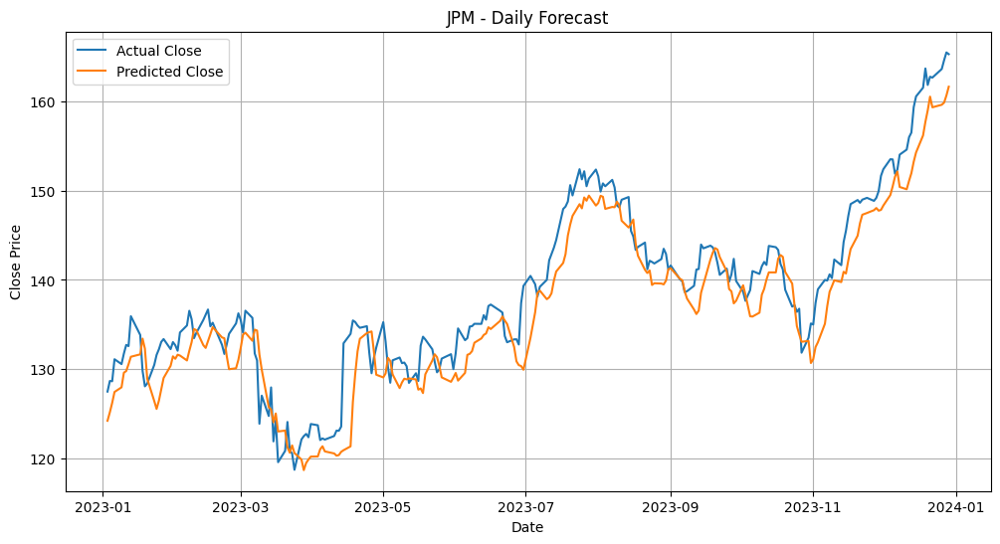

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 43ms/step

📊 Results for NVDA
RMSE: 3.9811
MAE : 3.1650
R^2 : 0.8624
MAPE: 0.0776


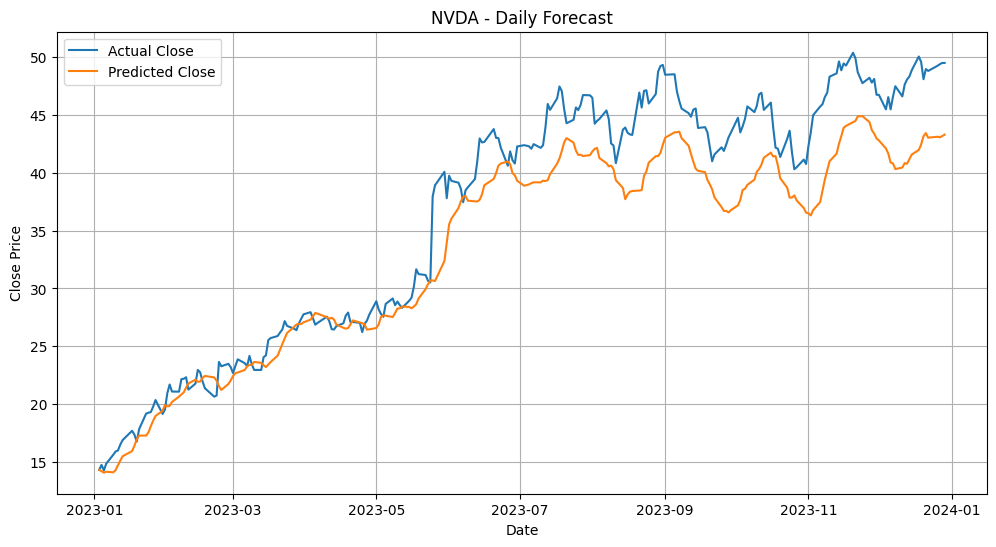

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step

📊 Results for SPY
RMSE: 8.8459
MAE : 7.6883
R^2 : 0.8631
MAPE: 0.0183


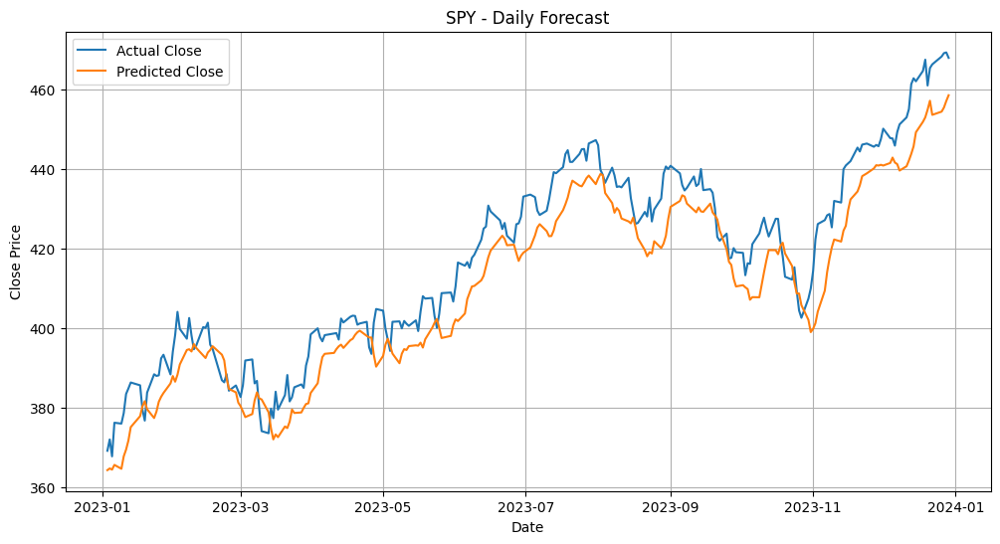

📉 Mean Scaled RMSE over 4 stocks: 0.08047877084808766


In [28]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for AAPL
RMSE: 1.4933
MAE : 1.1461
R^2 : 0.9692
MAPE: 0.0225


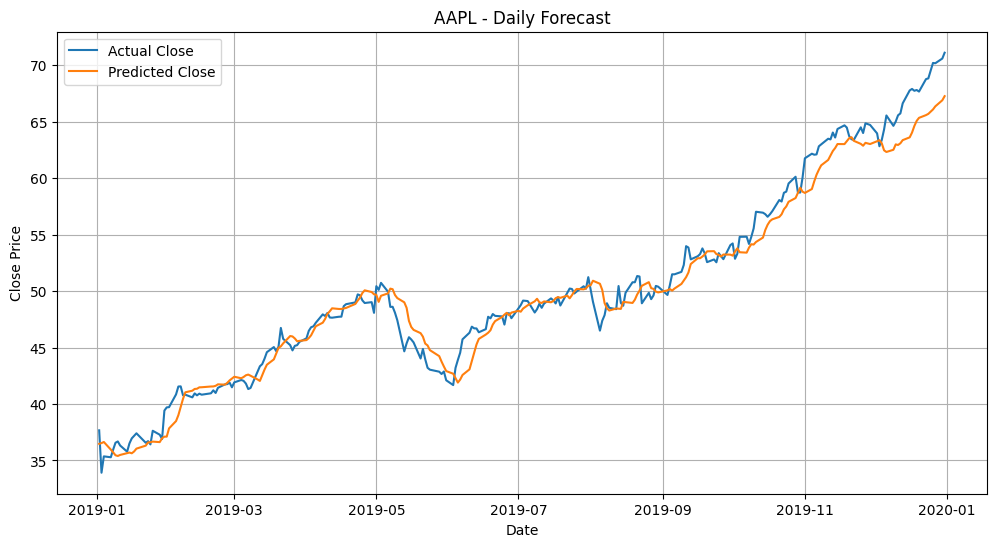

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for JPM
RMSE: 2.4245
MAE : 1.9199
R^2 : 0.9360
MAPE: 0.0193


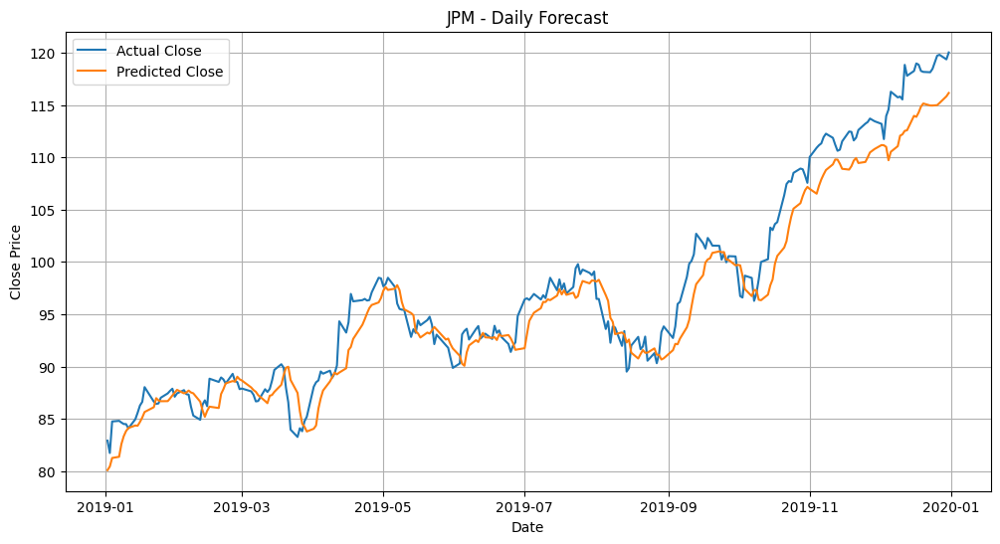

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step

📊 Results for NVDA
RMSE: 0.1904
MAE : 0.1575
R^2 : 0.9068
MAPE: 0.0368


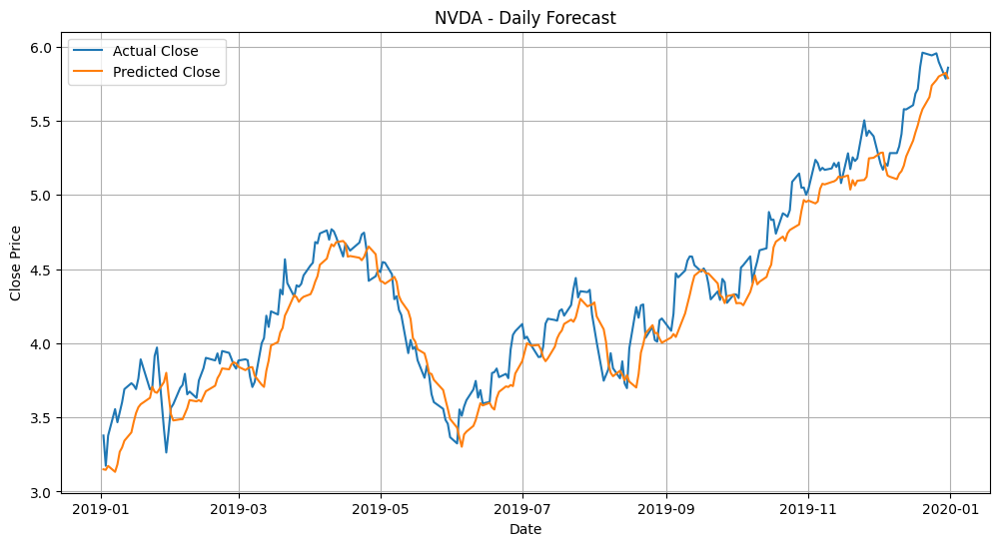

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for SPY
RMSE: 5.7069
MAE : 5.0743
R^2 : 0.8557
MAPE: 0.0190


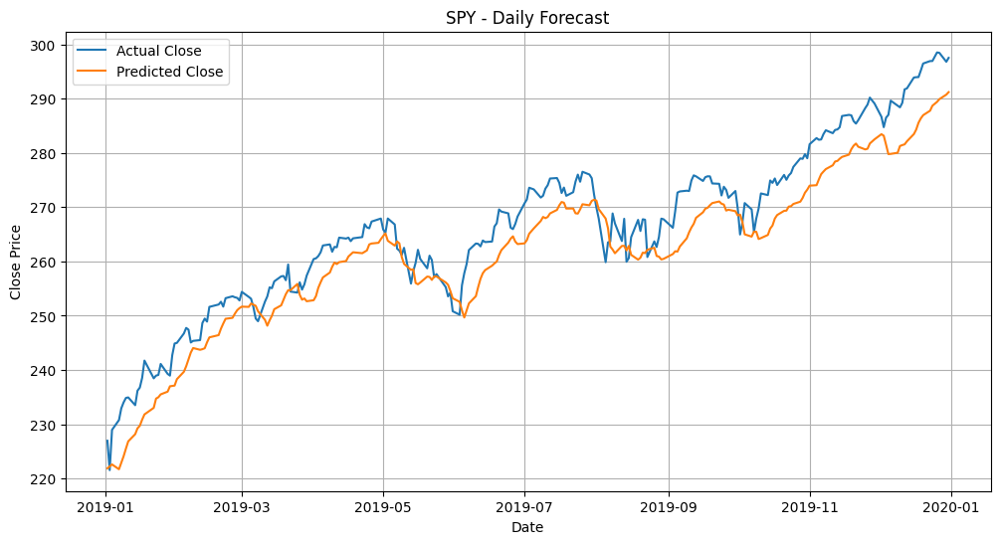

📉 Mean Scaled RMSE over 4 stocks: 0.06150361585768645


In [29]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step

📊 Results for AAPL
RMSE: 1.5853
MAE : 1.3103
R^2 : 0.8015
MAPE: 0.0356


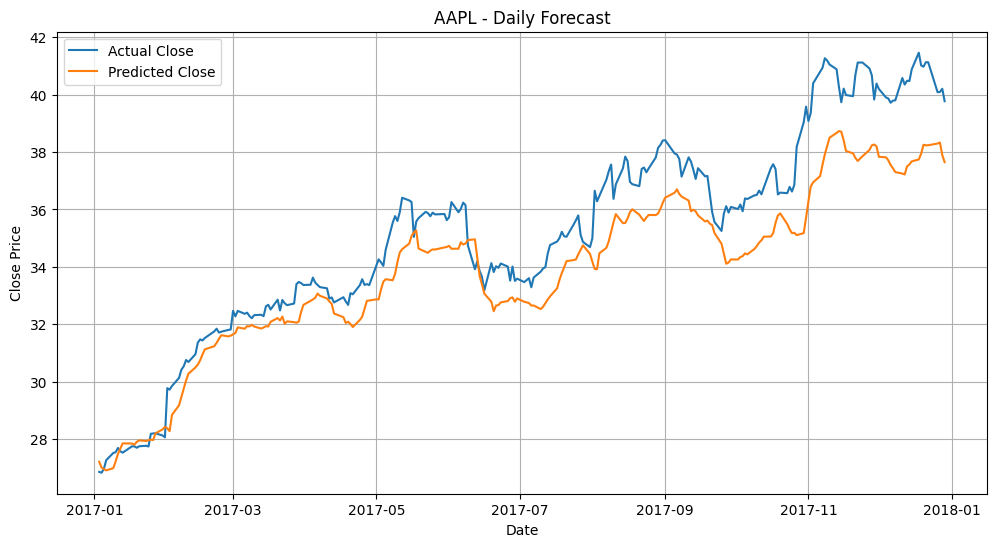

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for JPM
RMSE: 1.3932
MAE : 1.0654
R^2 : 0.9365
MAPE: 0.0141


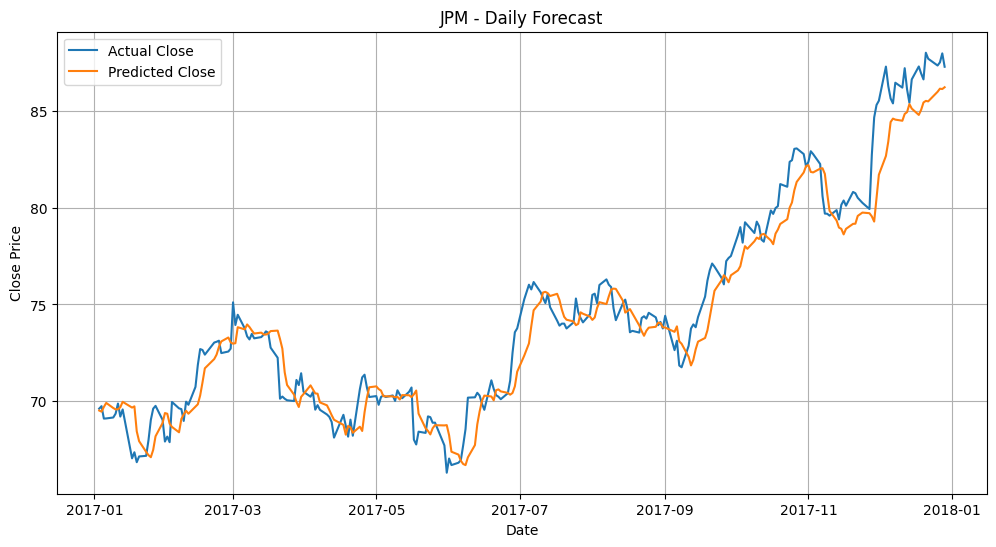

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step

📊 Results for NVDA
RMSE: 0.1982
MAE : 0.1715
R^2 : 0.9557
MAPE: 0.0518


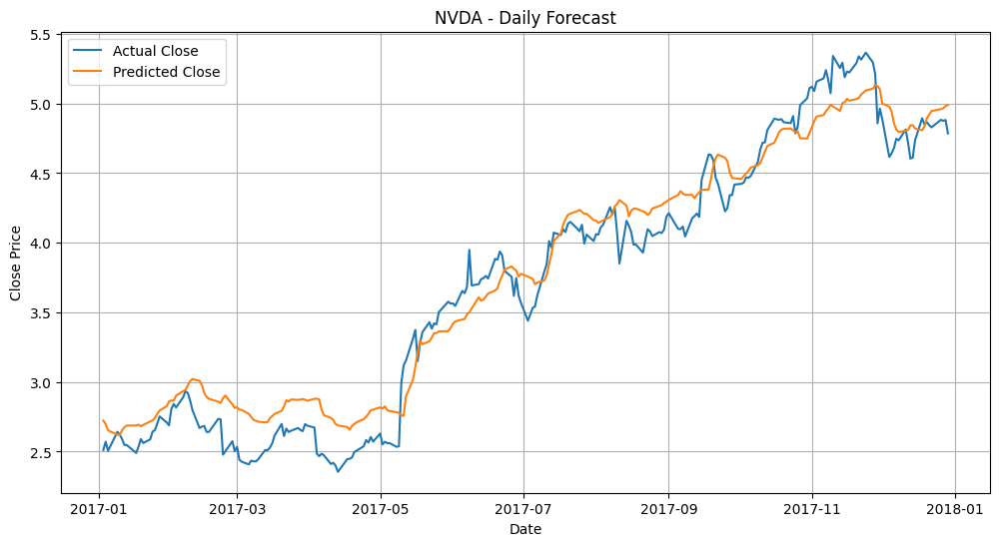

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step

📊 Results for SPY
RMSE: 5.8866
MAE : 5.3348
R^2 : 0.7004
MAPE: 0.0243


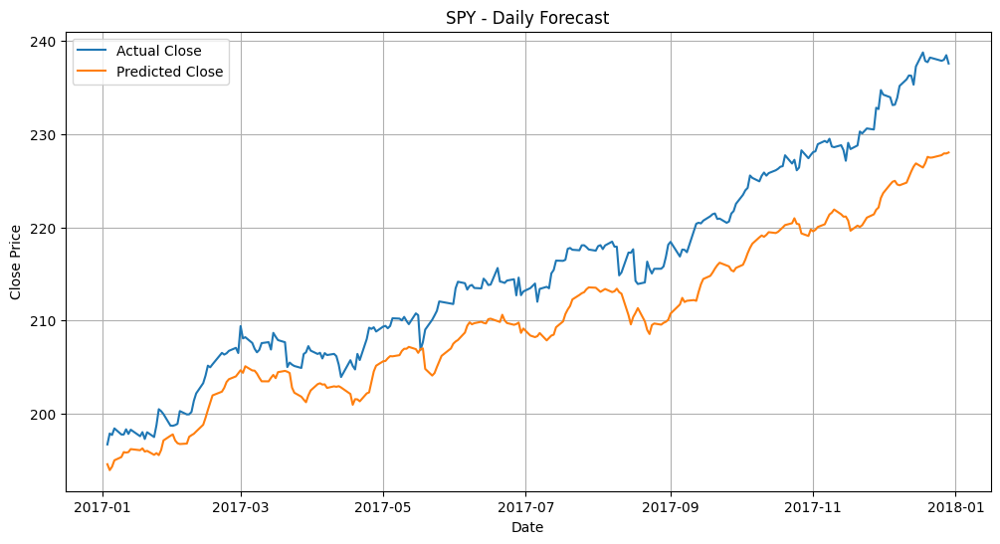

📉 Mean Scaled RMSE over 4 stocks: 0.09458785254322391


In [30]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(64, input_shape=(window, X_train_seq.shape[2])),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Learning Rate 0.003 Model 2

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 71ms/step

📊 Results for AAPL
RMSE: 6.6234
MAE : 5.7861
R^2 : 0.8545
MAPE: 0.0332


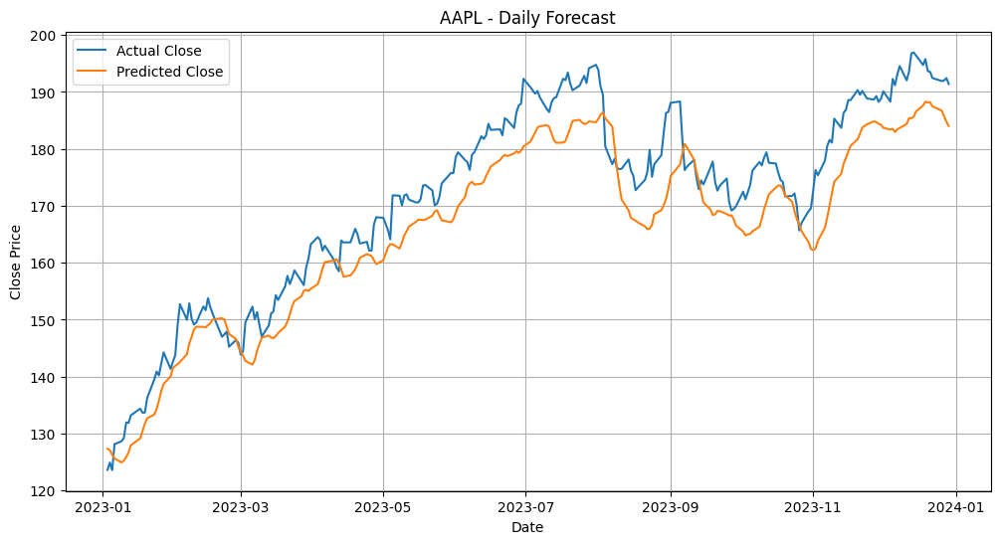

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 69ms/step

📊 Results for JPM
RMSE: 2.7392
MAE : 2.1010
R^2 : 0.9203
MAPE: 0.0154


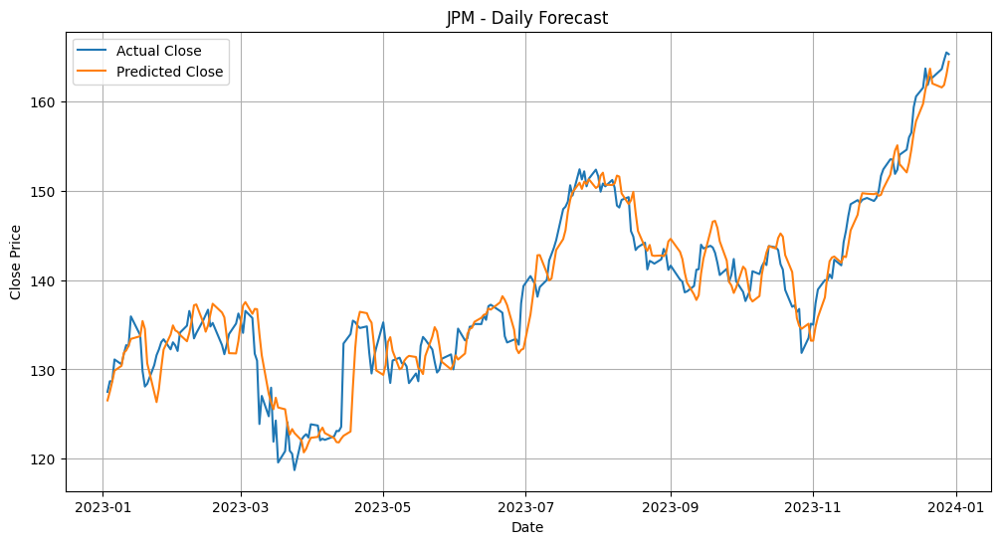

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 98ms/step

📊 Results for NVDA
RMSE: 5.3463
MAE : 4.6561
R^2 : 0.7519
MAPE: 0.1196


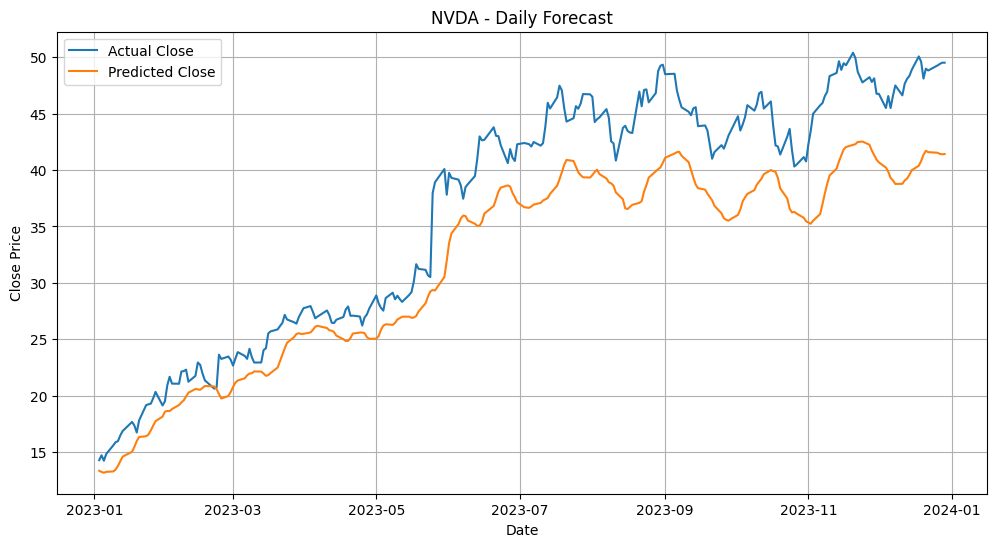

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 62ms/step

📊 Results for SPY
RMSE: 7.2185
MAE : 5.9701
R^2 : 0.9089
MAPE: 0.0142


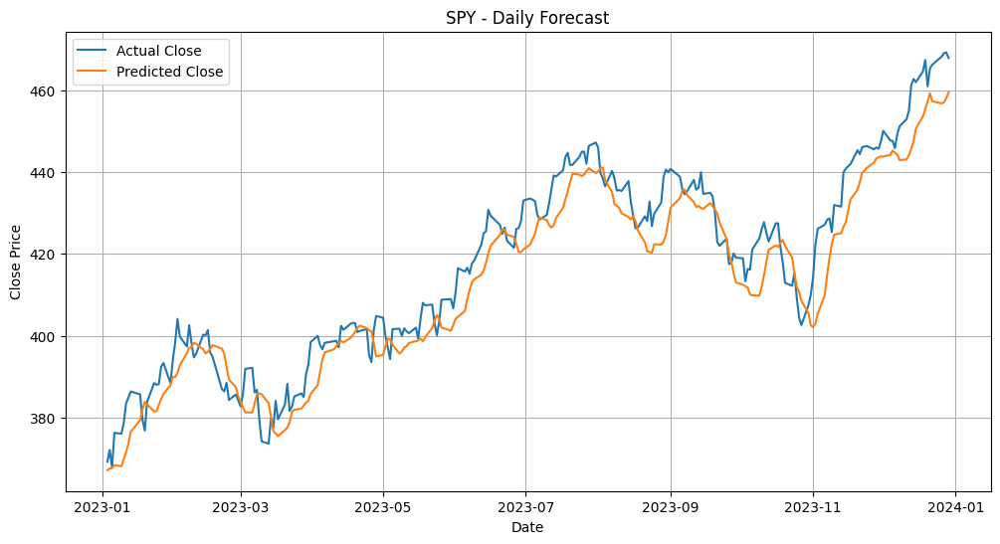

📉 Mean Scaled RMSE over 4 stocks: 0.092016760992815


In [31]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step

📊 Results for AAPL
RMSE: 1.9377
MAE : 1.4645
R^2 : 0.9481
MAPE: 0.0281


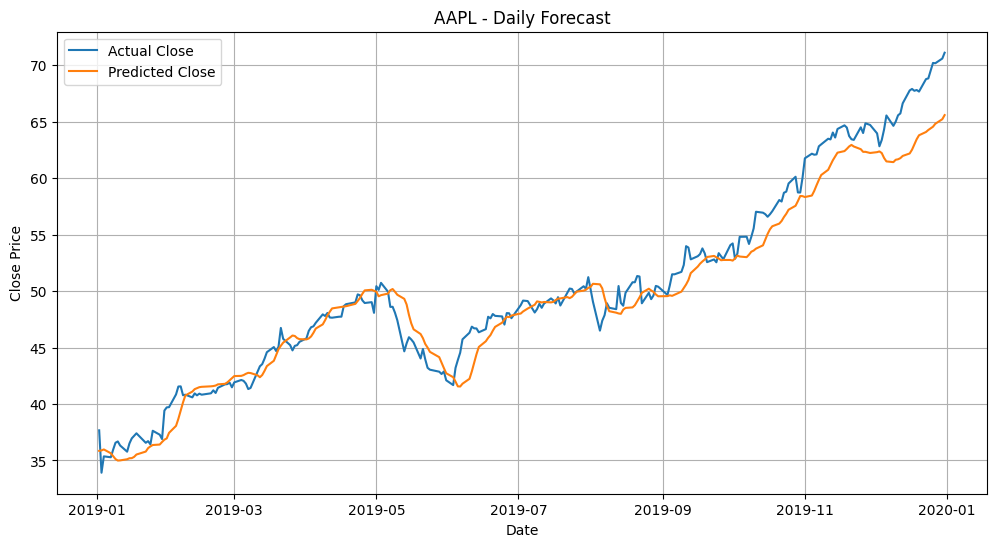

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step

📊 Results for JPM
RMSE: 2.2302
MAE : 1.8462
R^2 : 0.9459
MAPE: 0.0194


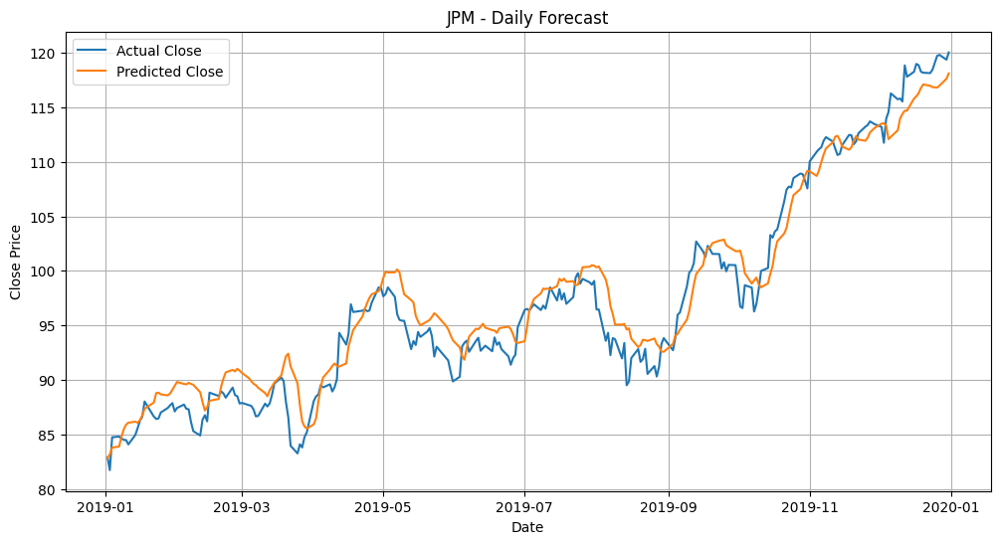

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step

📊 Results for NVDA
RMSE: 0.2008
MAE : 0.1592
R^2 : 0.8963
MAPE: 0.0385


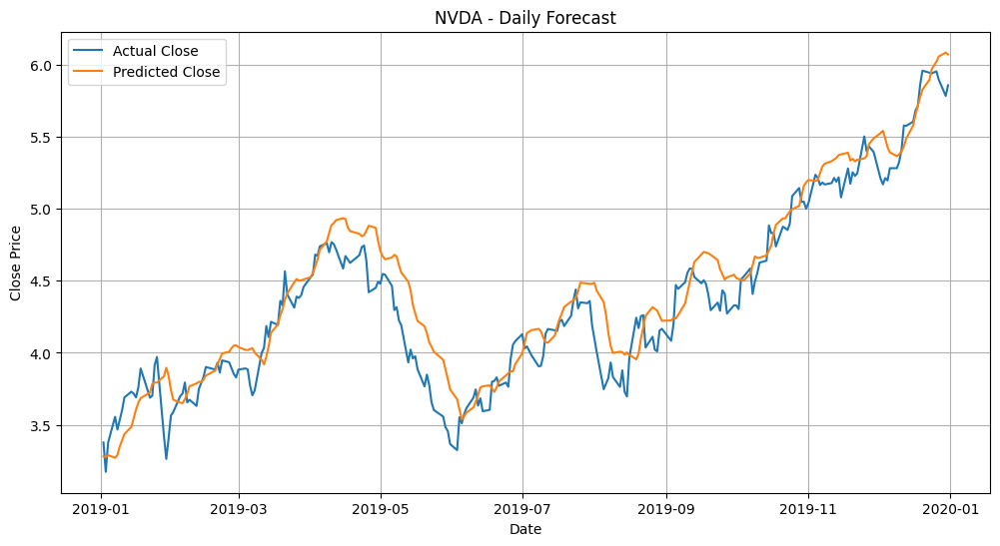

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step

📊 Results for SPY
RMSE: 4.8057
MAE : 4.1220
R^2 : 0.8977
MAPE: 0.0154


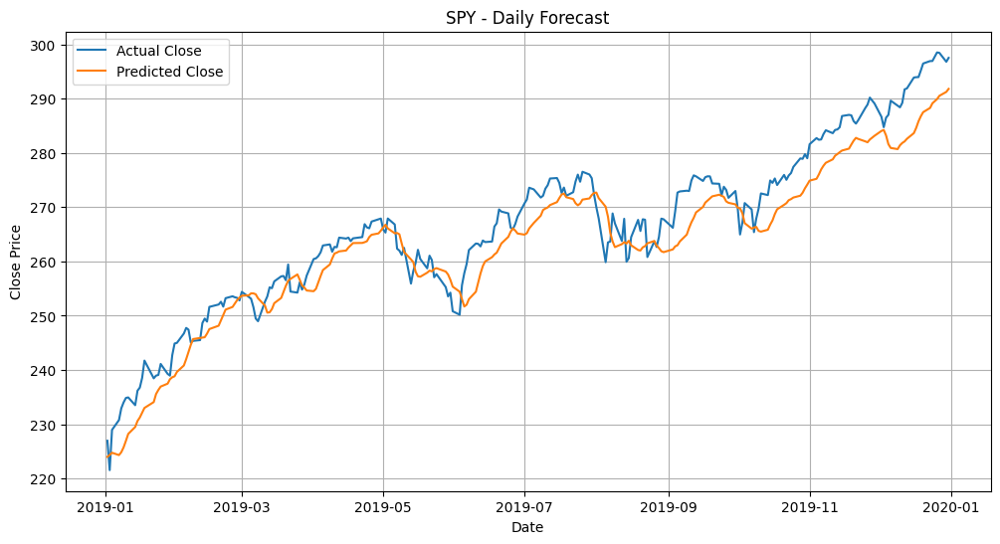

📉 Mean Scaled RMSE over 4 stocks: 0.06122730406900044


In [32]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 55ms/step

📊 Results for AAPL
RMSE: 1.9458
MAE : 1.5882
R^2 : 0.7010
MAPE: 0.0428


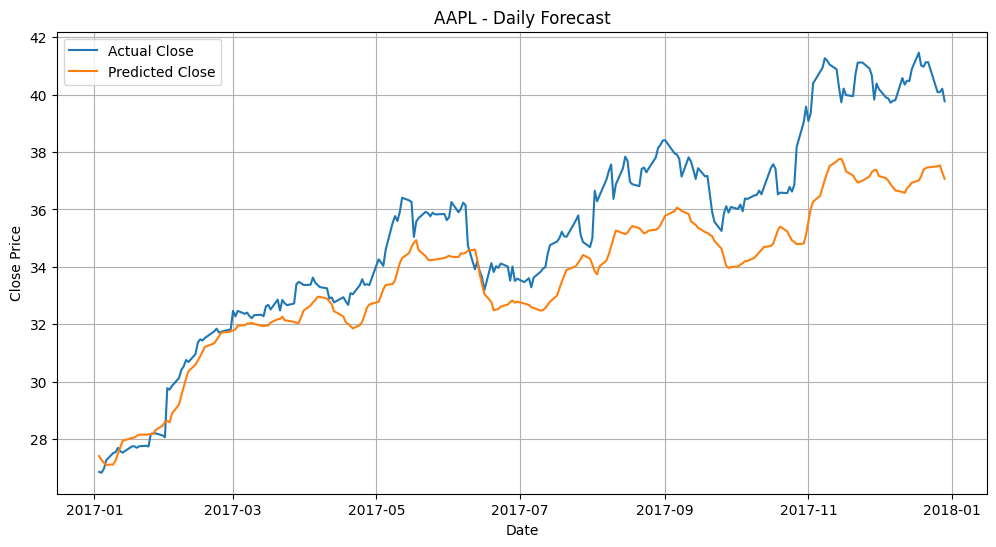

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 57ms/step

📊 Results for JPM
RMSE: 1.8262
MAE : 1.4231
R^2 : 0.8909
MAPE: 0.0188


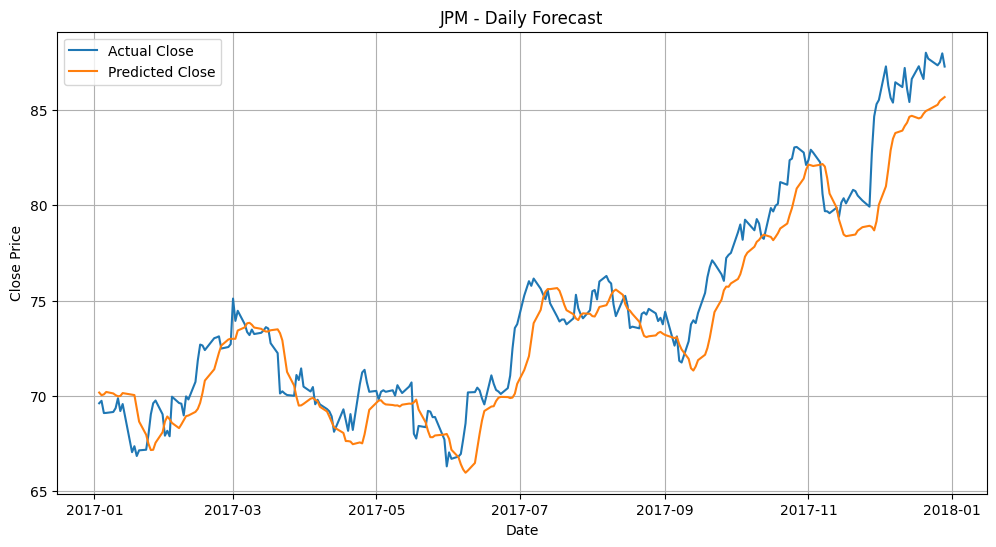

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 59ms/step

📊 Results for NVDA
RMSE: 0.4210
MAE : 0.3695
R^2 : 0.8000
MAPE: 0.1092


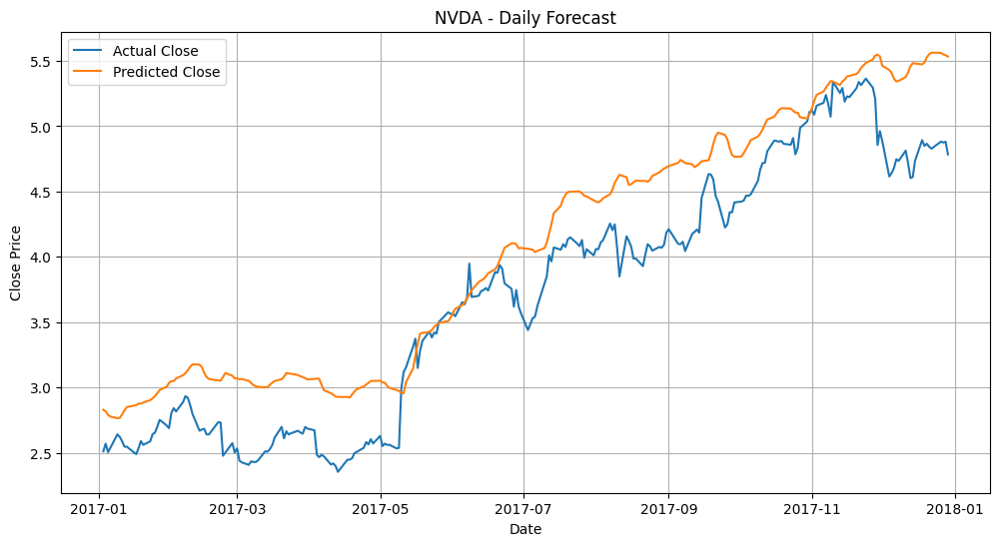

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step

📊 Results for SPY
RMSE: 3.5745
MAE : 2.8510
R^2 : 0.8895
MAPE: 0.0128


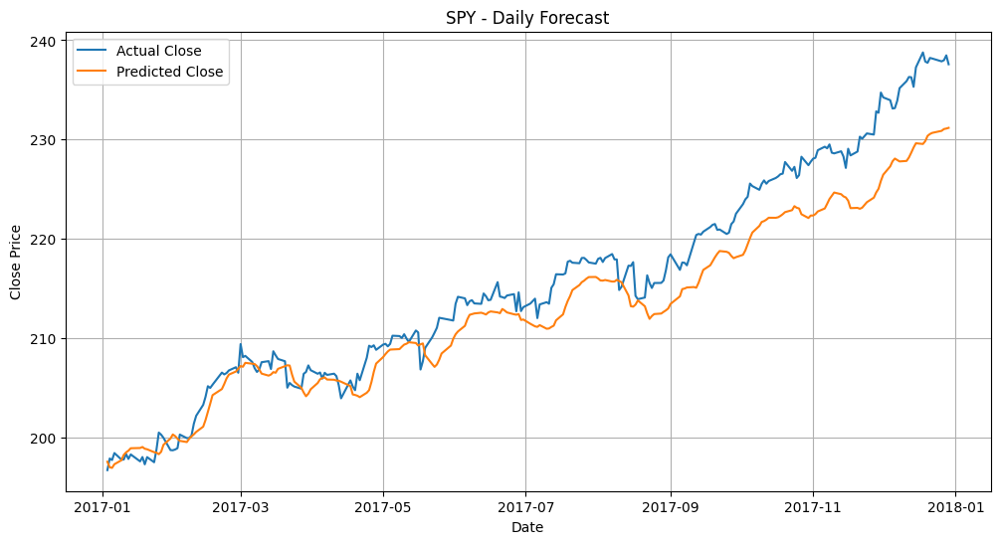

📉 Mean Scaled RMSE over 4 stocks: 0.11049953064245528


In [33]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        LSTM(64, return_sequences=False),
        Dense(16, activation='relu'),
        Dense(1, activation='linear')
        ])
    model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Model 3

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 107ms/step

📊 Results for AAPL
RMSE: 8.6451
MAE : 7.4919
R^2 : 0.7521
MAPE: 0.0432


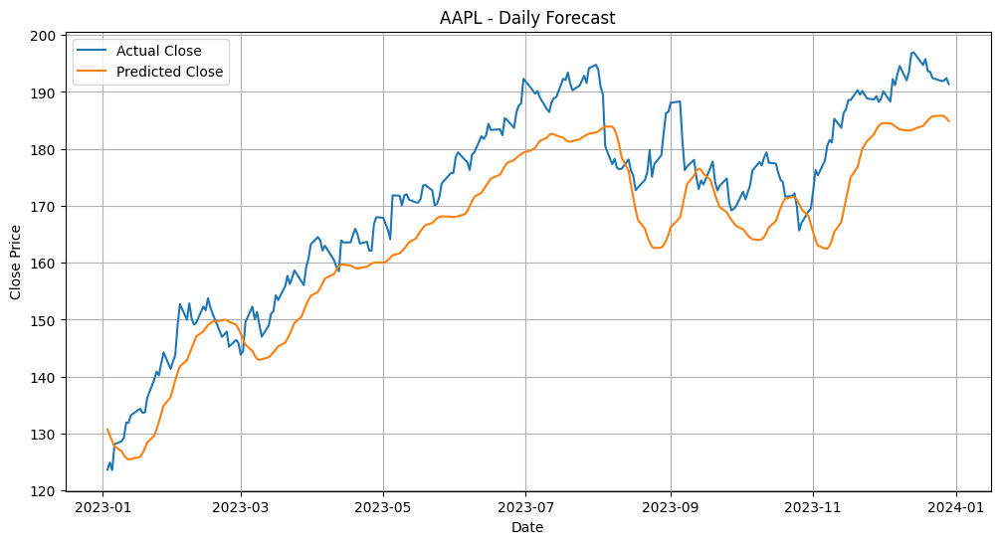

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 108ms/step

📊 Results for JPM
RMSE: 4.3480
MAE : 3.3711
R^2 : 0.7991
MAPE: 0.0248


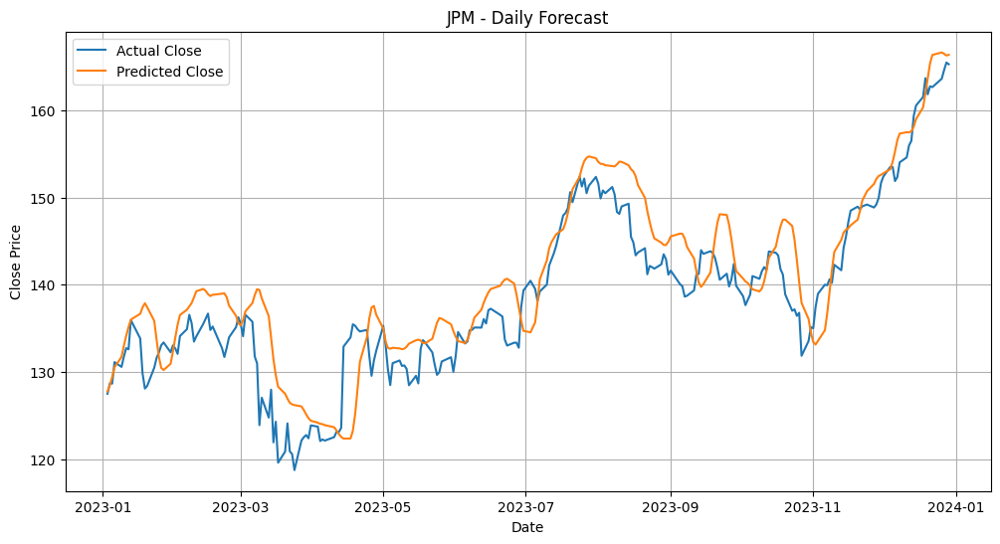

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 128ms/step

📊 Results for NVDA
RMSE: 5.2568
MAE : 4.3027
R^2 : 0.7601
MAPE: 0.1077


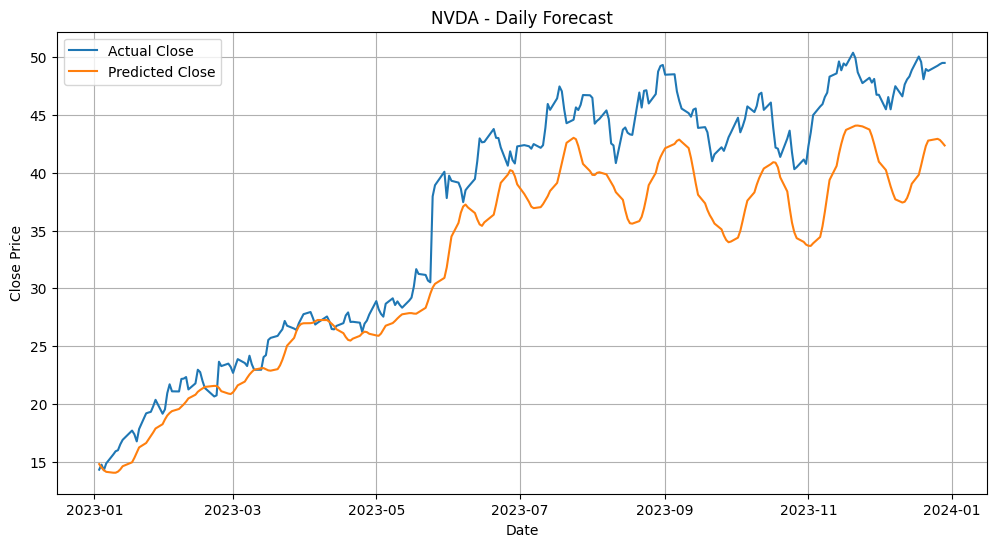

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 101ms/step

📊 Results for SPY
RMSE: 10.1632
MAE : 8.3790
R^2 : 0.8194
MAPE: 0.0199


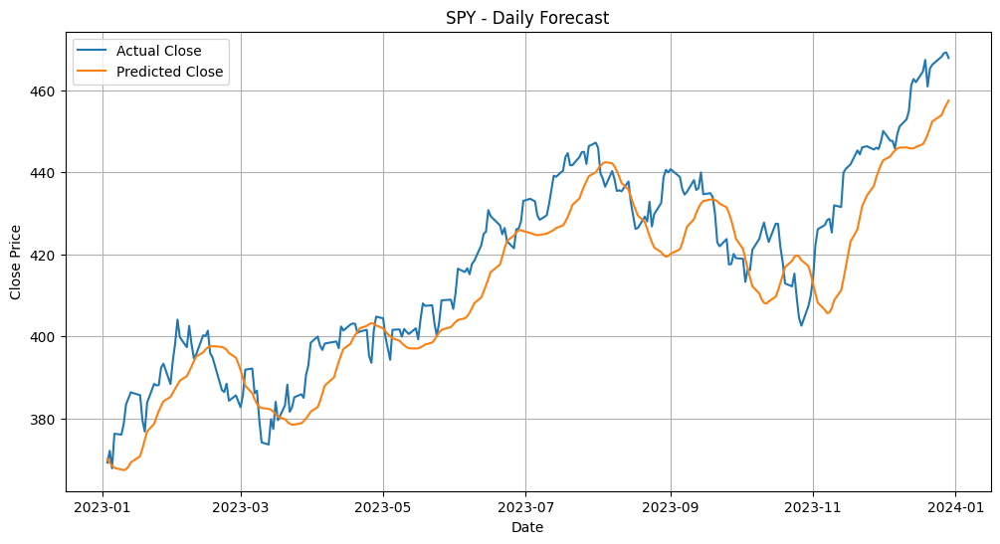

📉 Mean Scaled RMSE over 4 stocks: 0.11415428099753029


In [34]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2018-01-01':'2023-12-31']
    train_df = df.loc[:'2022-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2023-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 135ms/step

📊 Results for AAPL
RMSE: 2.1896
MAE : 1.6654
R^2 : 0.9337
MAPE: 0.0331


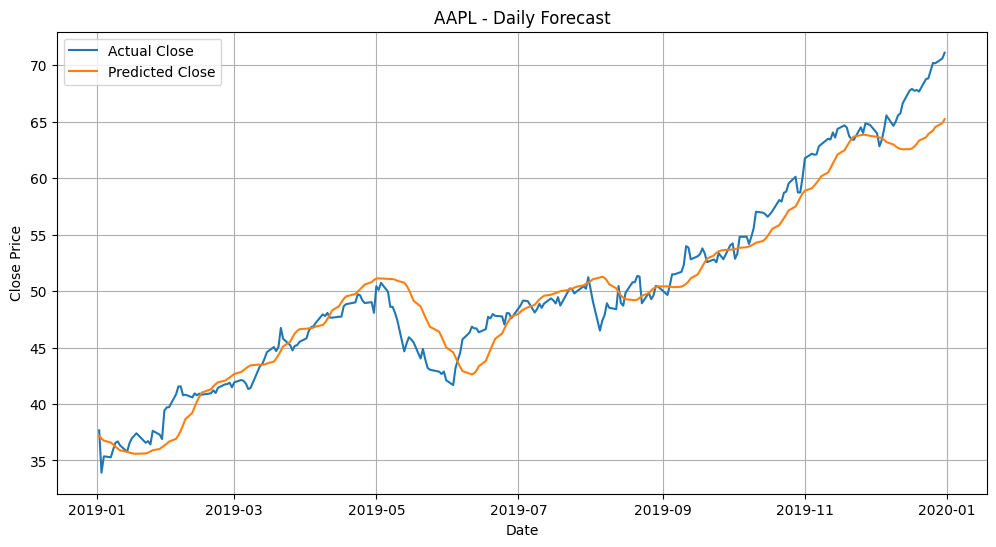

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 155ms/step

📊 Results for JPM
RMSE: 5.5211
MAE : 4.5391
R^2 : 0.6682
MAPE: 0.0449


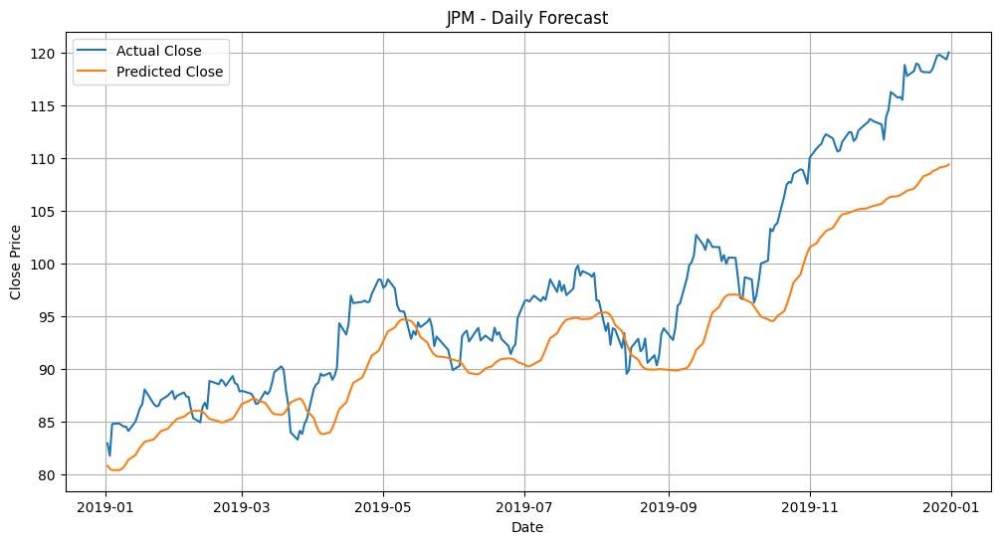

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 111ms/step

📊 Results for NVDA
RMSE: 0.4384
MAE : 0.3628
R^2 : 0.5059
MAPE: 0.0863


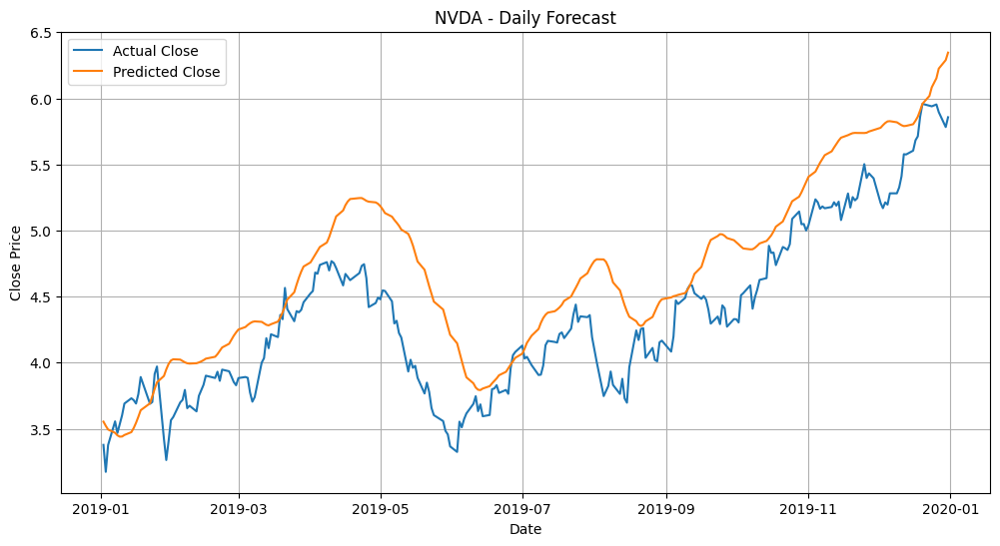

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 103ms/step

📊 Results for SPY
RMSE: 9.6241
MAE : 8.4435
R^2 : 0.5897
MAPE: 0.0313


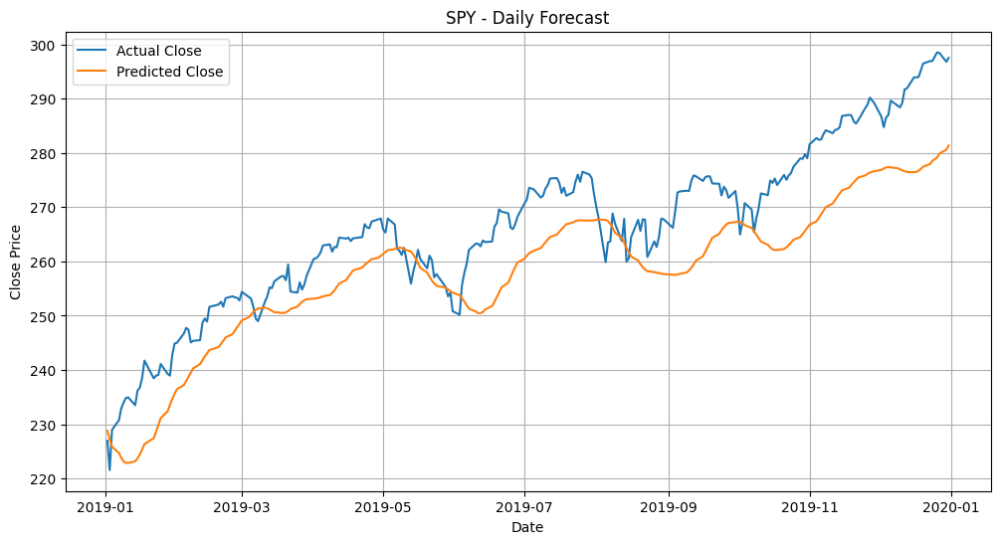

📉 Mean Scaled RMSE over 4 stocks: 0.12138799310283438


In [35]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2014-01-01':'2019-12-31']
    train_df = df.loc[:'2018-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2019-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 96ms/step

📊 Results for AAPL
RMSE: 2.9670
MAE : 2.6517
R^2 : 0.3048
MAPE: 0.0727


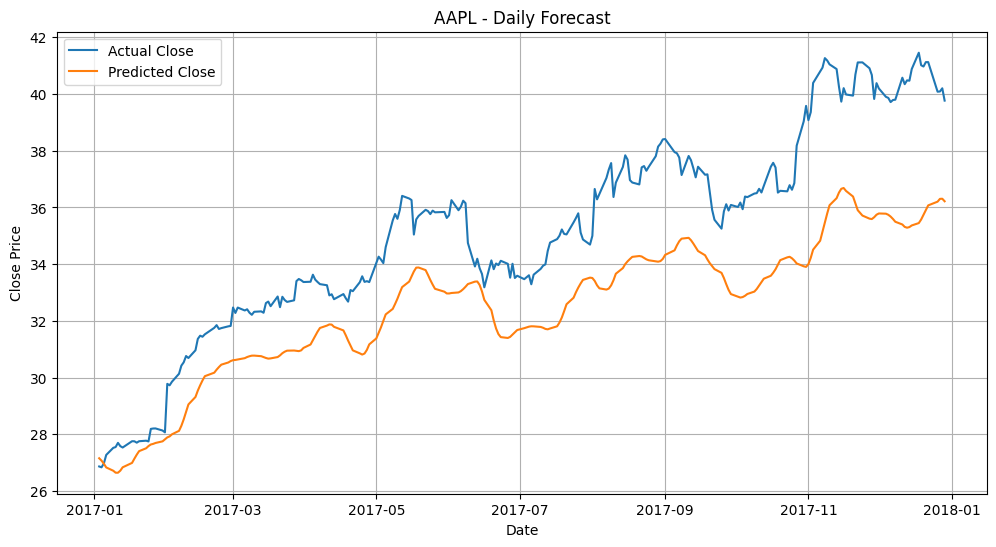

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 102ms/step

📊 Results for JPM
RMSE: 3.9487
MAE : 3.3798
R^2 : 0.4898
MAPE: 0.0445


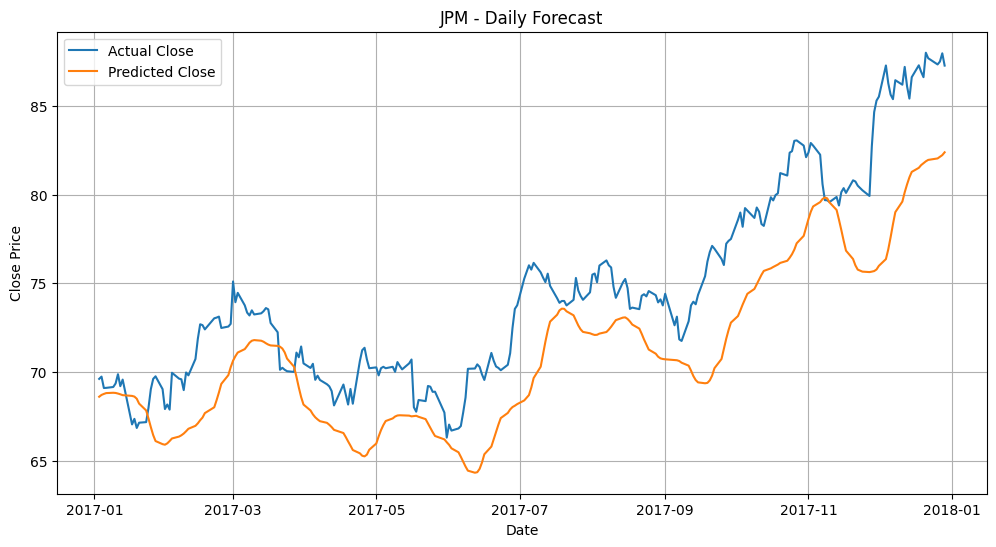

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 101ms/step

📊 Results for NVDA
RMSE: 0.3660
MAE : 0.3037
R^2 : 0.8488
MAPE: 0.0944


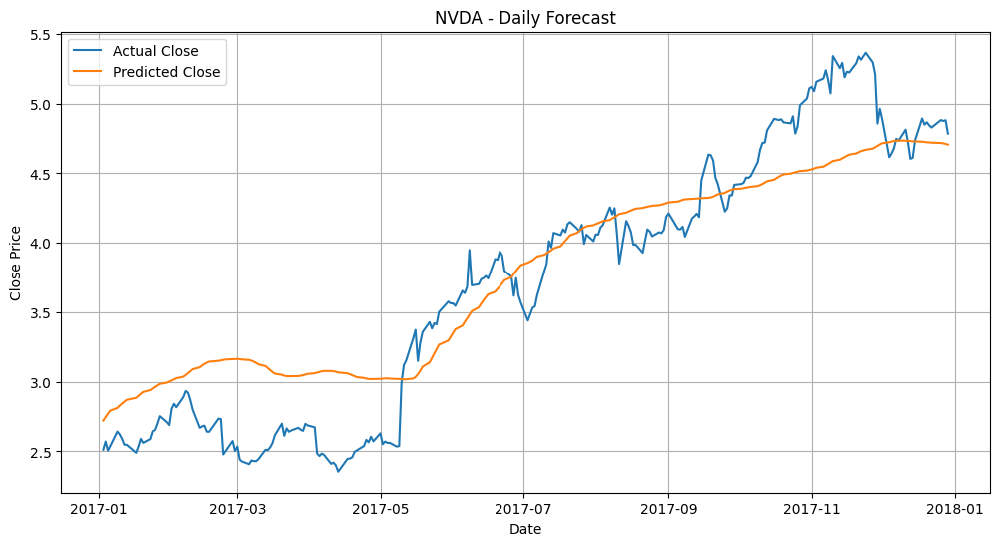

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 103ms/step

📊 Results for SPY
RMSE: 8.9852
MAE : 8.2374
R^2 : 0.3021
MAPE: 0.0376


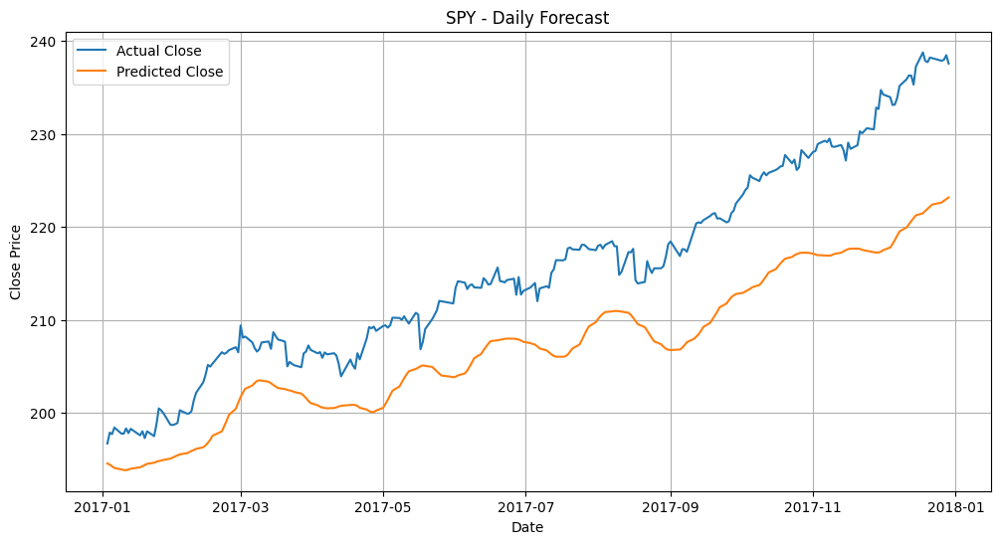

📉 Mean Scaled RMSE over 4 stocks: 0.17997518768716556


In [36]:
def forecast_stock(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1', 'RSI', 'MACD', 'ma_5']].dropna()
    feature_cols = df.columns.drop('Close')

    df = df.loc['2012-01-01':'2017-12-31']
    train_df = df.loc[:'2016-12-31']
    # Get the index
    test_start_date = pd.Timestamp("2017-01-01")

    # Find the first index *on or after* Jan 1, 20xx
    start_idx = df.index.searchsorted(test_start_date)

    # Back up `window` steps for context, but ensure we stay in bounds
    extended_start_idx = max(0, start_idx - window)

    # Slice from that point
    test_df = df.iloc[extended_start_idx:]

    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()

    X_train = scaler_X.fit_transform(train_df[feature_cols])
    y_train = scaler_y.fit_transform(train_df[['Close']])

    X_test = scaler_X.transform(test_df[feature_cols])
    y_test = scaler_y.transform(test_df[['Close']])

    X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    model = Sequential([
        LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96, return_sequences=True),
        #Dropout(0.2),

        LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
        #Dropout(0.2),

        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_stock(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# 1 model 4 all

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step

📊 Results for AAPL
RMSE: 85.1663
MAE : 84.4697
R^2 : -27.0716
MAPE: 0.4888


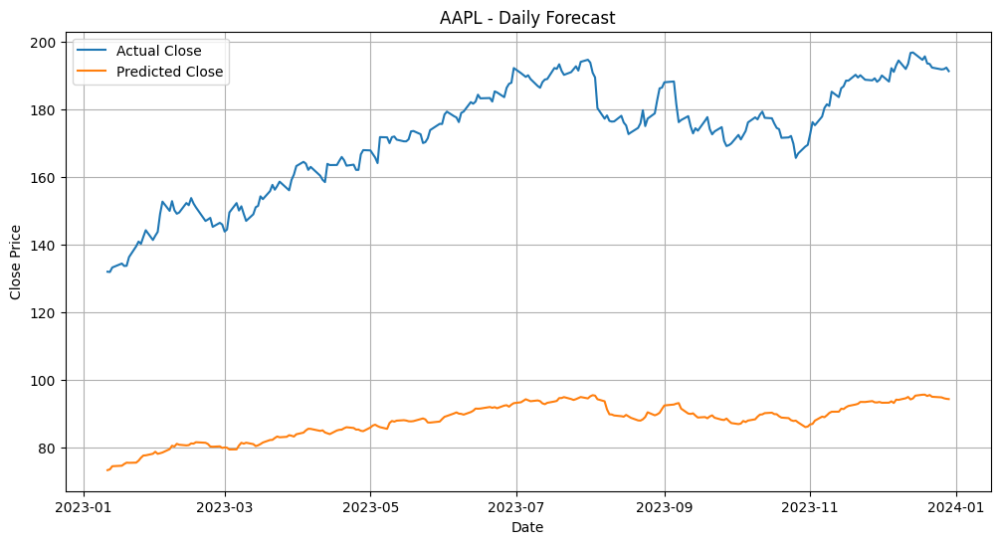

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

📊 Results for JPM
RMSE: 44.5502
MAE : 43.8337
R^2 : -20.0192
MAPE: 0.3136


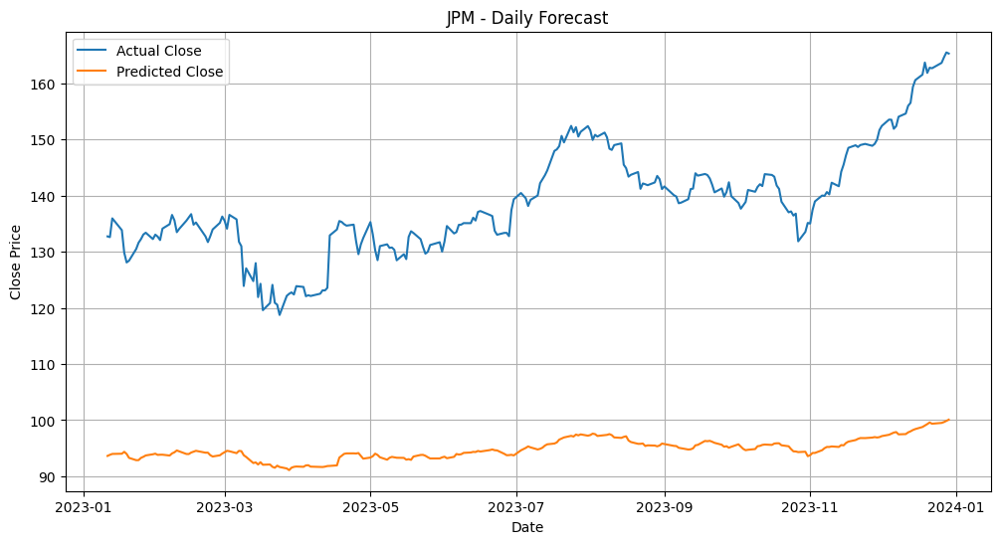

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 

📊 Results for NVDA
RMSE: 33.1742
MAE : 31.7433
R^2 : -9.3585
MAPE: 0.8479


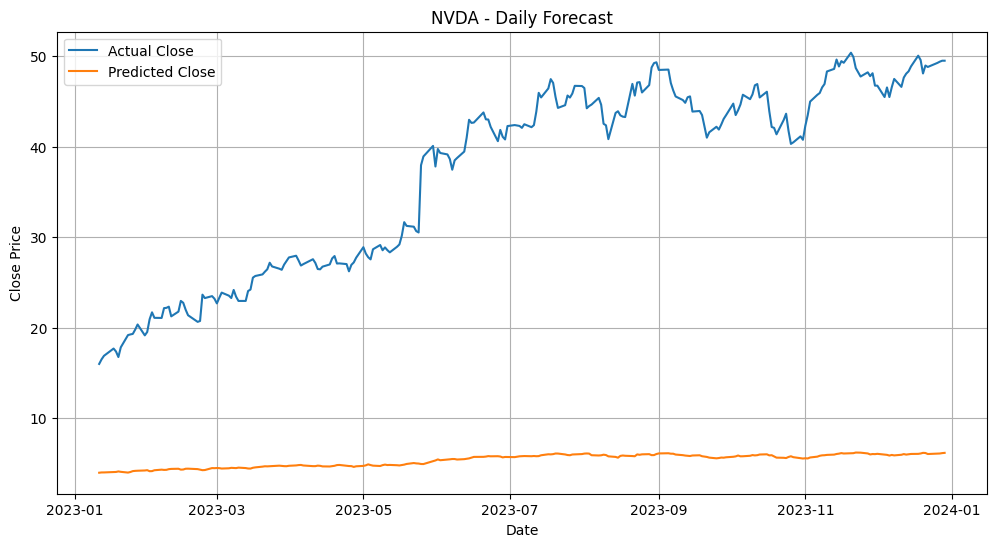

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 

📊 Results for SPY
RMSE: 19.5827
MAE : 16.6590
R^2 : 0.2864
MAPE: 0.0412


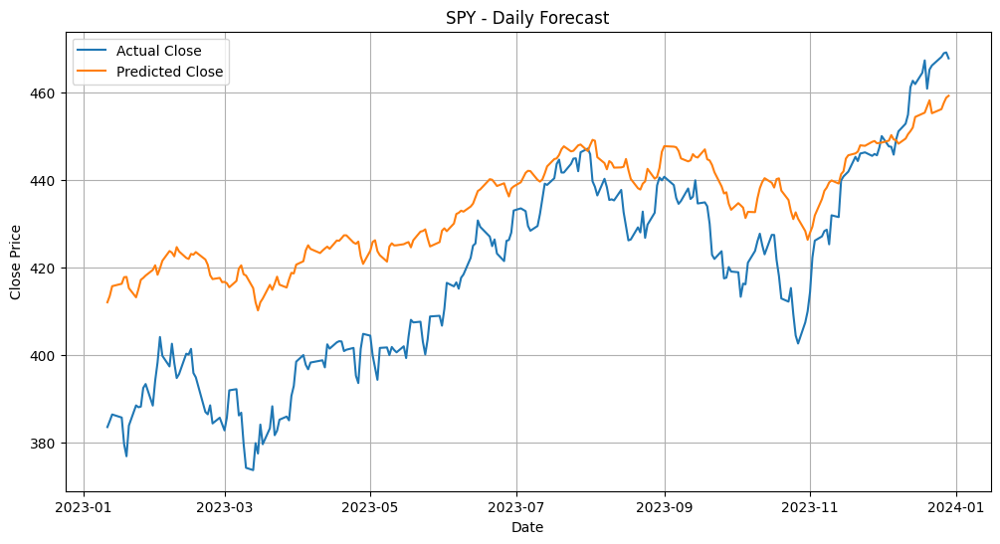

📉 Mean Scaled RMSE over 4 stocks: 0.857888969929509


In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_absolute_percentage_error
import warnings
from ta.momentum import RSIIndicator
from ta.trend import MACD
from keras.optimizers import Adam

warnings.filterwarnings("ignore")

def load_main_stock_close(path):
    df = pd.read_csv(path, skiprows=3, header=None)
    df.columns = ['Date', 'Close', 'High', 'Low', 'Open', 'Volume']
    df['Date'] = pd.to_datetime(df['Date'])
    df = df.sort_values('Date')
    df = df[['Date', 'Open', 'High', 'Low', 'Close', 'Volume']].set_index('Date')
    df = df.loc['2008-01-01':'2024-12-31']
    df['Close_lag1'] = df['Close'].shift(1)
    df = df.drop(columns=['Open', 'High', 'Low', 'Volume'])
    return df.dropna()
def create_sequences(X, y, window):
    Xs, ys = [], []
    for i in range(len(X) - window):
        Xs.append(X[i:i+window])
        ys.append(y[i+window])
    return np.array(Xs), np.array(ys)

# === Load all stock data and combine training data ===
window = 20
stock_paths = ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']
train_all_X, train_all_y = [], []

scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()

all_train_features = []
all_train_targets = []

stock_dfs = {}

for path in stock_paths:
    stock_name = path.replace('.csv', '')
    df = load_main_stock(path)
    df = df.loc['2018-01-01':'2023-12-31']
    stock_dfs[stock_name] = df

    train_df = df.loc[:'2022-12-31']
    feature_cols = df.columns.drop('Close')

    all_train_features.append(train_df[feature_cols])
    all_train_targets.append(train_df[['Close']])

# Fit scalers on full training set (combined from all stocks)
X_train_concat = pd.concat(all_train_features)
y_train_concat = pd.concat(all_train_targets)

X_train_scaled = scaler_X.fit_transform(X_train_concat)
y_train_scaled = scaler_y.fit_transform(y_train_concat)

# Now create sequences across all stocks
start_idx = 0
for df_features, df_target in zip(all_train_features, all_train_targets):
    X = scaler_X.transform(df_features)
    y = scaler_y.transform(df_target)

    X_seq, y_seq = create_sequences(X, y, window)
    train_all_X.append(X_seq)
    train_all_y.append(y_seq)

X_train_final = np.concatenate(train_all_X)
y_train_final = np.concatenate(train_all_y)

# === Build and train model ===
model = Sequential([
    LSTM(64, input_shape=(window, X_train_final.shape[2])),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
model.fit(X_train_final, y_train_final, epochs=20, batch_size=64, verbose=0)

# === Evaluate per stock ===
scaled_rmses = []

for stock_name, df in stock_dfs.items():
    feature_cols = df.columns.drop('Close')
    df = df.loc['2018-01-01':'2023-12-31']

    test_df = df.loc['2022-12-12':]  # enough to allow 20-day window before 2023

    X_test = scaler_X.transform(test_df[feature_cols])
    y_true_df = test_df[['Close']].copy()

    # Fit a per-stock scaler_y_eval (only on train part of that stock)
    scaler_y_eval = MinMaxScaler()
    scaler_y_eval.fit(df.loc[:'2022-12-31'][['Close']])
    y_test = scaler_y_eval.transform(test_df[['Close']])

    X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

    y_pred_scaled = model.predict(X_test_seq)
    y_pred = scaler_y_eval.inverse_transform(y_pred_scaled)
    y_true = scaler_y_eval.inverse_transform(y_test_seq)

    # Evaluation
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Plot
    test_dates = test_df.index[window:]
    plt.figure(figsize=(12, 6))
    plt.plot(test_dates, y_true.flatten(), label='Actual Close')
    plt.plot(test_dates, y_pred.flatten(), label='Predicted Close')
    plt.title(f'{stock_name} - Daily Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (y_true.max() - y_true.min())
    scaled_rmses.append(scaled_rmse)

# === Final average score ===
mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


# Retrained Model


📊 Results for AAPL
RMSE: 5.1396
MAE : 4.1993
R^2 : 0.9096
MAPE: 0.0244


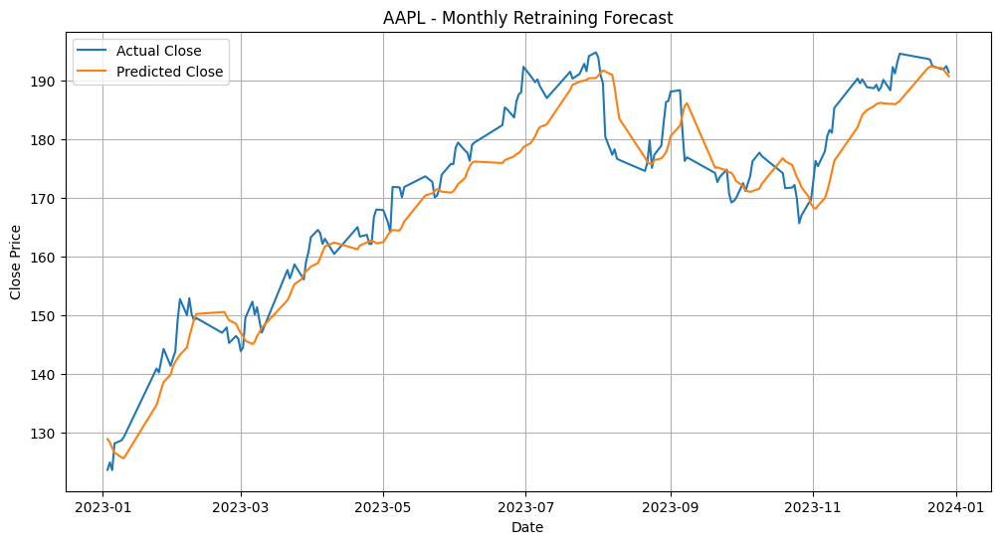


📊 Results for JPM
RMSE: 2.7102
MAE : 2.1083
R^2 : 0.9209
MAPE: 0.0155


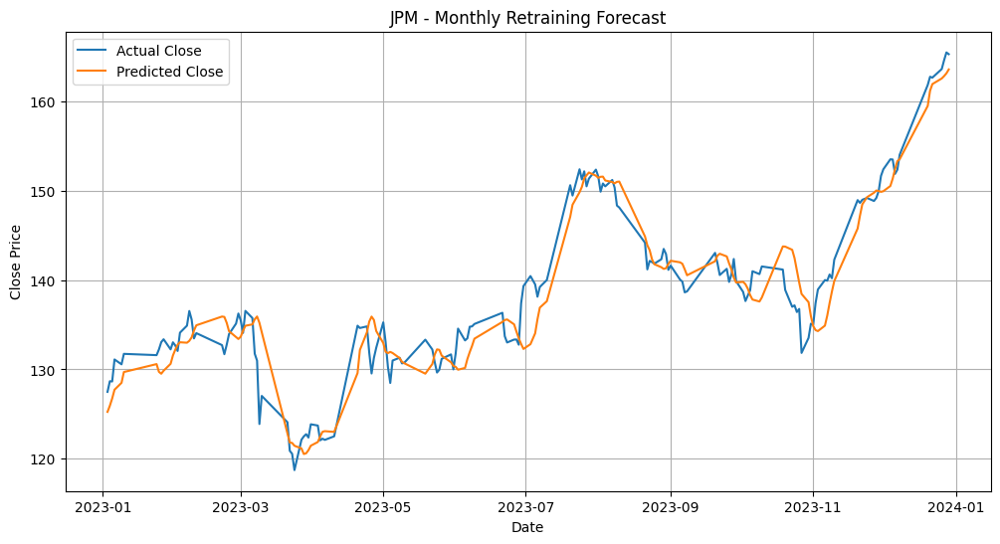


📊 Results for NVDA
RMSE: 1.8316
MAE : 1.3511
R^2 : 0.9696
MAPE: 0.0380


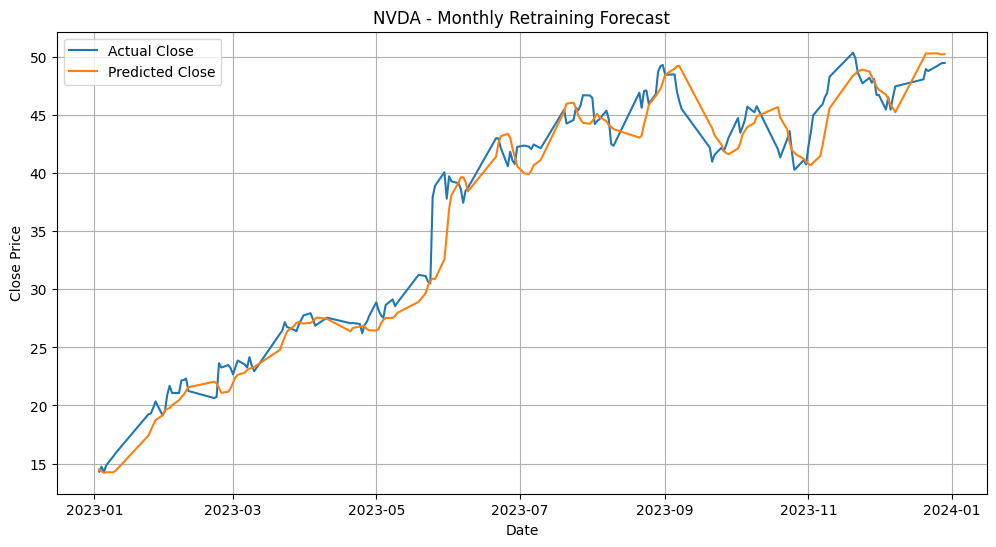


📊 Results for SPY
RMSE: 7.3448
MAE : 5.7901
R^2 : 0.9021
MAPE: 0.0140


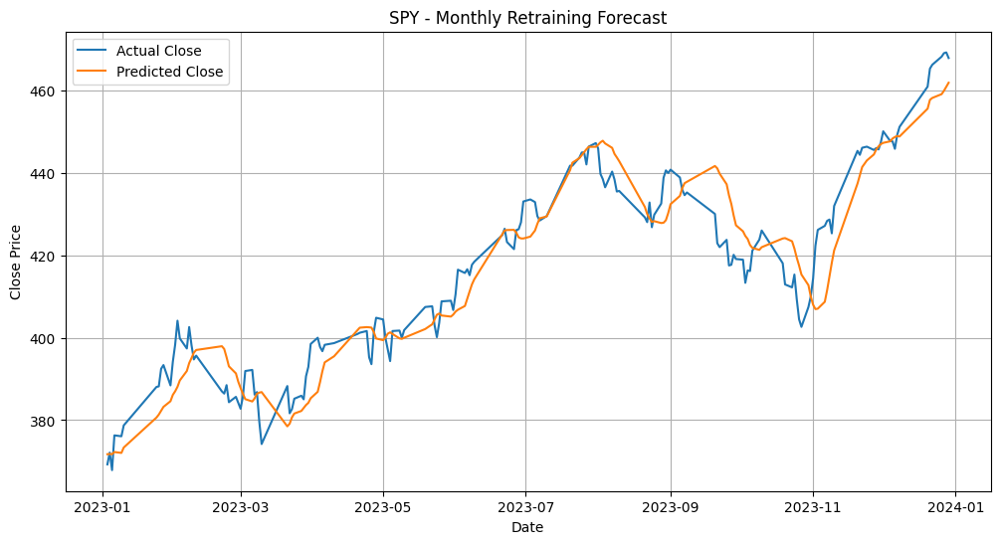

📉 Mean Scaled RMSE over 4 stocks: 0.0627931306831809


In [11]:
from dateutil.relativedelta import relativedelta

def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2018-01-01':'2023-12-31']

    test_start = pd.Timestamp("2022-12-11")
    test_end = pd.Timestamp("2023-12-31")

    current_train_end = pd.Timestamp("2022-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(64, input_shape=(window, X_train_seq.shape[2])),
            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2019
    plot_start = pd.Timestamp("2023-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2023-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)



📊 Results for AAPL
RMSE: 1.3488
MAE : 1.1014
R^2 : 0.9740
MAPE: 0.0225


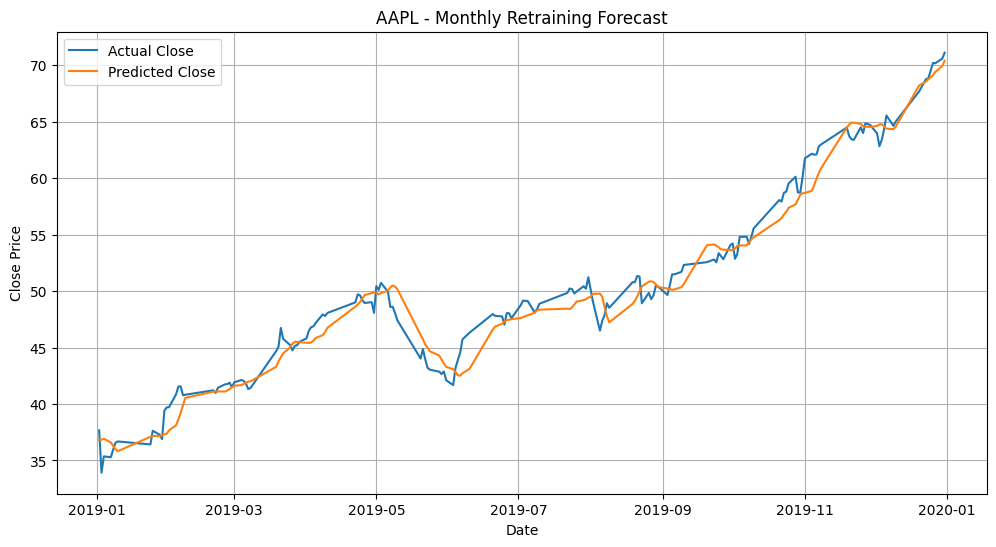


📊 Results for JPM
RMSE: 2.4642
MAE : 1.9171
R^2 : 0.9333
MAPE: 0.0199


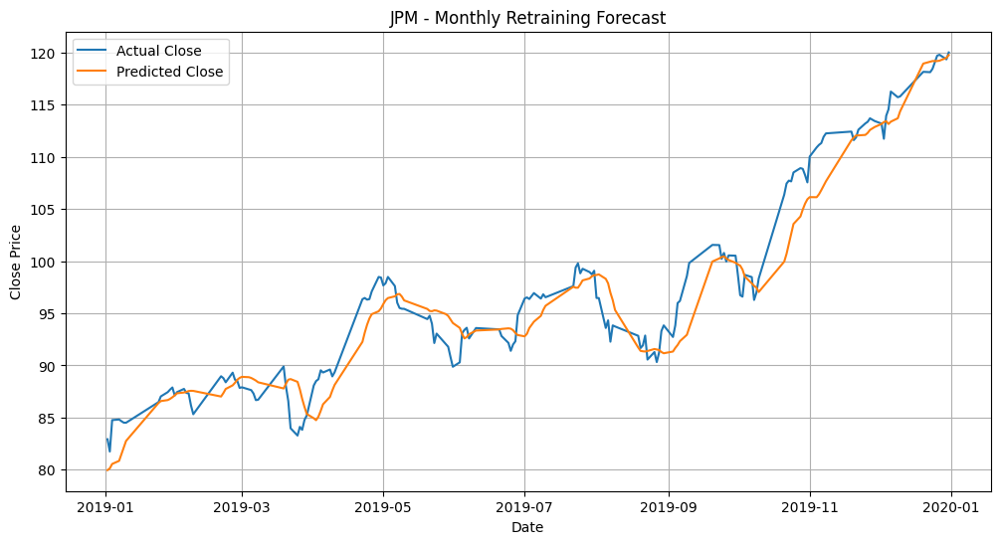


📊 Results for NVDA
RMSE: 0.2111
MAE : 0.1666
R^2 : 0.8869
MAPE: 0.0399


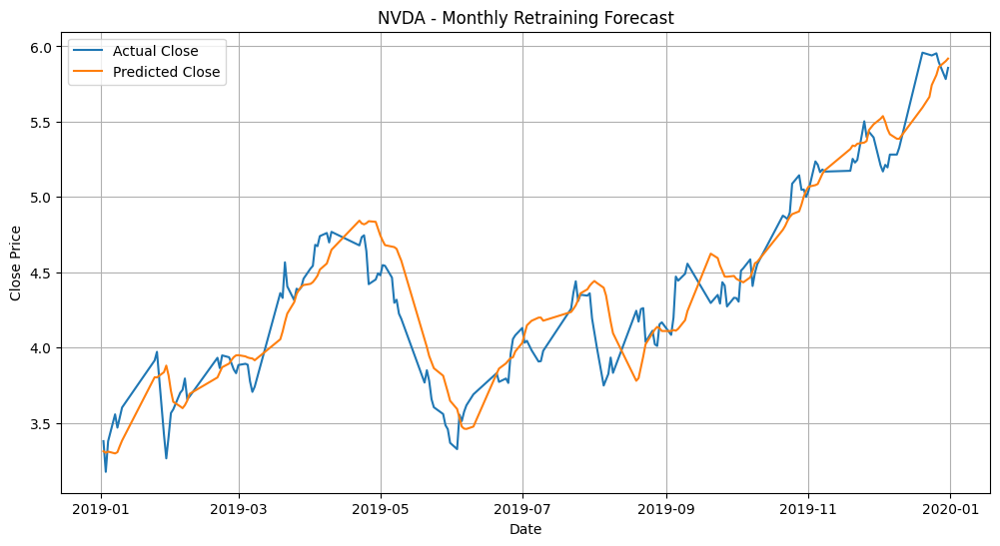


📊 Results for SPY
RMSE: 3.8367
MAE : 3.0934
R^2 : 0.9332
MAPE: 0.0117


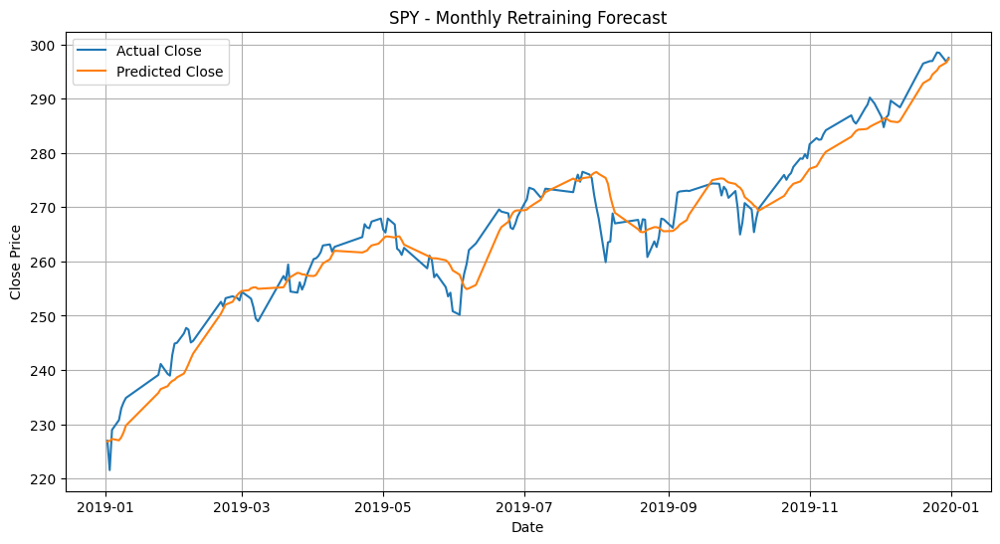

📉 Mean Scaled RMSE over 4 stocks: 0.0533251686735014


In [2]:
from dateutil.relativedelta import relativedelta

def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2014-01-01':'2019-12-31']

    test_start = pd.Timestamp("2018-12-11")
    test_end = pd.Timestamp("2019-12-31")

    current_train_end = pd.Timestamp("2018-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(64, input_shape=(window, X_train_seq.shape[2])),
            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2019
    plot_start = pd.Timestamp("2019-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2019-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)



📊 Results for AAPL
RMSE: 0.7659
MAE : 0.5864
R^2 : 0.9516
MAPE: 0.0165


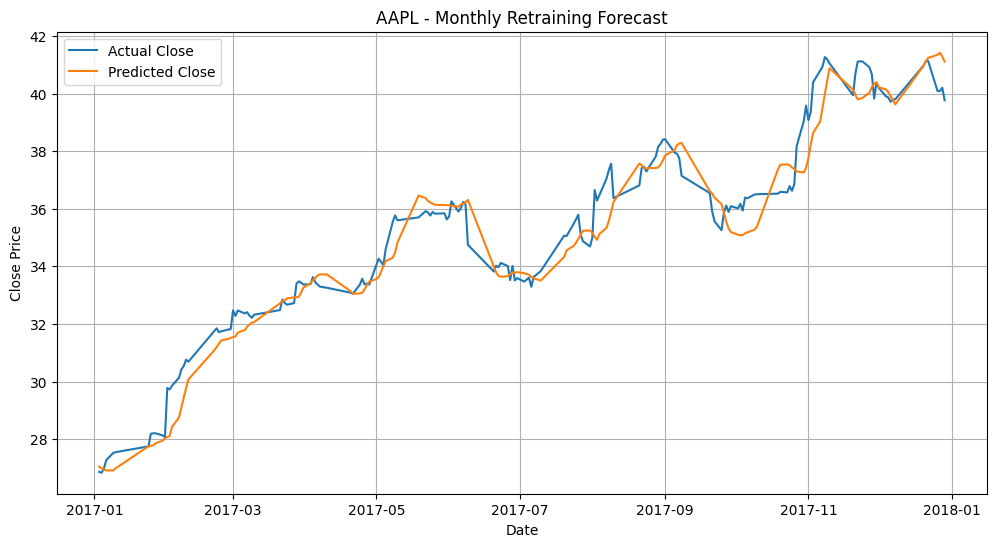


📊 Results for JPM
RMSE: 1.5544
MAE : 1.2051
R^2 : 0.9226
MAPE: 0.0161


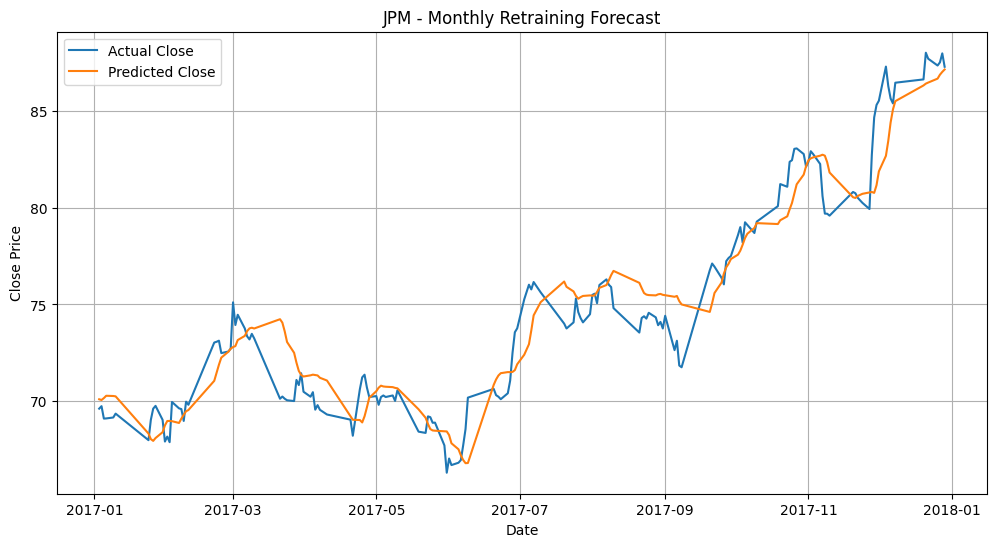


📊 Results for NVDA
RMSE: 0.1953
MAE : 0.1562
R^2 : 0.9569
MAPE: 0.0439


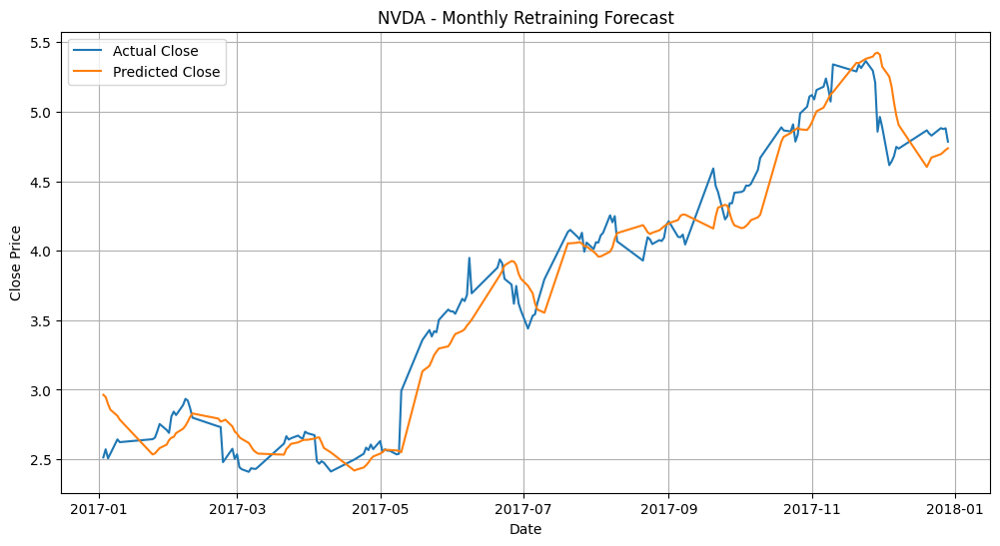


📊 Results for SPY
RMSE: 1.6877
MAE : 1.3445
R^2 : 0.9747
MAPE: 0.0062


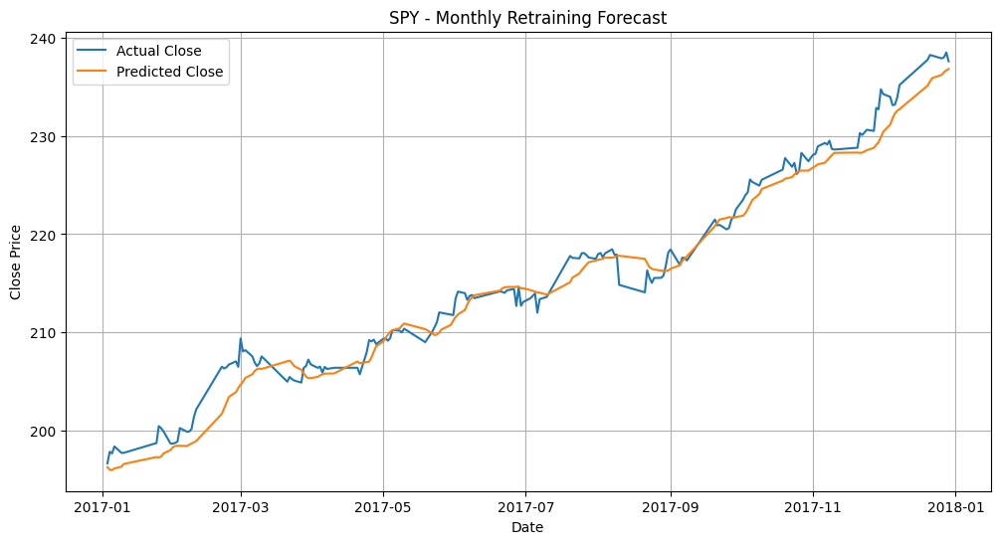

📉 Mean Scaled RMSE over 4 stocks: 0.05738297016519795


In [3]:
def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2012-01-01':'2017-12-31']

    test_start = pd.Timestamp("2016-12-11")
    test_end = pd.Timestamp("2017-12-31")

    current_train_end = pd.Timestamp("2016-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(64, input_shape=(window, X_train_seq.shape[2])),
            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2017
    plot_start = pd.Timestamp("2017-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2017-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


📊 Results for AAPL
RMSE: 6.1798
MAE : 4.8625
R^2 : 0.8693
MAPE: 0.0286


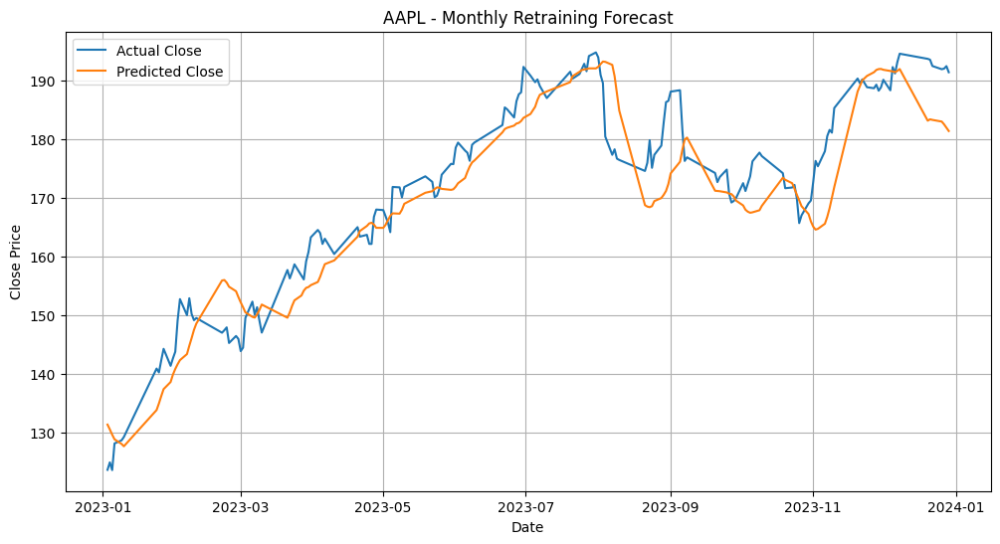


📊 Results for JPM
RMSE: 2.7005
MAE : 2.1616
R^2 : 0.9214
MAPE: 0.0157


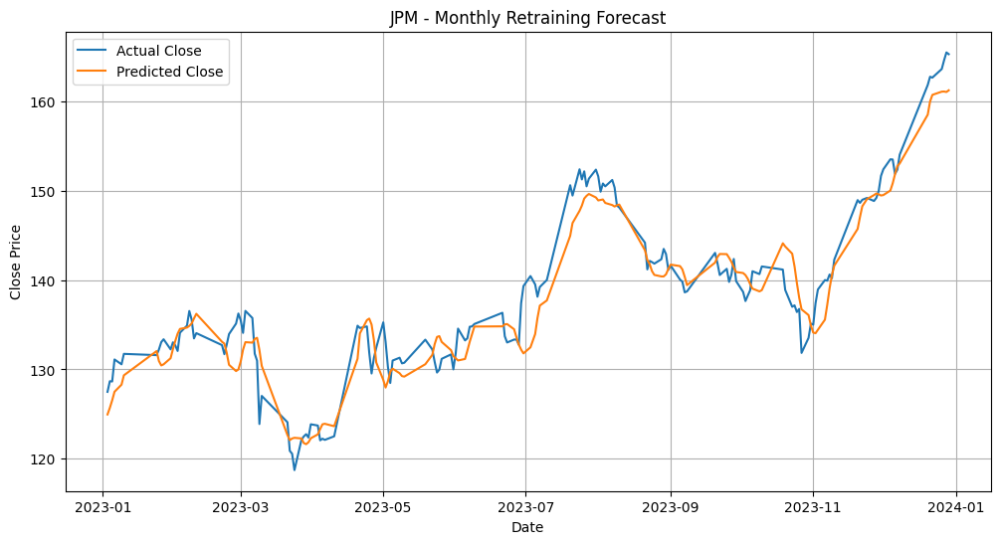


📊 Results for NVDA
RMSE: 2.0382
MAE : 1.5338
R^2 : 0.9624
MAPE: 0.0434


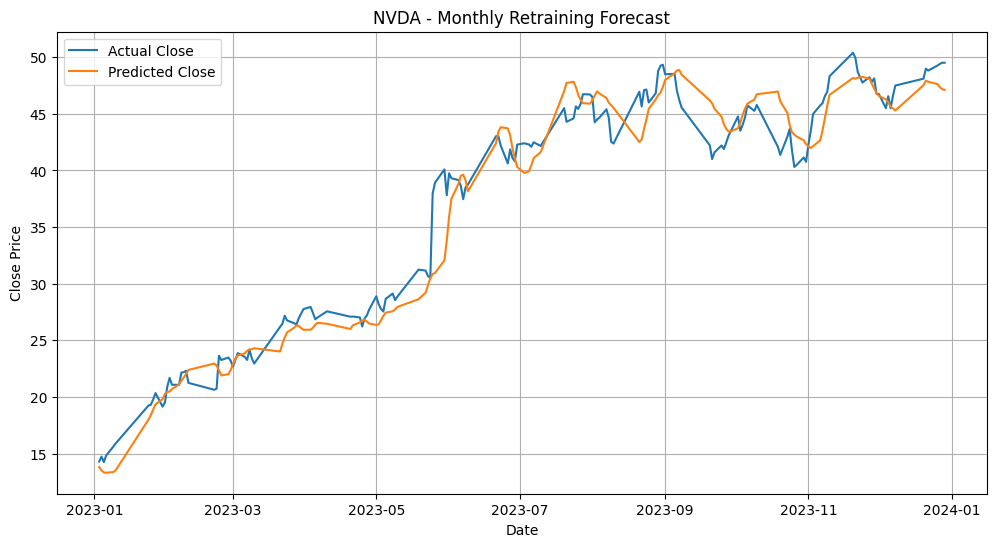


📊 Results for SPY
RMSE: 8.5979
MAE : 7.2145
R^2 : 0.8658
MAPE: 0.0173


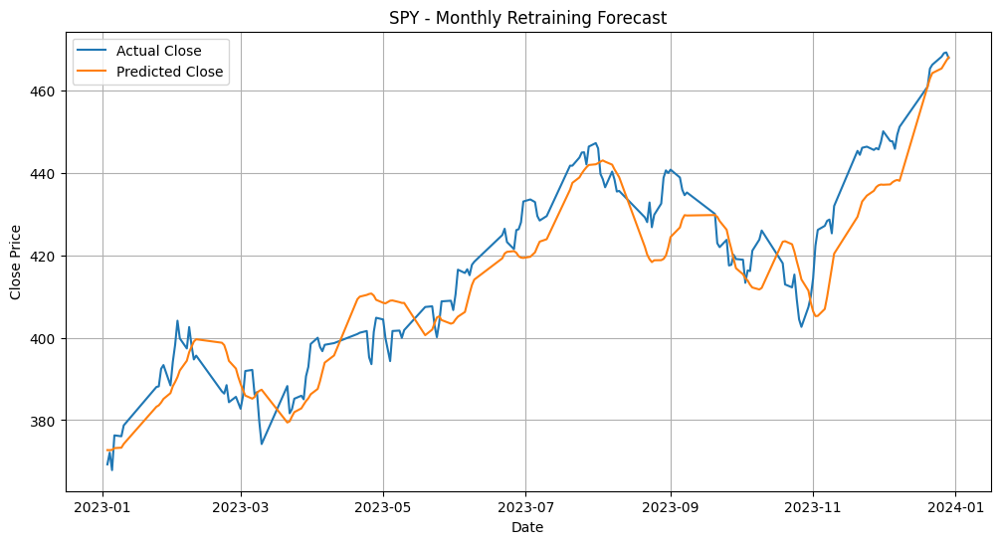

📉 Mean Scaled RMSE over 4 stocks: 0.07082689375986338


In [4]:
from dateutil.relativedelta import relativedelta

def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2018-01-01':'2023-12-31']

    test_start = pd.Timestamp("2022-12-11")
    test_end = pd.Timestamp("2023-12-31")

    current_train_end = pd.Timestamp("2023-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
            LSTM(64, return_sequences=False),
            Dense(16, activation='relu'),
            Dense(1, activation='linear')
            ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2019
    plot_start = pd.Timestamp("2023-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2023-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)



📊 Results for AAPL
RMSE: 1.6040
MAE : 1.2980
R^2 : 0.9632
MAPE: 0.0261


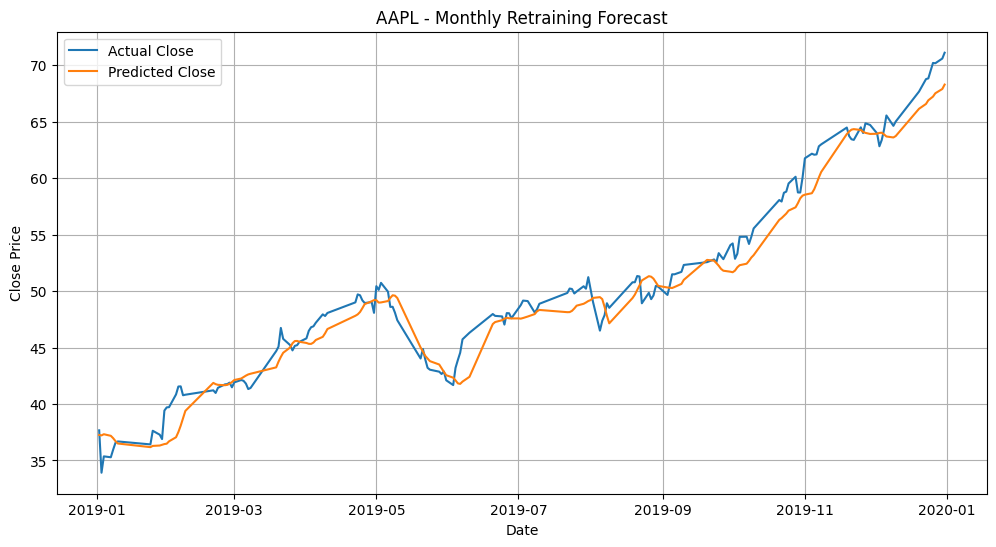


📊 Results for JPM
RMSE: 3.5605
MAE : 2.8093
R^2 : 0.8608
MAPE: 0.0285


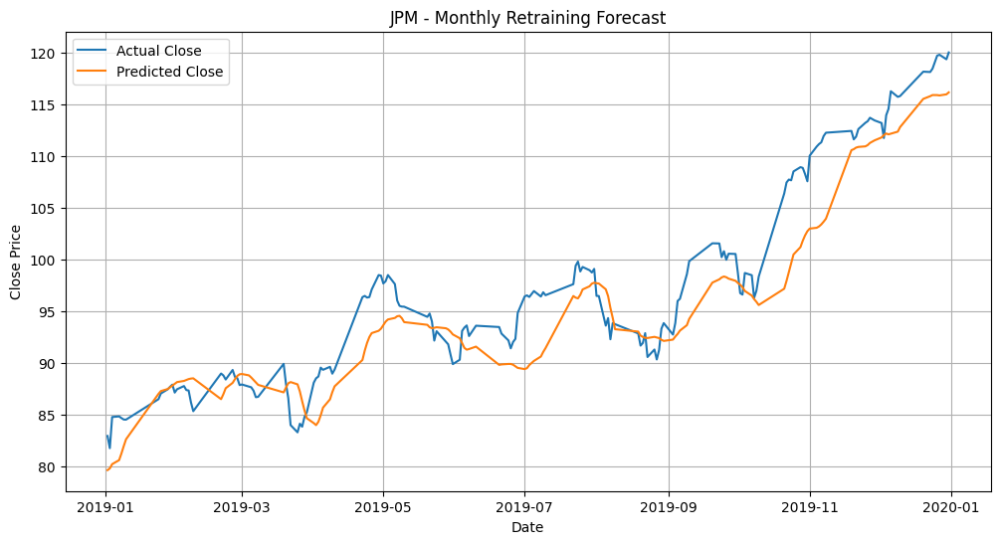


📊 Results for NVDA
RMSE: 0.2386
MAE : 0.1870
R^2 : 0.8555
MAPE: 0.0431


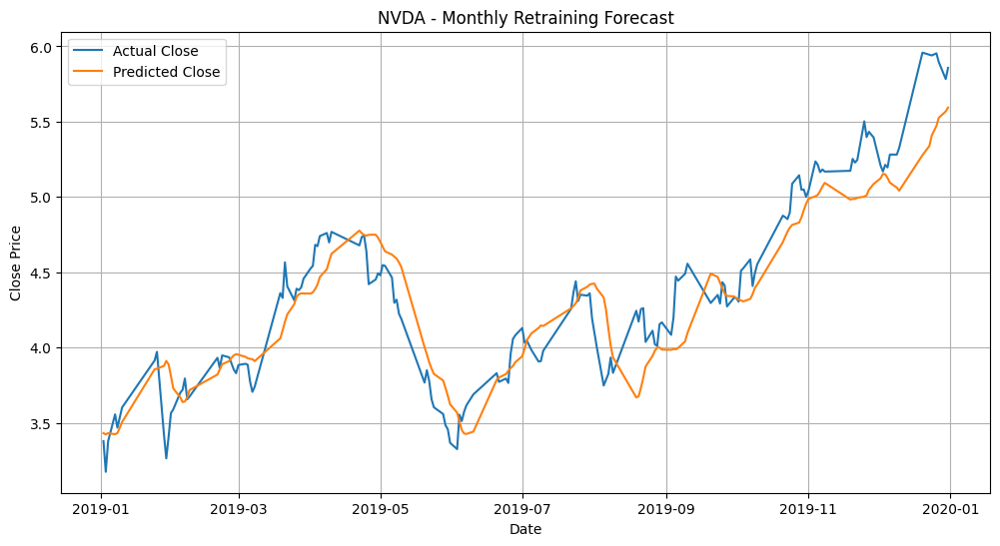


📊 Results for SPY
RMSE: 4.2540
MAE : 3.5003
R^2 : 0.9178
MAPE: 0.0133


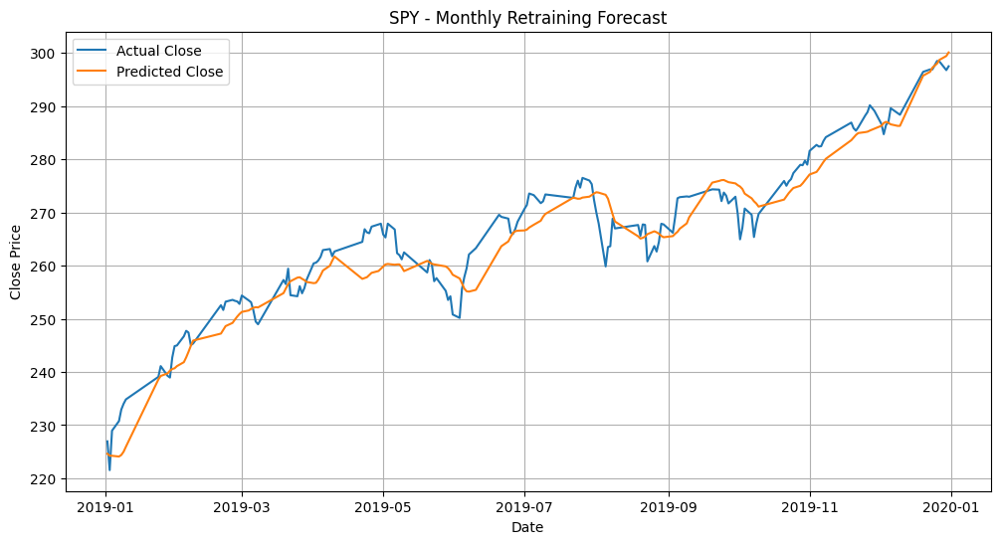

📉 Mean Scaled RMSE over 4 stocks: 0.06506683509909446


In [5]:
from dateutil.relativedelta import relativedelta

def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2014-01-01':'2019-12-31']

    test_start = pd.Timestamp("2018-12-11")
    test_end = pd.Timestamp("2019-12-31")

    current_train_end = pd.Timestamp("2018-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
            LSTM(64, return_sequences=False),
            Dense(16, activation='relu'),
            Dense(1, activation='linear')
            ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2019
    plot_start = pd.Timestamp("2019-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2019-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


In [6]:
def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2012-01-01':'2017-12-31']

    test_start = pd.Timestamp("2016-12-11")
    test_end = pd.Timestamp("2017-12-31")

    current_train_end = pd.Timestamp("2016-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(128, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
            LSTM(64, return_sequences=False),
            Dense(16, activation='relu'),
            Dense(1, activation='linear')
            ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2017
    plot_start = pd.Timestamp("2017-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2017-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)

KeyboardInterrupt: 

In [ ]:
from dateutil.relativedelta import relativedelta

def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2018-01-01':'2023-12-31']

    test_start = pd.Timestamp("2022-12-11")
    test_end = pd.Timestamp("2023-12-31")

    current_train_end = pd.Timestamp("2023-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
            #Dropout(0.2),

            LSTM(96, return_sequences=True),
            #Dropout(0.2),

            LSTM(96, return_sequences=True),
            #Dropout(0.2),

            LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
            #Dropout(0.2),

            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2019
    plot_start = pd.Timestamp("2023-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2023-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


In [ ]:
from dateutil.relativedelta import relativedelta

def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2014-01-01':'2019-12-31']

    test_start = pd.Timestamp("2018-12-11")
    test_end = pd.Timestamp("2019-12-31")

    current_train_end = pd.Timestamp("2018-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
            #Dropout(0.2),

            LSTM(96, return_sequences=True),
            #Dropout(0.2),

            LSTM(96, return_sequences=True),
            #Dropout(0.2),

            LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
            #Dropout(0.2),

            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2019
    plot_start = pd.Timestamp("2019-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2019-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)


In [ ]:
def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2012-01-01':'2017-12-31']

    test_start = pd.Timestamp("2016-12-11")
    test_end = pd.Timestamp("2017-12-31")

    current_train_end = pd.Timestamp("2016-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(96, input_shape=(X_train_seq.shape[1], X_train_seq.shape[2]), return_sequences=True),
            #Dropout(0.2),

            LSTM(96, return_sequences=True),
            #Dropout(0.2),

            LSTM(96, return_sequences=True),
            #Dropout(0.2),

            LSTM(96),  # return_sequences=False by default here, output shape (None, 96)
            #Dropout(0.2),

            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2017
    plot_start = pd.Timestamp("2017-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2017-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)

# Final test: Model 1 retraining, lr 0.003.


📊 Results for AAPL
RMSE: 5.7296
MAE : 4.5980
R^2 : 0.9503
MAPE: 0.0223


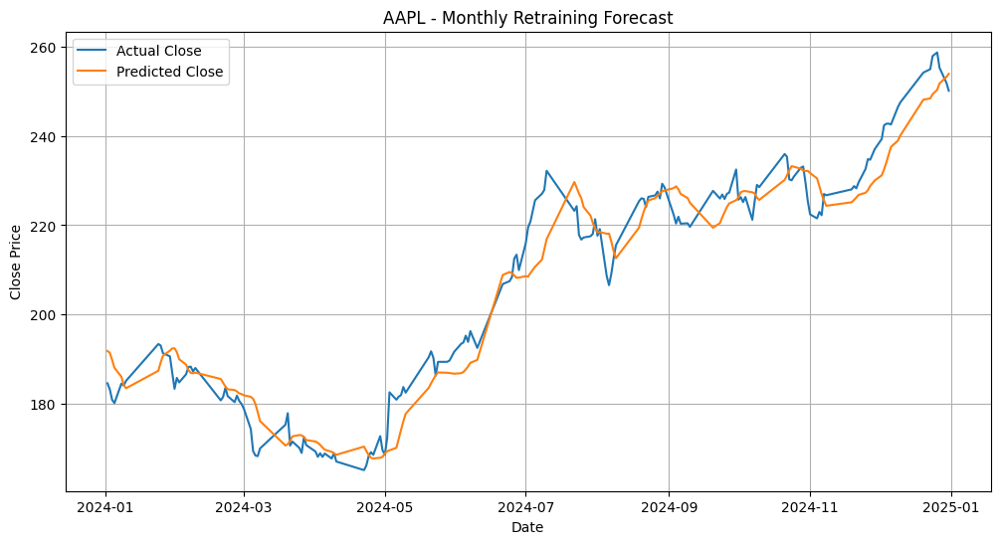


📊 Results for JPM
RMSE: 4.5301
MAE : 3.3324
R^2 : 0.9563
MAPE: 0.0162


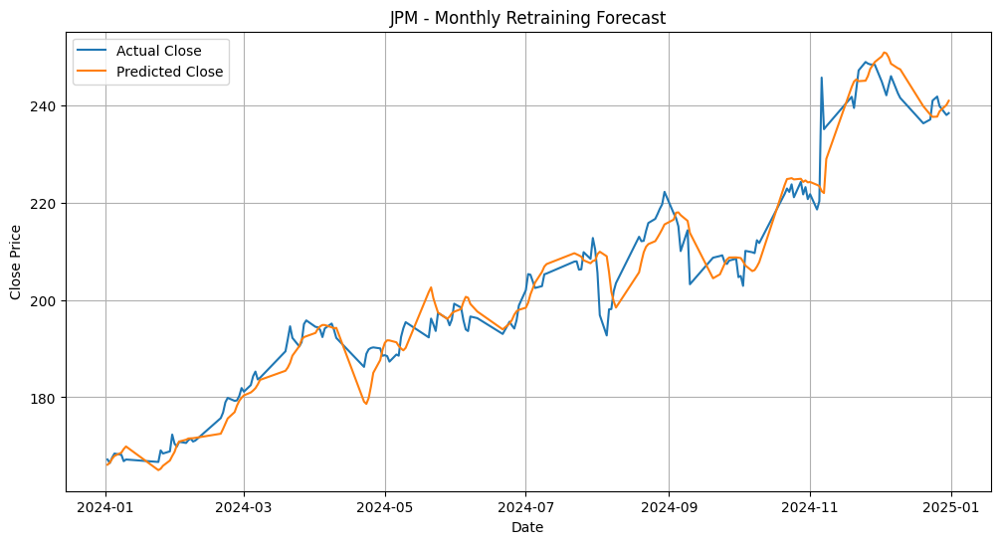


📊 Results for NVDA
RMSE: 6.2747
MAE : 5.1301
R^2 : 0.9443
MAPE: 0.0502


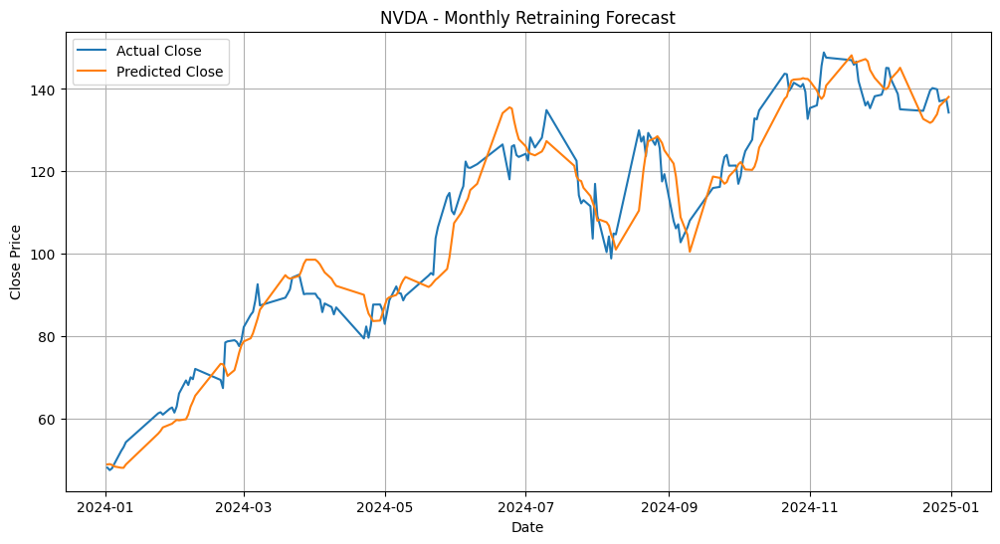


📊 Results for SPY
RMSE: 8.2927
MAE : 6.4850
R^2 : 0.9508
MAPE: 0.0122


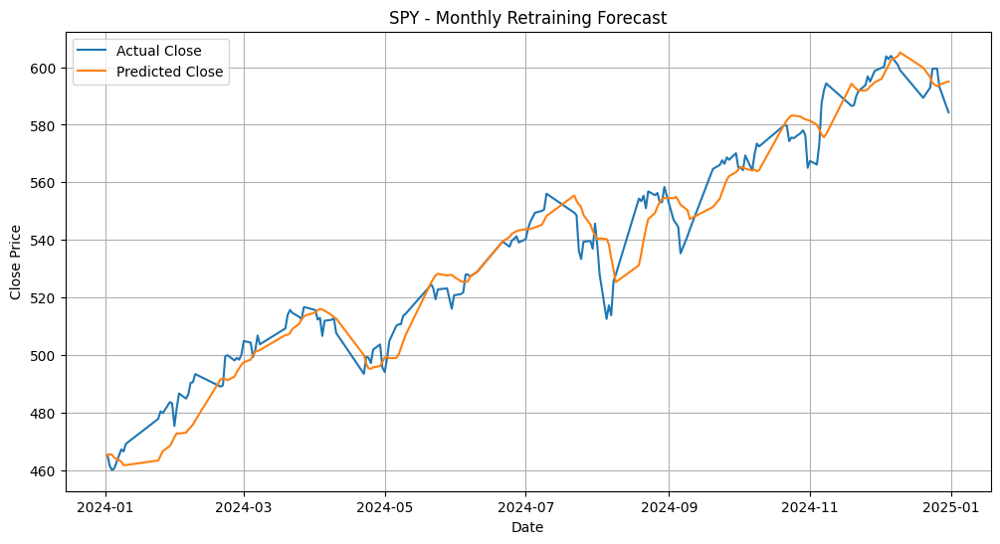

📉 Mean Scaled RMSE over 4 stocks: 0.058166743391019196


In [7]:
from dateutil.relativedelta import relativedelta

def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2018-01-01':'2024-12-31']

    test_start = pd.Timestamp("2023-12-11")
    test_end = pd.Timestamp("2024-12-31")

    current_train_end = pd.Timestamp("2023-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(64, input_shape=(window, X_train_seq.shape[2])),
            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2019
    plot_start = pd.Timestamp("2024-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2024-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)



📊 Results for AAPL
RMSE: 4.9423
MAE : 3.8003
R^2 : 0.8899
MAPE: 0.0276


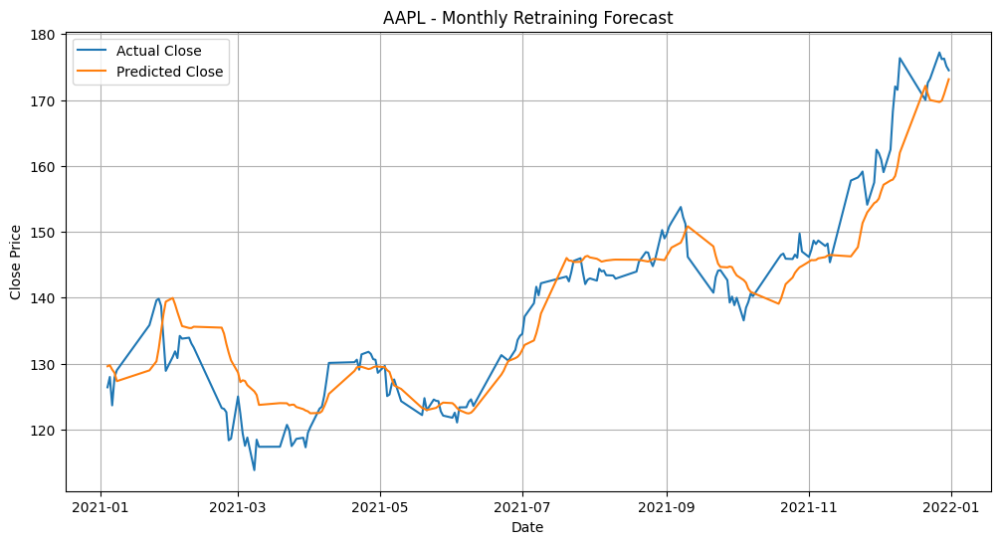


📊 Results for JPM
RMSE: 3.6018
MAE : 2.9291
R^2 : 0.8635
MAPE: 0.0210


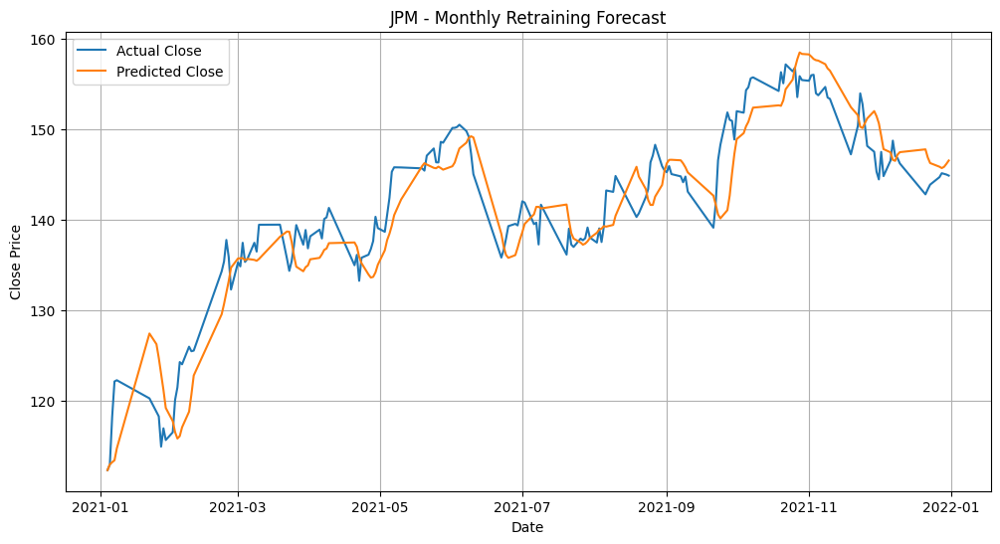


📊 Results for NVDA
RMSE: 1.2417
MAE : 0.8912
R^2 : 0.9574
MAPE: 0.0435


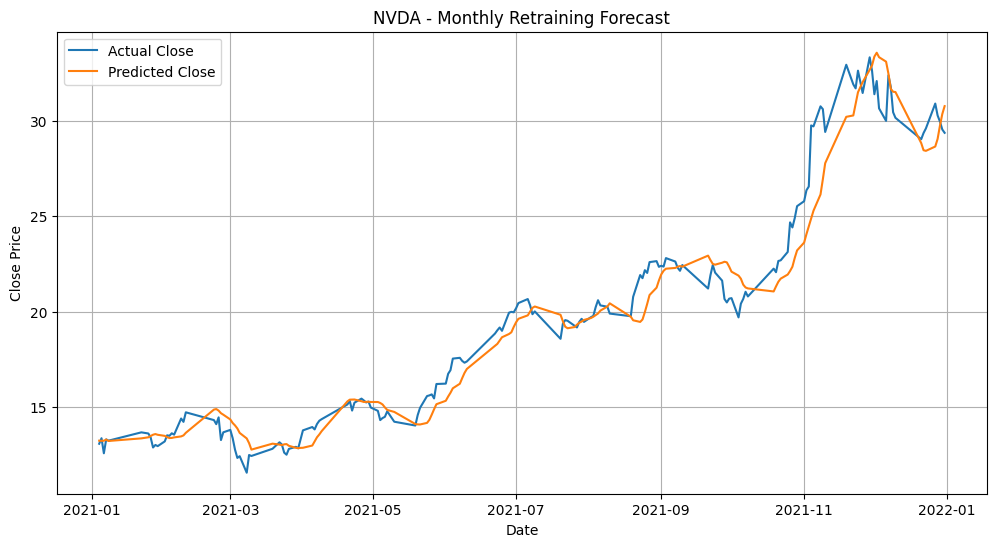


📊 Results for SPY
RMSE: 6.1409
MAE : 4.7127
R^2 : 0.9549
MAPE: 0.0117


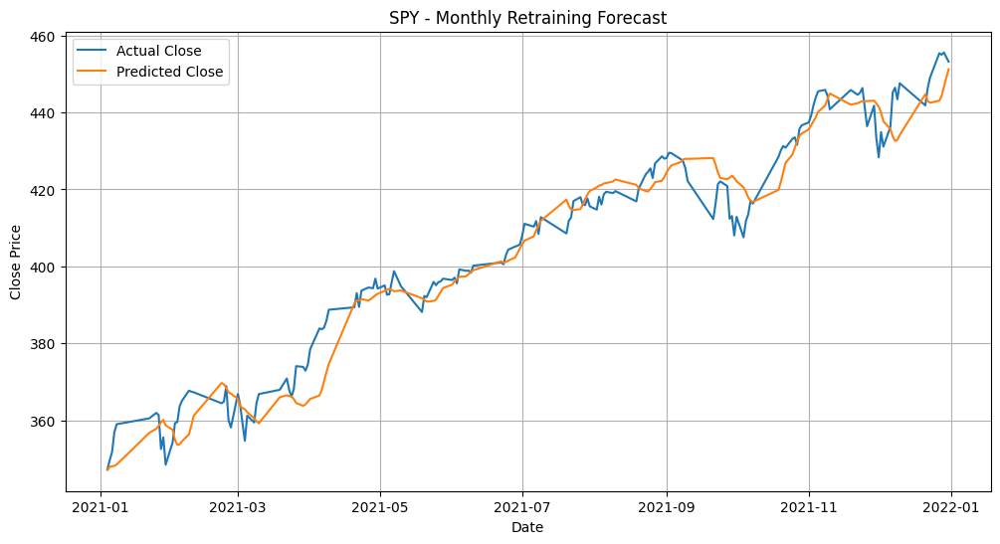

📉 Mean Scaled RMSE over 4 stocks: 0.06628639857612678


In [8]:
def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2015-01-01':'2021-12-31']

    test_start = pd.Timestamp("2020-12-11")
    test_end = pd.Timestamp("2021-12-31")

    current_train_end = pd.Timestamp("2020-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(64, input_shape=(window, X_train_seq.shape[2])),
            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2019
    plot_start = pd.Timestamp("2021-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2021-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)



📊 Results for AAPL
RMSE: 1.6653
MAE : 1.3140
R^2 : 0.8973
MAPE: 0.0301


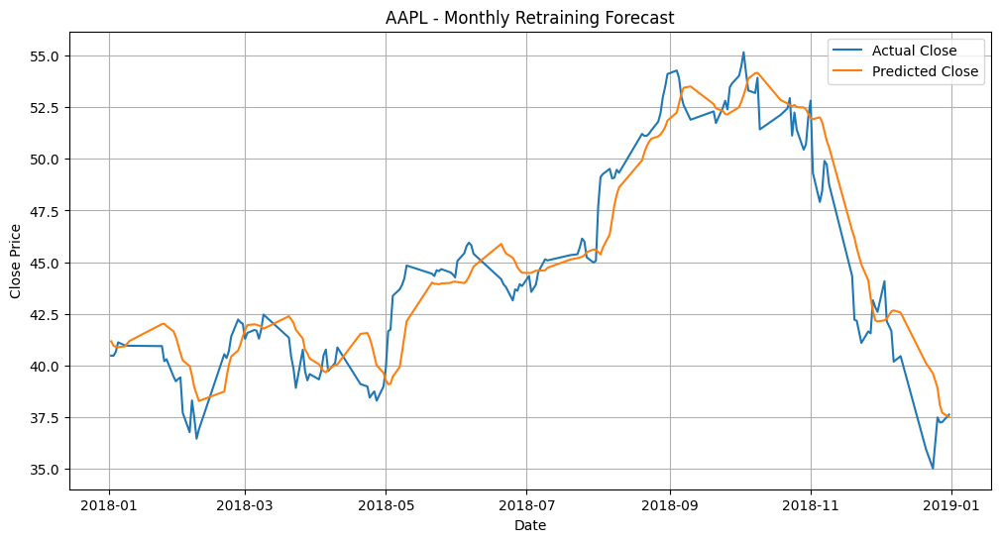


📊 Results for JPM
RMSE: 2.4940
MAE : 1.9329
R^2 : 0.6030
MAPE: 0.0213


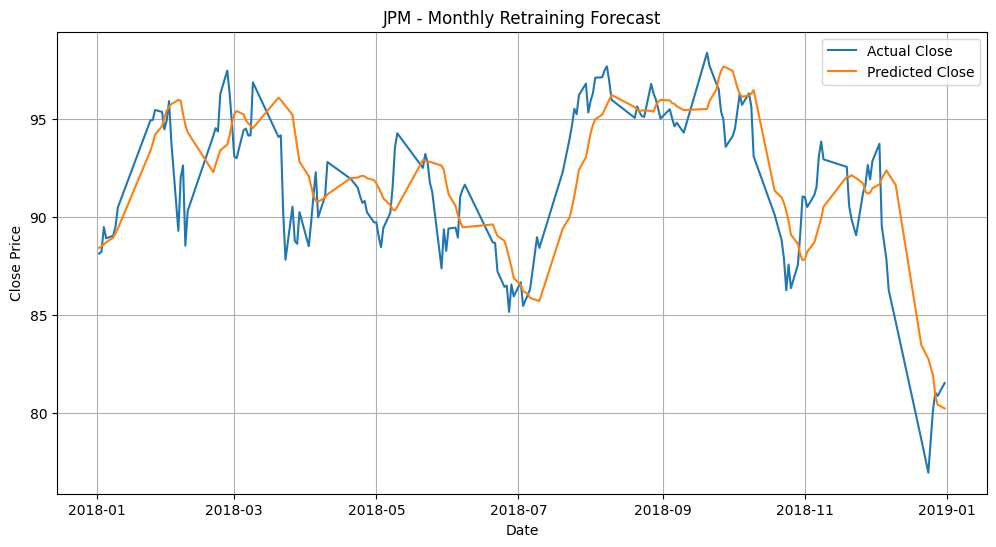


📊 Results for NVDA
RMSE: 0.3397
MAE : 0.2615
R^2 : 0.8594
MAPE: 0.0486


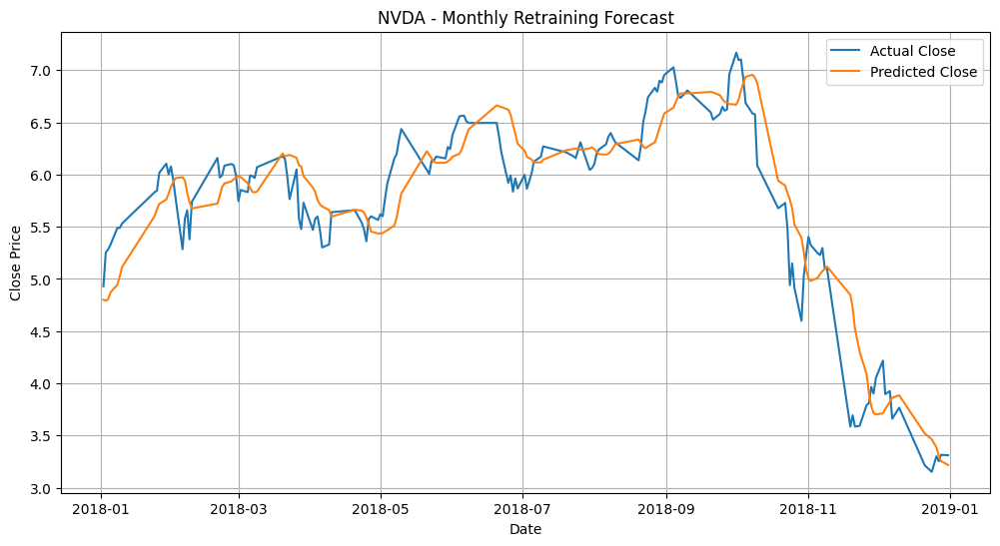


📊 Results for SPY
RMSE: 5.1719
MAE : 3.7532
R^2 : 0.7108
MAPE: 0.0156


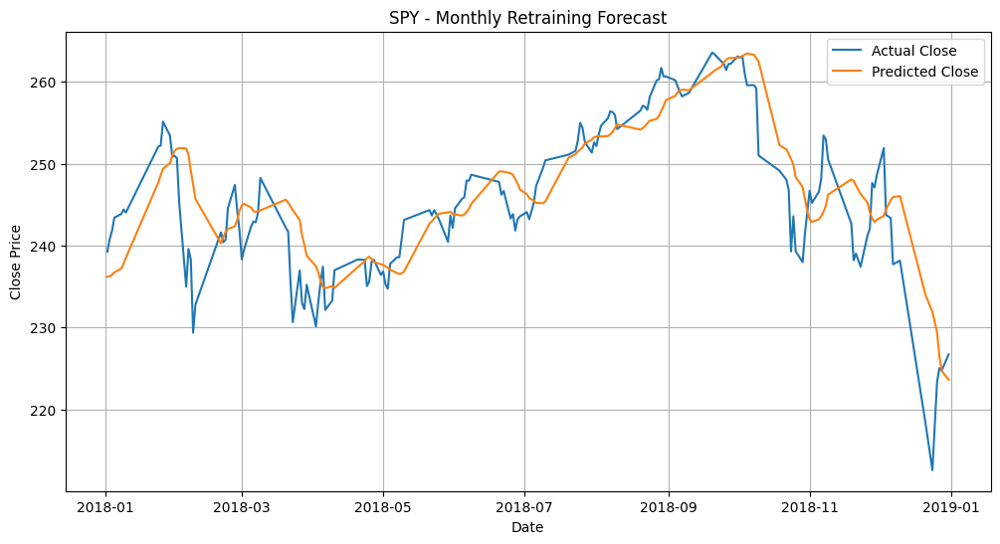

📉 Mean Scaled RMSE over 4 stocks: 0.09626703740735178


In [9]:
def forecast_with_monthly_retraining(df, stock_name, window=20):
    df = df[['Close', 'Close_lag1']].dropna()
    feature_cols = df.columns.drop('Close')
    df = df.loc['2012-01-01':'2018-12-31']

    test_start = pd.Timestamp("2017-12-11")
    test_end = pd.Timestamp("2018-12-31")

    current_train_end = pd.Timestamp("2017-12-31")
    current_test_start = test_start

    all_preds = []
    all_true = []
    all_dates = []

    while current_test_start <= test_end:
        current_test_end = (current_test_start + relativedelta(months=1)) - pd.Timedelta(days=1)
        if current_test_end > test_end:
            current_test_end = test_end

        train_df = df.loc[:current_train_end]
        test_df = df.loc[current_test_start - pd.Timedelta(days=window):current_test_end]

        if len(test_df) <= window:
            break

        # Scaling
        scaler_X = MinMaxScaler()
        scaler_y = MinMaxScaler()

        X_train = scaler_X.fit_transform(train_df[feature_cols])
        y_train = scaler_y.fit_transform(train_df[['Close']])

        X_test = scaler_X.transform(test_df[feature_cols])
        y_test = scaler_y.transform(test_df[['Close']])

        X_train_seq, y_train_seq = create_sequences(X_train, y_train, window)
        X_test_seq, y_test_seq = create_sequences(X_test, y_test, window)

        # Model
        model = Sequential([
            LSTM(64, input_shape=(window, X_train_seq.shape[2])),
            Dense(1)
        ])
        model.compile(optimizer=Adam(learning_rate=0.003), loss='mse')
        model.fit(X_train_seq, y_train_seq, epochs=20, batch_size=64, verbose=0)

        y_pred_scaled = model.predict(X_test_seq, verbose=0)
        y_pred = scaler_y.inverse_transform(y_pred_scaled)
        y_true = scaler_y.inverse_transform(y_test_seq)

        # Save results
        pred_dates = test_df.index[window:]
        all_preds.extend(y_pred.flatten())
        all_true.extend(y_true.flatten())
        all_dates.extend(pred_dates)

        # Append true values to training data for next iteration
        past_and_current = df.loc[:current_test_end]
        current_train_end = current_test_end + pd.Timedelta(days=0)
        current_test_start = current_test_end + pd.Timedelta(days=1)

    # Convert to pandas Series with datetime index
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Truncate to only predictions from Jan 1, 2017
    plot_start = pd.Timestamp("2018-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    # Use for metrics
    rmse = np.sqrt(mean_squared_error(true_series, pred_series))
    mae = mean_absolute_error(true_series, pred_series)
    r2 = r2_score(true_series, pred_series)
    mape = mean_absolute_percentage_error(true_series, pred_series)

    print(f"\n📊 Results for {stock_name}")
    print(f"RMSE: {rmse:.4f}")
    print(f"MAE : {mae:.4f}")
    print(f"R^2 : {r2:.4f}")
    print(f"MAPE: {mape:.4f}")

    # Convert to pandas Series for easy filtering
    pred_series = pd.Series(all_preds, index=pd.to_datetime(all_dates))
    true_series = pd.Series(all_true, index=pd.to_datetime(all_dates))

    # Filter to start from Jan 1, 2019
    plot_start = pd.Timestamp("2018-01-01")
    pred_series = pred_series[pred_series.index >= plot_start]
    true_series = true_series[true_series.index >= plot_start]

    plt.figure(figsize=(12, 6))
    plt.plot(true_series.index, true_series.values, label='Actual Close')
    plt.plot(pred_series.index, pred_series.values, label='Predicted Close')
    plt.title(f'{stock_name} - Monthly Retraining Forecast')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid()
    plt.show()

    scaled_rmse = rmse / (np.max(all_true) - np.min(all_true))
    return scaled_rmse

scaled_rmses = []

for ticker in ['AAPL.csv', 'JPM.csv', 'NVDA.csv', 'SPY.csv']:
    df = load_main_stock(ticker)
    scaled_rmse = forecast_with_monthly_retraining(df, ticker.replace('.csv', ''))
    scaled_rmses.append(scaled_rmse)

mean_scaled_rmse = sum(scaled_rmses) / len(scaled_rmses)
print("📉 Mean Scaled RMSE over 4 stocks:", mean_scaled_rmse)